# Irish Ag CA2

Countries chosen for this analysis are Ireland, Germany, Austrailia.

This analysis will focus on the Irish agricultural landscape and the impact that the move towards a more plant based diet has had on it's production/ imports/ exports in comparrison to other counties wehere veganism is also on the rise. 

From the Europe Dataset, the analysis will focus on Ireland, which will be the baseline for all analysis and then Germany. The Irish agriculture findings will then be compared against Germany as both countries benifit from the European Common agricultural Policy. The analysis will be looking for similarities & differences in each countries agriculture indistry. Germany has been chosen as a country for analysis as it is one of the countries with the highest % of vegans in Europe.

The analysis will go on to compare Irish agriculure against  Austraulia, one of the largest vegan populations in the world who do not benifit from being a member of the CAP. 


## Import Libraries 

Import Pandas and Numpy libraries. 

Pandas is a Python library used for data analysis. The Pandas library enables DataFrame and Series functionality used for analyzing the data. This library works with the tabular data, i.e data that is organized in a table with rows(observations) and columns(features). 

NumPy is a Python library used to perform mathematical and computing operations specific to arrays. The NumPy module works with the numerical data.
https://numpy.org/doc/stable/

Seaborn and Matplotlib libraries are used for data visualisation purposes to generate plots, graphs and other visuaisations of data. 

Plotly Express is used for Interactive visalusations 

Scipy and Statsmodels will be used for statistical analysis

In [1]:
#data manipulation libraries
import pandas as pd
import numpy as np

# data visualization Libraries
import seaborn as sns
from matplotlib import pyplot as plt
import plotly.express as px

#statistics libraries
import scipy.stats as stats
from statsmodels.stats import weightstats
from scipy.stats import shapiro
import statsmodels.api as sm
from scipy.stats import mannwhitneyu

## Python Good Practice 
The following are also good practice to run at the start of every Analysis project to ensure the best results 

In [2]:
# filter warnings
import warnings
warnings.filterwarnings("ignore")

# avoid blurry images
%config InLineBackend.figure_format = "retina"
sns.set_context=("talk")

# enable multiple cell outputs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

## Import Datasets

There is both production and import/export of goods data available on https://www.fao.org/faostat/en/#data/QCL for all continents.

In this section both production and import/export data for Europe, Americas & Oceanias will be imported. Later this data will be go through EDA and data cleaning before moving onto analysis and visualisation. 

Population will also be imported for each country as to standardise analysis to per capita findings. 
Ireland population: https://fred.stlouisfed.org/series/POPTOTIEA647NWDB

In [3]:
#import dataset
europe = pd.read_csv("data\Production_Crops_Livestock_E_Europe_NOFLAG.csv")

europe.head()

,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1962,Y1963,...,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016,Y2017,Y2018,Y2019,Y2020
0,3,Albania,515,Apples,5312,Area harvested,ha,NaN,NaN,NaN,...,3450.0,3719.0,3838.0,3863.0,4008.0,4230.0,4346.0,4294.0,4407.0,4420.0
1,3,Albania,515,Apples,5419,Yield,hg/ha,NaN,NaN,NaN,...,185507.0,191718.0,197316.0,212426.0,228882.0,240028.0,221671.0,252387.0,240374.0,231147.0
2,3,Albania,515,Apples,5510,Production,tonnes,10004.0,8039.0,7931.0,...,64000.0,71300.0,75730.0,82060.0,91736.0,101532.0,96338.0,108375.0,105933.0,102167.0
3,3,Albania,526,Apricots,5312,Area harvested,ha,NaN,NaN,NaN,...,300.0,301.0,315.0,320.0,331.0,326.0,326.0,337.0,341.0,346.0
4,3,Albania,526,Apricots,5419,Yield,hg/ha,NaN,NaN,NaN,...,130000.0,147176.0,139683.0,129375.0,152417.0,159325.0,154601.0,152493.0,142962.0,148642.0


In [4]:
#import dataset
europe_trade = pd.read_csv("data\Trade_CropsLivestock_E_Europe_NOFLAG.csv")

europe_trade.head()

,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1962,Y1963,...,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016,Y2017,Y2018,Y2019,Y2020
0,3,Albania,862,Alfalfa meal and pellets,5610,Import Quantity,tonnes,NaN,NaN,NaN,...,290.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,5.0,NaN
1,3,Albania,862,Alfalfa meal and pellets,5622,Import Value,1000 US$,NaN,NaN,NaN,...,89.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN
2,3,Albania,862,Alfalfa meal and pellets,5910,Export Quantity,tonnes,NaN,NaN,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,Albania,862,Alfalfa meal and pellets,5922,Export Value,1000 US$,NaN,NaN,NaN,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3,Albania,231,Almonds shelled,5610,Import Quantity,tonnes,NaN,NaN,NaN,...,180.0,144.0,126.0,32.0,133.0,129.0,59.0,85.0,512.0,367.0


In [5]:
#import dataset
americas = pd.read_csv("data\Production_Crops_Livestock_E_Americas_NOFLAG.csv")

americas.head()

,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1962,Y1963,...,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016,Y2017,Y2018,Y2019,Y2020
0,8,Antigua and Barbuda,1107,Asses,5111,Stocks,Head,2300.0,2300.0,2300.0,...,1700.0,1700.0,1700.0,1700.0,1703.0,1707.0,1719.0,1719.0,1723.0,1726.0
1,8,Antigua and Barbuda,486,Bananas,5312,Area harvested,ha,NaN,NaN,NaN,...,28.0,35.0,32.0,35.0,37.0,41.0,44.0,48.0,52.0,11.0
2,8,Antigua and Barbuda,486,Bananas,5419,Yield,hg/ha,NaN,NaN,NaN,...,85357.0,71429.0,79688.0,74000.0,71081.0,56341.0,46364.0,37292.0,28846.0,4545.0
3,8,Antigua and Barbuda,486,Bananas,5510,Production,tonnes,NaN,NaN,NaN,...,239.0,250.0,255.0,259.0,263.0,231.0,204.0,179.0,150.0,5.0
4,8,Antigua and Barbuda,414,"Beans, green",5312,Area harvested,ha,1.0,1.0,2.0,...,24.0,25.0,25.0,25.0,25.0,25.0,26.0,26.0,26.0,26.0


In [6]:
#import dataset
americas_trade = pd.read_csv("data\Trade_CropsLivestock_E_Americas_NOFLAG.csv")

americas_trade.head()

,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1962,Y1963,...,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016,Y2017,Y2018,Y2019,Y2020
0,8,Antigua and Barbuda,862,Alfalfa meal and pellets,5610,Import Quantity,tonnes,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN
1,8,Antigua and Barbuda,862,Alfalfa meal and pellets,5622,Import Value,1000 US$,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,0.0,NaN
2,8,Antigua and Barbuda,231,Almonds shelled,5610,Import Quantity,tonnes,NaN,NaN,NaN,...,NaN,36.0,8.0,12.0,16.0,12.0,16.0,16.0,13.0,1.0
3,8,Antigua and Barbuda,231,Almonds shelled,5622,Import Value,1000 US$,NaN,NaN,NaN,...,NaN,145.0,37.0,47.0,46.0,38.0,54.0,59.0,44.0,6.0
4,8,Antigua and Barbuda,231,Almonds shelled,5910,Export Quantity,tonnes,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN


In [7]:
#import dataset
oceania = pd.read_csv("data\Production_Crops_Livestock_E_Oceania_NOFLAG.csv")

oceania.head()

,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1962,Y1963,...,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016,Y2017,Y2018,Y2019,Y2020
0,10,Australia,221,"Almonds, with shell",5312,Area harvested,ha,NaN,NaN,NaN,...,25666.0,26058.0,28586.0,28060.0,28190.0,28553.0,29282.0,31361.0,37903.0,39301.0
1,10,Australia,221,"Almonds, with shell",5419,Yield,hg/ha,NaN,NaN,NaN,...,32300.0,41907.0,56531.0,54337.0,55090.0,61170.0,63513.0,55164.0,55932.0,56458.0
2,10,Australia,221,"Almonds, with shell",5510,Production,tonnes,NaN,NaN,NaN,...,82900.0,109200.0,161600.0,152470.0,155300.0,174660.0,185980.0,173000.0,212000.0,221886.0
3,10,Australia,711,"Anise, badian, fennel, coriander",5312,Area harvested,ha,NaN,NaN,NaN,...,914.0,1015.0,1040.0,989.0,989.0,1006.0,987.0,994.0,996.0,992.0
4,10,Australia,711,"Anise, badian, fennel, coriander",5419,Yield,hg/ha,NaN,NaN,NaN,...,11368.0,11488.0,11548.0,11587.0,11608.0,11581.0,11581.0,11590.0,11576.0,11593.0


In [8]:
#import dataset
oceania_trade = pd.read_csv("data\Trade_CropsLivestock_E_Oceania_NOFLAG.csv")

oceania_trade.head()

,Area Code,Area,Item Code,Item,Element Code,Element,Unit,Y1961,Y1962,Y1963,...,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016,Y2017,Y2018,Y2019,Y2020
0,10,Australia,862,Alfalfa meal and pellets,5610,Import Quantity,tonnes,0.0,0.0,0.0,...,12.0,9.0,0.0,1.0,13.0,59.0,109.0,657.0,1003.0,1.0
1,10,Australia,862,Alfalfa meal and pellets,5622,Import Value,1000 US$,0.0,0.0,0.0,...,34.0,25.0,0.0,4.0,18.0,55.0,149.0,363.0,497.0,9.0
2,10,Australia,862,Alfalfa meal and pellets,5910,Export Quantity,tonnes,0.0,0.0,0.0,...,85992.0,77026.0,73652.0,97312.0,84691.0,81045.0,72941.0,52186.0,50680.0,40056.0
3,10,Australia,862,Alfalfa meal and pellets,5922,Export Value,1000 US$,0.0,0.0,0.0,...,25292.0,24082.0,23972.0,38488.0,27409.0,26811.0,20611.0,16656.0,16107.0,12946.0
4,10,Australia,231,Almonds shelled,5610,Import Quantity,tonnes,0.0,0.0,0.0,...,1164.0,2309.0,2515.0,2056.0,1904.0,2314.0,3061.0,3657.0,2784.0,2436.0


In [9]:
# import dataset
ireland_pop = pd.read_csv("data\irelandpop.csv")

columns = [ 'Year', 'Population_Ireland']
ireland_pop.columns = columns

# reformat year
ireland_pop['Year'] = ireland_pop['Year'].str[:4]

# drop year 1960 & 2020 
ireland_pop.drop([0], axis=0, inplace=True)
ireland_pop.drop([60], axis=0, inplace=True)

# cast pop as int 
ireland_pop['Population_Ireland'] = ireland_pop['Population_Ireland'].astype('int')

ireland_pop.tail()

,Year,Population_Ireland
55,2015,4701957
56,2016,4755335
57,2017,4807388
58,2018,4867316
59,2019,4934340


In [10]:
#import dataset
germany_pop = pd.read_csv("data\germanypop.csv")

columns = [ 'Year', 'Population_Germany']
germany_pop.columns = columns

#reformat year
germany_pop['Year'] = germany_pop['Year'].str[:4]

#drop year 1960 # drop year 1960 & 2020
germany_pop.drop([0], axis=0, inplace=True)
germany_pop.drop([60], axis=0, inplace=True)

# cast pop as int 
germany_pop['Population_Germany'] = germany_pop['Population_Germany'].astype('int')

germany_pop.tail()

,Year,Population_Germany
55,2015,81686611
56,2016,82348669
57,2017,82657002
58,2018,82905782
59,2019,83092962


In [11]:
#import dataset
aus_pop = pd.read_csv("data\\australiapop.csv")

columns = [ 'Year', 'Population_Australia']
aus_pop.columns = columns

#reformat year
aus_pop['Year'] = aus_pop['Year'].str[:4]

#drop year 1960 
aus_pop.drop([0], axis=0, inplace=True)
aus_pop.drop([60], axis=0, inplace=True)

# cast pop as int 
aus_pop['Population_Australia'] = aus_pop['Population_Australia'].astype('int')

aus_pop.head()

,Year,Population_Australia
1,1961,10483000
2,1962,10742000
3,1963,10950000
4,1964,11167000
5,1965,11388000


## Europe Production Dataset Initial EDA

The European Prouction Dataset is taken from faostat and contains annual data on all crops and animal products producted in  Europe from 1961-2020, measured in tonnes. It also contains information on livestock numbers, yields, areas havested and slaughtering numbers.

Unit Measurements:

    Production = tonnes / head / 1000 head / number
    Area harvested = ha
    Yield =	hg/ha
    Stocks = head / 1000 head
    Producing Animals / Slaughtered = head / 1000 head
    Yields/ Carcass Weight = 0.1g/An, hg/An
    Milking Animals = head 
    Laying = head / 1000 head
    Prod Popultn (bees/honey) = number

"Crop statistics are recorded for 173 products, covering the following categories: Crops Primary, Fibre Crops Primary, Cereals, Coarse Grain, Citrus Fruit, Fruit, Jute Jute-like Fibres, Oilcakes Equivalent, Oil crops Primary, Pulses, Roots and Tubers, Treenuts and Vegetables and Melons. Data are expressed in terms of area harvested, production quantity and yield. The objective is to comprehensively cover production of all primary crops for all countries and regions in the world. Area and production data on cereals relate to crops harvested for dry grain only. Cereal crops harvested for hay or harvested green for food, feed or silage or used for grazing are therefore excluded. Area data relate to harvested area. Some countries report sown or cultivated area only." https://www.fao.org/faostat/en/#data/QCL

In this section and the European Trade section, Dataset will go through an initial EDA process before comparative analysis can begin. Here, datasets will be cleaned by:

    Removing / renaming / re-order columns where necessary
    Reshaping data into a more usable format
    Identify Missing or NaN Values / address appropriately 
    Ensuring correct dtype is applied for each feature  - as the ony datetime variable being used is 'Year', this can remain as int type. It will not be nescessary to cast to datetime dytpe. 
    


In [12]:
#drop columns not required for analysis
to_drop = ['Area Code','Item Code','Element Code']
europe.drop(to_drop, inplace=True, axis=1)

### Melt Data

The current dataset is difficult to read as it has lots of columns for the different years of data. This dataset can be reshaped using the melt() function 

In [13]:
# melt new dataframe in order to visualise data by street 
europe_melt = pd.melt(europe, id_vars=[ 'Area', 'Item', 'Element', 'Unit'])

# rename columns 
columns = [ 'Country', 'Crop_Livestock', 'Element', 'Unit', 'Year', 'Value']
europe_melt.columns = columns

#remove Y from year
europe_melt['Year'] = europe_melt['Year'].str[1:]

europe_melt.head()

,Country,Crop_Livestock,Element,Unit,Year,Value
0,Albania,Apples,Area harvested,ha,1961,NaN
1,Albania,Apples,Yield,hg/ha,1961,NaN
2,Albania,Apples,Production,tonnes,1961,10004.0
3,Albania,Apricots,Area harvested,ha,1961,NaN
4,Albania,Apricots,Yield,hg/ha,1961,NaN


In [14]:
# dataframe shape, number of rows/ columns 
europe_melt.shape

(959580, 6)

In [15]:
europe_melt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 959580 entries, 0 to 959579
Data columns (total 6 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country         959580 non-null  object 
 1   Crop_Livestock  959580 non-null  object 
 2   Element         959580 non-null  object 
 3   Unit            959580 non-null  object 
 4   Year            959580 non-null  object 
 5   Value           544700 non-null  float64
dtypes: float64(1), object(5)
memory usage: 43.9+ MB


### Missing Values

Missing values and 0 values look to reflect that there was no production/ harvest/ yield etc. in a given year for a given country for a given crop/livestock. For early years, it is accptable to assume 0/ NaN values reflect that a cuntry had not yet bgan to produce/ trade this item and therefore values remain as NaN. These values can be removed. 

However, this does not seem to be the case for all 0 / NaN values as pending further investigation it looks like quite a lot of items are missing the last 3 years of production data (2018 / 2019 / 2020). This is consistent across all EU data. This data might not have been submitted to official sources and therefore not included in datasets yet due to covid 19 disruptions. Oceania data seems to only be missing 2020 data as a result of Covid disruptions.

Interpolating or replacing this 2020 might not be appropriate as the interpolated data will not be able to account for the disruption caused by Covid on the Agriculture sector for both production & trade. Therefore, this data will be dropped form the analysis. 

2018 / 2019 data should be interpolated, but it will need to be specific to only the last 2 years to ensure data integretity. It is difficult to interpolate data in the format it is currently in as the Crop_Livestock and Year column contain multiple values which would make it harder to specify what exactly to interpolate. To rectify this, Europe data will first be tidied into seperate Ireland/ Germany datasets to make it easier to identify what specific data to interpolate using the iloc replace function as it allows for specificied rows/ values to be amended, thus keeping the earlier years 0 values in tact to reflect true circumstances.  

Finally, ' Value' dtype will only be changed to int only after missing data has been dealt wil in full in 'Ireland Missing Values'  section as this cannot be done when NaN values are present. 


In [16]:
#remove rows with data not available 
europe_melt = europe_melt.loc[europe_melt["Year"] != "2020"]

In [17]:
# number of missing values 
europe_melt.isnull().sum()

Country                0
Crop_Livestock         0
Element                0
Unit                   0
Year                   0
Value             409536
dtype: int64

In [18]:
#check the amount of 0's in each column
europe_melt_sparse = (europe_melt == 0).sum()
europe_melt_sparse

Country              0
Crop_Livestock       0
Element              0
Unit                 0
Year                 0
Value             6871
dtype: int64

## European Trade Dataset EDA

The European Trade Dataset is taken from faostat and contains annual data on all crop/ livestock/ animal product Imports and Exports in Europe from 1961-2020, measured in tonnes and heads. It also contains information on Import and Export values in $1000US.

Import/ Export Quantity Unit Measurements:

    Crops = tonnes
    Livestock = head
    Dairy Products = tonnes
    Meat animal Product = tonnes 

"The food and agricultural trade dataset is collected, processed and disseminated by FAO according to the standard International Merchandise Trade Statistics (IMTS) Methodology. The data is mainly provided by UNSD, Eurostat, and other national authorities as needed. This source data is checked for outliers, trade partner data is used for non-reporting countries or missing cells, and data on food aid is added to take into account total cross-border trade flows."  https://www.fao.org/faostat/en/#data/TCL


In [19]:
#drop columns not required for analysis
europe_trade.drop(to_drop, inplace=True, axis=1)

### Melt Data

In [20]:
# melt new dataframe in order to visualise data by street 
europe_trade_melt = pd.melt(europe_trade, id_vars=[ 'Area', 'Item', 'Element', 'Unit'])

# rename columns 
columns = [ 'Country', 'Crop_Livestock', 'Element', 'Unit', 'Year', 'Value']
europe_trade_melt.columns = columns

#remove Y from year
europe_trade_melt['Year'] = europe_trade_melt['Year'].str[1:]

europe_trade_melt.head()

,Country,Crop_Livestock,Element,Unit,Year,Value
0,Albania,Alfalfa meal and pellets,Import Quantity,tonnes,1961,NaN
1,Albania,Alfalfa meal and pellets,Import Value,1000 US$,1961,NaN
2,Albania,Alfalfa meal and pellets,Export Quantity,tonnes,1961,NaN
3,Albania,Alfalfa meal and pellets,Export Value,1000 US$,1961,NaN
4,Albania,Almonds shelled,Import Quantity,tonnes,1961,NaN


In [21]:
# dataframe shape, number of rows/ columns 
europe_trade_melt.shape

(4092480, 6)

In [22]:
europe_trade_melt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4092480 entries, 0 to 4092479
Data columns (total 6 columns):
 #   Column          Dtype  
---  ------          -----  
 0   Country         object 
 1   Crop_Livestock  object 
 2   Element         object 
 3   Unit            object 
 4   Year            object 
 5   Value           float64
dtypes: float64(1), object(5)
memory usage: 187.3+ MB


### Missing Values

Unlike for the Europoean Production data, European and Oceania Trade data is not missing large amounts of data as a result of covid disruption. Meaning, any missing data identified here either relates to years there was no imports/exports for a given country for a given crop/livestock. 

For early years, it is accptable to assume 0/ NaN values reflect that a country had not yet began to produce/ trade this item and therefore values remain as NaN and can be removed. Any other Nan/ 0's identified are likely to reflect other years where no trade took place for the given product. 

As such, any missing data will just be removed for European & Oceanic Trade datasets. 

In [23]:
#remove rows with data not available 
europe_trade_melt = europe_trade_melt.loc[europe_trade_melt["Year"] != "2020"]

In [24]:
# number of missing values 
europe_trade_melt.isnull().sum()

Country                 0
Crop_Livestock          0
Element                 0
Unit                    0
Year                    0
Value             1533613
dtype: int64

In [25]:
#check the amount of 0's in each column
europe_trade_melt_sparse = (europe_trade_melt == 0).sum()
europe_trade_melt_sparse

Country                0
Crop_Livestock         0
Element                0
Unit                   0
Year                   0
Value             494020
dtype: int64

In [26]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
europe_trade_melt.replace(to_replace = 0, value = np.nan, inplace=True)

# row = 0, column = 1
europe_trade_df = europe_trade_melt.dropna(axis=0)

# check if we have any NaN values in our dataset
europe_trade_df.isnull().values.any()

False

In [27]:
europe_trade_df.shape

(1996639, 6)

## Oceania Production Dataset

The Oceania Prouction Dataset is taken from faostat and contains annual data on all crops and animal products producted throughout the Oceania region from 1961-2020, measured in tonnes. It also contains information on livestock numbers, yields, areas havested and slaughtering numbers.

Unit Measurements:

    Production = tonnes
    Area harvested = ha
    Yield =	hg/ha
    Stocks = head 
    Slaughter = head
    Yields/ Carcass Weight = 0.1g/An, hg/An
    Milking Animals = head
    Laying = head
    Prod Popultn (bees/honey) = number

"Crop statistics are recorded for 173 products, covering the following categories: Crops Primary, Fibre Crops Primary, Cereals, Coarse Grain, Citrus Fruit, Fruit, Jute Jute-like Fibres, Oilcakes Equivalent, Oil crops Primary, Pulses, Roots and Tubers, Treenuts and Vegetables and Melons. Data are expressed in terms of area harvested, production quantity and yield. The objective is to comprehensively cover production of all primary crops for all countries and regions in the world. Area and production data on cereals relate to crops harvested for dry grain only. Cereal crops harvested for hay or harvested green for food, feed or silage or used for grazing are therefore excluded. Area data relate to harvested area. Some countries report sown or cultivated area only." https://www.fao.org/faostat/en/#data/QCL


In [28]:
#drop columns not required for analysis
to_drop = ['Area Code','Item Code','Element Code']
oceania.drop(to_drop, inplace=True, axis=1)

### Melt Data

In [29]:
# melt new dataframe in order to visualise data by street 
oceania_melt = pd.melt(oceania, id_vars=[ 'Area', 'Item', 'Element', 'Unit'])

# rename columns 
columns = [ 'Country', 'Crop_Livestock', 'Element', 'Unit', 'Year', 'Value']
oceania_melt.columns = columns

#remove Y from year
oceania_melt['Year'] = oceania_melt['Year'].str[1:]

#set Year to datetime dtype
#oceania_melt['Year']= pd.to_datetime(europe_melt['Year'])

oceania_melt

,Country,Crop_Livestock,Element,Unit,Year,Value
0,Australia,"Almonds, with shell",Area harvested,ha,1961,NaN
1,Australia,"Almonds, with shell",Yield,hg/ha,1961,NaN
2,Australia,"Almonds, with shell",Production,tonnes,1961,NaN
3,Australia,"Anise, badian, fennel, coriander",Area harvested,ha,1961,NaN
4,Australia,"Anise, badian, fennel, coriander",Yield,hg/ha,1961,NaN
...,...,...,...,...,...,...
161095,Vanuatu,Sheep and Goat Meat,Producing Animals/Slaughtered,Head,2020,3224.0
161096,Vanuatu,Sheep and Goats,Stocks,Head,2020,15981.0
161097,Vanuatu,Vegetables Primary,Area harvested,ha,2020,823.0
161098,Vanuatu,Vegetables Primary,Yield,hg/ha,2020,161276.0


In [30]:
# dataframe shape, number of rows/ columns 
oceania_melt.shape

(161100, 6)

In [31]:
oceania_melt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161100 entries, 0 to 161099
Data columns (total 6 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country         161100 non-null  object 
 1   Crop_Livestock  161100 non-null  object 
 2   Element         161100 non-null  object 
 3   Unit            161100 non-null  object 
 4   Year            161100 non-null  object 
 5   Value           139641 non-null  float64
dtypes: float64(1), object(5)
memory usage: 7.4+ MB


### Missing Values

As established prior, Missing values and 0 values look to reflect that there was no production/ harvest/ yield etc. in a given year for a given country for a given crop/livestock. For early years, it is accptable to assume 0/ NaN values reflect 
that a cuntry had not yet bgan to produce/ trade this item and therefore values remain as NaN. These values can be removed. 

Unlike the European Dataset, the Oceania dataset does not appear to be missing any 2018/2019 values, meaning all Nan/ 0 values can be removed. 

As pointed out previously, Oceania data is also missing 2020 data as a result of Covid disruptions. Therefore, this data will be dropped form the analysis similar to europan data. 

Finally, ' Value' dtype will be changed to int only after missing data has been dealt with, as this cannot be done when NaN values are present. 

In [32]:
#remove rows with data not available 
oceania_melt = oceania_melt.loc[oceania_melt["Year"] != "2020"]

In [33]:
# number of missing values 
oceania_melt.isnull().sum()

Country               0
Crop_Livestock        0
Element               0
Unit                  0
Year                  0
Value             21248
dtype: int64

In [34]:
#check the amount of 0's in each column
oceania_melt_sparse = (oceania_melt == 0).sum()
oceania_melt_sparse

Country              0
Crop_Livestock       0
Element              0
Unit                 0
Year                 0
Value             1165
dtype: int64

In [35]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
oceania_melt.replace(to_replace = 0, value = np.nan, inplace=True)

# row = 0, column = 1
oceania_df = oceania_melt.dropna(axis=0)

# check if we have any NaN values in our dataset
oceania_df.isnull().values.any()

False

In [36]:
oceania_df.shape

(136002, 6)

In [37]:
# cast value as int 
oceania_df['Value'] = oceania_df['Value'].astype('int')

In [38]:
oceania_df

,Country,Crop_Livestock,Element,Unit,Year,Value
6,Australia,Apples,Area harvested,ha,1961,26656
7,Australia,Apples,Yield,hg/ha,1961,110682
8,Australia,Apples,Production,tonnes,1961,295034
9,Australia,Apricots,Area harvested,ha,1961,3794
10,Australia,Apricots,Yield,hg/ha,1961,107251
...,...,...,...,...,...,...
158410,Vanuatu,Sheep and Goat Meat,Producing Animals/Slaughtered,Head,2019,3255
158411,Vanuatu,Sheep and Goats,Stocks,Head,2019,16081
158412,Vanuatu,Vegetables Primary,Area harvested,ha,2019,828
158413,Vanuatu,Vegetables Primary,Yield,hg/ha,2019,160906


## Oceania Trade Dataset

The Oceania Trade Dataset is taken from faostat and contains annual data on all crop/ livestock/ animal product Imports and Exports throughout the Oceania region from 1961-2020, measured in tonnes and heads. It also contains information on Import and Export values in $1000US.

Import/ Export Quantity Unit Measurements:

    Crops = tonnes
    Livestock = head
    Dairy Products = tonnes
    Meat animal Product = tonnes 

"The food and agricultural trade dataset is collected, processed and disseminated by FAO according to the standard International Merchandise Trade Statistics (IMTS) Methodology. The data is mainly provided by UNSD, Eurostat, and other national authorities as needed. This source data is checked for outliers, trade partner data is used for non-reporting countries or missing cells, and data on food aid is added to take into account total cross-border trade flows."  https://www.fao.org/faostat/en/#data/TCL


In [39]:
#drop columns not required for analysis
oceania_trade.drop(to_drop, inplace=True, axis=1)

### Melt Data

In [40]:
# melt new dataframe in order to visualise data by street 
oceania_trade_melt = pd.melt(oceania_trade, id_vars=[ 'Area', 'Item', 'Element', 'Unit'])

# rename columns 
columns = [ 'Country', 'Crop_Livestock', 'Element', 'Unit', 'Year', 'Value']
oceania_trade_melt.columns = columns

#remove Y from year
oceania_trade_melt['Year'] = oceania_trade_melt['Year'].str[1:]

#set Year to datetime dtype
#europe_melt['Year']= pd.to_datetime(europe_melt['Year'])

oceania_trade_melt.head()

,Country,Crop_Livestock,Element,Unit,Year,Value
0,Australia,Alfalfa meal and pellets,Import Quantity,tonnes,1961,0.0
1,Australia,Alfalfa meal and pellets,Import Value,1000 US$,1961,0.0
2,Australia,Alfalfa meal and pellets,Export Quantity,tonnes,1961,0.0
3,Australia,Alfalfa meal and pellets,Export Value,1000 US$,1961,0.0
4,Australia,Almonds shelled,Import Quantity,tonnes,1961,0.0


In [41]:
# dataframe shape, number of rows/ columns 
oceania_trade_melt.shape

(973620, 6)

In [42]:
oceania_trade_melt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 973620 entries, 0 to 973619
Data columns (total 6 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country         973620 non-null  object 
 1   Crop_Livestock  973620 non-null  object 
 2   Element         973620 non-null  object 
 3   Unit            973620 non-null  object 
 4   Year            973620 non-null  object 
 5   Value           548192 non-null  float64
dtypes: float64(1), object(5)
memory usage: 44.6+ MB


### Missing Values

Similar to European Trade data, Oceania Trade data is not missing large amounts of data as a result of covid disruption. Meaning, any missing data identified here either relates to years there was no imports/exports for a given country for a given crop/livestock. 

Similarly for early years, it is accptable to assume 0/ NaN values reflect that a country had not yet began to produce/ trade this item and therefore values remain as NaN and can be removed. Any other Nan/ 0's identified are likely to reflect other years where no trade took place for the given product. 

As such, any missing data will just be removed for European & Oceanic Trade datasets. 


In [43]:
#remove rows with data not available 
oceania_trade_melt = oceania_trade_melt.loc[oceania_trade_melt["Year"] != "2020"]

In [44]:
# number of missing values 
oceania_trade_melt.isnull().sum()

Country                0
Crop_Livestock         0
Element                0
Unit                   0
Year                   0
Value             419205
dtype: int64

In [45]:
#check the amount of 0's in each column
oceania_trade_melt_sparse = (oceania_trade_melt == 0).sum()
oceania_trade_melt_sparse

Country                0
Crop_Livestock         0
Element                0
Unit                   0
Year                   0
Value             187343
dtype: int64

In [46]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
oceania_trade_melt.replace(to_replace = 0, value = np.nan, inplace=True)

# row = 0, column = 1
oceania_trade_df = oceania_trade_melt.dropna(axis=0)

# check if we have any NaN values in our dataset
oceania_trade_df.isnull().values.any()

False

In [47]:
oceania_trade_df.shape

(350845, 6)

In [48]:
# cast value as int 
oceania_trade_df['Value'] = oceania_trade_df['Value'].astype('int')

## IRELAND

Ireland will form as the baseline country for analysis. 

This analysis will focus on how irish production and consumption has changed over time in line with consumer diet trends and thus impacted irelands agriculture. For the sake of this analysis, Irish production is specific on meat, dairy and crops. Livestock data will not be included in this analysis and will be filtered out by specifying the ireland_prod datafame to only contain 'Production' for element. Livesotck is measured in 'head' and '1000 head' so will remove any livestock data. 

Population data will be added as to calculate values per capita for later comparrison with other countries. 

In order to calculate consumption of a product; production, export and import data on a particular crop is required.
Ireland Trade data will be sorted into 'Import Quantity / Import Value / Export Quantity/ Export Value' and brought into the Ireand dataset using a merge function.

Seperate datasets can be used to conduct specific analysis on Meat, dairy and crop products using the str.contains function. 

Once cleaned, descriptive statistics will then be used for statistical analysis on datasets. It is important to note that the Crop_Livestock column contains multiple products that vary in production level. As it would not be useful to see the mean/diveations until this column is divided up further so an average meat production figure or average dairy production figure can be shown. 

After analysing the descriptive statistics, iusal representations will be used to display initial data to the reader

## Ireland Production Dataset 

For the sake of this analysis, Irish production is specific on meat, dairy and crops. Livestock data will not be included in this analysis and will be filtered out by specifying the ireland_prod datafame to only contain 'Production' for element. Livesotck is measured in 'head' and '1000 head' so will remove any livestock data. 

Columns will also be renamed to 'Production' specific values to make it easier to identify what columns can be dropped when merging with trade datasets later on. 

Missing Values will then be adressed for Ireland dataset. 

The shape function will show how many rows are present. This number is expected to drop once merged with trade data as only rows that have all elements related to consumption (import/ export/ production data) will be kept. 


In [49]:
# create irish dataset
ireland_prod_df = europe_melt.loc[europe_melt['Country']=='Ireland']

# irish production dataset - all products (crop, meat, livestock)
ireland_prod = ireland_prod_df.loc[ireland_prod_df['Element']=='Production']

# rename columns
ireland_prod.rename(columns={'Country': 'Prod Country', 'Unit': 'Production Unit', 'Value': 'Production Value' }, inplace=True)

#reset index
ireland_prod.reset_index(drop=True, inplace=True)

ireland_prod

,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value
0,Ireland,"Almonds, with shell",Production,tonnes,1961,NaN
1,Ireland,Apples,Production,tonnes,1961,29000.0
2,Ireland,Apricots,Production,tonnes,1961,NaN
3,Ireland,Avocados,Production,tonnes,1961,NaN
4,Ireland,Bananas,Production,tonnes,1961,NaN
...,...,...,...,...,...,...
8432,Ireland,Sheep and Goat Meat,Production,tonnes,2019,66040.0
8433,Ireland,"Skim Milk&Buttermilk,Dry",Production,tonnes,2019,134300.0
8434,Ireland,Sugar Crops Primary,Production,tonnes,2019,0.0
8435,Ireland,"Treenuts, Total",Production,tonnes,2019,0.0


In [50]:
ireland_prod.shape

(8437, 6)

### Ireland Missing Values

Missing values for European data have been reviewed previously. NaN and 0 values look to reflect that there was no production/ harvest/ yield etc. in a given year for a given country for a given crop/livestock. For early years, it is accptable to assume 0/ NaN values reflect that a cuntry had not yet bgan to produce/ trade this item and therefore values remain as NaN. These values can be removed.

2018 / 2019 data should be interpolated. It is difficult to interpolate data in the format it is currently in as the Crop_Livestock and Year column contain multiple values which would make it harder to specify what exactly to interpolate. 

To rectify this, Ireland data will converted into a pivot_table to make it easier to identify what specific columns of data need to be interpolated. Using the loc function to identify row / colun indexes first, the iloc replace function can then be used to replace specific 2018/2019 values.

' Value' dtype will be changed to int once this missing values process is complete. 

In [51]:
#ireland_prod as a pivot table to see what values we need to replace for 2018/2019 only

ireland_prod_table = pd.pivot_table(ireland_prod, values='Production Value', index=['Prod Country', 'Element', 'Production Unit', 'Year'],
                    columns=['Crop_Livestock'], aggfunc=np.sum, fill_value=0)
ireland_prod_table

Crop_Livestock                                Almonds, with shell  Apples  \
Prod Country Element    Production Unit Year                                
Ireland      Production 1000 No         1961                    0       0   
                                        1962                    0       0   
                                        1963                    0       0   
                                        1964                    0       0   
                                        1965                    0       0   
...                                                           ...     ...   
                        tonnes          2015                    0   18800   
                                        2016                    0   21800   
                                        2017                    0   21369   
                                        2018                    0   20140   
                                        2019                    0   19880   

Crop_Livestock                                Apricots  Avocados  Bananas  \
Prod Country Element    Production Unit Year                                
Ireland      Production 1000 No         1961         0         0        0   
                                        1962         0         0        0   
                                        1963         0         0        0   
                                        1964         0         0        0   
                                        1965         0         0        0   
...                                                ...       ...      ...   
                        tonnes          2015         0         0        0   
                                        2016         0         0        0   
                                        2017         0         0        0   
                                        2018         0         0        0   
                                        2019         0         0        0   

Crop_Livestock                                 Barley  Beans, dry  \
Prod Country Element    Production Unit Year                        
Ireland      Production 1000 No         1961        0           0   
                                        1962        0           0   
                                        1963        0           0   
                                        1964        0           0   
                                        1965        0           0   
...                                               ...         ...   
                        tonnes          2015  1739200           0   
                                        2016  1479900           0   
                                        2017  1505811           0   
                                        2018  1181560           0   
                                        2019  1479600           0   

Crop_Livestock                                Beans, green  \
Prod Country Element    Production Unit Year                 
Ireland      Production 1000 No         1961             0   
                                        1962             0   
                                        1963             0   
                                        1964             0   
                                        1965             0   
...                                                    ...   
                        tonnes          2015          1679   
                                        2016          1706   
                                        2017          1702   
                                        2018             0   
                                        2019             0   

Crop_Livestock                                Beef and Buffalo Meat  \
Prod Country Element    Production Unit Year                          
Ireland      Production 1000 No         1961                      0   
                                        1962                      0   
       

In [52]:
# search tab to identify what 2018/2019 data to be replaces & identify iloc 
ireland_prod.loc[ireland_prod['Crop_Livestock']=='Cream fresh']

,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value
22,Ireland,Cream fresh,Production,tonnes,1961,2000.0
165,Ireland,Cream fresh,Production,tonnes,1962,3000.0
308,Ireland,Cream fresh,Production,tonnes,1963,3000.0
451,Ireland,Cream fresh,Production,tonnes,1964,3000.0
594,Ireland,Cream fresh,Production,tonnes,1965,4000.0
737,Ireland,Cream fresh,Production,tonnes,1966,4000.0
880,Ireland,Cream fresh,Production,tonnes,1967,4000.0
1023,Ireland,Cream fresh,Production,tonnes,1968,4000.0
1166,Ireland,Cream fresh,Production,tonnes,1969,6000.0
1309,Ireland,Cream fresh,Production,tonnes,1970,6000.0


In [53]:
# replace missing 2018/ 2019 values with last recorded value 

ireland_prod.iloc[[8203, 8346],[5]] = 2696.0
ireland_prod.iloc[[8206, 8349],[5]] = 3463.0
ireland_prod.iloc[[8208, 8351],[5]] = 1222.0
ireland_prod.iloc[[8209, 8352],[5]] = 3279.0
ireland_prod.iloc[[8168, 8311],[5]] = 4435.0
ireland_prod.iloc[[8214, 8357],[5]] = 4706000.0
ireland_prod.iloc[[8217, 8360],[5]] = 57170.0
ireland_prod.iloc[[8158, 8301],[5]] = 1702.0
ireland_prod.iloc[[8160, 8303],[5]] = 199.0
ireland_prod.iloc[[8167, 8310],[5]] = 1478.0
ireland_prod.iloc[[8168, 8311],[5]] = 4435.0
ireland_prod.iloc[[8171, 8314],[5]] = 340.0
ireland_prod.iloc[[8184, 8327],[5]] = 8906.0
ireland_prod.iloc[[8193, 8336],[5]] = 268.0
ireland_prod.iloc[[8194, 8337],[5]] = 45.0
ireland_prod.iloc[[8223, 8336],[5]] = 2890.0
ireland_prod.iloc[[8236, 8379],[5]] = 7169.0
ireland_prod.iloc[[8244, 8387],[5]] = 1855.0
ireland_prod.iloc[[8252, 8395],[5]] = 629.0
ireland_prod.iloc[[8258, 8401],[5]] = 75000.0
ireland_prod.iloc[[8259, 8402],[5]] = 9755.0
ireland_prod.iloc[[8266, 8409],[5]] = 26516.0
ireland_prod.iloc[[8267, 8410],[5]] = 2.0
ireland_prod.iloc[[8271, 8414],[5]] = 2219.0
ireland_prod.iloc[[8272, 8415],[5]] = 41849.0
ireland_prod.iloc[[8291, 8434],[5]] = 75000.0
ireland_prod.iloc[[8173, 8316],[5]] = 30064.0


In [54]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
ireland_prod.replace(to_replace = 0, value = np.nan, inplace=True)

# row = 0, column = 1
ireland_prod = ireland_prod.dropna(axis=0)

# check if we have any NaN values in our dataset
ireland_prod.isnull().values.any()

False

In [55]:
# cast value as int 
ireland_prod['Production Value'] = ireland_prod['Production Value'].astype('int')

### Ireland Production- Add Population 

Population data will be added as to calculate values per capita for later comparrison with other countries. Per Capita amounts will be added during feature Engineering later on. 

In [56]:
# merge population data. Outer merge so no data is lost 

ireland_prod_pop = pd.merge(ireland_prod, ireland_pop, how="outer", on = ["Year"])
ireland_prod_pop.head()

,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value,Population_Ireland
0,Ireland,Apples,Production,tonnes,1961,29000,2824400
1,Ireland,Barley,Production,tonnes,1961,515400,2824400
2,Ireland,Beer of barley,Production,tonnes,1961,363000,2824400
3,Ireland,Berries nes,Production,tonnes,1961,1000,2824400
4,Ireland,"Butter, cow milk",Production,tonnes,1961,61300,2824400


In [57]:
ireland_prod_pop.shape

(4757, 7)

### Ireland Production Analysis

As the focus of this analysis is how irish production and consumption has changed over time in line with consumer diet trends and thus impacted irelands agriculture, the ireland_df can be divided into Meat / Dairy / Crop datasets for further analysis. This will be done by using the str.contains function to specify what products should be included in each dataset.

The .unique and loc functions will then be used to further filter each dataset and remove any unwanted/ non relevant  products from each dataset. 

In [58]:
# irish production meat products
ireland_prod_meat = ireland_prod_pop.loc[ireland_prod_pop['Crop_Livestock'].str.contains('meat', case=False)]
ireland_prod_meat.rename(columns={'Crop_Livestock': 'Meat Type'}, inplace=True)
ireland_prod_meat.reset_index(drop=True)

# irish production dairy products
ireland_prod_dairy = ireland_prod_pop.loc[ireland_prod_pop['Crop_Livestock'].str.contains('milk', case=False)]
ireland_prod_dairy.rename(columns={'Crop_Livestock': 'Dairy Product'}, inplace=True)
ireland_prod_dairy.reset_index(drop=True)

# irish production crops
ireland_prod_crop = ireland_prod_pop.loc[ireland_prod_pop['Crop_Livestock'].str.contains('meat', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('milk', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('offals', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('fat', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('hides', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('wool', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('skin', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('cream', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('egg', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('lard', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('butter', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('cheese', case=False) == False]
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop_Livestock'].str.contains('oil', case=False) == False]
ireland_prod_crop.rename(columns={'Crop_Livestock': 'Crop'}, inplace=True)
ireland_prod_crop.reset_index(drop=True)


,Prod Country,Meat Type,Element,Production Unit,Year,Production Value,Population_Ireland
0,Ireland,Meat nes,Production,tonnes,1961,5000,2824400
1,Ireland,"Meat, cattle",Production,tonnes,1961,144539,2824400
2,Ireland,"Meat, chicken",Production,tonnes,1961,10000,2824400
3,Ireland,"Meat, duck",Production,tonnes,1961,1400,2824400
4,Ireland,"Meat, goose and guinea fowl",Production,tonnes,1961,1000,2824400
...,...,...,...,...,...,...,...
762,Ireland,"Meat, turkey",Production,tonnes,2019,12990,4934340
763,Ireland,Beef and Buffalo Meat,Production,tonnes,2019,619800,4934340
764,Ireland,"Meat, Poultry",Production,tonnes,2019,153990,4934340
765,Ireland,"Meat, Total",Production,tonnes,2019,1147379,4934340


,Prod Country,Dairy Product,Element,Production Unit,Year,Production Value,Population_Ireland
0,Ireland,"Butter, cow milk",Production,tonnes,1961,61300,2824400
1,Ireland,"Cheese, whole cow milk",Production,tonnes,1961,6000,2824400
2,Ireland,"Milk, skimmed cow",Production,tonnes,1961,1423066,2824400
3,Ireland,"Milk, skimmed dried",Production,tonnes,1961,6000,2824400
4,Ireland,"Milk, whole condensed",Production,tonnes,1961,330,2824400
...,...,...,...,...,...,...,...
606,Ireland,"Milk, whole dried",Production,tonnes,2019,57170,4934340
607,Ireland,"Milk, whole fresh cow",Production,tonnes,2019,8244870,4934340
608,Ireland,Evaporat&Condensed Milk,Production,tonnes,2019,3800,4934340
609,Ireland,"Milk, Total",Production,tonnes,2019,8244870,4934340


,Prod Country,Crop,Element,Production Unit,Year,Production Value,Population_Ireland
0,Ireland,Apples,Production,tonnes,1961,29000,2824400
1,Ireland,Barley,Production,tonnes,1961,515400,2824400
2,Ireland,Beer of barley,Production,tonnes,1961,363000,2824400
3,Ireland,Berries nes,Production,tonnes,1961,1000,2824400
4,Ireland,Cabbages and other brassicas,Production,tonnes,1961,25000,2824400
...,...,...,...,...,...,...,...
2364,Ireland,Fruit Primary,Production,tonnes,2019,26340,4934340
2365,Ireland,"Pulses, Total",Production,tonnes,2019,40610,4934340
2366,Ireland,"Roots and Tubers, Total",Production,tonnes,2019,382370,4934340
2367,Ireland,Sugar Crops Primary,Production,tonnes,2019,75000,4934340


In [59]:
# check Meat Type values are what we want for analysis
ireland_prod_meat['Meat Type'].unique()

array(['Meat nes', 'Meat, cattle', 'Meat, chicken', 'Meat, duck',
       'Meat, goose and guinea fowl', 'Meat, horse', 'Meat, pig',
       'Meat, sheep', 'Meat, turkey', 'Beef and Buffalo Meat',
       'Meat, Poultry', 'Meat, Total', 'Sheep and Goat Meat'],
      dtype=object)

In [60]:
# remove any items we dont want 
ireland_prod_meat = ireland_prod_meat.loc[ireland_prod_meat['Meat Type'] != 'Meat nes']
ireland_prod_meat = ireland_prod_meat.loc[ireland_prod_meat['Meat Type'] != 'Meat, Total']

In [61]:
ireland_prod_dairy['Dairy Product'].unique()

array(['Butter, cow milk', 'Cheese, whole cow milk', 'Milk, skimmed cow',
       'Milk, skimmed dried', 'Milk, whole condensed',
       'Milk, whole dried', 'Milk, whole evaporated',
       'Milk, whole fresh cow', 'Evaporat&Condensed Milk', 'Milk, Total',
       'Skim Milk&Buttermilk,Dry', 'Cheese, skimmed cow milk'],
      dtype=object)

In [62]:
ireland_prod_dairy = ireland_prod_dairy.loc[ireland_prod_dairy['Dairy Product'] != 'Milk, Total']
ireland_prod_dairy = ireland_prod_dairy.loc[ireland_prod_dairy['Dairy Product'] != 'Evaporat&Condensed Milk']

In [63]:
ireland_prod_crop['Crop'].unique()

array(['Apples', 'Barley', 'Beer of barley', 'Berries nes',
       'Cabbages and other brassicas', 'Carrots and turnips',
       'Cauliflowers and broccoli', 'Fruit, fresh nes', 'Honey, natural',
       'Lettuce and chicory', 'Margarine, short', 'Molasses',
       'Mushrooms and truffles', 'Oats', 'Onions, dry', 'Peas, dry',
       'Peas, green', 'Potatoes', 'Rye', 'Strawberries', 'Sugar beet',
       'Sugar Raw Centrifugal', 'Tallow', 'Tomatoes',
       'Vegetables, fresh nes', 'Wheat', 'Whey, dry', 'Cereals, Total',
       'Fruit Primary', 'Pulses, Total', 'Roots and Tubers, Total',
       'Sugar Crops Primary', 'Vegetables Primary', 'Currants',
       'Raspberries', 'Rapeseed', 'Pears', 'Hops',
       'Vegetables, leguminous nes', 'Cucumbers and gherkins',
       'Chillies and peppers, green',
       'Leeks, other alliaceous vegetables', 'Beans, dry', 'Beans, green',
       'Whey, condensed', 'Broad beans, horse beans, dry', 'Cereals nes',
       'Spinach', 'Pumpkins, squash and gou

In [64]:
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Vegetables, fresh nes']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Fruit, fresh nes']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Cereals, Total']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Fruit Primary']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Vegetables Primary']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Margarine, short']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Cereals nes']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Pulses, Total']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Roots and Tubers, Total']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Sugar Crops Primary']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Vegetables, leguminous nes']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Leeks, other alliaceous vegetables']
ireland_prod_crop = ireland_prod_crop.loc[ireland_prod_crop['Crop'] != 'Berries nes']


### Ireland Production Visualisations 

Visualisations can be seen using Seaborn & MatPlotlib to visualise Irelands agriculture production from 1961-2019 for meat / dairy/ crops. A line graph os chosen as to show production over time.

However, it is difficult to interpret the Crop dataset using a line graph. Imcluded below are other options tried to visualise this better including samplign and using percentage change. This data is better represented as a barplot to show production per crop. A view of how production has changed throughout the years will be better visualised using Plotly Express later in the analysis. 

In [65]:
def plotprodvisuals(dataset, foodvalue, country):
    plt.figure(figsize = (12,8))
    sns.lineplot(data=dataset, x="Year", y="Production Value", hue= foodvalue)  
    plt.xlabel('\nYear', fontsize=15) 
    plt.ylabel('Tonnes Produced\n', fontsize=15)
    plt.title('\n ' + country + "'s Production per " + foodvalue + ' 1961-2019\n', fontsize=20)
    plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
    plt.xticks(rotation = 80);
plt.show(); 

def plotprodvisualsii(dataset, foodvalue, minx, maxx,  country, title):
    plt.figure(figsize = (12,8))
    plt.subplots(figsize = (12,8))
    sns.lineplot(data=dataset, x="Year", y="Production Value", hue= foodvalue)  
    plt.ylim([minx, maxx])
    plt.xticks(rotation = 80, fontsize = 12)
    plt.xlabel('\nYear', fontsize=15) 
    plt.ylabel('Tonnes Produced\n', fontsize=15)
    plt.title('\n ' + country + "'s Production per " + title + foodvalue + ' 1961-2019\n', fontsize=20)
    plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1));
plt.show(); 

def plotprodbar(dataset, foodvalue, country):
    plt.figure(figsize = (15,10))
    sns.barplot(data = dataset, x = foodvalue, y="Production Value")
    plt.xticks(rotation = 90, fontsize=12)
    plt.xlabel('Poduct\n', fontsize=15) 
    plt.ylabel('Amount in Tonnes\n', fontsize=15)
    # https://stackoverflow.com/questions/35638525/how-to-add-title-to-subplots-with-loop
    # set the spacing between subplots 
    plt.subplots_adjust(left=None, bottom=None, right=None, top=1, wspace=None, hspace=1)
    # add title to include i value
    plt.title('\n ' + country + "'s Top " + foodvalue + ' 1961-2019\n', fontsize=20)
plt.show(); 
    

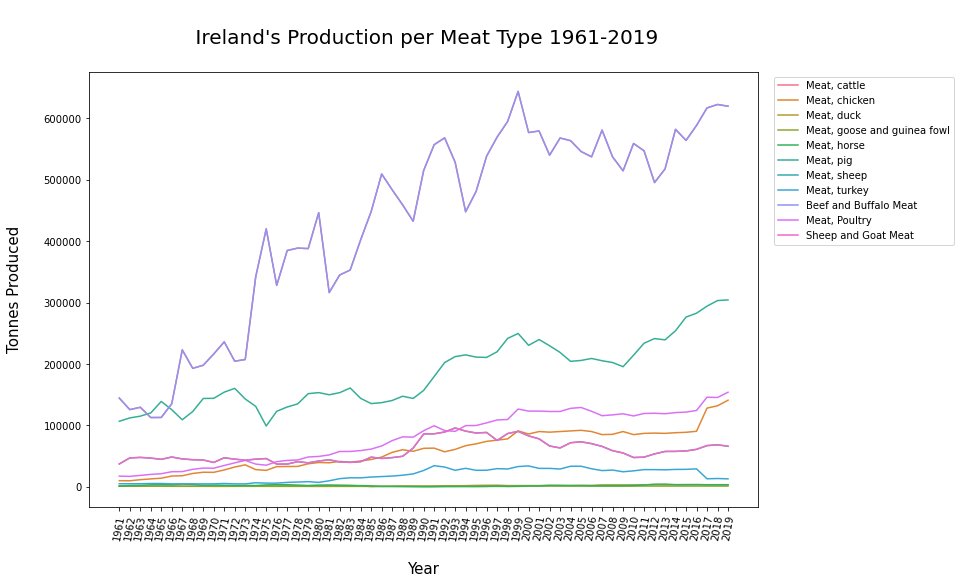

<Figure size 864x576 with 0 Axes>

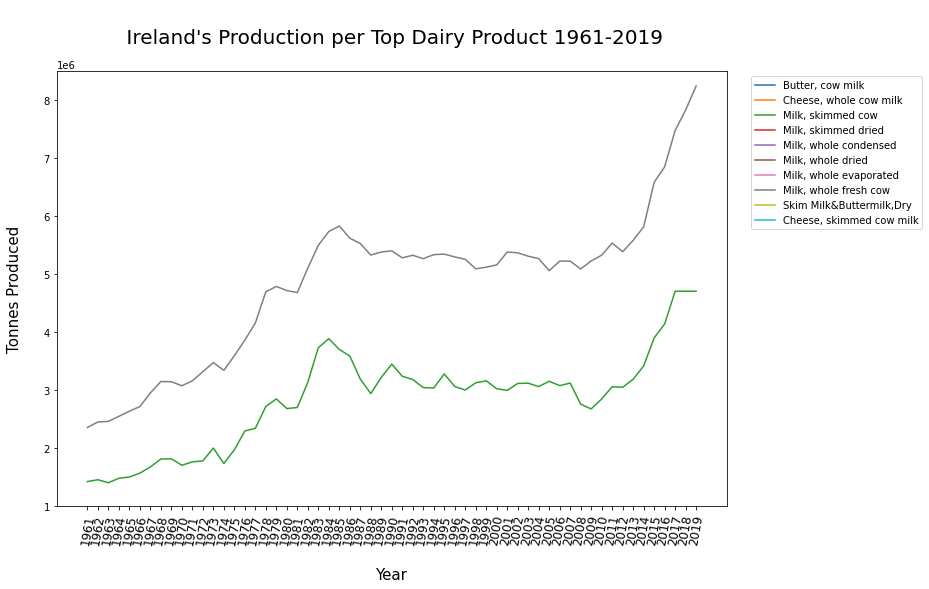

<Figure size 864x576 with 0 Axes>

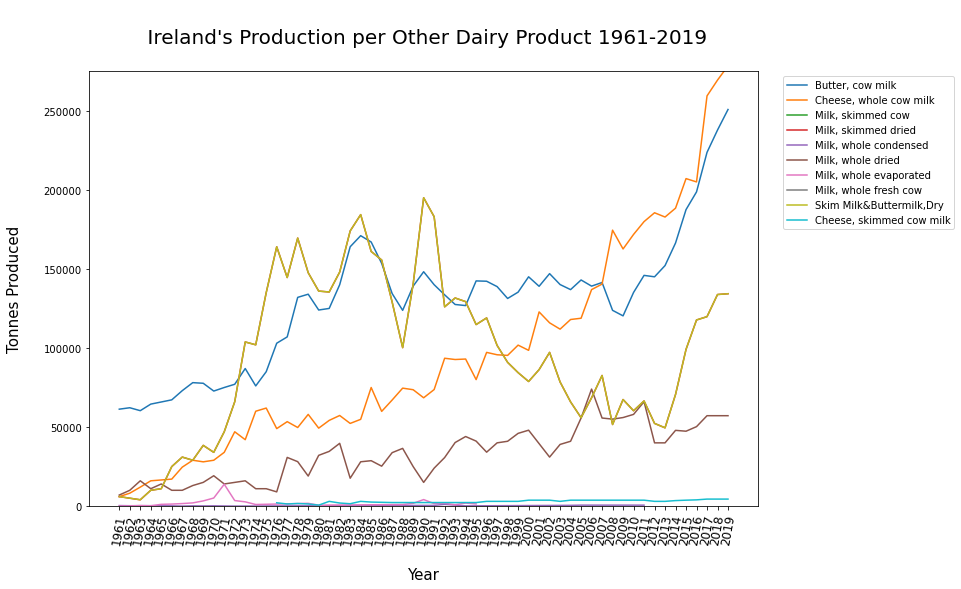

<Figure size 864x576 with 0 Axes>

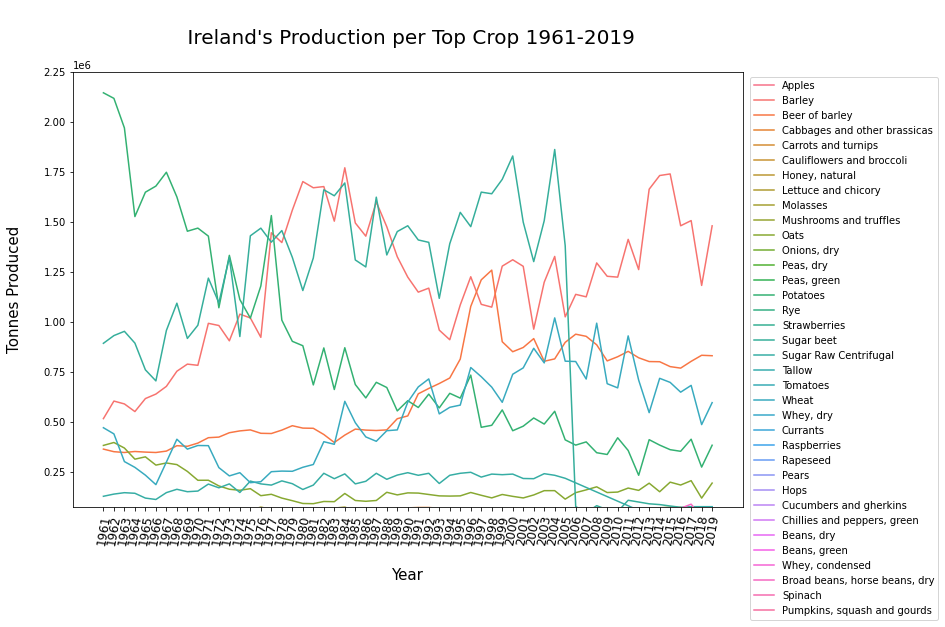

<Figure size 864x576 with 0 Axes>

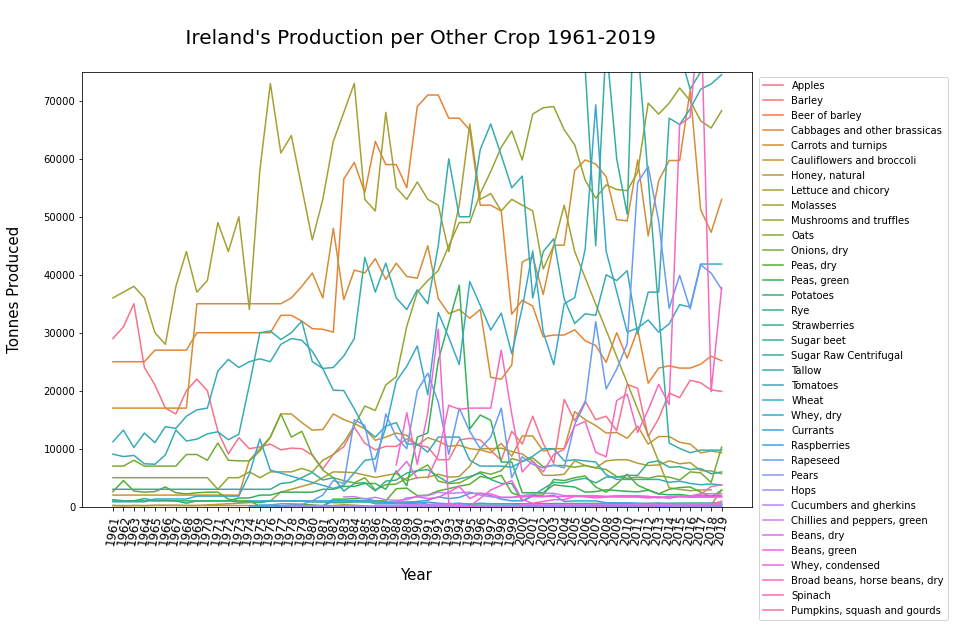

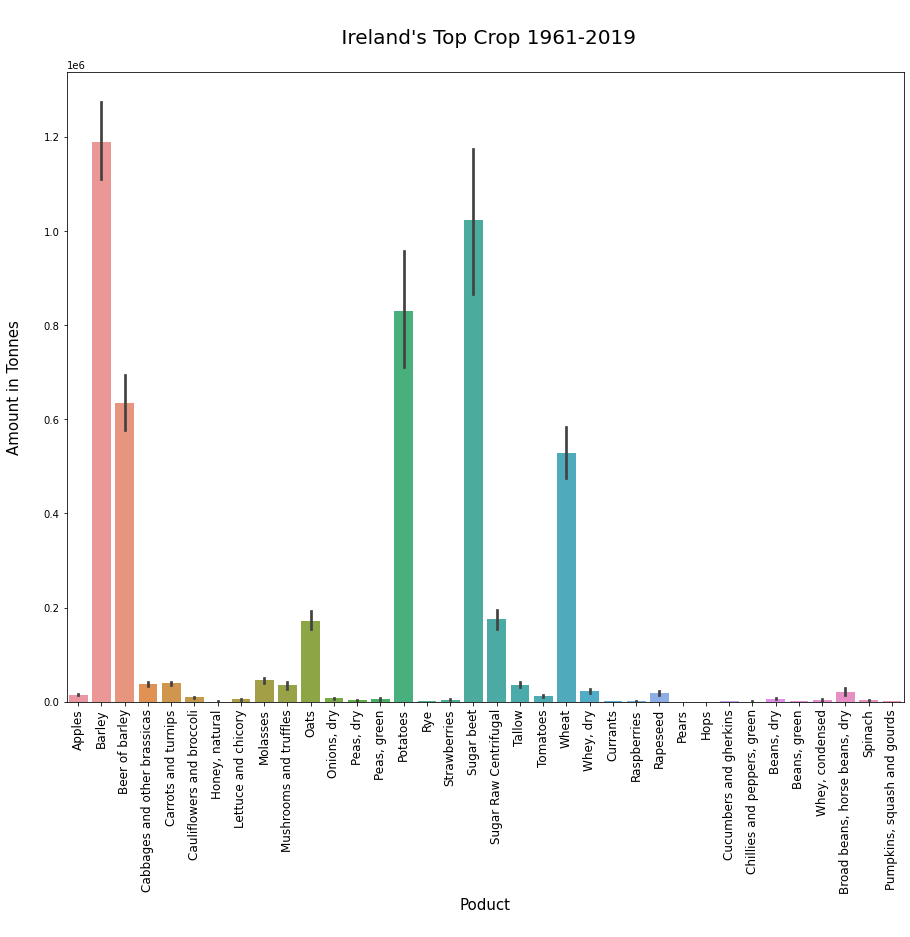

In [66]:
plotprodvisuals(ireland_prod_meat, "Meat Type", 'Ireland')
plotprodvisualsii(ireland_prod_dairy, "Dairy Product", 1000000, 8500000, 'Ireland', 'Top ')
plotprodvisualsii(ireland_prod_dairy, "Dairy Product", 0, 275000, 'Ireland', 'Other ')
plotprodvisualsii(ireland_prod_crop, "Crop", 75000, 2250000, 'Ireland', 'Top ')
plotprodvisualsii(ireland_prod_crop, "Crop", 0, 75000, 'Ireland', 'Other ')
plotprodbar(ireland_prod_crop, "Crop",'Ireland');

### Fix line graph to avoid clumping 

Multiple methods were attempted to find a better way to display Crop data to avoid clumping including  using % change, sampling and splitting values into seperate graphs bt setting y limits for values. 

Setting y limits appears to work the best but a shortned list for crops will need to be created further on to enable a better visual. This list can be created once rade data is also added to dataset. 

In [67]:
# sort values to use pct_change
ireland_prod_crop_test= ireland_prod_crop.sort_values(by=['Crop', 'Year'])

# add pc change column
ireland_prod_crop_test['Production Value PCT'] = ireland_prod_crop_test['Production Value'].pct_change().cumsum()

#reset index to use iloc
ireland_prod_crop_test.reset_index(drop=True, inplace=True)

# replace 1st value of PCT column
#ireland_dairy.iloc[[0],[10]] = 61300

ireland_prod_crop_test.head()

,Prod Country,Crop,Element,Production Unit,Year,Production Value,Population_Ireland,Production Value PCT
0,Ireland,Apples,Production,tonnes,1961,29000,2824400,NaN
1,Ireland,Apples,Production,tonnes,1962,31000,2836050,0.068966
2,Ireland,Apples,Production,tonnes,1963,35000,2852650,0.197998
3,Ireland,Apples,Production,tonnes,1964,24000,2866550,-0.116288
4,Ireland,Apples,Production,tonnes,1965,21000,2877300,-0.241288


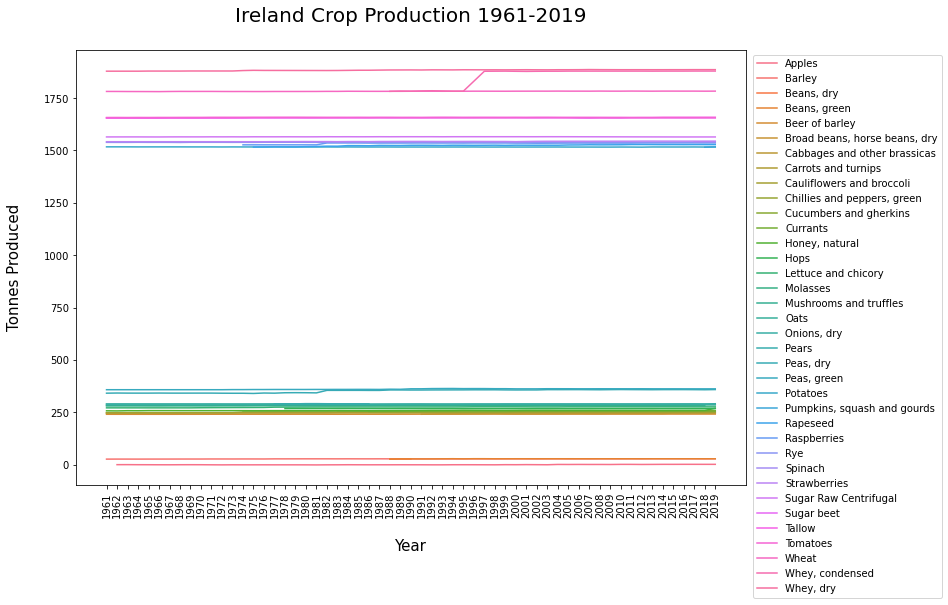

In [68]:
plt.figure(figsize = (12,8))
sns.lineplot(data=ireland_prod_crop_test, x="Year", y="Production Value PCT", hue="Crop")  
plt.xlabel('\nYear', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('Ireland Crop Production 1961-2019\n', fontsize=20)
plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
plt.xticks(rotation = 90);

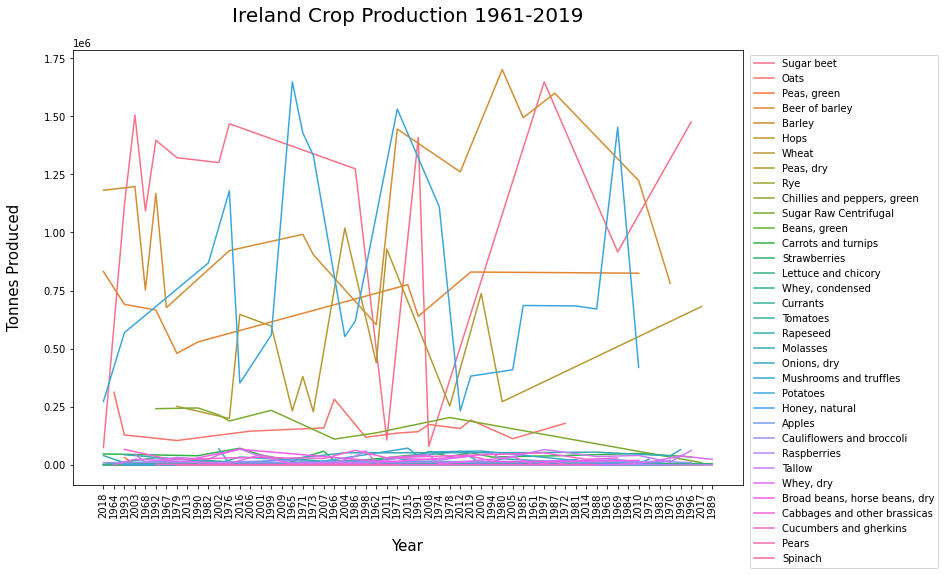

In [69]:
#create a sample for better visualisations 
# https://www.geeksforgeeks.org/python-pandas-dataframe-sample/

# create new sample df
ireland_prod_crop_sample = ireland_prod_crop.sample(frac =.25)

#sort values by year
ireland_prod_crop_sample.sort_values(by=['Crop', 'Year'])

plt.figure(figsize = (12,8))
sns.lineplot(data=ireland_prod_crop_sample, x="Year", y="Production Value", hue="Crop")  
plt.xlabel('\nYear', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('Ireland Crop Production 1961-2019\n', fontsize=20)
plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
plt.xticks(rotation = 90);

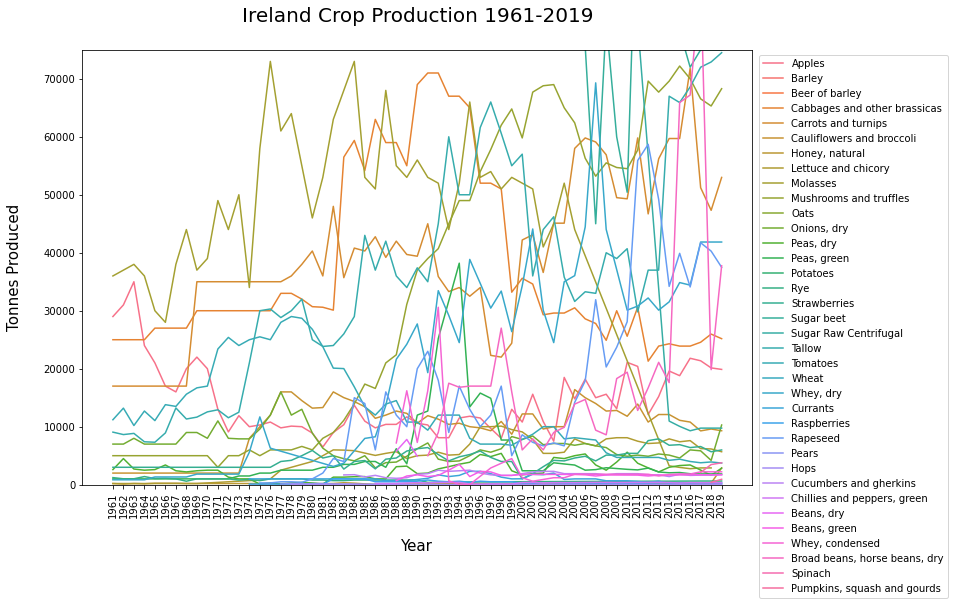

In [70]:
#reset graph limits to work for crop items

fig, ax = plt.subplots(figsize = (12,8))
vt = sns.lineplot(data=ireland_prod_crop, x="Year", y="Production Value", hue="Crop")  
vt = ax.set_ylim(0, 75000);
plt.xlabel('\nYear', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('Ireland Crop Production 1961-2019\n', fontsize=20)
plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
plt.xticks(rotation = 90);

## Ireland Trade Datasets

In order to calculate consumption of a product; production, export and import data on a particular crop is required.
Ireland Trade data will be sorted into  seperate 'Import Quantity / Import Value / Export Quantity/ Export Value' datasets using the loc function. 

Agian columns will be remaned to allow for easy column identification once date is merged with production data. This data will then and brought into the Ireland dataset using a merge function.

The shape function will show how many rows are present in each dataset. This number is likely to be different to the production data but is expected to drop once merged with trade data as only rows that have all elements related to consumption (import/ export/ production data) will be kept.


In [71]:
# create irish dataset
ireland_trade = europe_trade_df.loc[europe_trade_df['Country']=='Ireland']

# irish import/ export datasets - all products (crop, meat, livestock)
ireland_imports = ireland_trade.loc[ireland_trade['Element']=='Import Quantity']
ireland_exports = ireland_trade.loc[ireland_trade['Element']=='Export Quantity']
ireland_imports_val = ireland_trade.loc[ireland_trade['Element']=='Import Value']
ireland_exports_val = ireland_trade.loc[ireland_trade['Element']=='Export Value']

# rename Value Columns 
ireland_imports.rename(columns={'Value': 'Import Quantity'}, inplace=True)
ireland_exports.rename(columns={'Value': 'Export Quantity'}, inplace=True)
ireland_exports.rename(columns={'Unit': 'Export Unit'}, inplace=True)
ireland_imports.rename(columns={'Unit': 'Import Unit'}, inplace=True)
ireland_imports_val.rename(columns={'Value': 'Import Value'}, inplace=True)
ireland_exports_val.rename(columns={'Value': 'Export Value'}, inplace=True)

#reset index
ireland_imports.reset_index(drop=True, inplace=True)
ireland_exports.reset_index(drop=True, inplace=True)
ireland_imports_val.reset_index(drop=True, inplace=True)
ireland_exports_val.reset_index(drop=True, inplace=True)

In [72]:
ireland_imports.head()
ireland_exports.head()
ireland_imports_val.head()
ireland_exports_val.head()

,Country,Crop_Livestock,Element,Import Unit,Year,Import Quantity
0,Ireland,Almonds shelled,Import Quantity,tonnes,1961,493.0
1,Ireland,Apples,Import Quantity,tonnes,1961,9085.0
2,Ireland,Bananas,Import Quantity,tonnes,1961,11180.0
3,Ireland,Barley,Import Quantity,tonnes,1961,4544.0
4,Ireland,"Barley, pearled",Import Quantity,tonnes,1961,2177.0


,Country,Crop_Livestock,Element,Export Unit,Year,Export Quantity
0,Ireland,Apples,Export Quantity,tonnes,1961,24.0
1,Ireland,Asses,Export Quantity,Head,1961,1362.0
2,Ireland,Bacon and ham,Export Quantity,tonnes,1961,28761.0
3,Ireland,Barley,Export Quantity,tonnes,1961,1755.0
4,Ireland,Beer of barley,Export Quantity,tonnes,1961,202407.0


,Country,Crop_Livestock,Element,Unit,Year,Import Value
0,Ireland,Almonds shelled,Import Value,1000 US$,1961,489.0
1,Ireland,Animals live nes,Import Value,1000 US$,1961,264.0
2,Ireland,Apples,Import Value,1000 US$,1961,2047.0
3,Ireland,Bananas,Import Value,1000 US$,1961,1592.0
4,Ireland,Barley,Import Value,1000 US$,1961,356.0


,Country,Crop_Livestock,Element,Unit,Year,Export Value
0,Ireland,Animals live nes,Export Value,1000 US$,1961,2.0
1,Ireland,Apples,Export Value,1000 US$,1961,7.0
2,Ireland,Asses,Export Value,1000 US$,1961,31.0
3,Ireland,Bacon and ham,Export Value,1000 US$,1961,19757.0
4,Ireland,Barley,Export Value,1000 US$,1961,116.0


In [73]:
ireland_imports.shape
ireland_exports.shape
ireland_imports_val.shape
ireland_exports_val.shape

(17980, 6)

(14211, 6)

(18784, 6)

(15196, 6)

In [74]:
ireland_imports['Crop_Livestock'].unique()

array(['Almonds shelled', 'Apples', 'Bananas', 'Barley',
       'Barley, pearled', 'Beans, dry', 'Beer of barley', 'Beeswax',
       'Beverages, distilled alcoholic', 'Beverages, non alcoholic',
       'Bran, wheat', 'Butter, cow milk', 'Cake, cottonseed',
       'Cake, groundnuts', 'Cake, linseed', 'Cake, soybeans', 'Cattle',
       'Cereals, breakfast', 'Cheese, whole cow milk', 'Chickens',
       'Chocolate products nes', 'Cider etc', 'Cigarettes',
       'Cigars, cheroots', 'Cocoa, beans', 'Cocoa, butter',
       'Cocoa, paste', 'Coconuts, desiccated', 'Coffee, extracts',
       'Coffee, green', 'Coffee, roasted', 'Copra', 'Cotton lint',
       'Cotton linter', 'Cotton waste', 'Dates', 'Eggs, hen, in shell',
       'Fatty acids', 'Fibre crops nes', 'Figs dried', 'Flour, cereals',
       'Flour, mustard', 'Flour, pulses', 'Flour, roots and tubers nes',
       'Flour, wheat', 'Food wastes', 'Fruit, dried nes',
       'Fruit, prepared nes', 'Fruit, tropical fresh nes',
       'Glucose

## Merge Ireland Trade & Production 

As both Ireland production and Ireland Trade data have been cleaned and missing values have either been imputed/ removed, an Inner Merge is suitable to use here. There are significantly less rows in the production datataset than in the exports/ imports dataset. This is to be expected for imports as the Ireland would typically import products it does not produce/ produce enough of itelf. For export data it is possible there is more records available.

This analysis is focusing on how irish production and consumption has changed over time in line with consumer diet trends and thus impacted irelands agriculture. In order to calculate consumption of a product; production, export and import data on a particular crop is required. 

Therefore the analysis should include data on  all 3. An inner merge would be suitable in most circumstances, however there are situations where a country may produce and export an item and have no need to import as supplies are high. Likewise a country might not produce an item so imports are high and exports are non existant. An inner merge would only keep rows where the selected values exists in both the left and right dataframes. 

Therefore an outer merge will be used when merging import values. This is most suitable here as to not loose any data where a country would import but not produce. An left merge will be used for export values, so data will only be merged if production values exist. 

"Crop_Livestock" and "Year" will both used during merge to ensure no duplicate values are added.

Missing values wil be checked once more to ensure no data was lost/skewed during the merge. 

Finally, some item names differ between the datasets. These will be identified & replaced to simplify the datasets. For this analysis, 'meat preparations' (mince) will be catagorised alongside meat, cattle / meat, pig accordingly.  

In [75]:
# merge population data. 
ireland_add_exports = pd.merge(ireland_prod_pop, ireland_exports, how="left", on = ["Crop_Livestock", "Year"])

In [76]:
ireland_add_exports.shape

(4757, 11)

In [77]:
# merge data. 
ireland_df = pd.merge(ireland_add_exports, ireland_imports, how="outer", on = ["Crop_Livestock", "Year"])

# merge population data. Outer merge so no data is lost 

ireland_df = pd.merge(ireland_df, ireland_pop, how="outer", on = ["Year"])
ireland_df.head()

#ireland_add_imvals = pd.merge(ireland_add_exports, ireland_imports_val, how="outer", on = ["Crop_Livestock", "Year"])
#ireland_df = pd.merge(ireland_add_imvals, ireland_exports_val, how="outer", on = ["Crop_Livestock", "Year"])

,Prod Country,Crop_Livestock,Element_x,Production Unit,Year,Production Value,Population_Ireland_x,Country_x,Element_y,Export Unit,Export Quantity,Country_y,Element,Import Unit,Import Quantity,Population_Ireland_y
0,Ireland,Apples,Production,tonnes,1961,29000.0,2824400.0,Ireland,Export Quantity,tonnes,24.0,Ireland,Import Quantity,tonnes,9085.0,2824400
1,Ireland,Barley,Production,tonnes,1961,515400.0,2824400.0,Ireland,Export Quantity,tonnes,1755.0,Ireland,Import Quantity,tonnes,4544.0,2824400
2,Ireland,Beer of barley,Production,tonnes,1961,363000.0,2824400.0,Ireland,Export Quantity,tonnes,202407.0,Ireland,Import Quantity,tonnes,3564.0,2824400
3,Ireland,Berries nes,Production,tonnes,1961,1000.0,2824400.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2824400
4,Ireland,"Butter, cow milk",Production,tonnes,1961,61300.0,2824400.0,Ireland,Export Quantity,tonnes,15399.0,Ireland,Import Quantity,tonnes,41.0,2824400


In [78]:
ireland_df.shape

(19745, 16)

In [79]:
ireland_df.columns

Index(['Prod Country', 'Crop_Livestock', 'Element_x', 'Production Unit',
       'Year', 'Production Value', 'Population_Ireland_x', 'Country_x',
       'Element_y', 'Export Unit', 'Export Quantity', 'Country_y', 'Element',
       'Import Unit', 'Import Quantity', 'Population_Ireland_y'],
      dtype='object')

In [80]:
# drop duplicate / unnecessary columns
ire_to_drop = ['Element_x', 'Country_x', 'Element_y', 'Country_y', 'Element', 'Population_Ireland_x']
ireland_df = ireland_df.drop(ire_to_drop, axis = 1)

# rename columns to include unit
ireland_df.rename(columns={'Population_Ireland_y' : 'Population_Ireland'}, inplace=True)

#reorder columns 
ire_columns = ['Prod Country', 'Crop_Livestock', 'Year', 'Production Unit',  'Production Value', 'Import Unit', 'Import Quantity', 'Export Unit', 'Export Quantity',  'Population_Ireland']
ireland_df = ireland_df.reindex(columns=ire_columns)

# check dataset
ireland_df.head(100)

,Prod Country,Crop_Livestock,Year,Production Unit,Production Value,Import Unit,Import Quantity,Export Unit,Export Quantity,Population_Ireland
0,Ireland,Apples,1961,tonnes,29000.0,tonnes,9085.0,tonnes,24.0,2824400
1,Ireland,Barley,1961,tonnes,515400.0,tonnes,4544.0,tonnes,1755.0,2824400
2,Ireland,Beer of barley,1961,tonnes,363000.0,tonnes,3564.0,tonnes,202407.0,2824400
3,Ireland,Berries nes,1961,tonnes,1000.0,NaN,NaN,NaN,NaN,2824400
4,Ireland,"Butter, cow milk",1961,tonnes,61300.0,tonnes,41.0,tonnes,15399.0,2824400
...,...,...,...,...,...,...,...,...,...,...
95,NaN,"Coffee, roasted",1961,NaN,NaN,tonnes,3.0,NaN,NaN,2824400
96,NaN,Copra,1961,NaN,NaN,tonnes,4840.0,NaN,NaN,2824400
97,NaN,Cotton lint,1961,NaN,NaN,tonnes,5930.0,NaN,NaN,2824400
98,NaN,Cotton linter,1961,NaN,NaN,tonnes,15.0,NaN,NaN,2824400


In [81]:
# number of missing values 
ireland_df.isnull().sum()

Prod Country          14988
Crop_Livestock            0
Year                      0
Production Unit       14988
Production Value      14988
Import Unit            1738
Import Quantity        1738
Export Unit           16700
Export Quantity       16700
Population_Ireland        0
dtype: int64

In [82]:
#check the amount of 0's in each column
ireland_df_sparse = (ireland_df == 0).sum()
ireland_df_sparse

Prod Country          0
Crop_Livestock        0
Year                  0
Production Unit       0
Production Value      0
Import Unit           0
Import Quantity       0
Export Unit           0
Export Quantity       0
Population_Ireland    0
dtype: int64

In [83]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
ireland_df['Prod Country'].replace(to_replace = np.nan, value = 'Ireland', inplace=True)

# first will replace 0 values with NaNs  
ireland_df.replace(to_replace = np.nan, value = 0, inplace=True)

# check if we have any NaN values in our dataset
ireland_df.isnull().sum()

Prod Country          0
Crop_Livestock        0
Year                  0
Production Unit       0
Production Value      0
Import Unit           0
Import Quantity       0
Export Unit           0
Export Quantity       0
Population_Ireland    0
dtype: int64

In [84]:
ireland_df_sparse

Prod Country          0
Crop_Livestock        0
Year                  0
Production Unit       0
Production Value      0
Import Unit           0
Import Quantity       0
Export Unit           0
Export Quantity       0
Population_Ireland    0
dtype: int64

In [85]:
# cast value as int 
ireland_df['Production Value'] = ireland_df['Production Value'].astype('int')
ireland_df['Import Quantity'] = ireland_df['Import Quantity'].astype('int')
ireland_df['Export Quantity'] = ireland_df['Export Quantity'].astype('int')
ireland_df['Population_Ireland'] = ireland_df['Population_Ireland'].astype('int')

In [86]:
# replace items with differeng names across datasets 
ireland_df.replace(to_replace = 'Meat, beef, preparations', value = 'Meat, beef' , inplace=True)
ireland_df.replace(to_replace = 'Beef and Buffalo Meat', value = 'Meat, beef' , inplace=True)
ireland_df.replace(to_replace = 'Meat, cattle, boneless (beef & veal)', value = 'Meat, beef' , inplace=True)
ireland_df.replace(to_replace = 'Meat, cattle', value = 'Meat, beef' , inplace=True)
ireland_df.replace(to_replace = 'Pigmeat', value = 'Meat, pig' , inplace=True)
ireland_df.replace(to_replace = 'Meat, pig, preparations', value = 'Meat, pig' , inplace=True)
ireland_df.replace(to_replace = 'Bovine Meat', value = 'Meat, beef' , inplace=True)
ireland_df.replace(to_replace = 'Meat, goose and guinea fowl', value = 'Meat, goose' , inplace=True)
ireland_df.replace(to_replace = 'Almonds, with shell', value = 'Almonds' , inplace=True)
ireland_df.replace(to_replace = 'Almonds shelled', value = 'Almonds' , inplace=True)
ireland_df.replace(to_replace = 'Hazelnuts, with shell', value = 'Hazelnuts' , inplace=True)
ireland_df.replace(to_replace = 'Hazelnuts, shelled', value = 'Hazelnuts' , inplace=True)
ireland_df.replace(to_replace = 'Cashew nuts, with shell', value = 'Cashew nuts' , inplace=True)
ireland_df.replace(to_replace = 'Cashew nuts, shelled', value = 'Cashew nuts' , inplace=True)
ireland_df.replace(to_replace = 'Oats rolled', value = 'Oats' , inplace=True)

## Feature Engineering - Ireland Consumption 

In order to analyse whether Irelands consumption has changed over time in line with changing diet  trends, a consumption column wil need to be feature engineered. To calculate consumption of a product; production, export and import data on a particular crop is required and the folowing equation will be used:

    Consumption = (Production + Imports) - Exports 

This calaculation is as adaptation of the calculation used to calculate GDP, which is:

    GDP = Domestic Consumption (C) + Domestic gross investment (In) + Government spending (G) + [Exports (E)—Imports (I )], or GDP = C + In + G + (E—I)

https://www.wilsoncenter.org/chapter-3-trade-agreements-and-economic-theory


In [87]:
ireland_df['consumption'] = (ireland_df['Production Value'] + ireland_df['Import Quantity']) - ireland_df['Export Quantity']

In [88]:
# rename columns
ireland_df.rename(columns={'Prod Country': 'prod_country', 'Crop_Livestock':'crop_livestock', 'Year': 'year', 
                           'Production Unit': 'production_unit', 'Production Value': 'production_value', 
                           'Import Unit': 'import_unit', 'Import Quantity': 'import_quantity',
                           'Export Unit': 'export_unit', 'Export Quantity': 'export_quantity'}, inplace=True)


In [89]:
ireland_df

,prod_country,crop_livestock,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Ireland,consumption
0,Ireland,Apples,1961,tonnes,29000,tonnes,9085,tonnes,24,2824400,38061
1,Ireland,Barley,1961,tonnes,515400,tonnes,4544,tonnes,1755,2824400,518189
2,Ireland,Beer of barley,1961,tonnes,363000,tonnes,3564,tonnes,202407,2824400,164157
3,Ireland,Berries nes,1961,tonnes,1000,0,0,0,0,2824400,1000
4,Ireland,"Butter, cow milk",1961,tonnes,61300,tonnes,41,tonnes,15399,2824400,45942
...,...,...,...,...,...,...,...,...,...,...,...
19740,Ireland,Natural Rubber,2019,0,0,tonnes,372,0,0,4934340,372
19741,Ireland,Textile Fibres,2019,0,0,tonnes,3204,0,0,4934340,3204
19742,Ireland,Hides and skins,2019,0,0,tonnes,83,0,0,4934340,83
19743,Ireland,Crude Materials nes,2019,0,0,tonnes,121,0,0,4934340,121


## Ireland Meat/ Dairy/ Crop Datasets

As the focus of this analysis is how irish production and consumption has changed over time in line with consumer diet trends and thus impacted irelands agriculture, the ireland_df can be divided into Meat / Dairy / Crop datasets for further analysis. This will be done by using the str.contains function to specify what products should/ should not be included in each dataset.

The .unique and loc functions will then be used to further filter each dataset and remove any unwanted/ non relevant  products from each dataset. 

The crop dataset will be determined by crops associated with vegan produce such as milk alternatives and meat alternative products. 

In [90]:
# irish production meat products
ireland_meat = ireland_df.loc[ireland_df['crop_livestock'].str.contains('meat', case=False)]
ireland_meat.rename(columns={'crop_livestock': 'Meat_Type'}, inplace=True)
ireland_meat.reset_index(drop=True)

# irish production dairy products
ireland_dairy = ireland_df.loc[ireland_df['crop_livestock'].str.contains('milk|cream', case=False)]
ireland_dairy.rename(columns={'crop_livestock': 'Dairy_Product'}, inplace=True)
ireland_dairy.reset_index(drop=True)

# irish production crops
ireland_crop = ireland_df.loc[ireland_df['crop_livestock'].str.contains('total|chickpea|soy|almond|oat|hazelnut|cashew|tofu|avocado|mushroom|hemp|flax|chia|seaweed|yeast|quinoa|primary', case=False)]
ireland_crop = ireland_crop.loc[ireland_crop['crop_livestock'].str.contains('meat|milk|offal|fat|hide|wool|sheep|cream|egg|lard|butter|cheese|oil|skin|goat|rice|juice|other|paste|sauce|tow|canned|cake|frozen|nes|confectionery|oil|broken|waste|equivalent', case=False) == False]
ireland_crop.rename(columns={'crop_livestock': 'Crop'}, inplace=True)
ireland_crop.reset_index(drop=True)



,prod_country,Meat_Type,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Ireland,consumption
0,Ireland,Meat nes,1961,tonnes,5000,0,0,tonnes,440,2824400,4560
1,Ireland,"Meat, beef",1961,tonnes,144539,tonnes,11,tonnes,38746,2824400,105804
2,Ireland,"Meat, chicken",1961,tonnes,10000,0,0,tonnes,1058,2824400,8942
3,Ireland,"Meat, duck",1961,tonnes,1400,0,0,0,0,2824400,1400
4,Ireland,"Meat, goose",1961,tonnes,1000,0,0,tonnes,95,2824400,905
...,...,...,...,...,...,...,...,...,...,...,...
1439,Ireland,"Meat, rabbit",2019,0,0,tonnes,1,0,0,4934340,1
1440,Ireland,"Meat, beef",2019,0,0,tonnes,36836,0,0,4934340,36836
1441,Ireland,Poultry Meat,2019,0,0,tonnes,152207,0,0,4934340,152207
1442,Ireland,"Meat, pig",2019,0,0,tonnes,108233,0,0,4934340,108233


,prod_country,Dairy_Product,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Ireland,consumption
0,Ireland,"Butter, cow milk",1961,tonnes,61300,tonnes,41,tonnes,15399,2824400,45942
1,Ireland,"Cheese, whole cow milk",1961,tonnes,6000,tonnes,140,tonnes,2370,2824400,3770
2,Ireland,Cream fresh,1961,tonnes,2000,0,0,tonnes,1455,2824400,545
3,Ireland,"Milk, skimmed cow",1961,tonnes,1423066,tonnes,45,0,0,2824400,1423111
4,Ireland,"Milk, skimmed dried",1961,tonnes,6000,0,0,tonnes,6199,2824400,-199
...,...,...,...,...,...,...,...,...,...,...,...
855,Ireland,"Buttermilk, curdled, acidified milk",2019,0,0,tonnes,42165,0,0,4934340,42165
856,Ireland,Ice cream and edible ice,2019,0,0,tonnes,31228,0,0,4934340,31228
857,Ireland,"Milk, products of natural constituents nes",2019,0,0,tonnes,1699,0,0,4934340,1699
858,Ireland,"Milk, whole condensed",2019,0,0,tonnes,2846,0,0,4934340,2846


,prod_country,Crop,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Ireland,consumption
0,Ireland,Mushrooms and truffles,1961,tonnes,5000,0,0,tonnes,671,2824400,4329
1,Ireland,Oats,1961,tonnes,381400,tonnes,22826,tonnes,438,2824400,403788
2,Ireland,"Cereals, Total",1961,tonnes,1367919,0,0,0,0,2824400,1367919
3,Ireland,Fruit Primary,1961,tonnes,39000,0,0,0,0,2824400,39000
4,Ireland,"Pulses, Total",1961,tonnes,2600,0,0,0,0,2824400,2600
...,...,...,...,...,...,...,...,...,...,...,...
918,Ireland,Hazelnuts,2019,0,0,tonnes,191,0,0,4934340,191
919,Ireland,Hazelnuts,2019,0,0,tonnes,4,0,0,4934340,4
920,Ireland,Oats,2019,0,0,tonnes,8256,0,0,4934340,8256
921,Ireland,Quinoa,2019,0,0,tonnes,1066,0,0,4934340,1066


In [91]:
ireland_crop['Crop'].unique()

array(['Mushrooms and truffles', 'Oats', 'Cereals, Total',
       'Fruit Primary', 'Pulses, Total', 'Roots and Tubers, Total',
       'Sugar Crops Primary', 'Vegetables Primary', 'Almonds',
       'Hazelnuts', 'Soybeans', 'Cashew nuts', 'Flax fibre raw',
       'Avocados', 'Quinoa'], dtype=object)

In [92]:
# check Meat Type values are what we want for analysis
ireland_meat['Meat_Type'].unique()

array(['Meat nes', 'Meat, beef', 'Meat, chicken', 'Meat, duck',
       'Meat, goose', 'Meat, horse', 'Meat, pig', 'Meat, sheep',
       'Meat, turkey', 'Meat, Poultry', 'Meat, Total',
       'Sheep and Goat Meat', 'Meal, meat', 'Meat, pig sausages',
       'Poultry Meat', 'Other Meat', 'Meat, chicken, canned',
       'Meat, rabbit', 'Meat, dried nes', 'Meat, game', 'Meat, goat',
       'Meat, pork'], dtype=object)

In [93]:
ireland_meat = ireland_meat.loc[ireland_meat['Meat_Type'].str.contains('nes|total|poultry|other|canned', case=False) == False]
ireland_meat = ireland_meat.loc[ireland_meat['Meat_Type'].str.contains('Sheep and Goat Meat', case=False) == False]

In [94]:
ireland_dairy['Dairy_Product'].unique()

array(['Butter, cow milk', 'Cheese, whole cow milk', 'Cream fresh',
       'Milk, skimmed cow', 'Milk, skimmed dried',
       'Milk, whole condensed', 'Milk, whole dried',
       'Milk, whole evaporated', 'Milk, whole fresh cow',
       'Evaporat&Condensed Milk', 'Milk, Total',
       'Skim Milk&Buttermilk,Dry', 'Cheese, skimmed cow milk',
       'Cheese, sheep milk', 'Buttermilk, curdled, acidified milk',
       'Ice cream and edible ice',
       'Milk, products of natural constituents nes'], dtype=object)

In [95]:
ireland_dairy = ireland_dairy.loc[ireland_dairy['Dairy_Product'] != 'Evaporat&Condensed Milk']
ireland_dairy = ireland_dairy.loc[ireland_dairy['Dairy_Product'] != 'Buttermilk, curdled, acidified milk']
ireland_dairy = ireland_dairy.loc[ireland_dairy['Dairy_Product'] != 'Ice cream and edible ice']
ireland_dairy = ireland_dairy.loc[ireland_dairy['Dairy_Product'] != 'Skim Milk&Buttermilk,Dry']
ireland_dairy = ireland_dairy.loc[ireland_dairy['Dairy_Product'].str.contains('total|nes', case=False) == False]

### Descriptive Statistics per product type for all years

Now the data has been cleaned, descriptive statistical analysis can begin. A mean production / import/ export value will be shown for each product type (meat, dairy, crop). Min/ max info, inter quatrile ranges and standard diveation form the mean will also be shown per product type across production/ imports / exports. 

Population data can be ignored here as data will be skewed. 


In [96]:
# for all meat products 1961-2019
ireland_meat.describe()

# for all dairy products 1961-2019
ireland_dairy.describe()

# for all crops 1961-2019
ireland_crop.describe()

,production_value,import_quantity,export_quantity,Population_Ireland,consumption
count,1017.000000,1017.000000,1017.000000,1.017000e+03,1017.000000
mean,68762.620452,7057.859390,10616.990167,3.766506e+06,65203.489676
std,149414.735256,15836.252926,28308.022195,6.185158e+05,136758.545494
min,0.000000,0.000000,0.000000,2.824400e+06,0.000000
25%,0.000000,9.000000,0.000000,3.373750e+06,709.000000
50%,640.000000,806.000000,0.000000,3.590386e+06,5773.000000
75%,45000.000000,6540.000000,2965.000000,4.398942e+06,34351.000000
max,643800.000000,129000.000000,268506.000000,4.934340e+06,643800.000000


,production_value,import_quantity,export_quantity,Population_Ireland,consumption
count,5.990000e+02,599.000000,599.000000,5.990000e+02,5.990000e+02
mean,7.920176e+05,18753.131886,36653.697830,3.712561e+06,7.741171e+05
std,1.646512e+06,74072.620499,52800.891866,6.093569e+05,1.690154e+06
min,0.000000e+00,0.000000,0.000000,2.824400e+06,-1.224970e+05
25%,2.250000e+03,75.500000,0.000000,3.282200e+06,7.630000e+02
50%,3.900000e+04,909.000000,7902.000000,3.558430e+06,7.844000e+03
75%,1.481000e+05,5458.500000,55274.500000,4.159914e+06,4.833550e+04
max,8.244870e+06,757811.000000,291637.000000,4.934340e+06,8.854427e+06


,production_value,import_quantity,export_quantity,Population_Ireland,consumption
count,9.230000e+02,923.000000,923.000000,9.230000e+02,9.230000e+02
mean,2.689833e+05,1855.258938,2059.076923,3.763748e+06,2.687794e+05
std,5.668579e+05,6577.986630,8386.043549,6.137247e+05,5.669306e+05
min,0.000000e+00,0.000000,0.000000,2.824400e+06,-1.463300e+04
25%,0.000000e+00,0.000000,0.000000,3.373750e+06,1.805000e+02
50%,1.000000e+03,38.000000,0.000000,3.576261e+06,5.850000e+03
75%,1.725000e+05,415.500000,0.000000,4.398942e+06,1.706710e+05
max,2.635749e+06,83671.000000,81417.000000,4.934340e+06,2.635749e+06


### Ireland Visualisations 

Seaborn & MatPlotlib libraries will be used to visualise Irelands agriculture production from 1961-2019 for meat / dairy/ crops.

A line graph is chosen as to show production and consumption over time. A loop will be used here to avoid repetition, a function will be created to all this loop for different datasets. 

A bar plot is used to show Top Meat/ Dairy/ Crop Imports, Exports and consumption per product. Similarly, a loop will be used here to avoid repetition, a function will be created to all this loop for different datasets. 

These visualisations will then be compared against population values to see if values increase/ decrease with population. 

In [97]:
ireland_meat_list = ireland_meat['Meat_Type'].unique()
ireland_dairy_list = ireland_dairy['Dairy_Product'].unique()
ireland_crop_list = ireland_crop['Crop'].unique()

In [98]:
# function 1 - Line graphs for production / consumption Vs Population throughout years

# set the spacing between subplots /  # add title to include i value
# https://stackoverflow.com/questions/35638525/how-to-add-title-to-subplots-with-loop

## add annotation for lines in line graph
# https://stackoverflow.com/questions/49237522/how-to-annotate-end-of-lines-using-python-and-matplotlib
#https://matplotlib.org/3.5.0/api/_as_gen/matplotlib.axes.Axes.annotate.html

## change limit of x axes to allow rom for labels
#https://stackoverflow.com/questions/62882793/adding-extra-space-along-the-x-axis-in-matplotlib-bar-graph


line_values = ['production_value', 'consumption']

def plotlinegraphs(dataset, value, country, popvalue, ydataname):
    plt.figure(figsize = (15,20))
    for i in enumerate(line_values):
        plt.subplot(2,1,i[0]+1)
        ax = sns.lineplot(data= dataset, x="year", y= i[1], hue= value, ci=None, )
        for line, name in zip(ax.lines, ydataname):
            y = line.get_ydata()[-1]
            ax.annotate(name, xy=(1,y), xytext=(760,1), color=line.get_color(), 
                textcoords="offset points",
                size=14, va="baseline")
            plt.xlim(None, 70)
            plt.xticks(rotation = 80, fontsize=12)
            plt.xlabel('\nYear', fontsize=15) 
            plt.ylabel('Amount in Tonnes\n', fontsize=15)
            plt.legend(prop = {'size': 10}, loc='upper left', bbox_to_anchor=(1.1, 1))
            plt.subplots_adjust(left=None, bottom=None, right=1, top=None, wspace=None, hspace=0.4)
            plt.title('\n ' + country + i[1] + ' per ' + value + ' Vs Population for 1961-2019\n', fontsize=20)
        ax2 = plt.twinx()
        #plt.ylabel('\nPopulation', fontsize=15)
        plt.ylabel('\n ', fontsize=15)
        sns.lineplot(data=dataset, x="year", y= popvalue, color ="r", 
                     label= 'Population', linestyle='dashdot', linewidth=3, ax=ax2)
        plt.legend(loc='upper right')

plt.show(); 

In [99]:
# # function 2 - Line graphs for production / consumption thrughout yearswhere max/ min values are required 

def plotlinegraphsii(dataset, value, minx, maxx, country, popvalue, ydataname, title):
    plt.figure(figsize = (15,30))
    for i in enumerate(line_values):
        plt.subplot(2,1,i[0]+1)
        ax = sns.lineplot(data= dataset, x="year", y= i[1], hue= value, ci=None, )
        for line, name in zip(ax.lines, ydataname):
            y = line.get_ydata()[-1]
            ax.annotate(name, xy=(1,y), xytext=(760,1), color=line.get_color(), 
                textcoords="offset points",
                size=14, va="baseline")
            plt.xlim(None, 70)
            plt.ylim([minx, maxx])
            plt.xticks(rotation = 80, fontsize=12)
            plt.xlabel('\nYear', fontsize=15) 
            plt.ylabel('Amount in Tonnes\n', fontsize=15)
            plt.legend(prop = {'size': 10}, loc='upper left', bbox_to_anchor=(1.1, 1))
            plt.subplots_adjust(left=None, bottom=None, right=1, top=None, wspace=None, hspace=0.4)
            plt.title('\n ' + country + i[1] + ' per ' + title + value + ' Vs Population for 1961-2019\n', fontsize=20)
        ax2 = plt.twinx()
        #plt.ylabel('\nPopulation', fontsize=15)
        plt.ylabel('\n ', fontsize=15)
        sns.lineplot(data=dataset, x="year", y= popvalue, color ="r", 
                     label= 'Population', linestyle='dashdot', linewidth=3, ax=ax2)
        plt.legend(loc='upper right')

plt.show(); 


In [100]:
# function 3 - Bar plots for production/ consumption/ imports / exports 

features = ['production_value', 'import_quantity', 'export_quantity', 'consumption']

def plotfigures(dataset, value, country):
    plt.figure(figsize = (15,30))
    for i in enumerate(features):
        plt.subplot(4,1,i[0]+1)
        sns.barplot(data = dataset, x = value, y = i[1])
        plt.xticks(rotation = 80, fontsize=12)
        plt.xlabel('Product\n', fontsize=15) 
        plt.ylabel('Amount in Tonnes\n', fontsize=15)
    # https://stackoverflow.com/questions/35638525/how-to-add-title-to-subplots-with-loop
    # set the spacing between subplots 
        plt.subplots_adjust(left=None, bottom=None, right=None, top=1, wspace=None, hspace=1)
    # add title to include i value
        plt.title('\n ' + country + i[1] + ' per ' +  value + ' for 1961-2019\n', fontsize=20)
plt.show(); 

#### Meat

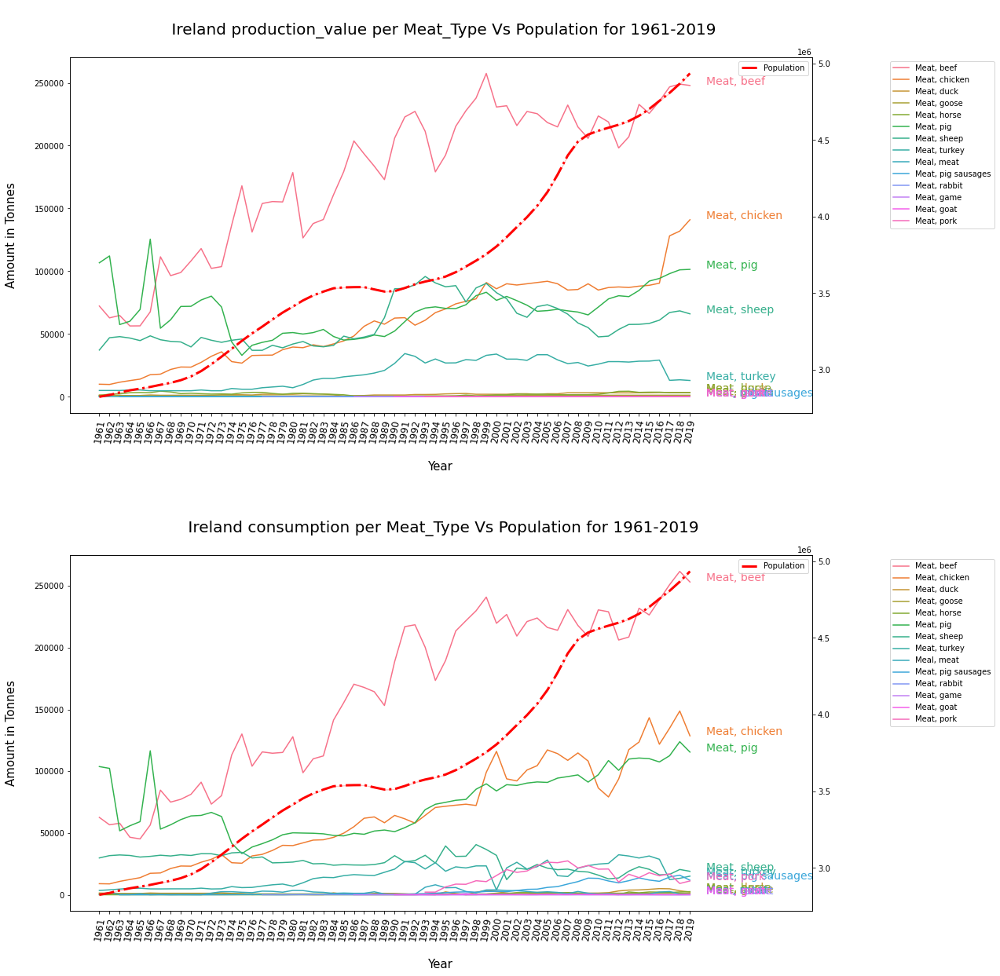

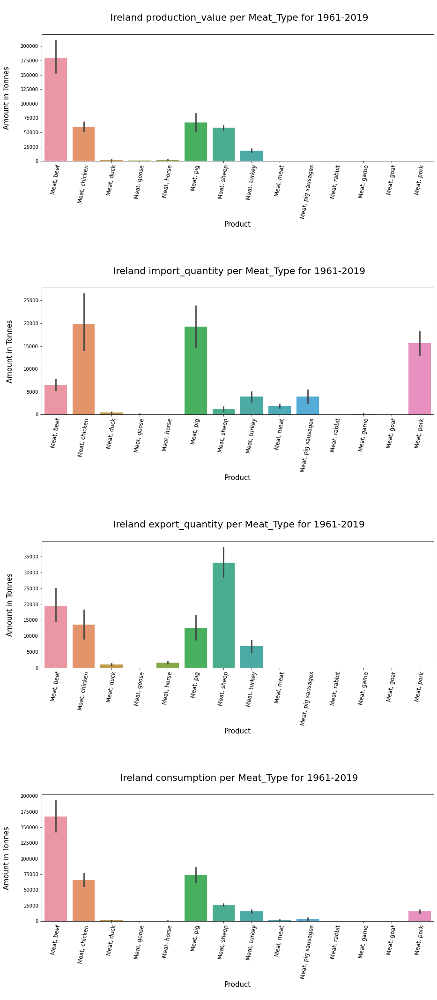

In [101]:
# ireland meat visuals
plotlinegraphs(ireland_meat, 'Meat_Type', 'Ireland ', 'Population_Ireland', ireland_meat_list)
plotfigures(ireland_meat, 'Meat_Type', 'Ireland ');

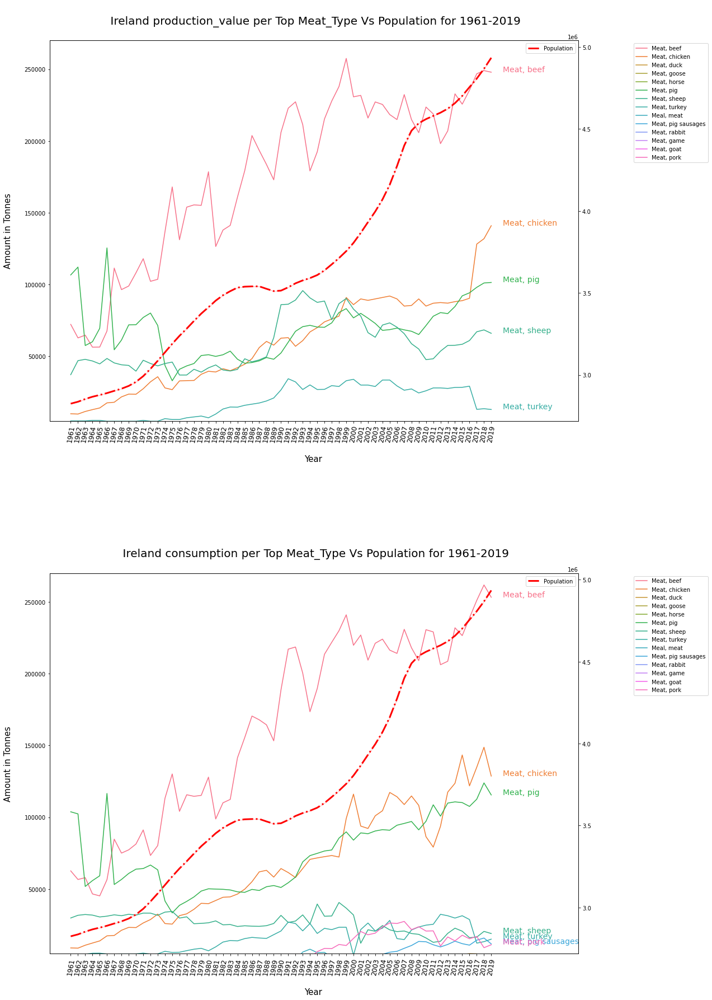

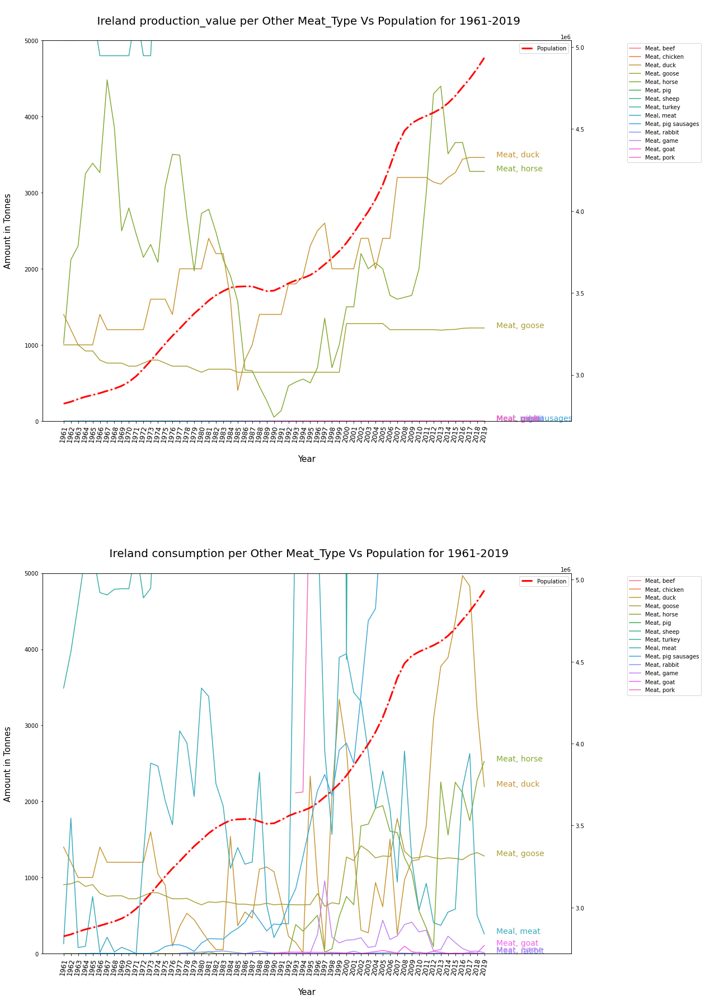

In [102]:
# ireland meat visuals more detail
plotlinegraphsii(ireland_meat, 'Meat_Type',  5000, 270000, 'Ireland ', 'Population_Ireland', ireland_meat_list, 'Top ')
plotlinegraphsii(ireland_meat, 'Meat_Type',  0, 5000, 'Ireland ', 'Population_Ireland', ireland_meat_list, 'Other ')

#### Dairy

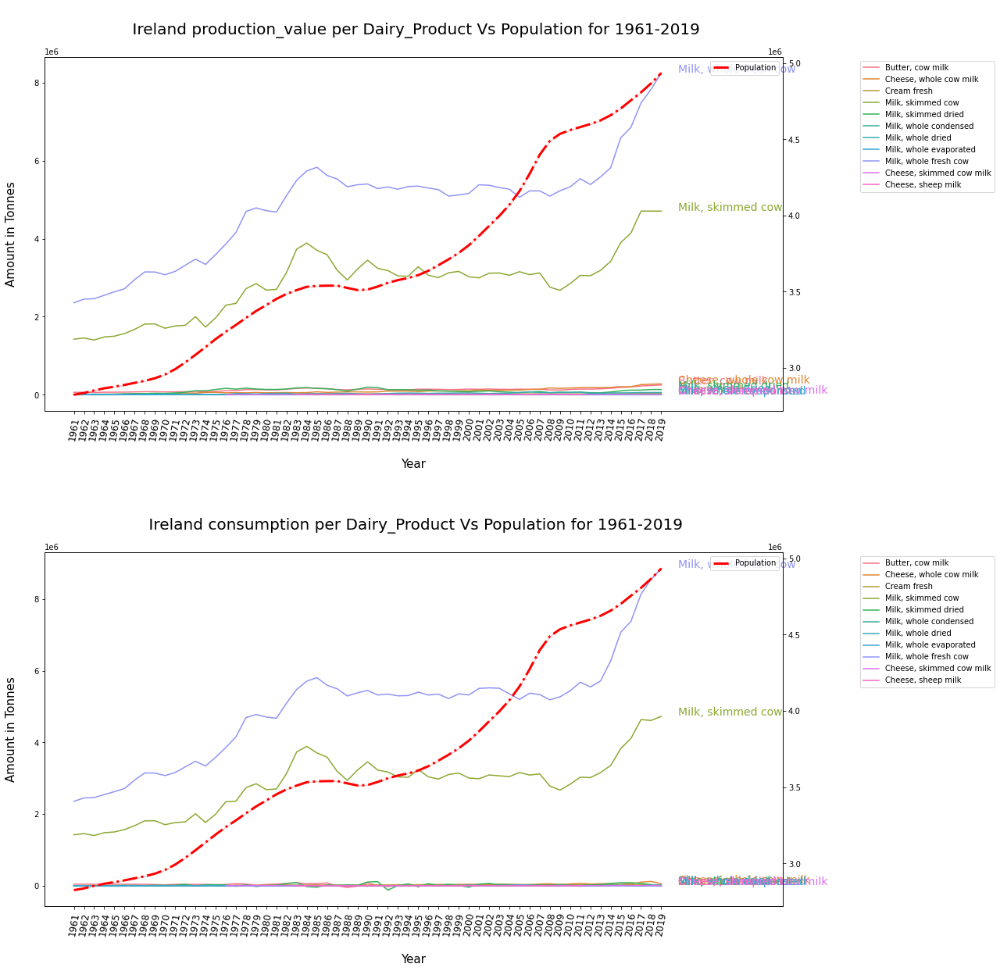

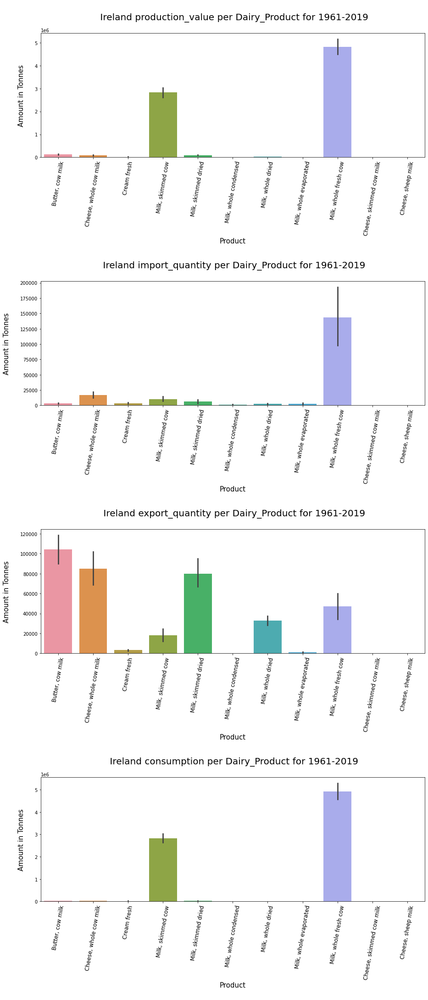

In [103]:
# ireland dairy visuals 
plotlinegraphs(ireland_dairy, 'Dairy_Product', 'Ireland ', 'Population_Ireland', ireland_dairy_list)
plotfigures(ireland_dairy, 'Dairy_Product', 'Ireland ');

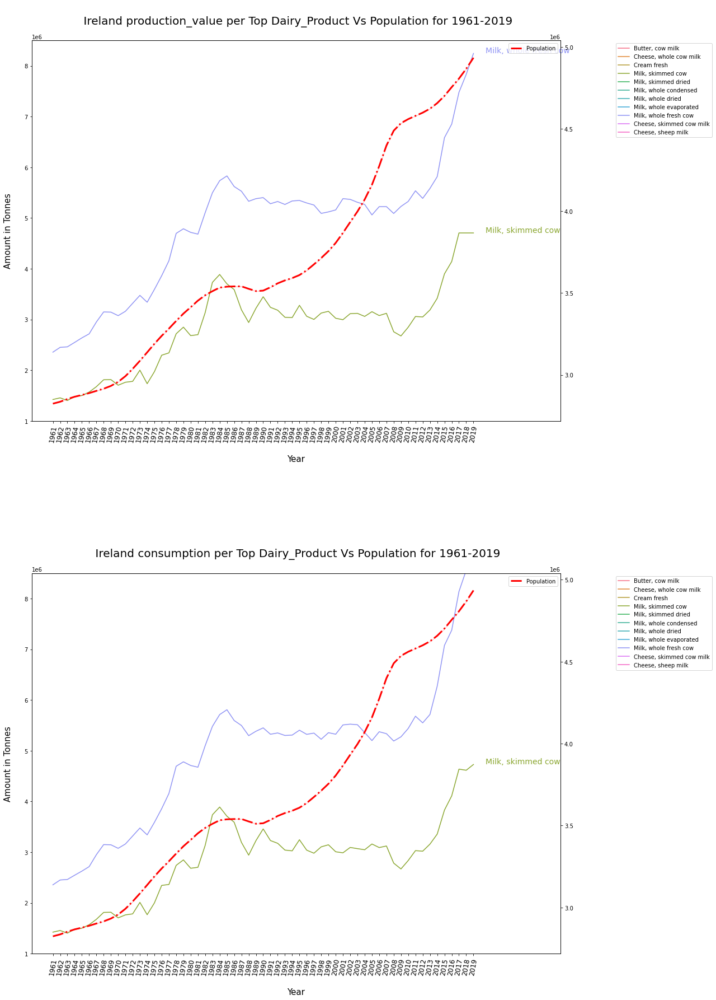

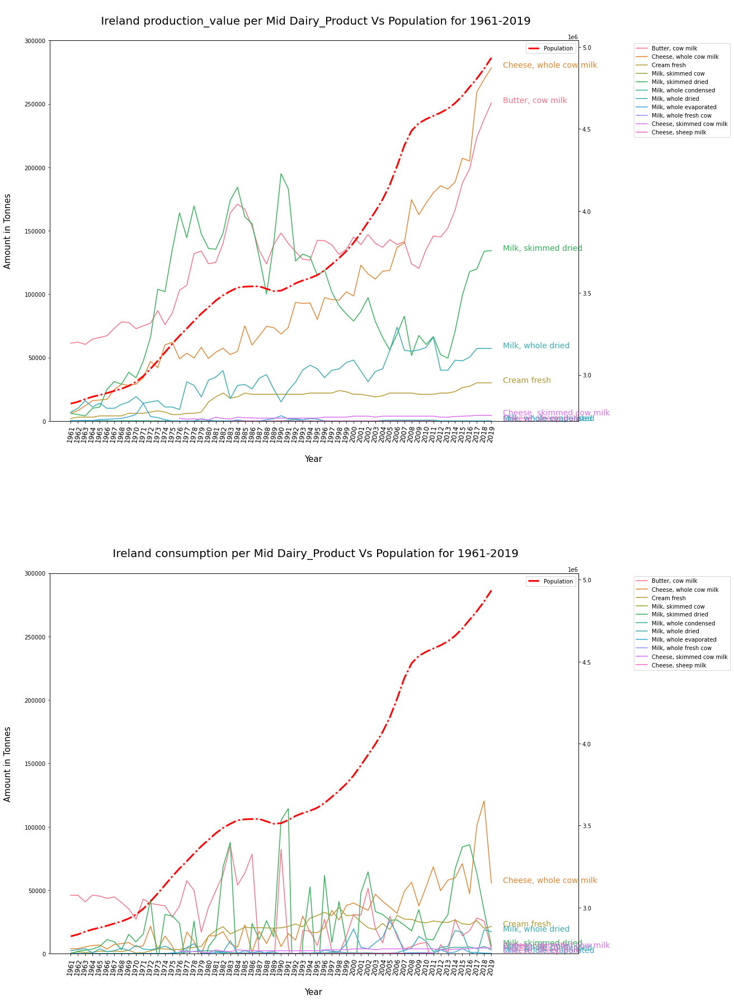

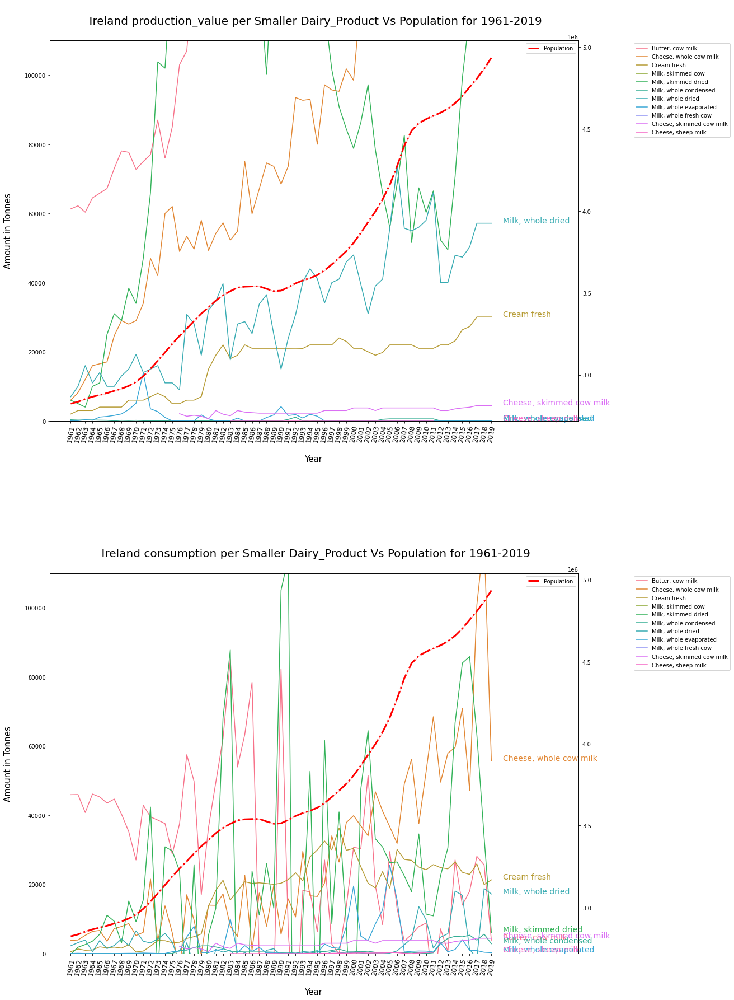

In [104]:
# ireland dairu visuals more detail
plotlinegraphsii(ireland_dairy, 'Dairy_Product', 1000000, 8500000, 'Ireland ', 'Population_Ireland', ireland_dairy_list, 'Top ')
plotlinegraphsii(ireland_dairy, 'Dairy_Product', 0, 300000, 'Ireland ', 'Population_Ireland', ireland_dairy_list,  'Mid ')
plotlinegraphsii(ireland_dairy, 'Dairy_Product', 0, 110000, 'Ireland ', 'Population_Ireland', ireland_dairy_list,  'Smaller ')

#### Crops 

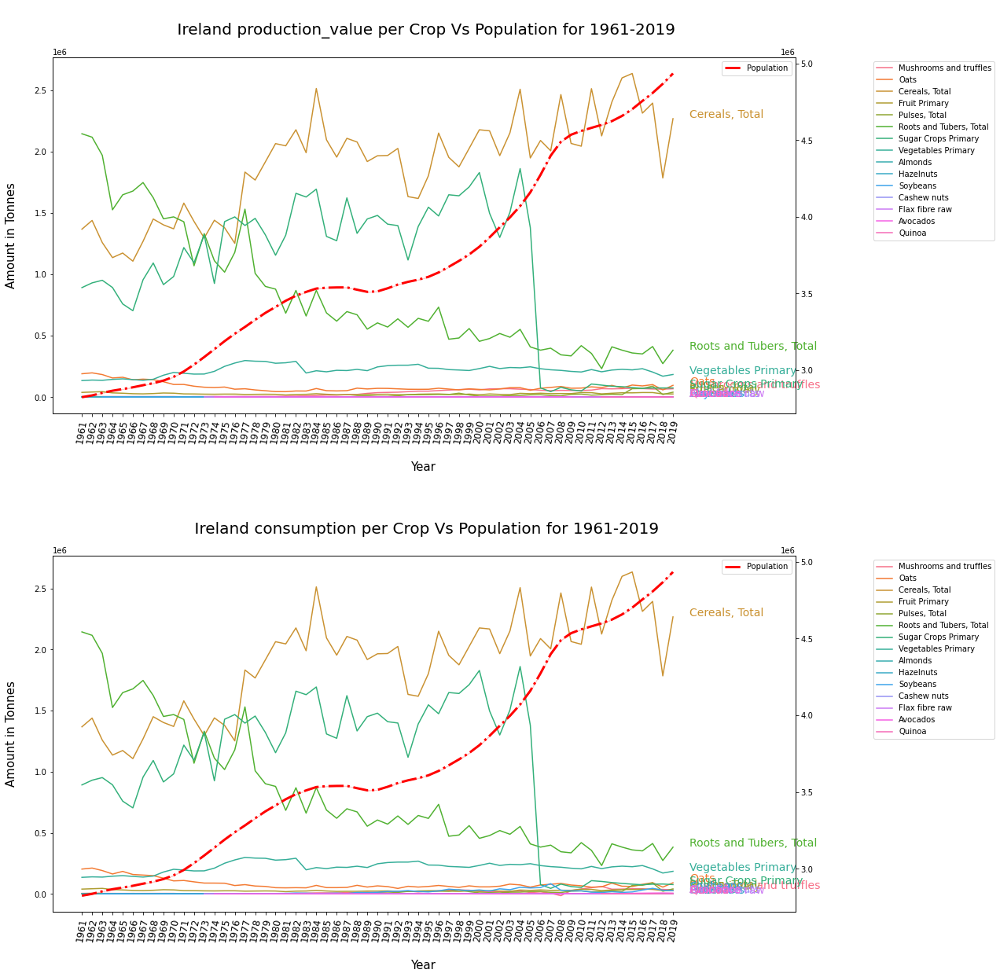

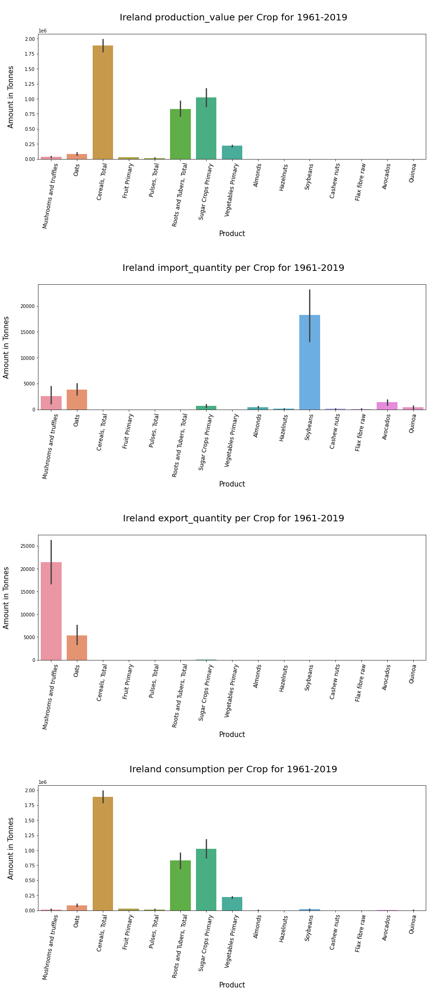

In [105]:
# ireland crop visuals 
plotlinegraphs(ireland_crop, 'Crop', 'Ireland ', 'Population_Ireland', ireland_crop_list)
plotfigures(ireland_crop, 'Crop', 'Ireland ');

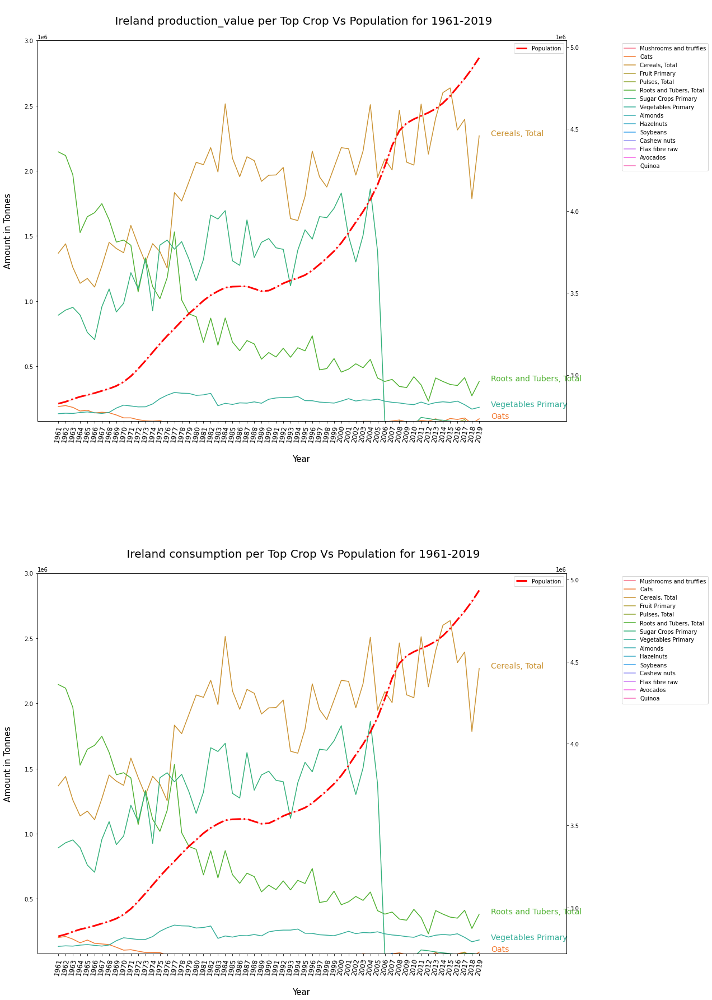

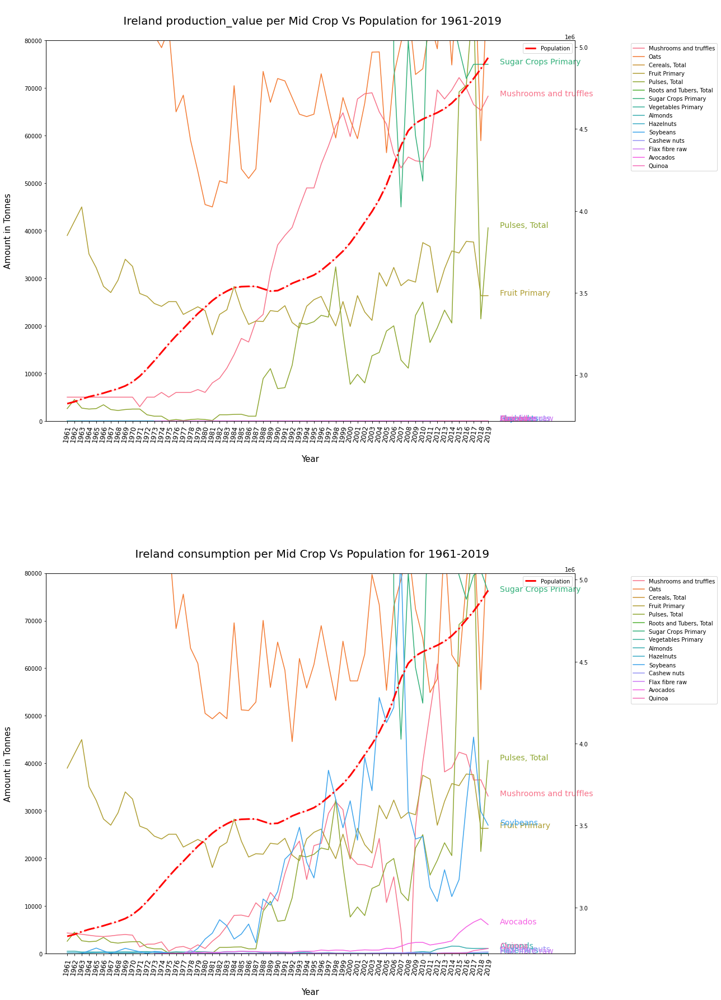

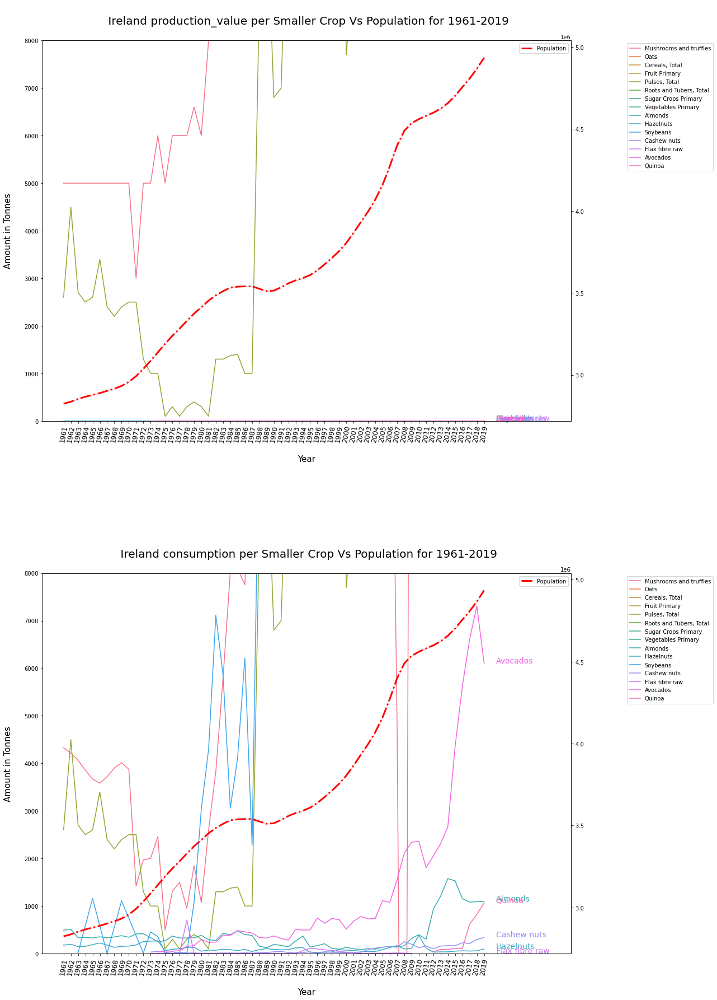

In [106]:
# ireland crop visuals more detail 
plotlinegraphsii(ireland_crop, 'Crop', 80000, 3000000, 'Ireland ', 'Population_Ireland', ireland_crop_list, 'Top ')
plotlinegraphsii(ireland_crop, 'Crop', 0, 80000, 'Ireland ', 'Population_Ireland', ireland_crop_list, 'Mid ')
plotlinegraphsii(ireland_crop, 'Crop', 0, 8000, 'Ireland ', 'Population_Ireland', ireland_crop_list, 'Smaller ')

### Ireland Production Pivot Table

In [107]:
#ireland_dairy_prod as a pivot table to see dairy poduct values per year

ireland_meat_table = pd.pivot_table(ireland_meat, values='production_value', index=['prod_country', 'year'],
                    columns=['Meat_Type'], aggfunc=np.sum, fill_value=0)


ireland_dairy_table = pd.pivot_table(ireland_dairy, values='production_value', index=['prod_country', 'year'],
                    columns=['Dairy_Product'], aggfunc=np.sum, fill_value=0)


ireland_crop_table = pd.pivot_table(ireland_crop, values='production_value', index=['prod_country', 'year'],
                    columns=['Crop'], aggfunc=np.sum, fill_value=0)

In [108]:
ireland_meat_table

Meat_Type          Meal, meat  Meat, beef  Meat, chicken  Meat, duck  \
prod_country year                                                      
Ireland      1961           0      289078          10000        1400   
             1962           0      251378           9800        1200   
             1963           0      259026          11600        1000   
             1964           0      225596          12880        1000   
             1965           0      225886          14050        1000   
             1966           0      270514          17580        1400   
             1967           0      445914          18020        1200   
             1968           0      385898          21760        1200   
             1969           0      395910          23700        1200   
             1970           0      432678          23600        1200   
             1971           0      472080          27430        1200   
             1972           0      409014          32240        1200   
             1973           0      414600          35800        1600   
             1974           0      684000          28000        1600   
             1975           0      840000          26800        1600   
             1976           0      656000          32880        1400   
             1977           0      769600          33080        2000   
             1978           0      777400          33200        2000   
             1979           0      775800          37500        2000   
             1980           0      892800          39600        2000   
             1981           0      632600          39100        2400   
             1982           0      689800          41400        2200   
             1983           0      706000          40000        2200   
             1984           0      804562          42100        1600   
             1985           0      896452          44500         400   
             1986           0     1018886          48400         800   
             1987           0      967240          56100        1000   
             1988           0      918200          60400        1400   
             1989           0      864800          57800        1400   
             1990           0     1030000          62672        1400   
             1991           0     1114200          63000        1400   
             1992           0     1136400          57000        1800   
             1993           0     1057000          60950        1800   
             1994           0      895600          67000        1900   
             1995           0      962200          70000        2300   
             1996           0     1076800          74000        2500   
             1997           0     1139000          76000        2600   
             1998           0     1189600          78000        2000   
             1999           0     1287600          91000        2000   
             2000           0     1153800          86000        2000   
             2001           0     1158800          90000        2000   
             2002           0     1080000          89000        2400   
             2003           0     1136000          90000        2400   
             2004           0     1127200          91000        2000   
             2005           0     1092000          92000        2400   
             2006           0     1074600          90000        2400   
             2007           0     1161600          85000        3200   
             2008           0     1074600          85450        3200   
             2009           0     1029000          90000        3200   
             2010           0     1118200          85000        3200   
             2011           0     1094200          87000        3200   
             2012           0      990800          87459        3139   
             2013           0     1035200          87046        3112   
             2014           0     116420

In [109]:
ireland_dairy_table

Dairy_Product      Butter, cow milk  Cheese, sheep milk  \
prod_country year                                         
Ireland      1961             61300                   0   
             1962             62200                   0   
             1963             60346                   0   
             1964             64500                   0   
             1965             65845                   0   
             1966             67197                   0   
             1967             73000                   0   
             1968             78069                   0   
             1969             77674                   0   
             1970             72752                   0   
             1971             75000                   0   
             1972             77043                   0   
             1973             87000                   0   
             1974             76000                   0   
             1975             85000                   0   
             1976            103000                   0   
             1977            107000                   0   
             1978            132000                   0   
             1979            134000                   0   
             1980            124000                   0   
             1981            125000                   0   
             1982            140000                   0   
             1983            164000                   0   
             1984            171000                   0   
             1985            167000                   0   
             1986            153496                   0   
             1987            134394                   0   
             1988            123800                   0   
             1989            139100                   0   
             1990            148200                   0   
             1991            140000                   0   
             1992            133600                   0   
             1993            127500                   0   
             1994            126800                   0   
             1995            142400                   0   
             1996            142200                   0   
             1997            138800                   0   
             1998            131300                   0   
             1999            135300                   0   
             2000            145000                   0   
             2001            139000                   0   
             2002            147000                   0   
             2003            140100                   0   
             2004            136900                   0   
             2005            143000                   0   
             2006            139100                   0   
             2007            141400                   0   
             2008            123800                   0   
             2009            120300                   0   
             2010            135100                   0   
             2011            145900                   0   
             2012            145000                   0   
             2013            152100                   0   
             2014            166370                   0   
             2015            187490                   0   
             2016            198700                   0   
             2017            223700                   0   
             2018            237800                   0   
             2019            250800                   0   

Dairy_Product      Cheese, skimmed cow milk  Cheese, whole cow milk  \
prod_country year                                                     
Ireland      1961                         0                    6000   
             1962                         0                    8165   
             1963                         0                   12000   
             1964                         0  

In [110]:
ireland_crop_table

Crop               Almonds  Avocados  Cashew nuts  Cereals, Total  \
prod_country year                                                   
Ireland      1961        0         0            0         1367919   
             1962        0         0            0         1439216   
             1963        0         0            0         1258816   
             1964        0         0            0         1136399   
             1965        0         0            0         1173711   
             1966        0         0            0         1107600   
             1967        0         0            0         1269300   
             1968        0         0            0         1450800   
             1969        0         0            0         1403200   
             1970        0         0            0         1371000   
             1971        0         0            0         1580400   
             1972        0         0            0         1431400   
             1973        0         0            0         1296500   
             1974        0         0            0         1440900   
             1975        0         0            0         1379700   
             1976        0         0            0         1253000   
             1977        0         0            0         1833000   
             1978        0         0            0         1768000   
             1979        0         0            0         1916000   
             1980        0         0            0         2064800   
             1981        0         0            0         2046800   
             1982        0         0            0         2177700   
             1983        0         0            0         1990700   
             1984        0         0            0         2513800   
             1985        0         0            0         2095800   
             1986        0         0            0         1954800   
             1987        0         0            0         2107800   
             1988        0         0            0         2077800   
             1989        0         0            0         1918800   
             1990        0         0            0         1965820   
             1991        0         0            0         1968048   
             1992        0         0            0         2025771   
             1993        0         0            0         1633159   
             1994        0         0            0         1618110   
             1995        0         0            0         1803330   
             1996        0         0            0         2150592   
             1997        0         0            0         1952836   
             1998        0         0            0         1875440   
             1999        0         0            0         2025967   
             2000        0         0            0         2177490   
             2001        0         0            0         2169041   
             2002        0         0            0         1966955   
             2003        0         0            0         2152353   
             2004        0         0            0         2507508   
             2005        0         0            0         1947926   
             2006        0         0            0         2090356   
             2007        0         0            0         2006462   
             2008        0         0            0         2463993   
             2009        0         0            0         2066175   
             2010        0         0            0         2043781   
             2011        0         0            0         2512187   
             2012        0         0            0         2127500   
             2013        0         0            0         2403000   
             2014        0         0            0         2599817   
             2015        0         0            0         2635749   
             2016        0         0            0         2312985  

### Descriptive Statistics per product for all years

The FAO datasets are free of outliers, however, outliers will appear when looking at boxplots per product for all years as this data is presented in Pivot table format and will show 0 values for years where production on an item had not yet started. 

In [111]:
ireland_meat_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
ireland_dairy_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
ireland_crop_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))

Meat_Type,"Meal, meat","Meat, beef","Meat, chicken","Meat, duck","Meat, game","Meat, goat","Meat, goose","Meat, horse","Meat, pig","Meat, pig sausages","Meat, pork","Meat, rabbit","Meat, sheep","Meat, turkey"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,0.00,860576.14,59700.63,2027.85,0.00,0.00,895.58,2143.64,183311.92,0.00,0.00,0.00,58237.20,18388.15
std,0.00,320058.14,32417.78,815.03,0.00,0.00,256.60,1169.25,54731.48,0.00,0.00,0.00,17314.02,10845.82
min,0.00,225596.00,9800.00,400.00,0.00,0.00,640.00,49.00,99000.00,0.00,0.00,0.00,37000.00,4800.00
25%,0.00,670000.00,32980.00,1400.00,0.00,0.00,640.00,1425.00,139798.50,0.00,0.00,0.00,44874.00,6300.00
50%,0.00,967240.00,60400.00,2000.00,0.00,0.00,760.00,2119.00,160900.00,0.00,0.00,0.00,49700.00,17500.00
75%,0.00,1122700.00,87252.50,2450.00,0.00,0.00,1200.00,3164.00,219350.00,0.00,0.00,0.00,69355.00,28377.00
max,0.00,1287600.00,141000.00,3463.00,0.00,0.00,1280.00,4483.00,304370.00,0.00,0.00,0.00,95800.00,34400.00


Dairy_Product,"Butter, cow milk","Cheese, sheep milk","Cheese, skimmed cow milk","Cheese, whole cow milk",Cream fresh,"Milk, skimmed cow","Milk, skimmed dried","Milk, whole condensed","Milk, whole dried","Milk, whole evaporated","Milk, whole fresh cow"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,128565.69,0.00,2177.15,94560.46,16555.75,2838690.03,95745.03,143.90,33092.46,910.59,4830551.66
std,42503.10,0.00,1508.31,67146.03,8429.71,837199.85,50922.80,242.05,17037.72,2062.49,1322615.23
min,60346.00,0.00,0.00,6000.00,2000.00,1402856.00,4000.00,0.00,7000.00,0.00,2356000.00
25%,95000.00,0.00,300.00,49500.00,6500.00,2148370.00,58100.00,0.00,16000.00,0.00,3727850.00
50%,135100.00,0.00,2250.00,74600.00,21000.00,3043344.00,99100.00,0.00,33800.00,0.00,5228300.00
75%,145000.00,0.00,3750.00,120800.00,22000.00,3189420.00,134650.00,195.00,45000.00,1207.50,5384785.00
max,250800.00,0.00,4435.00,278400.00,30064.00,4706000.00,195000.00,1080.00,74000.00,13825.00,8244870.00


Crop,Almonds,Avocados,Cashew nuts,"Cereals, Total",Flax fibre raw,Fruit Primary,Hazelnuts,Mushrooms and truffles,Oats,"Pulses, Total",Quinoa,"Roots and Tubers, Total",Soybeans,Sugar Crops Primary,Vegetables Primary
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,0.00,0.00,0.00,1889416.07,0.00,27520.20,0.00,34359.93,170535.73,13223.20,0.00,830163.42,0.00,1024068.02,218705.81
std,0.00,0.00,0.00,405657.04,0.00,6108.71,0.00,26720.06,73002.19,17734.10,0.00,508387.54,0.00,590359.84,42216.43
min,0.00,0.00,0.00,1107600.00,0.00,18100.00,0.00,3000.00,90000.00,100.00,0.00,232000.00,0.00,45000.00,135400.00
25%,0.00,0.00,0.00,1515600.00,0.00,23200.00,0.00,6000.00,128500.00,1387.50,0.00,437200.00,0.00,731747.50,199041.50
50%,0.00,0.00,0.00,1966955.00,0.00,26200.00,0.00,37000.00,146000.00,7700.00,0.00,638000.00,0.00,1274000.00,221192.00
75%,0.00,0.00,0.00,2139046.00,0.00,31597.00,0.00,60900.00,187900.00,20166.00,0.00,1090450.00,0.00,1462000.00,244077.50
max,0.00,0.00,0.00,2635749.00,0.00,45000.00,0.00,72200.00,396000.00,90046.00,0.00,2145000.00,0.00,1861400.00,298500.00


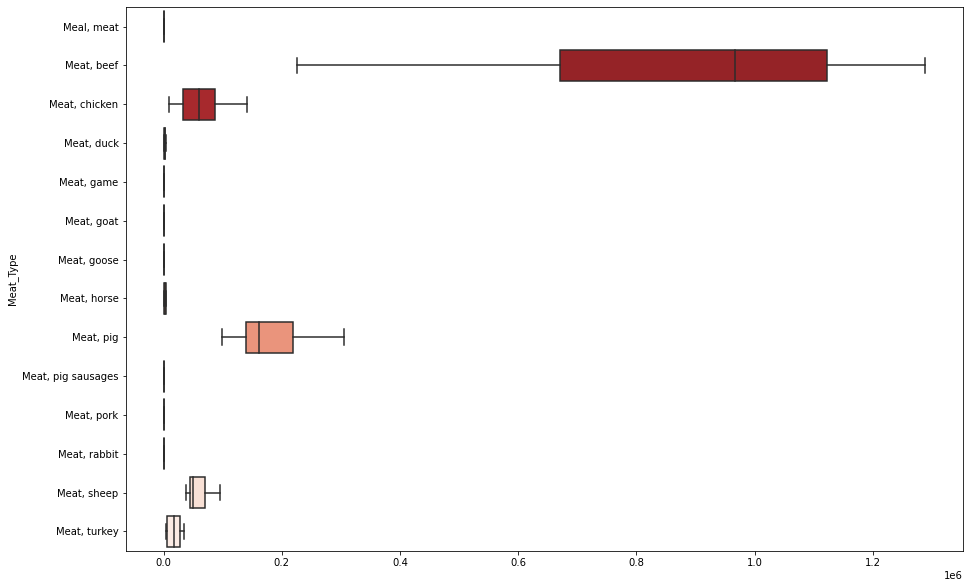

In [112]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=ireland_meat_table, orient='h', palette='Reds_r');

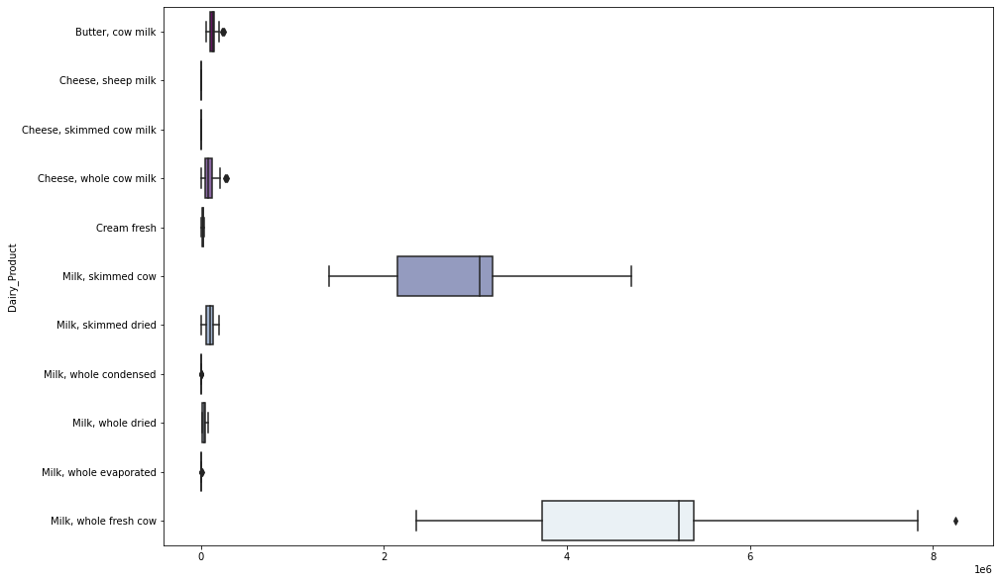

In [113]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=ireland_dairy_table, orient='h', palette='BuPu_r');

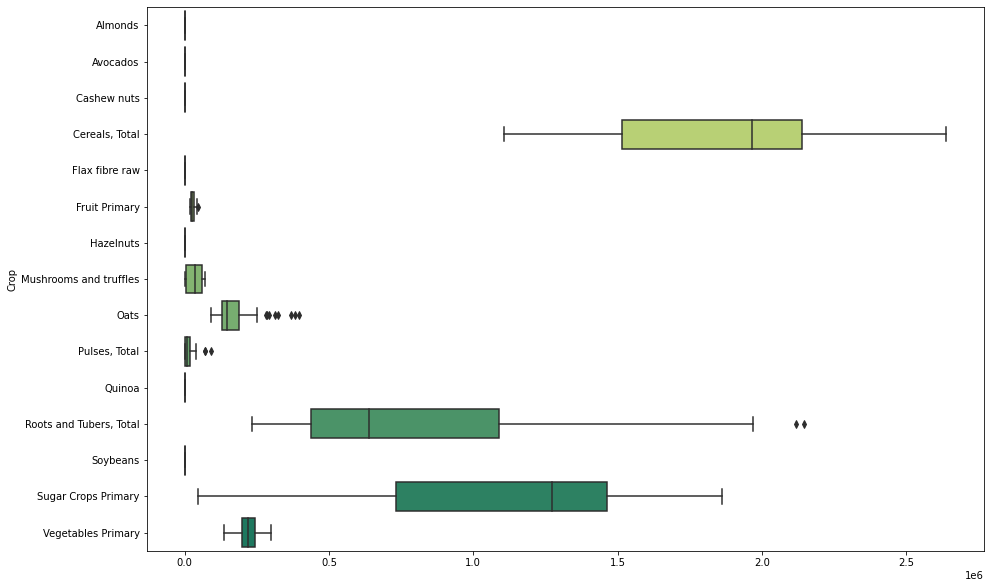

In [114]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=ireland_crop_table, orient='h', palette='summer_r');

In [115]:
ireland_meat_table.columns 

Index(['Meal, meat', 'Meat, beef', 'Meat, chicken', 'Meat, duck', 'Meat, game',
       'Meat, goat', 'Meat, goose', 'Meat, horse', 'Meat, pig',
       'Meat, pig sausages', 'Meat, pork', 'Meat, rabbit', 'Meat, sheep',
       'Meat, turkey'],
      dtype='object', name='Meat_Type')

In [116]:
ireland_meat_columns = ['Meal, meat', 'Meat, beef', 'Meat, chicken', 'Meat, duck', 'Meat, game',
       'Meat, goat', 'Meat, goose', 'Meat, horse', 'Meat, pig',
       'Meat, pig sausages', 'Meat, pork', 'Meat, rabbit', 'Meat, sheep', 'Meat, turkey']

## GERMANY

 ## Germany Production Datasets

In [117]:
# create german dataset
germany_prod_df = europe_melt.loc[europe_melt['Country']=='Germany']

# german production dataset - all products (crop, meat, livestock)
germany_prod = germany_prod_df.loc[germany_prod_df['Element']=='Production']

# rename columns
germany_prod.rename(columns={'Country': 'Prod Country', 'Unit': 'Production Unit', 'Value': 'Production Value' }, inplace=True)

#reset index
germany_prod.reset_index(drop=True, inplace=True)

germany_prod



,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value
0,Germany,Apples,Production,tonnes,1961,851000.0
1,Germany,Apricots,Production,tonnes,1961,2900.0
2,Germany,Asparagus,Production,tonnes,1961,16300.0
3,Germany,Avocados,Production,tonnes,1961,NaN
4,Germany,Bananas,Production,tonnes,1961,NaN
...,...,...,...,...,...,...
9789,Germany,Sheep and Goat Meat,Production,tonnes,2019,35000.0
9790,Germany,"Skim Milk&Buttermilk,Dry",Production,tonnes,2019,437549.0
9791,Germany,Sugar Crops Primary,Production,tonnes,2019,29728300.0
9792,Germany,"Treenuts, Total",Production,tonnes,2019,NaN


### Germany Missing Values 

In [118]:
#ireland_prod as a pivot table to see what values we need to replace for 2018/2019 only

germany_prod_table = pd.pivot_table(germany_prod, values='Production Value', index=['Prod Country', 'Element', 'Production Unit', 'Year'],
                    columns=['Crop_Livestock'], aggfunc=np.sum, fill_value=0)
germany_prod_table

Crop_Livestock                                 Apples  Apricots  Asparagus  \
Prod Country Element    Production Unit Year                                 
Germany      Production 1000 No         1961        0         0          0   
                                        1962        0         0          0   
                                        1963        0         0          0   
                                        1964        0         0          0   
                                        1965        0         0          0   
...                                               ...       ...        ...   
                        tonnes          2015   973462       232     113613   
                                        2016  1032913       229     120014   
                                        2017   596666       227     130881   
                                        2018  1198520         0     133020   
                                        2019   991450         0     130560   

Crop_Livestock                                Avocados  Bananas    Barley  \
Prod Country Element    Production Unit Year                                
Germany      Production 1000 No         1961         0        0         0   
                                        1962         0        0         0   
                                        1963         0        0         0   
                                        1964         0        0         0   
                                        1965         0        0         0   
...                                                ...      ...       ...   
                        tonnes          2015         0        0  11629900   
                                        2016         0        0  10730500   
                                        2017         0        0  10853400   
                                        2018         0        0   9583600   
                                        2019         0        0  11591500   

Crop_Livestock                                Beans, dry  Beans, green  \
Prod Country Element    Production Unit Year                             
Germany      Production 1000 No         1961           0             0   
                                        1962           0             0   
                                        1963           0             0   
                                        1964           0             0   
                                        1965           0             0   
...                                                  ...           ...   
                        tonnes          2015           0         47442   
                                        2016           0         45634   
                                        2017           0         51469   
                                        2018           0         41180   
                                        2019           0         39710   

Crop_Livestock                                Beef and Buffalo Meat  \
Prod Country Element    Production Unit Year                          
Germany      Production 1000 No         1961                      0   
                                        1962                      0   
                                        1963                      0   
                                        1964                      0   
                                        1965                      0   
...                                                             ...   
                        tonnes          2015                1132340   
                                        2016                1155483   
                                        2017                1137008   
                                        2018                1109000   
                                        2019                1107000   

Crop_Livestock                                Beer of barley  ...  Vetches  \
Prod Country Eleme

In [119]:
# search tab to identify what 2018/2019 data to be replaces & identify iloc 
germany_prod.loc[germany_prod['Crop_Livestock']=='Cream fresh']

,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value
24,Germany,Cream fresh,Production,tonnes,1961,125000.0
190,Germany,Cream fresh,Production,tonnes,1962,133000.0
356,Germany,Cream fresh,Production,tonnes,1963,140000.0
522,Germany,Cream fresh,Production,tonnes,1964,146000.0
688,Germany,Cream fresh,Production,tonnes,1965,153000.0
854,Germany,Cream fresh,Production,tonnes,1966,166000.0
1020,Germany,Cream fresh,Production,tonnes,1967,172000.0
1186,Germany,Cream fresh,Production,tonnes,1968,186000.0
1352,Germany,Cream fresh,Production,tonnes,1969,199000.0
1518,Germany,Cream fresh,Production,tonnes,1970,211000.0


In [120]:
# replace missing 2018/ 2019 values with last recorded value 

germany_prod.iloc[[9463, 9629],[5]] = 227.0
germany_prod.iloc[[9478, 9644],[5]] = 2040.0
germany_prod.iloc[[9479, 9645],[5]] = 791400.0
germany_prod.iloc[[9480, 9646],[5]] = 1484200.0
germany_prod.iloc[[9499, 9665],[5]] = 2703.0
germany_prod.iloc[[9501, 9667],[5]] = 86160.0
germany_prod.iloc[[9510, 9676],[5]] = 21600.0
germany_prod.iloc[[9526, 9692],[5]] = 58400.0
germany_prod.iloc[[9531, 9697],[5]] = 32532.0
germany_prod.iloc[[9534, 9700],[5]] = 13800937.0
germany_prod.iloc[[9535, 9701],[5]] = 430400.0
germany_prod.iloc[[9536, 9702],[5]] = 27000.0
germany_prod.iloc[[9537, 9703],[5]] = 37363.0
germany_prod.iloc[[9538, 9704],[5]] = 134800.0
germany_prod.iloc[[9539, 9705],[5]] = 376407.0
germany_prod.iloc[[9546, 9712],[5]] = 8194.0
germany_prod.iloc[[9561, 9727],[5]] = 12851.0
germany_prod.iloc[[9567, 9733],[5]] = 91603.0
germany_prod.iloc[[9569, 9735],[5]] = 562.0
germany_prod.iloc[[9574, 9740],[5]] = 2905.0
germany_prod.iloc[[9576, 9742],[5]] = 13141.0
germany_prod.iloc[[9591, 9757],[5]] = 38164.0
germany_prod.iloc[[9593, 9759],[5]] = 6218.0
germany_prod.iloc[[9599, 9765],[5]] = 18261.0
germany_prod.iloc[[9602, 9768],[5]] = 29446.0
germany_prod.iloc[[9603, 9769],[5]] = 345200.0
germany_prod.iloc[[9626, 9792],[5]] = 18261.0
germany_prod.iloc[[9486, 9652],[5]] = 578000.0

In [121]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
germany_prod.replace(to_replace = 0, value = np.nan, inplace=True)

# row = 0, column = 1
germany_prod = germany_prod.dropna(axis=0)

# check if we have any NaN values in our dataset
germany_prod.isnull().values.any()

False

In [122]:
# cast value as int 
germany_prod['Production Value'] = germany_prod['Production Value'].astype('int')

### Germany Production- Add Population

In [123]:
# merge population data. Outer merge so no data is lost 
germany_prod_pop = pd.merge(germany_prod, germany_pop, how="outer", on = ["Year"])
germany_prod_pop.head()

,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value,Population_Germany
0,Germany,Apples,Production,tonnes,1961,851000,73377632
1,Germany,Apricots,Production,tonnes,1961,2900,73377632
2,Germany,Asparagus,Production,tonnes,1961,16300,73377632
3,Germany,Barley,Production,tonnes,1961,3669020,73377632
4,Germany,"Beans, dry",Production,tonnes,1961,12693,73377632


In [124]:
germany_prod_pop.shape

(7163, 7)

###  Germany Production Analysis

In [125]:
# german production meat products
germany_meat_prod = germany_prod_pop.loc[germany_prod_pop['Crop_Livestock'].str.contains('meat', case=False)]
germany_meat_prod.rename(columns={'Crop_Livestock': 'Meat Type'}, inplace=True)
germany_meat_prod.reset_index(drop=True)

# german production dairy products
germany_dairy_prod =  germany_prod_pop.loc[ germany_prod_pop['Crop_Livestock'].str.contains('milk', case=False)]
germany_dairy_prod.rename(columns={'Crop_Livestock': 'Dairy Product'}, inplace=True)
germany_dairy_prod.reset_index(drop=True)

# german production crops
germany_crop_prod = germany_prod_pop.loc[germany_prod_pop['Crop_Livestock'].str.contains('meat', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('milk', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('offals', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('fat', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('hides', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('wool', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('sheep', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('cream', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('egg', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('lard', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('butter', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('cheese', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('oil', case=False) == False]
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop_Livestock'].str.contains('skin', case=False) == False]

germany_crop_prod.rename(columns={'Crop_Livestock': 'Crop'}, inplace=True)
germany_crop_prod.reset_index(drop=True)


,Prod Country,Meat Type,Element,Production Unit,Year,Production Value,Population_Germany
0,Germany,"Meat, cattle",Production,tonnes,1961,1296200,73377632
1,Germany,"Meat, chicken",Production,tonnes,1961,150100,73377632
2,Germany,"Meat, duck",Production,tonnes,1961,10080,73377632
3,Germany,"Meat, game",Production,tonnes,1961,17000,73377632
4,Germany,"Meat, goat",Production,tonnes,1961,5648,73377632
...,...,...,...,...,...,...,...
878,Germany,"Meat, turkey",Production,tonnes,2019,471000,83092962
879,Germany,Beef and Buffalo Meat,Production,tonnes,2019,1107000,83092962
880,Germany,"Meat, Poultry",Production,tonnes,2019,1543866,83092962
881,Germany,"Meat, Total",Production,tonnes,2019,7919216,83092962


,Prod Country,Dairy Product,Element,Production Unit,Year,Production Value,Population_Germany
0,Germany,"Butter, cow milk",Production,tonnes,1961,633900,73377632
1,Germany,"Cheese, goat milk",Production,tonnes,1961,39600,73377632
2,Germany,"Cheese, skimmed cow milk",Production,tonnes,1961,175300,73377632
3,Germany,"Cheese, whole cow milk",Production,tonnes,1961,204700,73377632
4,Germany,"Milk, skimmed cow",Production,tonnes,1961,14356399,73377632
...,...,...,...,...,...,...,...
869,Germany,"Milk, whole fresh goat",Production,tonnes,2019,15890,83092962
870,Germany,"Milk, whole fresh sheep",Production,tonnes,2019,6500,83092962
871,Germany,Evaporat&Condensed Milk,Production,tonnes,2019,604659,83092962
872,Germany,"Milk, Total",Production,tonnes,2019,33102570,83092962


,Prod Country,Crop,Element,Production Unit,Year,Production Value,Population_Germany
0,Germany,Apples,Production,tonnes,1961,851000,73377632
1,Germany,Apricots,Production,tonnes,1961,2900,73377632
2,Germany,Asparagus,Production,tonnes,1961,16300,73377632
3,Germany,Barley,Production,tonnes,1961,3669020,73377632
4,Germany,"Beans, dry",Production,tonnes,1961,12693,73377632
...,...,...,...,...,...,...,...
3953,Germany,"Pulses, Total",Production,tonnes,2019,413300,83092962
3954,Germany,"Roots and Tubers, Total",Production,tonnes,2019,10602200,83092962
3955,Germany,Sugar Crops Primary,Production,tonnes,2019,29728300,83092962
3956,Germany,"Treenuts, Total",Production,tonnes,2019,18261,83092962


In [126]:
# check Meat Type values are what we want for analysis
germany_meat_prod['Meat Type'].unique()

array(['Meat, cattle', 'Meat, chicken', 'Meat, duck', 'Meat, game',
       'Meat, goat', 'Meat, goose and guinea fowl', 'Meat, horse',
       'Meat, pig', 'Meat, rabbit', 'Meat, sheep', 'Meat, turkey',
       'Beef and Buffalo Meat', 'Meat, Poultry', 'Meat, Total',
       'Sheep and Goat Meat'], dtype=object)

In [127]:
# remove any items we dont want 
germany_meat_prod = germany_meat_prod.loc[germany_meat_prod['Meat Type'] != 'Meat nes']
germany_meat_prod = germany_meat_prod.loc[germany_meat_prod['Meat Type'] != 'Meat, Total']

In [128]:
germany_dairy_prod['Dairy Product'].unique()

array(['Butter, cow milk', 'Cheese, goat milk',
       'Cheese, skimmed cow milk', 'Cheese, whole cow milk',
       'Milk, skimmed cow', 'Milk, skimmed dried',
       'Milk, skimmed evaporated', 'Milk, whole dried',
       'Milk, whole evaporated', 'Milk, whole fresh cow',
       'Milk, whole fresh goat', 'Evaporat&Condensed Milk', 'Milk, Total',
       'Skim Milk&Buttermilk,Dry', 'Milk, whole condensed',
       'Milk, whole fresh sheep'], dtype=object)

In [129]:
germany_dairy_prod = germany_dairy_prod.loc[germany_dairy_prod['Dairy Product'] != 'Milk, Total']
germany_dairy_prod = germany_dairy_prod.loc[germany_dairy_prod['Dairy Product'] != 'Evaporat&Condensed Milk']

In [130]:
germany_crop_prod['Crop'].unique()

array(['Apples', 'Apricots', 'Asparagus', 'Barley', 'Beans, dry',
       'Beans, green', 'Beer of barley', 'Broad beans, horse beans, dry',
       'Cabbages and other brassicas', 'Carrots and turnips',
       'Cauliflowers and broccoli', 'Cherries', 'Cherries, sour',
       'Cucumbers and gherkins', 'Currants', 'Flax fibre and tow',
       'Gooseberries', 'Grain, mixed', 'Grapes', 'Hazelnuts, with shell',
       'Hemp tow waste', 'Hempseed', 'Honey, natural', 'Hops', 'Lentils',
       'Lettuce and chicory', 'Linseed', 'Lupins', 'Maize',
       'Margarine, short', 'Molasses', 'Mushrooms and truffles',
       'Mustard seed', 'Oats', 'Onions, dry', 'Peaches and nectarines',
       'Pears', 'Peas, dry', 'Peas, green', 'Plums and sloes',
       'Poppy seed', 'Potatoes', 'Pulses nes', 'Rapeseed', 'Raspberries',
       'Rye', 'Spinach', 'Strawberries', 'Sugar beet',
       'Sugar Raw Centrifugal', 'Tallow', 'Tobacco, unmanufactured',
       'Tomatoes', 'Vegetables, fresh nes', 'Vegetables, le

In [131]:
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Vegetables, fresh nes']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Fruit, fresh nes']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Cereals, Total']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Fruit Primary']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Vegetables Primary']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Margarine, short']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Cereals nes']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Pulses, Total']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Roots and Tubers, Total']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Sugar Crops Primary']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Vegetables, leguminous nes']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Leeks, other alliaceous vegetables']
germany_crop_prod = germany_crop_prod.loc[germany_crop_prod['Crop'] != 'Berries nes']



In [132]:
# Rename 2015 Columns
# dcc_2015_ff.rename(columns={' O_Connell_St_Outside_Clerys': 'OConnell_St_Clerys'}, inplace=True)

### Germany Prodcuction Visualisations

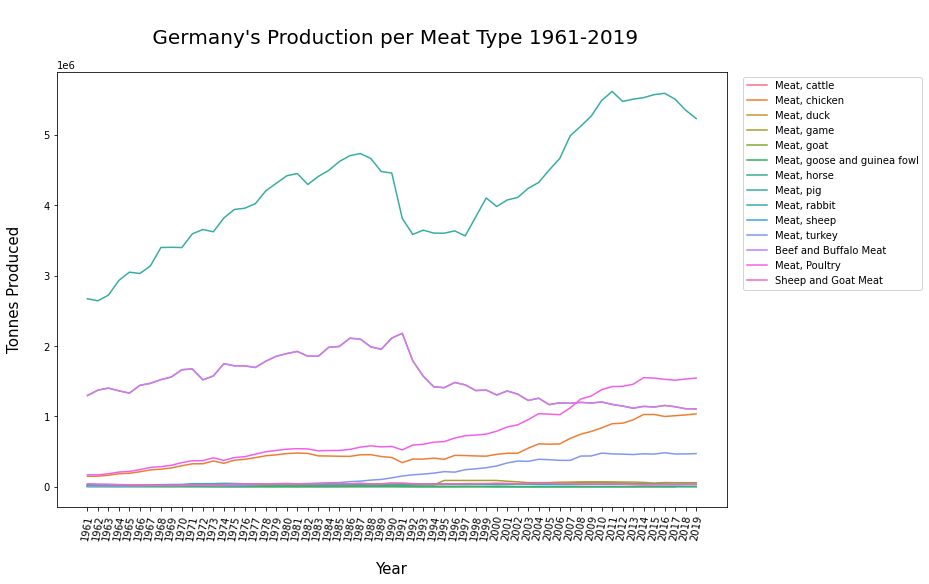

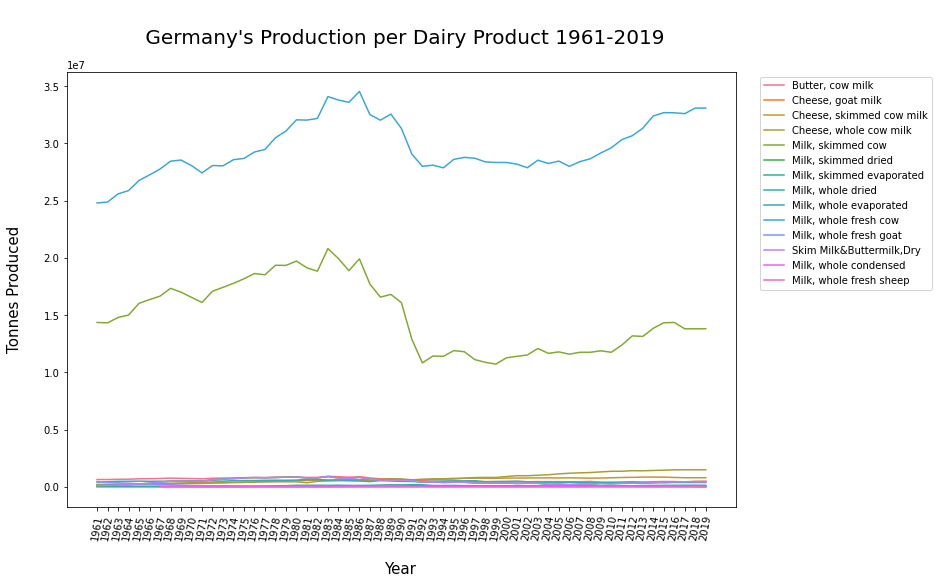

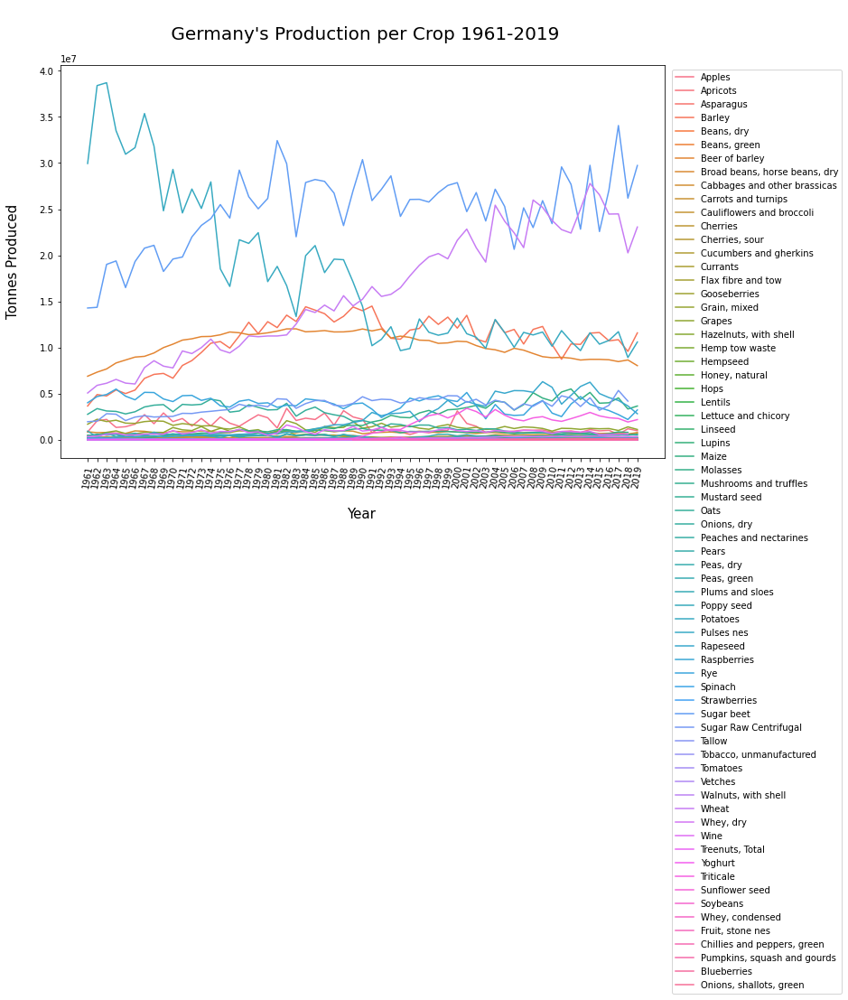

In [133]:
plotprodvisuals(germany_meat_prod, 'Meat Type', 'Germany')
plotprodvisuals(germany_dairy_prod, 'Dairy Product', 'Germany')
plotprodvisuals(germany_crop_prod, 'Crop', 'Germany')

<Figure size 864x576 with 0 Axes>

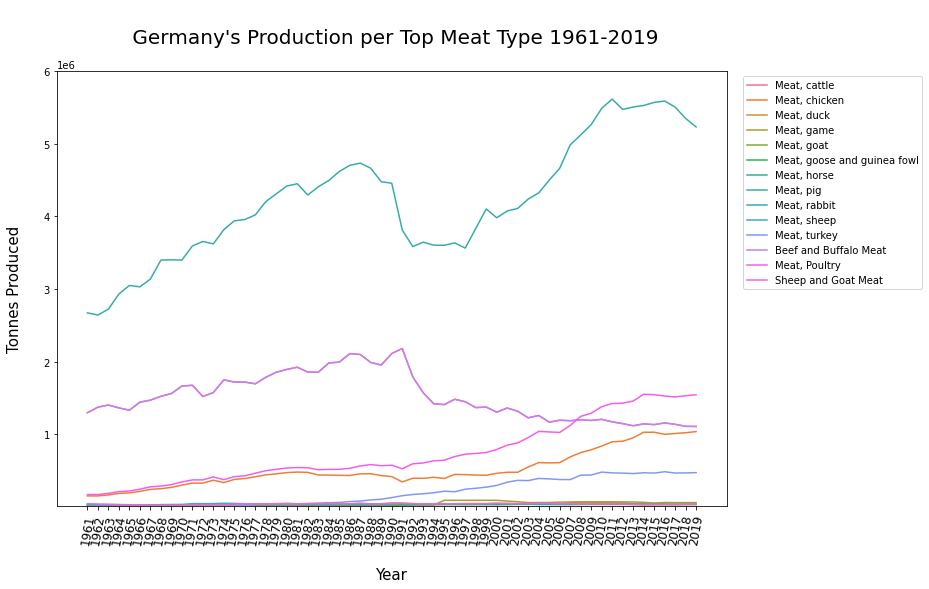

<Figure size 864x576 with 0 Axes>

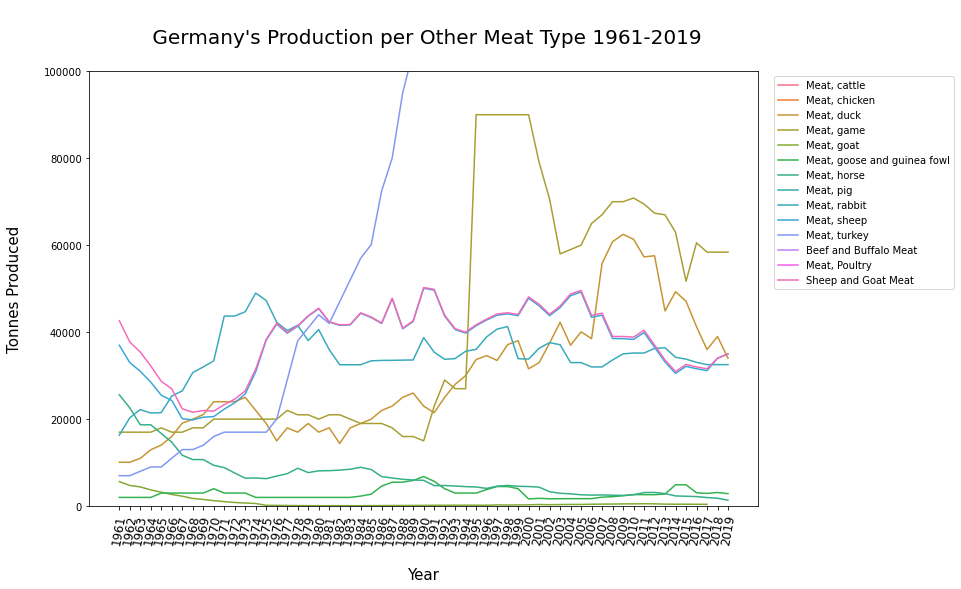

In [134]:
plotprodvisualsii(germany_meat_prod, "Meat Type", 10000, 6000000, 'Germany', 'Top ');
plotprodvisualsii(germany_meat_prod, "Meat Type",  0, 100000, 'Germany', 'Other ');

<Figure size 864x576 with 0 Axes>

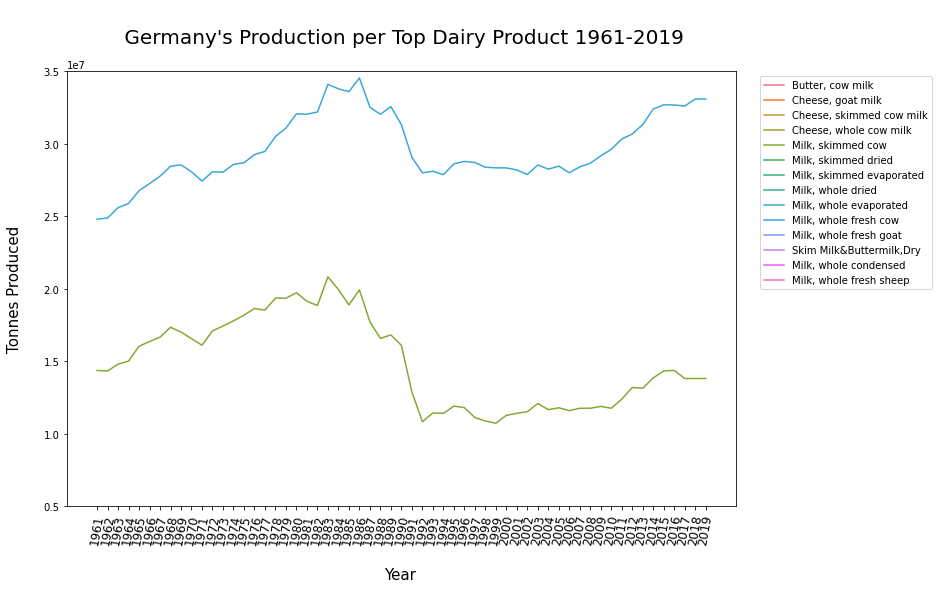

<Figure size 864x576 with 0 Axes>

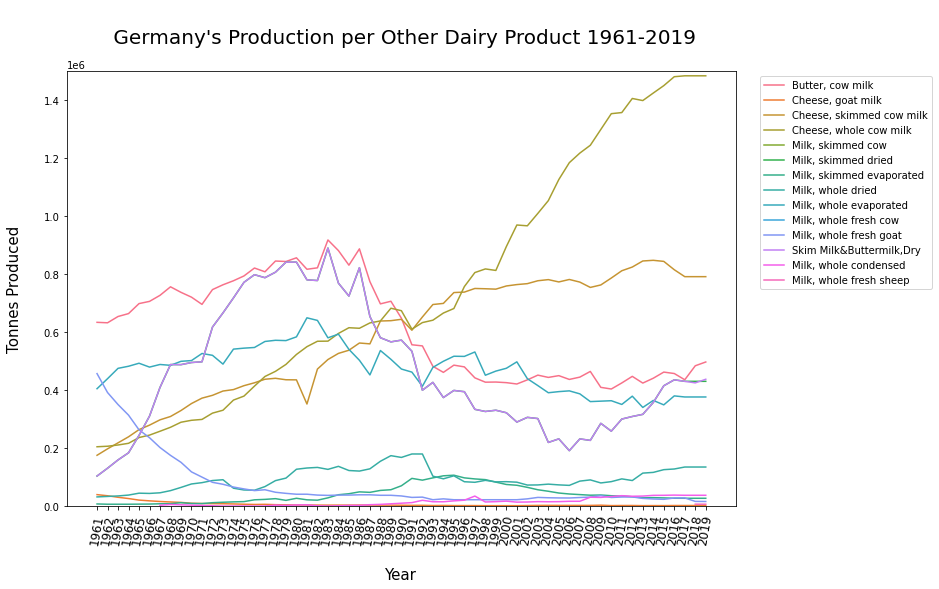

In [135]:
plotprodvisualsii(germany_dairy_prod, "Dairy Product", 5000000, 35000000, 'Germany', 'Top ');
plotprodvisualsii(germany_dairy_prod, "Dairy Product",  0, 1500000, 'Germany', 'Other ');

<Figure size 864x576 with 0 Axes>

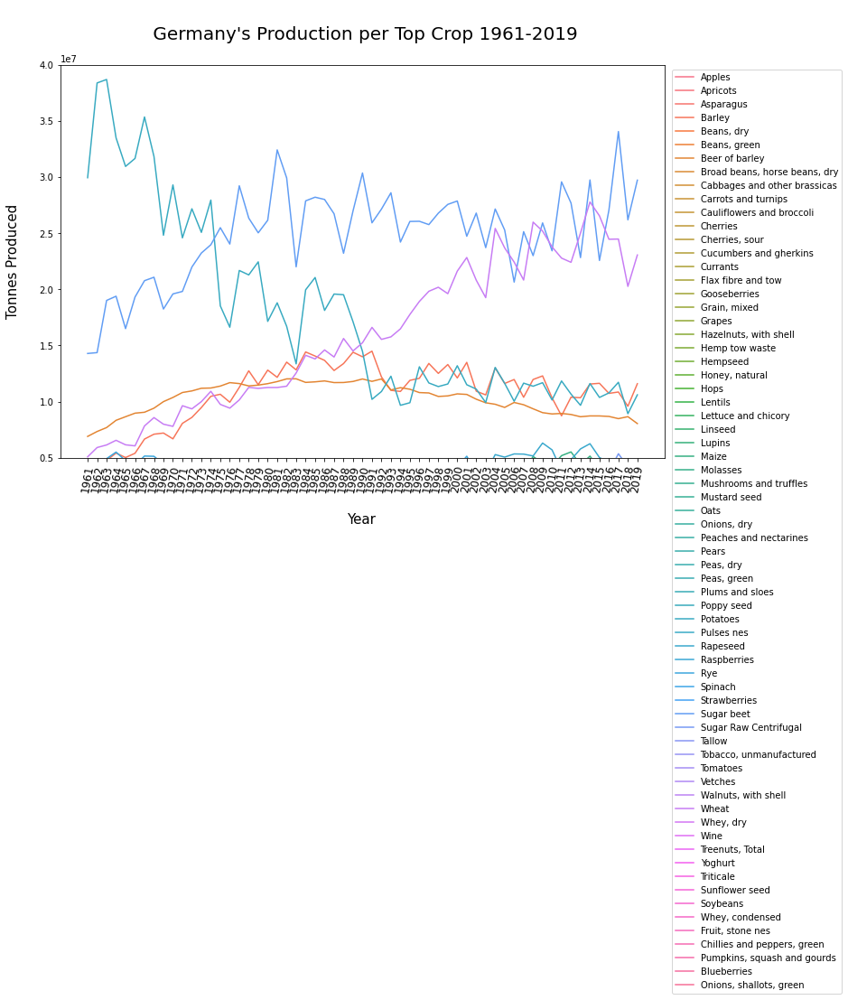

<Figure size 864x576 with 0 Axes>

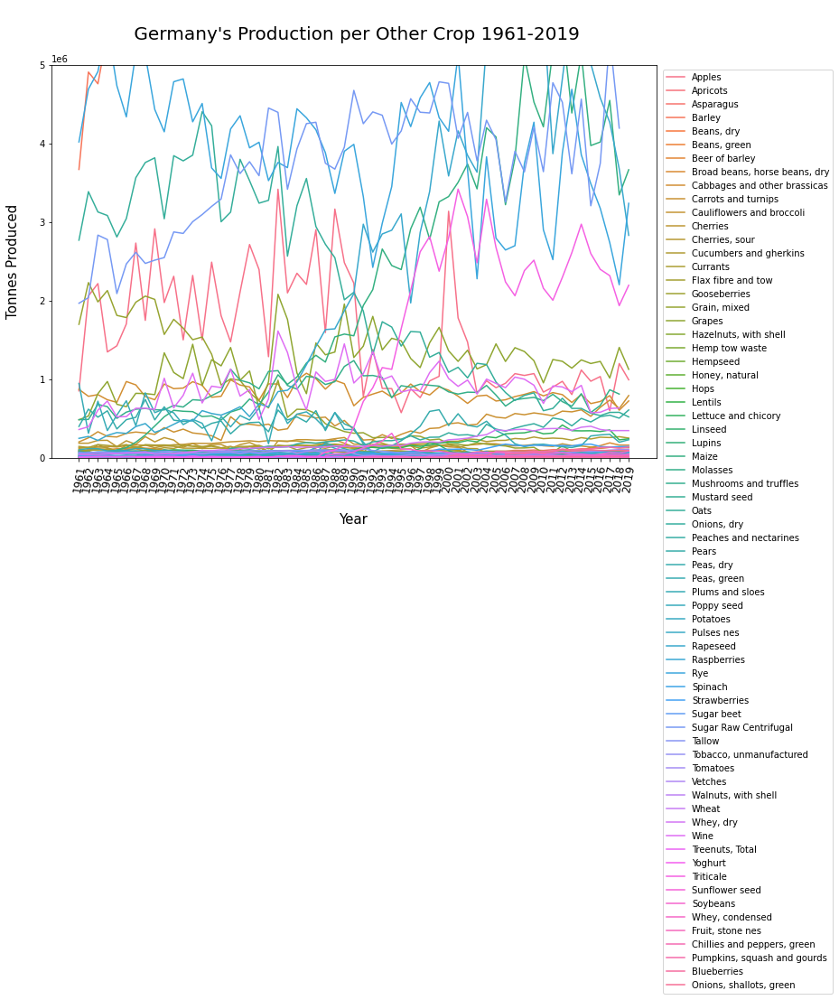

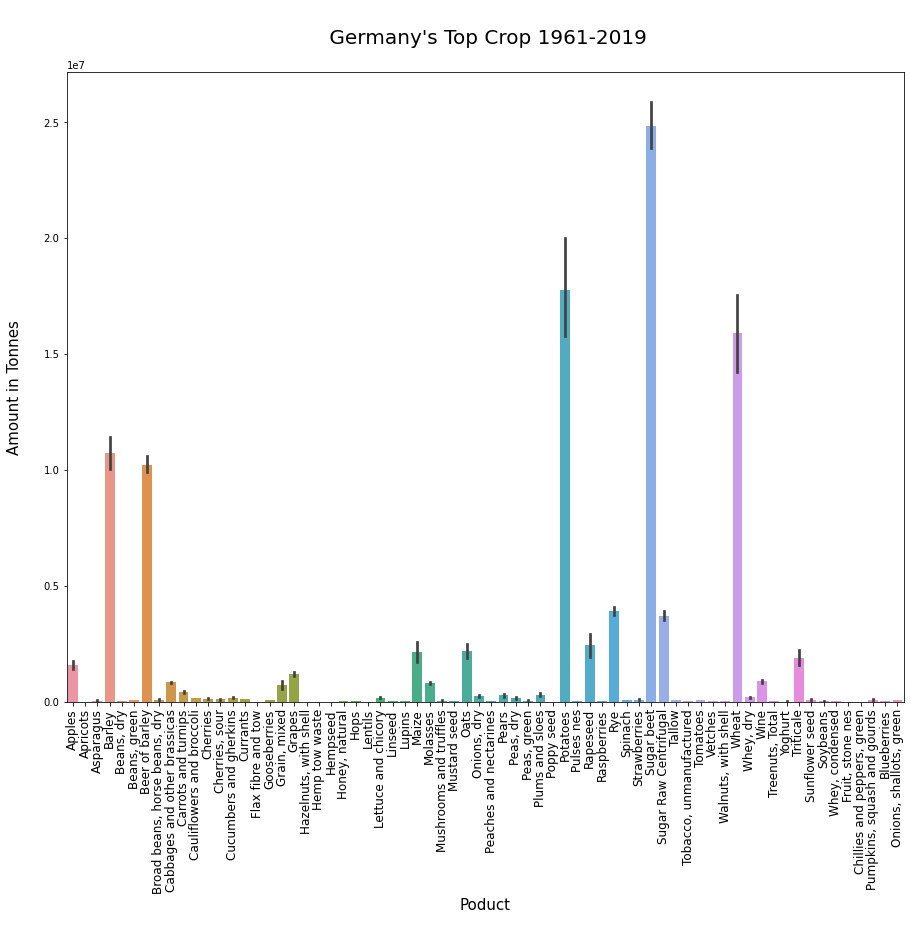

In [136]:
plotprodvisualsii(germany_crop_prod, "Crop", 5000000, 40000000, 'Germany', 'Top ');
plotprodvisualsii(germany_crop_prod, "Crop",  0, 5000000, 'Germany', 'Other ');
plotprodbar(germany_crop_prod, "Crop",'Germany');

## Germany Trade Datasets

In [137]:
# create german dataset
germany_trade = europe_trade_df.loc[europe_trade_df['Country']=='Germany']

# german import/ export datasets - all products (crop, meat, livestock)
germany_imports = germany_trade.loc[germany_trade['Element']=='Import Quantity']
germany_exports = germany_trade.loc[germany_trade['Element']=='Export Quantity']

# rename Value Columns 
germany_imports.rename(columns={'Value': 'Import Quantity'}, inplace=True)
germany_exports.rename(columns={'Value': 'Export Quantity'}, inplace=True)
germany_exports.rename(columns={'Unit': 'Export Unit'}, inplace=True)
germany_imports.rename(columns={'Unit': 'Import Unit'}, inplace=True)

#reset index
germany_imports.reset_index(drop=True, inplace=True)
germany_exports.reset_index(drop=True, inplace=True)


In [138]:
germany_imports.head()
germany_exports.head()

,Country,Crop_Livestock,Element,Import Unit,Year,Import Quantity
0,Germany,Alfalfa meal and pellets,Import Quantity,tonnes,1961,33778.0
1,Germany,Almonds shelled,Import Quantity,tonnes,1961,23384.0
2,Germany,"Anise, badian, fennel, coriander",Import Quantity,tonnes,1961,3536.0
3,Germany,Apples,Import Quantity,tonnes,1961,599555.0
4,Germany,Apricots,Import Quantity,tonnes,1961,21201.0


,Country,Crop_Livestock,Element,Export Unit,Year,Export Quantity
0,Germany,Almonds shelled,Export Quantity,tonnes,1961,185.0
1,Germany,"Anise, badian, fennel, coriander",Export Quantity,tonnes,1961,61.0
2,Germany,Apples,Export Quantity,tonnes,1961,730.0
3,Germany,Asses,Export Quantity,Head,1961,11.0
4,Germany,Bacon and ham,Export Quantity,tonnes,1961,144.0


In [139]:
germany_imports.shape
germany_exports.shape

(20701, 6)

(20199, 6)

## Merge Germany Trade & Production

In [140]:
# merge population data. 
germany_add_exports = pd.merge(germany_prod_pop, germany_exports, how="left", on = ["Crop_Livestock", "Year"])


In [141]:
germany_add_exports.head()
germany_add_exports.shape

,Prod Country,Crop_Livestock,Element_x,Production Unit,Year,Production Value,Population_Germany,Country,Element_y,Export Unit,Export Quantity
0,Germany,Apples,Production,tonnes,1961,851000,73377632,Germany,Export Quantity,tonnes,730.0
1,Germany,Apricots,Production,tonnes,1961,2900,73377632,NaN,NaN,NaN,NaN
2,Germany,Asparagus,Production,tonnes,1961,16300,73377632,NaN,NaN,NaN,NaN
3,Germany,Barley,Production,tonnes,1961,3669020,73377632,Germany,Export Quantity,tonnes,28600.0
4,Germany,"Beans, dry",Production,tonnes,1961,12693,73377632,Germany,Export Quantity,tonnes,1894.0


(7163, 11)

In [142]:
# merge data. 
germany_df = pd.merge(germany_add_exports, germany_imports, how="outer", on = ["Crop_Livestock", "Year"])

# merge population data. Outer merge so no data is lost 

germany_df = pd.merge(germany_df, germany_pop, how="outer", on = ["Year"])
germany_df.head()

#ireland_add_imvals = pd.merge(ireland_add_exports, ireland_imports_val, how="outer", on = ["Crop_Livestock", "Year"])
#ireland_df = pd.merge(ireland_add_imvals, ireland_exports_val, how="outer", on = ["Crop_Livestock", "Year"])

,Prod Country,Crop_Livestock,Element_x,Production Unit,Year,Production Value,Population_Germany_x,Country_x,Element_y,Export Unit,Export Quantity,Country_y,Element,Import Unit,Import Quantity,Population_Germany_y
0,Germany,Apples,Production,tonnes,1961,851000.0,73377632.0,Germany,Export Quantity,tonnes,730.0,Germany,Import Quantity,tonnes,599555.0,73377632
1,Germany,Apricots,Production,tonnes,1961,2900.0,73377632.0,NaN,NaN,NaN,NaN,Germany,Import Quantity,tonnes,21201.0,73377632
2,Germany,Asparagus,Production,tonnes,1961,16300.0,73377632.0,NaN,NaN,NaN,NaN,Germany,Import Quantity,tonnes,8715.0,73377632
3,Germany,Barley,Production,tonnes,1961,3669020.0,73377632.0,Germany,Export Quantity,tonnes,28600.0,Germany,Import Quantity,tonnes,1100300.0,73377632
4,Germany,"Beans, dry",Production,tonnes,1961,12693.0,73377632.0,Germany,Export Quantity,tonnes,1894.0,Germany,Import Quantity,tonnes,32566.0,73377632


In [143]:
germany_df.columns

Index(['Prod Country', 'Crop_Livestock', 'Element_x', 'Production Unit',
       'Year', 'Production Value', 'Population_Germany_x', 'Country_x',
       'Element_y', 'Export Unit', 'Export Quantity', 'Country_y', 'Element',
       'Import Unit', 'Import Quantity', 'Population_Germany_y'],
      dtype='object')

In [144]:
# drop duplicate / unnecessary columns
ger_to_drop = ['Element_x', 'Country_x', 'Element_y', 'Country_y', 'Element', 'Population_Germany_x']
germany_df = germany_df.drop(ger_to_drop, axis = 1)

# rename columns to include unit
germany_df.rename(columns={'Population_Germany_y' : 'Population_Germany'}, inplace=True)

#reorder columns 
ger_columns = ['Prod Country', 'Crop_Livestock', 'Year', 'Production Unit',  'Production Value', 'Import Unit', 'Import Quantity', 'Export Unit', 'Export Quantity',  'Population_Germany']
germany_df = germany_df.reindex(columns=ger_columns)

# check dataset
germany_df.head(100)

,Prod Country,Crop_Livestock,Year,Production Unit,Production Value,Import Unit,Import Quantity,Export Unit,Export Quantity,Population_Germany
0,Germany,Apples,1961,tonnes,851000.0,tonnes,599555.0,tonnes,730.0,73377632
1,Germany,Apricots,1961,tonnes,2900.0,tonnes,21201.0,NaN,NaN,73377632
2,Germany,Asparagus,1961,tonnes,16300.0,tonnes,8715.0,NaN,NaN,73377632
3,Germany,Barley,1961,tonnes,3669020.0,tonnes,1100300.0,tonnes,28600.0,73377632
4,Germany,"Beans, dry",1961,tonnes,12693.0,tonnes,32566.0,tonnes,1894.0,73377632
...,...,...,...,...,...,...,...,...,...,...
95,Germany,"Whey, dry",1961,tonnes,40000.0,NaN,NaN,NaN,NaN,73377632
96,Germany,Wine,1961,tonnes,358700.0,tonnes,399787.0,tonnes,15300.0,73377632
97,Germany,"Wool, greasy",1961,tonnes,12000.0,tonnes,94610.0,tonnes,1050.0,73377632
98,Germany,Beef and Buffalo Meat,1961,tonnes,1296200.0,NaN,NaN,NaN,NaN,73377632


In [145]:
# number of missing values 
germany_df.isnull().sum()

Prod Country          15696
Crop_Livestock            0
Year                      0
Production Unit       15696
Production Value      15696
Import Unit            2129
Import Quantity        2129
Export Unit           17888
Export Quantity       17888
Population_Germany        0
dtype: int64

In [146]:
#check the amount of 0's in each column
germany_df_sparse = (germany_df == 0).sum()
germany_df_sparse

Prod Country          0
Crop_Livestock        0
Year                  0
Production Unit       0
Production Value      0
Import Unit           0
Import Quantity       0
Export Unit           0
Export Quantity       0
Population_Germany    0
dtype: int64

In [147]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
germany_df['Prod Country'].replace(to_replace = np.nan, value = 'Germany', inplace=True)

# first will replace 0 values with NaNs  
germany_df.replace(to_replace = np.nan, value = 0, inplace=True)

# check if we have any NaN values in our dataset
germany_df.isnull().sum()


Prod Country          0
Crop_Livestock        0
Year                  0
Production Unit       0
Production Value      0
Import Unit           0
Import Quantity       0
Export Unit           0
Export Quantity       0
Population_Germany    0
dtype: int64

In [148]:
germany_df_sparse

Prod Country          0
Crop_Livestock        0
Year                  0
Production Unit       0
Production Value      0
Import Unit           0
Import Quantity       0
Export Unit           0
Export Quantity       0
Population_Germany    0
dtype: int64

In [149]:
# cast value as int 
germany_df['Production Value'] = germany_df['Production Value'].astype('int')
germany_df['Import Quantity'] = germany_df['Import Quantity'].astype('int')
germany_df['Export Quantity'] = germany_df['Export Quantity'].astype('int')
germany_df['Population_Germany'] = germany_df['Population_Germany'].astype('int')

In [150]:
germany_df['Crop_Livestock'].unique()

array(['Apples', 'Apricots', 'Asparagus', 'Barley', 'Beans, dry',
       'Beans, green', 'Beer of barley', 'Broad beans, horse beans, dry',
       'Butter, cow milk', 'Cabbages and other brassicas',
       'Carrots and turnips', 'Cauliflowers and broccoli',
       'Cheese, goat milk', 'Cheese, skimmed cow milk',
       'Cheese, whole cow milk', 'Cherries', 'Cherries, sour',
       'Cream fresh', 'Cucumbers and gherkins', 'Currants',
       'Eggs, hen, in shell', 'Flax fibre and tow', 'Gooseberries',
       'Grain, mixed', 'Grapes', 'Hazelnuts, with shell',
       'Hemp tow waste', 'Hempseed', 'Hides, cattle, fresh',
       'Honey, natural', 'Hops', 'Lard', 'Lentils', 'Lettuce and chicory',
       'Linseed', 'Lupins', 'Maize', 'Margarine, short', 'Meat, cattle',
       'Meat, chicken', 'Meat, duck', 'Meat, game', 'Meat, goat',
       'Meat, goose and guinea fowl', 'Meat, horse', 'Meat, pig',
       'Meat, rabbit', 'Meat, sheep', 'Meat, turkey', 'Milk, skimmed cow',
       'Milk, skimmed

In [151]:
# replace items with differeng names across datasets 
germany_df.replace(to_replace = 'Meat, beef, preparations', value = 'Meat, beef' , inplace=True)
germany_df.replace(to_replace = 'Beef and Buffalo Meat', value = 'Meat, beef' , inplace=True)
germany_df.replace(to_replace = 'Meat, cattle, boneless (beef & veal)', value = 'Meat, beef' , inplace=True)
germany_df.replace(to_replace = 'Meat, cattle', value = 'Meat, beef' , inplace=True)
germany_df.replace(to_replace = 'Pigmeat', value = 'Meat, pig' , inplace=True)
germany_df.replace(to_replace = 'Meat, pig, preparations', value = 'Meat, pig' , inplace=True)
germany_df.replace(to_replace = 'Bovine Meat', value = 'Meat, beef' , inplace=True)
germany_df.replace(to_replace = 'Meat, goose and guinea fowl', value = 'Meat, goose' , inplace=True)
germany_df.replace(to_replace = 'Almonds, with shell', value = 'Almonds' , inplace=True)
germany_df.replace(to_replace = 'Almonds shelled', value = 'Almonds' , inplace=True)
germany_df.replace(to_replace = 'Hazelnuts, with shell', value = 'Hazelnuts' , inplace=True)
germany_df.replace(to_replace = 'Hazelnuts, shelled', value = 'Hazelnuts' , inplace=True)
germany_df.replace(to_replace = 'Cashew nuts, with shell', value = 'Cashew nuts' , inplace=True)
germany_df.replace(to_replace = 'Cashew nuts, shelled', value = 'Cashew nuts' , inplace=True)
germany_df.replace(to_replace = 'Oats rolled', value = 'Oats' , inplace=True)

## Feature Engineering - Germany Consumption

In [152]:
germany_df['consumption'] = (germany_df['Production Value'] + germany_df['Import Quantity']) - germany_df['Export Quantity']

In [153]:
# rename columns
germany_df.rename(columns={'Prod Country': 'prod_country', 'Crop_Livestock':'crop_livestock', 'Year': 'year', 
                           'Production Unit': 'production_unit', 'Production Value': 'production_value', 
                           'Import Unit': 'import_unit', 'Import Quantity': 'import_quantity',
                           'Export Unit': 'export_unit', 'Export Quantity': 'export_quantity'}, inplace=True)

In [154]:
germany_df.head()

,prod_country,crop_livestock,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Germany,consumption
0,Germany,Apples,1961,tonnes,851000,tonnes,599555,tonnes,730,73377632,1449825
1,Germany,Apricots,1961,tonnes,2900,tonnes,21201,0,0,73377632,24101
2,Germany,Asparagus,1961,tonnes,16300,tonnes,8715,0,0,73377632,25015
3,Germany,Barley,1961,tonnes,3669020,tonnes,1100300,tonnes,28600,73377632,4740720
4,Germany,"Beans, dry",1961,tonnes,12693,tonnes,32566,tonnes,1894,73377632,43365


## Germany Meat/ Dairy/ Crop Datasets

In [155]:
# german production meat products
germany_meat = germany_df.loc[germany_df['crop_livestock'].str.contains('meat', case=False)]
germany_meat.rename(columns={'crop_livestock': 'Meat_Type'}, inplace=True)
germany_meat.reset_index(drop=True)

# german production dairy products
germany_dairy = germany_df.loc[germany_df['crop_livestock'].str.contains('milk|cream', case=False)]
germany_dairy.rename(columns={'crop_livestock': 'Dairy_Product'}, inplace=True)
germany_dairy.reset_index(drop=True)

# german production crops
germany_crop = germany_df.loc[germany_df['crop_livestock'].str.contains('total|chickpea|soy|almond|oat|hazelnut|cashew|tofu|avocado|mushroom|hemp|flax|chia|seaweed|yeast|quinoa|primary', case=False)]
germany_crop = germany_crop.loc[germany_crop['crop_livestock'].str.contains('meat|milk|offal|fat|hide|wool|sheep|cream|egg|lard|butter|cheese|oil|skin|goat|rice|juice|other|paste|sauce|canned|cake|frozen|nes|confectionery|oil|broken|waste|equivalent|tow', case=False) == False]
germany_crop.rename(columns={'crop_livestock': 'Crop'}, inplace=True)
germany_crop.reset_index(drop=True)


,prod_country,Meat_Type,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Germany,consumption
0,Germany,"Meat, beef",1961,tonnes,1296200,tonnes,165858,tonnes,10737,73377632,1451321
1,Germany,"Meat, chicken",1961,tonnes,150100,tonnes,169900,tonnes,1110,73377632,318890
2,Germany,"Meat, duck",1961,tonnes,10080,tonnes,9000,tonnes,90,73377632,18990
3,Germany,"Meat, game",1961,tonnes,17000,tonnes,5400,tonnes,315,73377632,22085
4,Germany,"Meat, goat",1961,tonnes,5648,0,0,0,0,73377632,5648
...,...,...,...,...,...,...,...,...,...,...,...
1636,Germany,"Meat, pork",2019,0,0,tonnes,135529,0,0,83092962,135529
1637,Germany,"Meat, beef",2019,0,0,tonnes,487838,0,0,83092962,487838
1638,Germany,Poultry Meat,2019,0,0,tonnes,922125,0,0,83092962,922125
1639,Germany,"Meat, pig",2019,0,0,tonnes,1168863,0,0,83092962,1168863


,prod_country,Dairy_Product,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Germany,consumption
0,Germany,"Butter, cow milk",1961,tonnes,633900,tonnes,28077,tonnes,1,73377632,661976
1,Germany,"Cheese, goat milk",1961,tonnes,39600,0,0,0,0,73377632,39600
2,Germany,"Cheese, skimmed cow milk",1961,tonnes,175300,0,0,0,0,73377632,175300
3,Germany,"Cheese, whole cow milk",1961,tonnes,204700,tonnes,129849,tonnes,11836,73377632,322713
4,Germany,Cream fresh,1961,tonnes,125000,0,0,0,0,73377632,125000
...,...,...,...,...,...,...,...,...,...,...,...
1071,Germany,"Milk, Total",2019,tonnes,33102570,0,0,0,0,83092962,33102570
1072,Germany,"Skim Milk&Buttermilk,Dry",2019,tonnes,437549,0,0,0,0,83092962,437549
1073,Germany,"Buttermilk, curdled, acidified milk",2019,0,0,tonnes,68523,0,0,83092962,68523
1074,Germany,Ice cream and edible ice,2019,0,0,tonnes,156028,0,0,83092962,156028


,prod_country,Crop,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Germany,consumption
0,Germany,Hazelnuts,1961,tonnes,85,tonnes,4400,0,0,73377632,4485
1,Germany,Hempseed,1961,tonnes,581,0,0,0,0,73377632,581
2,Germany,Mushrooms and truffles,1961,tonnes,10530,tonnes,4403,tonnes,313,73377632,14620
3,Germany,Oats,1961,tonnes,2768654,tonnes,365200,tonnes,4600,73377632,3129254
4,Germany,"Cereals, Total",1961,tonnes,17257340,0,0,0,0,73377632,17257340
...,...,...,...,...,...,...,...,...,...,...,...
1064,Germany,Cashew nuts,2019,0,0,tonnes,7,0,0,83092962,7
1065,Germany,Hazelnuts,2019,0,0,tonnes,65353,0,0,83092962,65353
1066,Germany,Hazelnuts,2019,0,0,tonnes,1026,0,0,83092962,1026
1067,Germany,Oats,2019,0,0,tonnes,33113,0,0,83092962,33113


In [156]:
germany_crop['Crop'].unique()

array(['Hazelnuts', 'Hempseed', 'Mushrooms and truffles', 'Oats',
       'Cereals, Total', 'Fruit Primary', 'Pulses, Total',
       'Roots and Tubers, Total', 'Sugar Crops Primary',
       'Treenuts, Total', 'Vegetables Primary', 'Almonds', 'Avocados',
       'Cashew nuts', 'Soybeans', 'Flax fibre raw', 'Quinoa'],
      dtype=object)

In [157]:
# check Meat Type values are what we want for analysis
germany_meat['Meat_Type'].unique()

array(['Meat, beef', 'Meat, chicken', 'Meat, duck', 'Meat, game',
       'Meat, goat', 'Meat, goose', 'Meat, horse', 'Meat, pig',
       'Meat, rabbit', 'Meat, sheep', 'Meat, turkey', 'Meat, Poultry',
       'Meat, Total', 'Sheep and Goat Meat', 'Meal, meat', 'Meat nes',
       'Meat, chicken, canned', 'Meat, dried nes', 'Meat, pig sausages',
       'Meat, pork', 'Poultry Meat', 'Other Meat'], dtype=object)

In [158]:
germany_meat = germany_meat.loc[germany_meat['Meat_Type'].str.contains('nes|total|poultry|other|canned', case=False) == False]
germany_meat = germany_meat.loc[germany_meat['Meat_Type'].str.contains('Sheep and Goat Meat', case=False) == False]

In [159]:
germany_dairy['Dairy_Product'].unique()

array(['Butter, cow milk', 'Cheese, goat milk',
       'Cheese, skimmed cow milk', 'Cheese, whole cow milk',
       'Cream fresh', 'Milk, skimmed cow', 'Milk, skimmed dried',
       'Milk, skimmed evaporated', 'Milk, whole dried',
       'Milk, whole evaporated', 'Milk, whole fresh cow',
       'Milk, whole fresh goat', 'Evaporat&Condensed Milk', 'Milk, Total',
       'Skim Milk&Buttermilk,Dry', 'Milk, whole condensed',
       'Cheese, sheep milk', 'Buttermilk, curdled, acidified milk',
       'Ice cream and edible ice',
       'Milk, products of natural constituents nes',
       'Milk, whole fresh sheep'], dtype=object)

In [160]:
germany_dairy = germany_dairy.loc[germany_dairy['Dairy_Product'] != 'Evaporat&Condensed Milk']
germany_dairy = germany_dairy.loc[germany_dairy['Dairy_Product'] != 'Buttermilk, curdled, acidified milk']
germany_dairy = germany_dairy.loc[germany_dairy['Dairy_Product'] != 'Ice cream and edible ice']
germany_dairy = germany_dairy.loc[germany_dairy['Dairy_Product'] != 'Skim Milk&Buttermilk,Dry']
germany_dairy = germany_dairy.loc[germany_dairy['Dairy_Product'].str.contains('total|nes', case=False) == False]

### Descriptive Statistics per product type for all years

In [161]:
# for all meat products 1961-2019
germany_meat.describe()

# for all dairy products 1961-2019
germany_dairy.describe()

# for all crops 1961-2019
germany_crop.describe()

,production_value,import_quantity,export_quantity,Population_Germany,consumption
count,1.170000e+03,1.170000e+03,1.170000e+03,1.170000e+03,1.170000e+03
mean,4.083664e+05,1.167351e+05,3.035584e+04,7.969223e+07,4.947457e+05
std,1.012250e+06,2.103054e+05,1.103043e+05,2.417491e+06,1.026543e+06
min,0.000000e+00,0.000000e+00,0.000000e+00,7.337763e+07,1.000000e+02
25%,0.000000e+00,8.477500e+03,0.000000e+00,7.812828e+07,2.259750e+04
50%,4.033500e+03,2.631450e+04,3.000000e+00,7.943303e+07,5.709500e+04
75%,5.975000e+04,1.355580e+05,1.983750e+03,8.204720e+07,4.070198e+05
max,5.616074e+06,1.255519e+06,1.037659e+06,8.309296e+07,5.587814e+06


,production_value,import_quantity,export_quantity,Population_Germany,consumption
count,8.030000e+02,8.030000e+02,8.030000e+02,8.030000e+02,8.030000e+02
mean,3.530964e+06,9.559133e+04,1.905264e+05,7.973347e+07,3.436029e+06
std,8.346038e+06,2.767985e+05,3.778727e+05,2.386109e+06,8.212921e+06
min,0.000000e+00,0.000000e+00,0.000000e+00,7.337763e+07,-2.425170e+05
25%,3.255000e+04,0.000000e+00,0.000000e+00,7.812828e+07,3.000000e+04
50%,3.503000e+05,1.508600e+04,2.427500e+04,7.943303e+07,2.352890e+05
75%,7.063395e+05,6.307550e+04,2.157790e+05,8.204720e+07,6.567425e+05
max,3.453850e+07,2.777928e+06,2.233207e+06,8.309296e+07,3.399811e+07


,production_value,import_quantity,export_quantity,Population_Germany,consumption
count,1.069000e+03,1.069000e+03,1069.000000,1.069000e+03,1.069000e+03
mean,4.899506e+06,1.954536e+05,4692.306829,7.976363e+07,5.090268e+06
std,1.061234e+07,7.220218e+05,17816.507221,2.421233e+06,1.055391e+07
min,0.000000e+00,0.000000e+00,0.000000,7.337763e+07,1.000000e+00
25%,0.000000e+00,0.000000e+00,0.000000,7.812828e+07,5.200000e+03
50%,6.100000e+03,1.390000e+03,0.000000,8.001390e+07,6.675800e+04
75%,3.041476e+06,3.308500e+04,0.000000,8.204720e+07,3.412142e+06
max,5.201040e+07,4.574084e+06,285654.000000,8.309296e+07,5.201040e+07


### Germany Visualisations

In [162]:
germany_meat_list = germany_meat['Meat_Type'].unique()
germany_dairy_list = germany_dairy['Dairy_Product'].unique()
germany_crop_list = germany_crop['Crop'].unique()

#### Meat

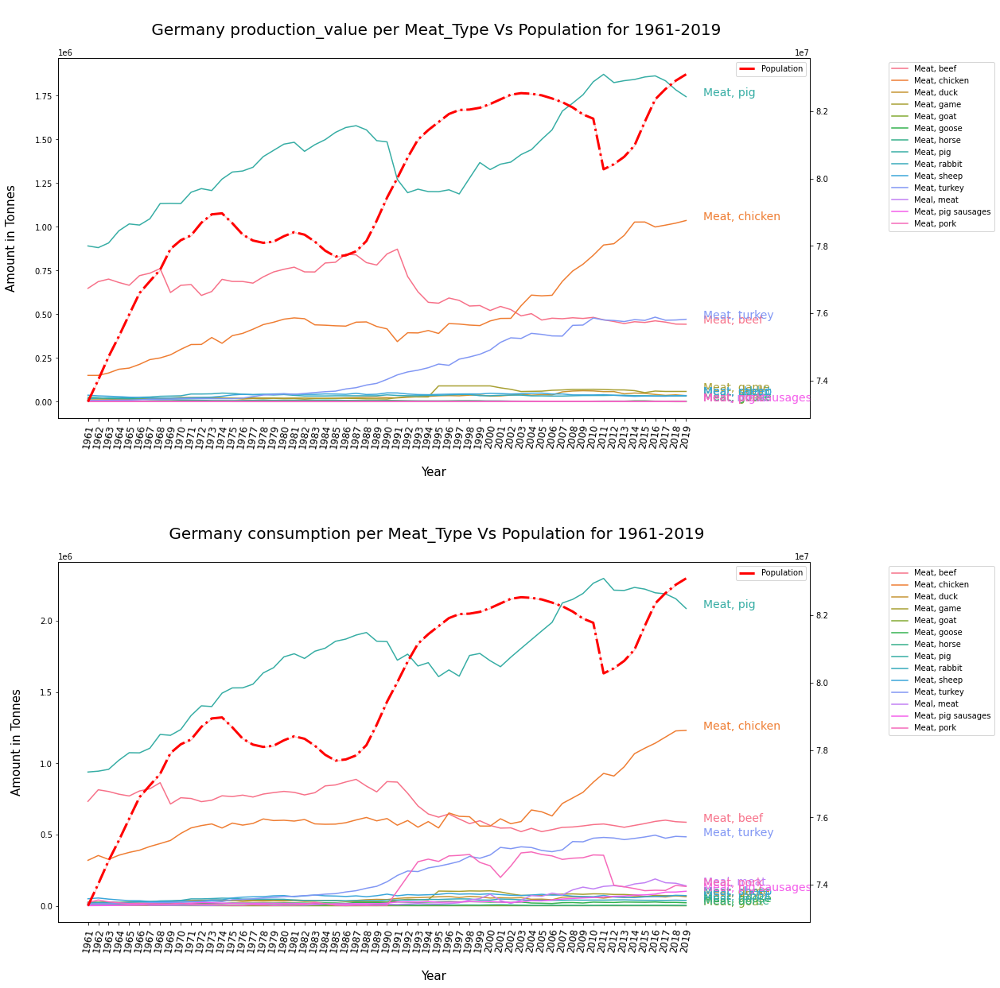

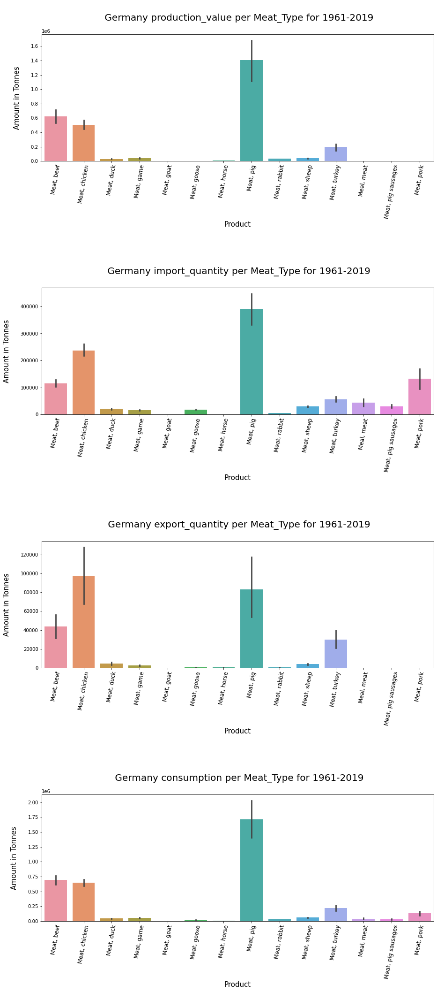

In [163]:
# germany meat visuals 
plotlinegraphs(germany_meat, 'Meat_Type', 'Germany ', 'Population_Germany', germany_meat_list)
plotfigures(germany_meat, 'Meat_Type', 'Germany ');

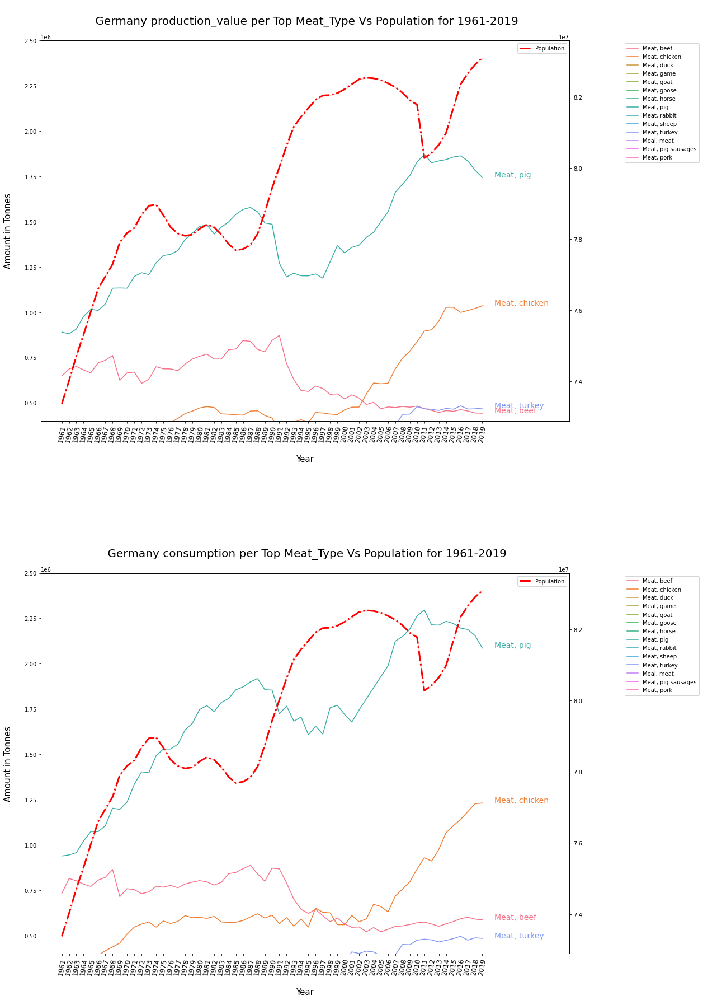

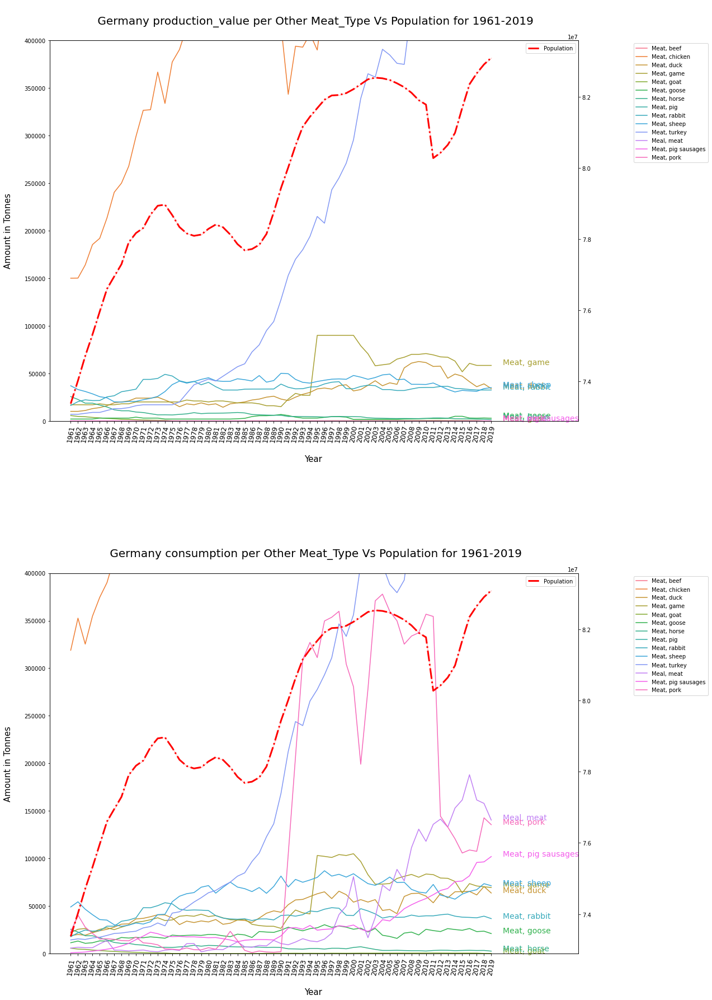

In [164]:
# germany meat visuals more detail
plotlinegraphsii(germany_meat, 'Meat_Type',  400000, 2500000, 'Germany ', 'Population_Germany', germany_meat_list, 'Top ')
plotlinegraphsii(germany_meat, 'Meat_Type',  0, 400000, 'Germany ', 'Population_Germany', germany_meat_list, 'Other ')

#### Dairy 

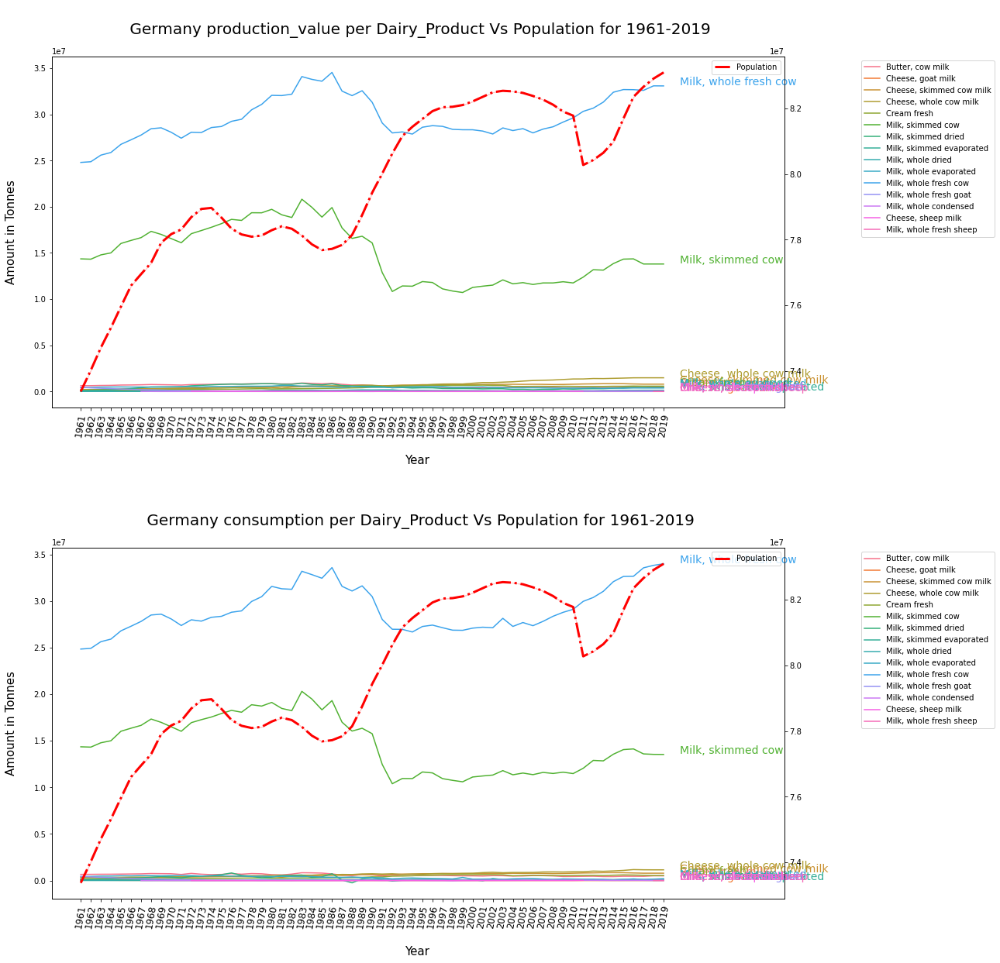

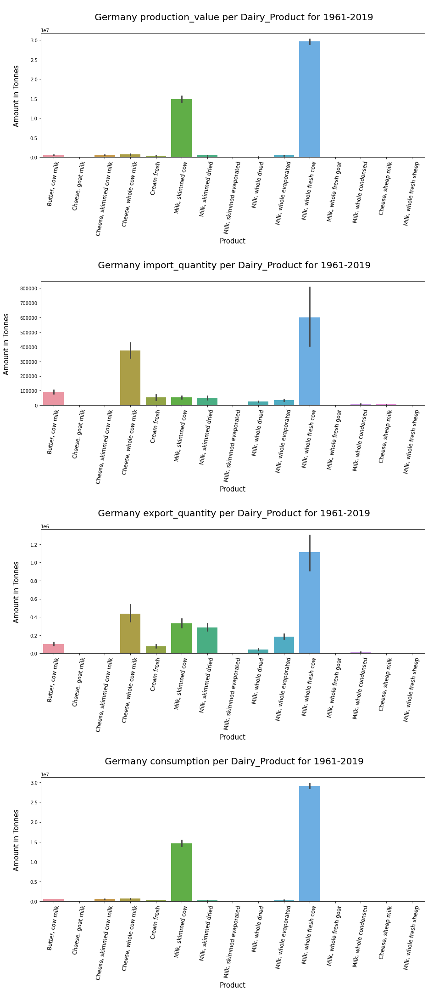

In [165]:
# germany dairy visuals 
plotlinegraphs(germany_dairy, 'Dairy_Product', 'Germany ', 'Population_Germany', germany_dairy_list)
plotfigures(germany_dairy, 'Dairy_Product', 'Germany ');

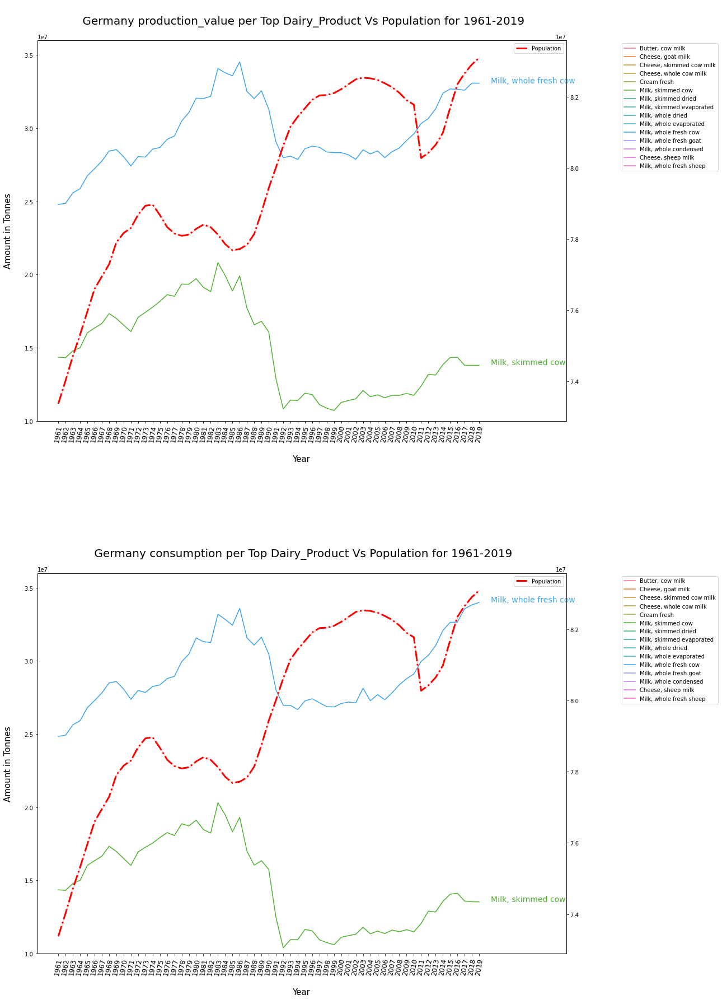

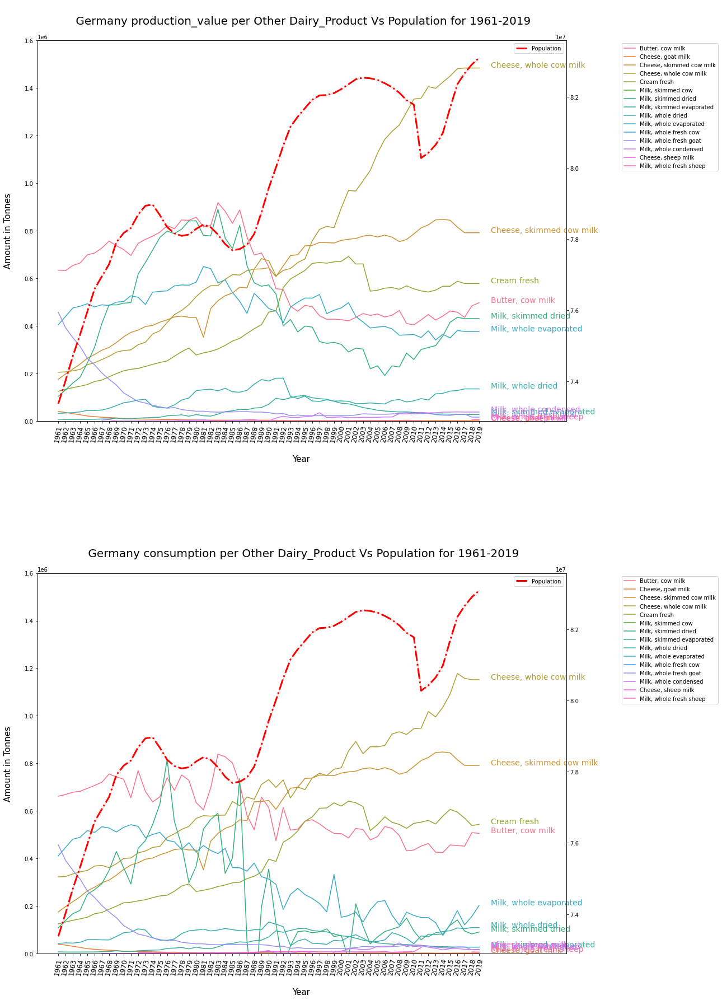

In [166]:
# germany dairy visuals more detail
plotlinegraphsii(germany_dairy, 'Dairy_Product', 10000000, 36000000, 'Germany ', 'Population_Germany', germany_dairy_list, 'Top ')
plotlinegraphsii(germany_dairy, 'Dairy_Product', 0, 1600000, 'Germany ', 'Population_Germany', germany_dairy_list, 'Other ')


#### Crops

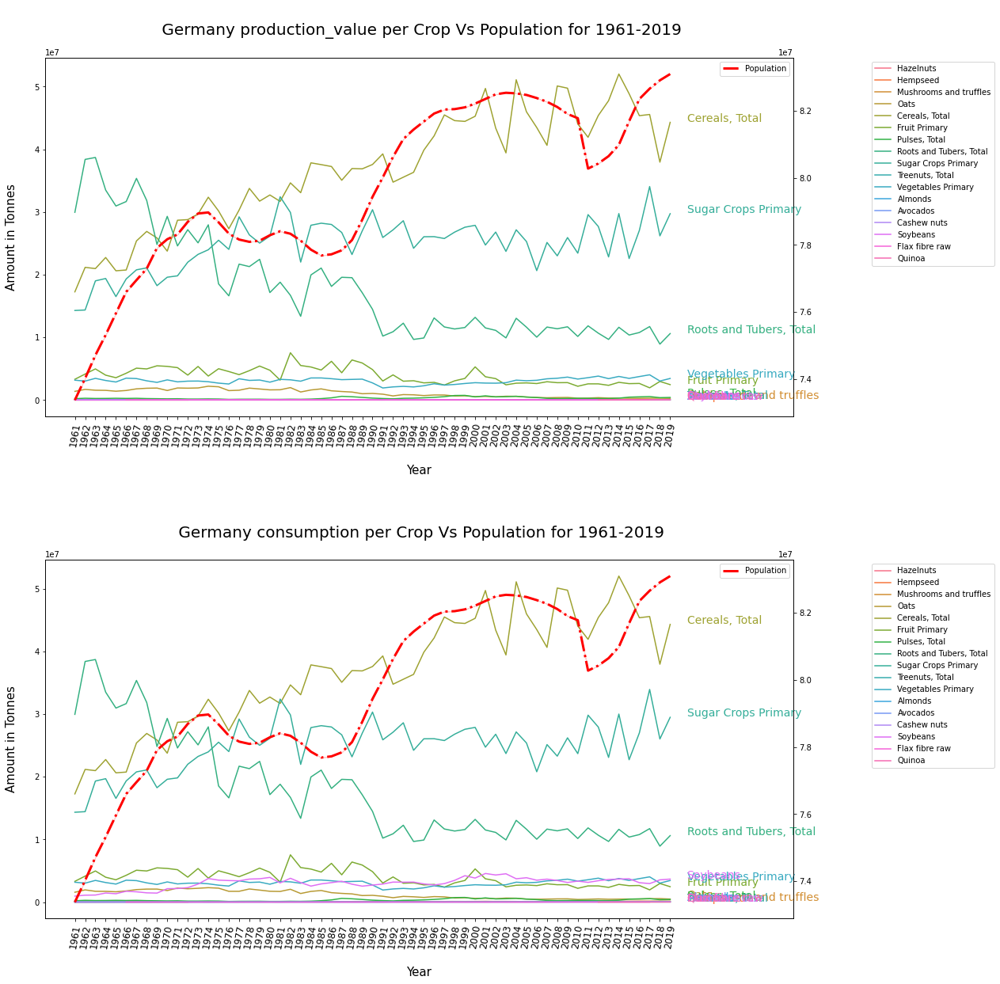

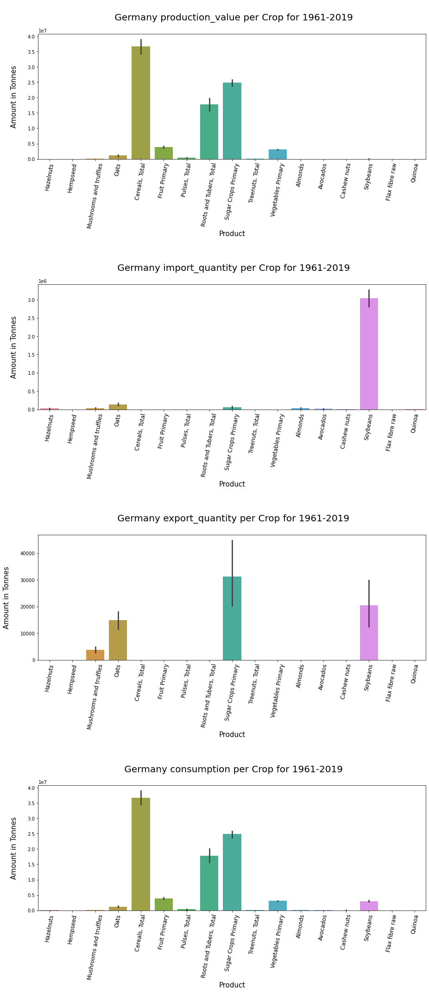

In [167]:
# germany crop visuals
plotlinegraphs(germany_crop, 'Crop', 'Germany ', 'Population_Germany', germany_crop_list)
plotfigures(germany_crop, 'Crop', 'Germany ');

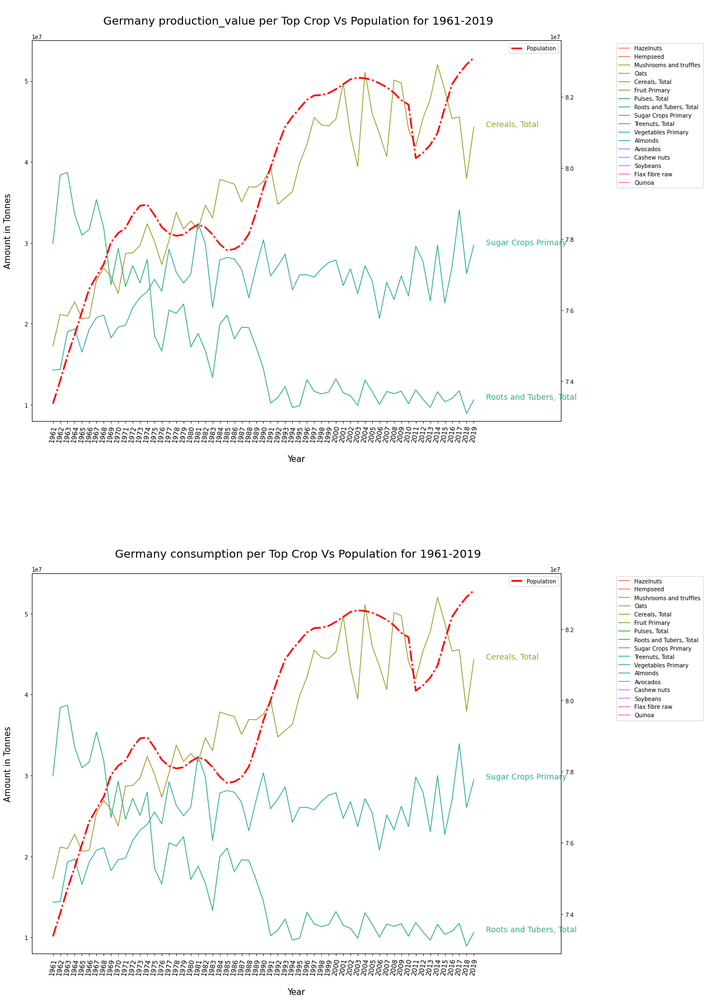

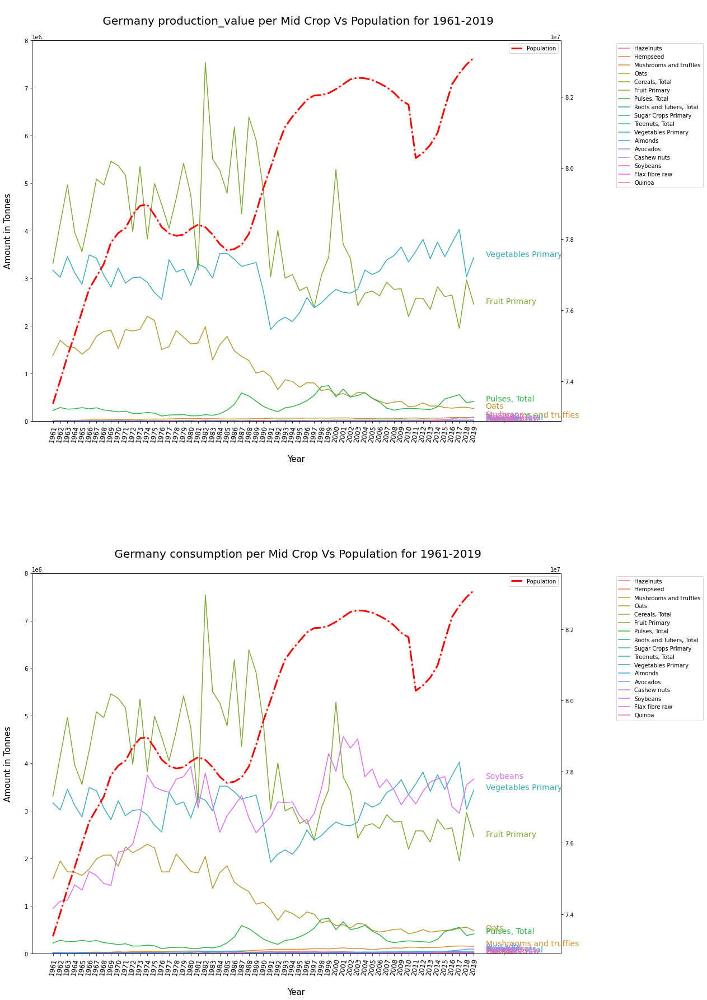

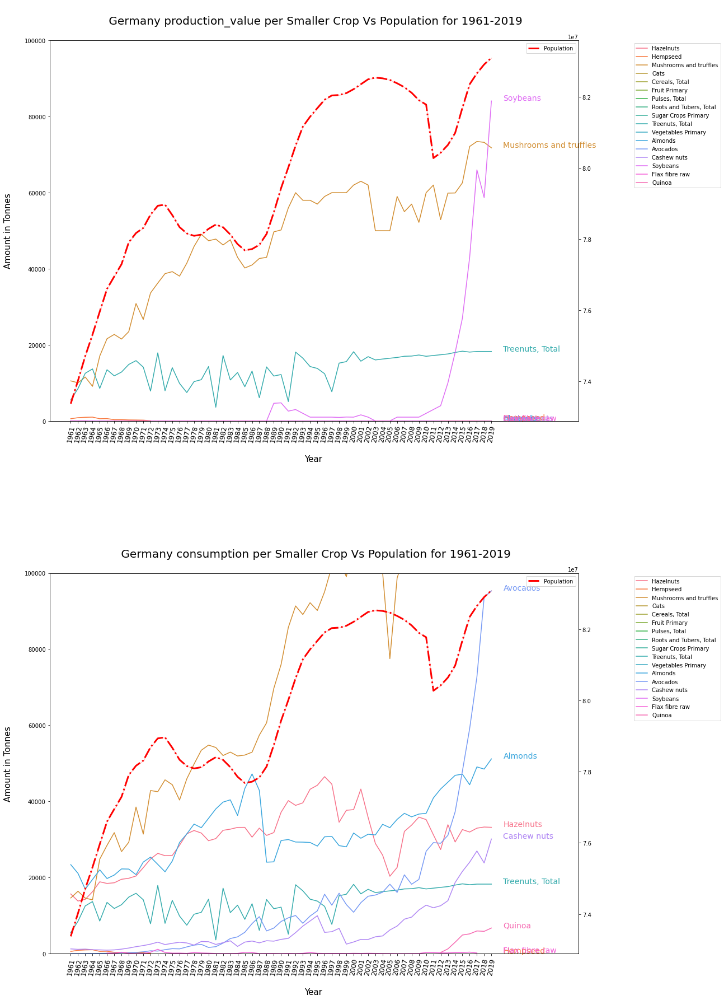

In [168]:
# germany crop visuals more detail
plotlinegraphsii(germany_crop, 'Crop', 8000000, 55000000, 'Germany ', 'Population_Germany',  germany_crop_list, 'Top ')
plotlinegraphsii(germany_crop, 'Crop', 0, 8000000, 'Germany ', 'Population_Germany',  germany_crop_list, 'Mid ')
plotlinegraphsii(germany_crop, 'Crop', 0, 100000, 'Germany ', 'Population_Germany',  germany_crop_list, 'Smaller ')


### Germany Production Pivot Table

In [169]:
#germany as a pivot table to see poduct values per year

germany_meat_table = pd.pivot_table(germany_meat, values = 'production_value', index=['prod_country', 'year'],
                    columns=['Meat_Type'], aggfunc=np.sum, fill_value=0)


germany_dairy_table = pd.pivot_table(germany_dairy, values='production_value', index=['prod_country', 'year'],
                    columns=['Dairy_Product'], aggfunc=np.sum, fill_value=0)


germany_crop_table = pd.pivot_table(germany_crop, values='production_value', index=['prod_country', 'year'],
                    columns=['Crop'], aggfunc=np.sum, fill_value=0)

In [170]:
germany_meat_table
germany_dairy_table
germany_crop_table

Meat_Type          Meal, meat  Meat, beef  Meat, chicken  Meat, duck  \
prod_country year                                                      
Germany      1961           0     2592400         150100       10080   
             1962           0     2745800         150200       10080   
             1963           0     2804000         164000       10980   
             1964           0     2725800         185400       12960   
             1965           0     2662000         192000       14040   
             1966           0     2882990         213400       16020   
             1967           0     2938952         240400       19080   
             1968           0     3044184         250000       19980   
             1969           0     3120346         267800       21060   
             1970           0     3326388         299100       24000   
             1971           0     3348470         326600       24000   
             1972           0     3037656         327200       24000   
             1973           0     3149200         366800       25000   
             1974           0     3497800         333800       22000   
             1975           0     3437640         377367       19000   
             1976           0     3435800         390459       15000   
             1977           0     3389200         414250       18000   
             1978           0     3569000         440646       17000   
             1979           0     3708800         454268       19000   
             1980           0     3785180         471683       17000   
             1981           0     3845540         479000       18000   
             1982           0     3710854         474400       14400   
             1983           0     3708348         439200       18000   
             1984           0     3964380         437200       19000   
             1985           0     3986274         433850       20000   
             1986           0     4219722         432000       22000   
             1987           0     4197036         454500       23000   
             1988           0     3975964         456000       25000   
             1989           0     3906784         430000       26000   
             1990           0     4223936         416200       23000   
             1991           0     4361414         343423       21465   
             1992           0     3579400         394000       25000   
             1993           0     3140674         393000       28000   
             1994           0     2840600         407000       30000   
             1995           0     2815600         390000       33700   
             1996           0     2963600         446500       34600   
             1997           0     2895200         443800       33490   
             1998           0     2734000         438000       37130   
             1999           0     2748000         435000       38050   
             2000           0     2607000         461500       31569   
             2001           0     2723000         476000       32990   
             2002           0     2632750         476500       37481   
             2003           0     2452470         548500       42272   
             2004           0     2516000         609400       36993   
             2005           0     2333800         605117       40071   
             2006           0     2386360         608418       38514   
             2007           0     2371448         687696       55795   
             2008           0     2398862         746942       60807   
             2009           0     2379230         785869       62492   
             2010           0     2410004         837134       61354   
             2011           0     2340752         895880       57310   
             2012           0     2292510         903293       57562   
             2013           0     2233014         950940       44877   
             2014           0     228520

Dairy_Product      Butter, cow milk  Cheese, goat milk  Cheese, sheep milk  \
prod_country year                                                            
Germany      1961            633900              39600                   0   
             1962            632300              35700                   0   
             1963            654000              30450                   0   
             1964            664000              26070                   0   
             1965            698498              20715                   0   
             1966            706125              18135                   0   
             1967            727022              15900                   0   
             1968            756395              14250                   0   
             1969            737294              12750                   0   
             1970            720700               9900                   0   
             1971            695800               9000                   0   
             1972            746800               8550                   0   
             1973            763400               8145                   0   
             1974            777300               7470                   0   
             1975            793900               6495                   0   
             1976            821200               5625                   0   
             1977            808200               6066                   0   
             1978            845300               4914                   0   
             1979            843700               4347                   0   
             1980            856425               3893                   0   
             1981            816931               3900                   0   
             1982            821847               3450                   0   
             1983            918005               3300                   0   
             1984            881350               3450                   0   
             1985            831014               3450                   0   
             1986            887318               3600                   0   
             1987            774160               3600                   0   
             1988            697565               3345                   0   
             1989            706554               3345                   0   
             1990            648100               3000                   0   
             1991            556500               2550                   0   
             1992            552600               2700                   0   
             1993            482200               1950                   0   
             1994            461300               2250                   0   
             1995            486200               1800                   0   
             1996            480200               1800                   0   
             1997            442351               1800                   0   
             1998            427428               1500                   0   
             1999            427929               1500                   0   
             2000            425827               1500                   0   
             2001            421179               1500                   0   
             2002            435400               1950                   0   
             2003            451789               2400                   0   
             2004            443907               2520                   0   
             2005            450000               2430                   0   
             2006            436960               2400                   0   
             2007            444893               2340                   0   
             2008            464501               2430                   0   
             2009            409596               3150                   0   
             2010     

Crop               Almonds  Avocados  Cashew nuts  Cereals, Total  \
prod_country year                                                   
Germany      1961        0         0            0        17257340   
             1962        0         0            0        21166661   
             1963        0         0            0        20970320   
             1964        0         0            0        22737326   
             1965        0         0            0        20620142   
             1966        0         0            0        20742474   
             1967        0         0            0        25380099   
             1968        0         0            0        26898318   
             1969        0         0            0        25853039   
             1970        0         0            0        23753864   
             1971        0         0            0        28685065   
             1972        0         0            0        28780064   
             1973        0         0            0        29680306   
             1974        0         0            0        32357236   
             1975        0         0            0        30164053   
             1976        0         0            0        27323692   
             1977        0         0            0        30306879   
             1978        0         0            0        33762346   
             1979        0         0            0        31729504   
             1980        0         0            0        32712941   
             1981        0         0            0        31688884   
             1982        0         0            0        34645710   
             1983        0         0            0        33077787   
             1984        0         0            0        37838589   
             1985        0         0            0        37555294   
             1986        0         0            0        37257105   
             1987        0         0            0        35061112   
             1988        0         0            0        36931897   
             1989        0         0            0        36881160   
             1990        0         0            0        37579589   
             1991        0         0            0        39267858   
             1992        0         0            0        34758462   
             1993        0         0            0        35547425   
             1994        0         0            0        36328713   
             1995        0         0            0        39863871   
             1996        0         0            0        42135618   
             1997        0         0            0        45485681   
             1998        0         0            0        44574851   
             1999        0         0            0        44452029   
             2000        0         0            0        45271234   
             2001        0         0            0        49709326   
             2002        0         0            0        43391325   
             2003        0         0            0        39426039   
             2004        0         0            0        51097000   
             2005        0         0            0        45980200   
             2006        0         0            0        43474800   
             2007        0         0            0        40632149   
             2008        0         0            0        50104858   
             2009        0         0            0        49750199   
             2010        0         0            0        44038739   
             2011        0         0            0        41920400   
             2012        0         0            0        45396500   
             2013        0         0            0        47757100   
             2014        0         0            0        52010400   
             2015        0         0            0        48866800   
             2016        0         0            0        45364400  

### Descriptive Statistics per product for all years

In [171]:
germany_meat_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
germany_dairy_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
germany_crop_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))


Meat_Type,"Meal, meat","Meat, beef","Meat, chicken","Meat, duck","Meat, game","Meat, goat","Meat, goose","Meat, horse","Meat, pig","Meat, pig sausages","Meat, pork","Meat, rabbit","Meat, sheep","Meat, turkey"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,0.00,3028186.44,506302.88,29743.14,41247.83,783.19,2981.24,6826.83,4215874.42,0.00,0.00,34497.68,37745.71,193924.15
std,0.00,632050.07,248955.81,13959.70,26695.69,1231.56,1240.79,5129.71,819900.09,0.00,0.00,6219.11,8340.24,180570.60
min,0.00,2214000.00,150100.00,10080.00,15000.00,0.00,1633.00,1350.00,2642400.00,0.00,0.00,16300.00,19830.00,7000.00
25%,0.00,2431237.00,372083.50,19000.00,19000.00,157.50,2000.00,3034.50,3613050.00,0.00,0.00,32532.00,31863.50,18500.00
50%,0.00,2882990.00,439200.00,25000.00,22000.00,358.00,2788.00,5923.00,4204500.00,0.00,0.00,33800.00,40593.00,127500.00
75%,0.00,3533400.00,606767.50,37765.50,65991.50,529.50,3100.50,8342.00,4683174.50,0.00,0.00,37349.00,43740.00,375438.00
max,0.00,4361414.00,1036000.00,62492.00,90000.00,5648.00,6804.00,25600.00,5616074.00,0.00,0.00,49000.00,50088.00,483263.00


Dairy_Product,"Butter, cow milk","Cheese, goat milk","Cheese, sheep milk","Cheese, skimmed cow milk","Cheese, whole cow milk",Cream fresh,"Milk, skimmed cow","Milk, skimmed dried","Milk, skimmed evaporated","Milk, whole condensed","Milk, whole dried","Milk, whole evaporated","Milk, whole fresh cow","Milk, whole fresh goat","Milk, whole fresh sheep"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,610916.27,6475.32,0.00,584187.20,751272.41,421745.76,14901093.64,462844.80,40105.66,12769.93,95242.64,471236.56,29624040.63,74864.68,222.88
std,167039.01,8450.15,0.00,206167.51,418426.69,184650.06,3041364.27,216591.15,29482.10,13655.45,37281.85,77763.98,2381169.29,98502.53,1200.16
min,403887.00,1500.00,0.00,175300.00,204700.00,125000.00,10716600.00,103702.00,6500.00,0.00,31700.00,340300.00,24796400.00,15890.00,0.00
25%,446201.00,2040.00,0.00,408643.50,396670.50,249150.00,11790350.00,304040.00,17650.00,200.00,72800.00,396200.00,28082008.00,27295.00,0.00
50%,632300.00,3150.00,0.00,639558.00,638673.00,457800.00,14356143.00,415100.00,29100.00,6000.00,88200.00,479477.00,28686800.00,36000.00,0.00
75%,759897.50,6280.50,0.00,770000.00,1090100.00,573050.00,17380392.00,635717.50,55257.50,19000.00,126200.50,523253.00,32031328.00,57870.00,0.00
max,918005.00,39600.00,0.00,847800.00,1484200.00,691900.00,20814736.00,890053.00,106600.00,37957.00,179797.00,649471.00,34538496.00,457000.00,6650.00


Crop,Almonds,Avocados,Cashew nuts,"Cereals, Total",Flax fibre raw,Fruit Primary,Hazelnuts,Hempseed,Mushrooms and truffles,Oats,"Pulses, Total",Quinoa,"Roots and Tubers, Total",Soybeans,Sugar Crops Primary,"Treenuts, Total",Vegetables Primary
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,0.00,0.00,0.00,36674780.90,0.00,3896777.56,4.14,102.54,46820.27,2164185.25,316640.75,0.00,17757075.80,5870.15,24828769.29,13692.08,3067693.86
std,0.00,0.00,0.00,8976165.09,0.00,1271309.50,18.04,245.35,16627.91,1239424.02,164931.68,0.00,8340602.63,16583.53,4091385.40,3977.89,458436.26
min,0.00,0.00,0.00,17257340.00,0.00,1947993.00,0.00,0.00,9100.00,519300.00,104047.00,0.00,8920800.00,0.00,14286746.00,3608.00,1922429.00
25%,0.00,0.00,0.00,30235466.00,0.00,2772999.50,0.00,0.00,38981.50,989725.50,200250.50,0.00,11353290.00,0.00,22700350.00,11323.50,2766351.50
50%,0.00,0.00,0.00,37257105.00,0.00,3713553.00,0.00,0.00,50000.00,2009515.00,267589.00,0.00,13361138.00,0.00,25768883.00,14299.00,3131320.00
75%,0.00,0.00,0.00,44377214.50,0.00,4963741.50,0.00,0.00,59903.50,3223114.50,421359.50,0.00,22064704.00,1800.00,27363886.50,17028.50,3406582.00
max,0.00,0.00,0.00,52010400.00,0.00,7541571.00,85.00,1004.00,73454.00,4404027.00,742035.00,0.00,38697568.00,84100.00,34059900.00,18330.00,4025884.00


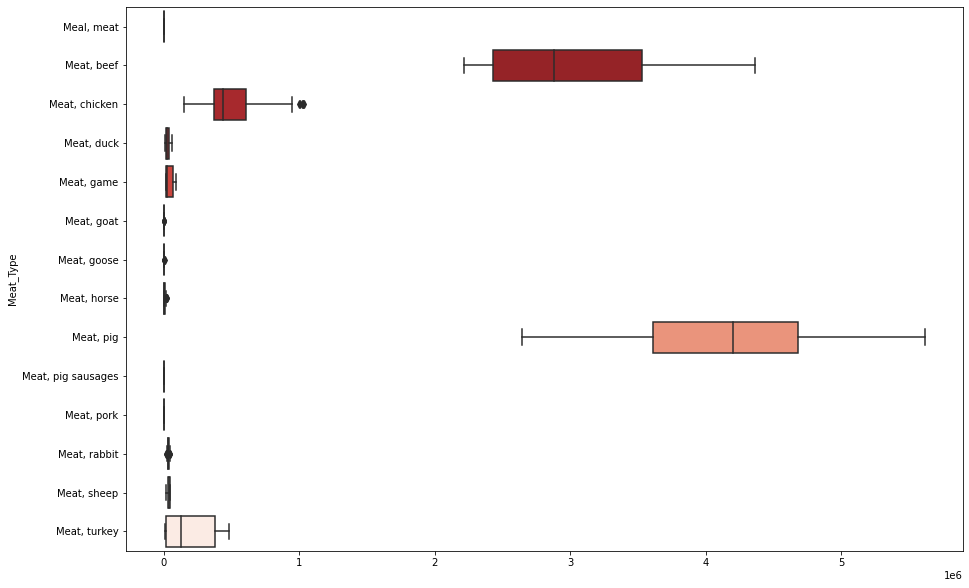

In [172]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=germany_meat_table, orient='h', palette='Reds_r');

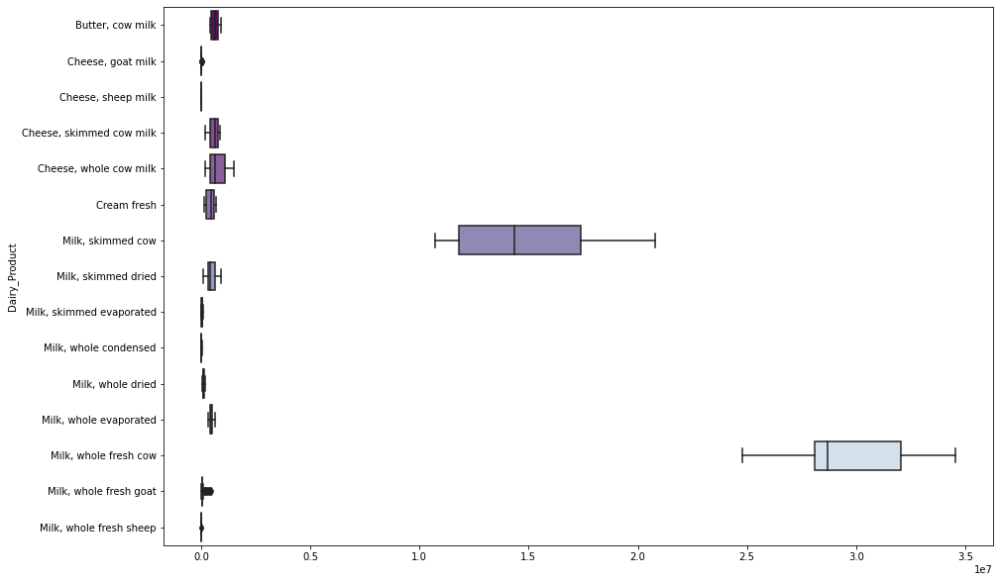

In [173]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=germany_dairy_table, orient='h', palette='BuPu_r');

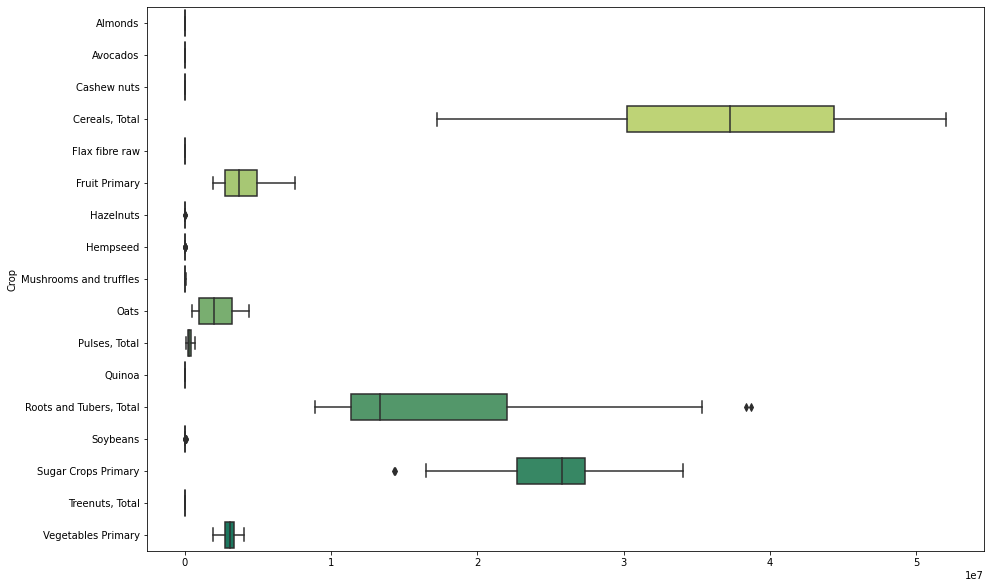

In [174]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=germany_crop_table, orient='h', palette='summer_r');

## AUSTRALIA

## Australia Production Datasets

In [175]:
# create australian dataset
oz_df = oceania_df.loc[oceania_df['Country']=='Australia']

# australian production dataset - all products (crop, meat, livestock)
oz_prod = oz_df.loc[oz_df['Element']=='Production']

# rename columns
oz_prod.rename(columns={'Country': 'Prod Country', 'Unit': 'Production Unit', 'Value': 'Production Value' }, inplace=True)

#reset index
oz_prod.reset_index(drop=True, inplace=True)

oz_prod

,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value
0,Australia,Apples,Production,tonnes,1961,295034
1,Australia,Apricots,Production,tonnes,1961,40691
2,Australia,Asparagus,Production,tonnes,1961,5262
3,Australia,Avocados,Production,tonnes,1961,400
4,Australia,Bananas,Production,tonnes,1961,123863
...,...,...,...,...,...,...
8703,Australia,Sheep and Goat Meat,Production,tonnes,2019,752201
8704,Australia,"Skim Milk&Buttermilk,Dry",Production,tonnes,2019,208299
8705,Australia,Sugar Crops Primary,Production,tonnes,2019,32415352
8706,Australia,"Treenuts, Total",Production,tonnes,2019,260227


### Australia Production - Add Population

In [176]:
# merge population data. Outer merge so no data is lost 
oz_prod_pop = pd.merge(oz_prod, aus_pop, how="outer", on = ["Year"])
oz_prod_pop.head()

,Prod Country,Crop_Livestock,Element,Production Unit,Year,Production Value,Population_Australia
0,Australia,Apples,Production,tonnes,1961,295034,10483000
1,Australia,Apricots,Production,tonnes,1961,40691,10483000
2,Australia,Asparagus,Production,tonnes,1961,5262,10483000
3,Australia,Avocados,Production,tonnes,1961,400,10483000
4,Australia,Bananas,Production,tonnes,1961,123863,10483000


In [177]:
oz_prod_pop.shape

(8708, 7)

### Australia Production Analysis

In [178]:
# australian production meat products
oz_meat_prod = oz_prod_pop.loc[oz_prod_pop['Crop_Livestock'].str.contains('meat', case=False)]
oz_meat_prod.rename(columns={'Crop_Livestock': 'Meat Type'}, inplace=True)
oz_meat_prod.reset_index(drop=True)

# australian production dairy products
oz_dairy_prod = oz_prod_pop.loc[oz_prod_pop['Crop_Livestock'].str.contains('milk', case=False)]
oz_dairy_prod.rename(columns={'Crop_Livestock': 'Dairy Product'}, inplace=True)
oz_dairy_prod.reset_index(drop=True)

# australian production crops
oz_crop_prod = oz_prod_pop.loc[oz_prod_pop['Crop_Livestock'].str.contains('meat', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('milk', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('offals', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('fat', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('hides', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('wool', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('sheep', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('cream', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('egg', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('lard', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('butter', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('cheese', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('oil', case=False) == False]
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop_Livestock'].str.contains('skin', case=False) == False]
oz_crop_prod.rename(columns={'Crop_Livestock': 'Crop'}, inplace=True)
oz_crop_prod.reset_index(drop=True)

,Prod Country,Meat Type,Element,Production Unit,Year,Production Value,Population_Australia
0,Australia,"Meat, cattle",Production,tonnes,1961,642924,10483000
1,Australia,"Meat, chicken",Production,tonnes,1961,46858,10483000
2,Australia,"Meat, duck",Production,tonnes,1961,830,10483000
3,Australia,"Meat, goat",Production,tonnes,1961,250,10483000
4,Australia,"Meat, horse",Production,tonnes,1961,14840,10483000
...,...,...,...,...,...,...,...
703,Australia,"Meat, turkey",Production,tonnes,2019,19047,25365745
704,Australia,Beef and Buffalo Meat,Production,tonnes,2019,2351793,25365745
705,Australia,"Meat, Poultry",Production,tonnes,2019,1275800,25365745
706,Australia,"Meat, Total",Production,tonnes,2019,4818760,25365745


,Prod Country,Dairy Product,Element,Production Unit,Year,Production Value,Population_Australia
0,Australia,"Butter, cow milk",Production,tonnes,1961,182100,10483000
1,Australia,"Cheese, whole cow milk",Production,tonnes,1961,47700,10483000
2,Australia,"Milk, dry buttermilk",Production,tonnes,1961,7954,10483000
3,Australia,"Milk, skimmed condensed",Production,tonnes,1961,5085,10483000
4,Australia,"Milk, skimmed cow",Production,tonnes,1961,3698900,10483000
...,...,...,...,...,...,...,...
773,Australia,"Milk, whole evaporated",Production,tonnes,2019,27000,25365745
774,Australia,"Milk, whole fresh cow",Production,tonnes,2019,8795038,25365745
775,Australia,Evaporat&Condensed Milk,Production,tonnes,2019,48056,25365745
776,Australia,"Milk, Total",Production,tonnes,2019,8795038,25365745


,Prod Country,Crop,Element,Production Unit,Year,Production Value,Population_Australia
0,Australia,Apples,Production,tonnes,1961,295034,10483000
1,Australia,Apricots,Production,tonnes,1961,40691,10483000
2,Australia,Asparagus,Production,tonnes,1961,5262,10483000
3,Australia,Avocados,Production,tonnes,1961,400,10483000
4,Australia,Bananas,Production,tonnes,1961,123863,10483000
...,...,...,...,...,...,...,...
5633,Australia,"Pulses, Total",Production,tonnes,2019,1860728,25365745
5634,Australia,"Roots and Tubers, Total",Production,tonnes,2019,1301881,25365745
5635,Australia,Sugar Crops Primary,Production,tonnes,2019,32415352,25365745
5636,Australia,"Treenuts, Total",Production,tonnes,2019,260227,25365745


In [179]:
# check Meat Type values are what we want for analysis
oz_meat_prod['Meat Type'].unique()

array(['Meat, cattle', 'Meat, chicken', 'Meat, duck', 'Meat, goat',
       'Meat, horse', 'Meat, pig', 'Meat, sheep', 'Meat, turkey',
       'Beef and Buffalo Meat', 'Meat, Poultry', 'Meat, Total',
       'Sheep and Goat Meat'], dtype=object)

In [180]:
# remove any items we dont want 
oz_meat_prod = oz_meat_prod.loc[oz_meat_prod['Meat Type'] != 'Meat nes']
oz_meat_prod = oz_meat_prod.loc[oz_meat_prod['Meat Type'] != 'Meat, Total']

In [181]:
oz_dairy_prod['Dairy Product'].unique()

array(['Butter, cow milk', 'Cheese, whole cow milk',
       'Milk, dry buttermilk', 'Milk, skimmed condensed',
       'Milk, skimmed cow', 'Milk, skimmed dried',
       'Milk, whole condensed', 'Milk, whole dried',
       'Milk, whole evaporated', 'Milk, whole fresh cow',
       'Evaporat&Condensed Milk', 'Milk, Total',
       'Skim Milk&Buttermilk,Dry', 'Ghee, butteroil of cow milk'],
      dtype=object)

In [182]:
oz_dairy_prod = oz_dairy_prod.loc[oz_dairy_prod['Dairy Product'] != 'Milk, Total']
oz_dairy_prod = oz_dairy_prod.loc[oz_dairy_prod['Dairy Product'] != 'Evaporat&Condensed Milk']

In [183]:
oz_crop_prod['Crop'].unique()

array(['Apples', 'Apricots', 'Asparagus', 'Avocados', 'Bananas', 'Barley',
       'Beans, dry', 'Beans, green', 'Beer of barley', 'Beeswax',
       'Berries nes', 'Broad beans, horse beans, dry',
       'Cabbages and other brassicas', 'Canary seed',
       'Carrots and turnips', 'Cauliflowers and broccoli', 'Cherries',
       'Cotton lint', 'Cottonseed', 'Cucumbers and gherkins', 'Currants',
       'Fibre crops nes', 'Figs', 'Flax fibre and tow',
       'Fruit, citrus nes', 'Fruit, tropical fresh nes',
       'Grapefruit (inc. pomelos)', 'Grapes', 'Groundnuts, with shell',
       'Honey, natural', 'Hops', 'Lemons and limes',
       'Lettuce and chicory', 'Linseed', 'Lupins', 'Maize',
       'Maize, green', 'Mangoes, mangosteens, guavas', 'Margarine, short',
       'Melons, other (inc.cantaloupes)', 'Millet', 'Molasses',
       'Mustard seed', 'Nuts nes', 'Oats', 'Olives', 'Onions, dry',
       'Oranges', 'Papayas', 'Peaches and nectarines', 'Pears',
       'Peas, dry', 'Peas, green', '

In [184]:
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Vegetables, fresh nes']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Fruit, fresh nes']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Cereals, Total']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Fruit Primary']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Vegetables Primary']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Margarine, short']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Cereals nes']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Pulses, Total']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Roots and Tubers, Total']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Sugar Crops Primary']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Vegetables, leguminous nes']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Leeks, other alliaceous vegetables']
oz_crop_prod = oz_crop_prod.loc[oz_crop_prod['Crop'] != 'Berries nes']

### Australia Production Visualisations

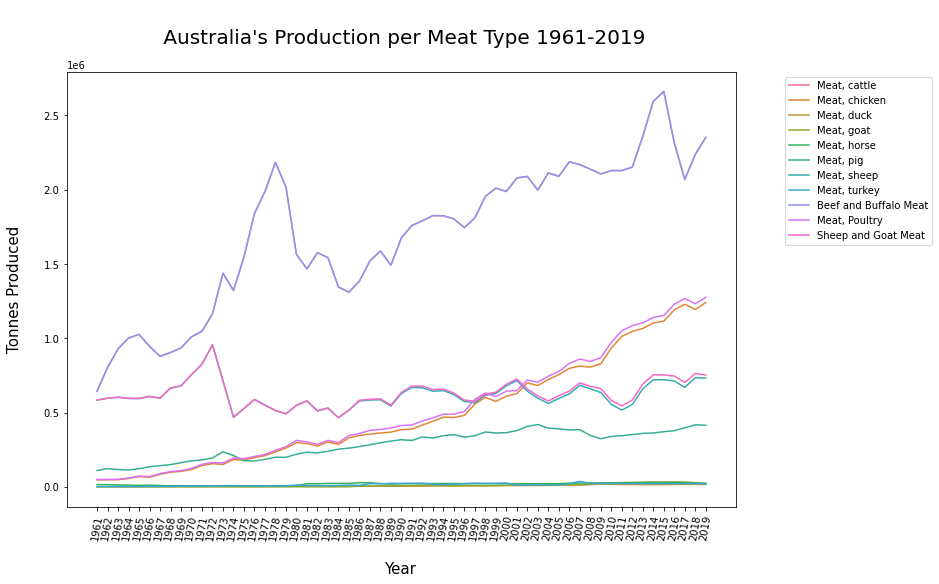

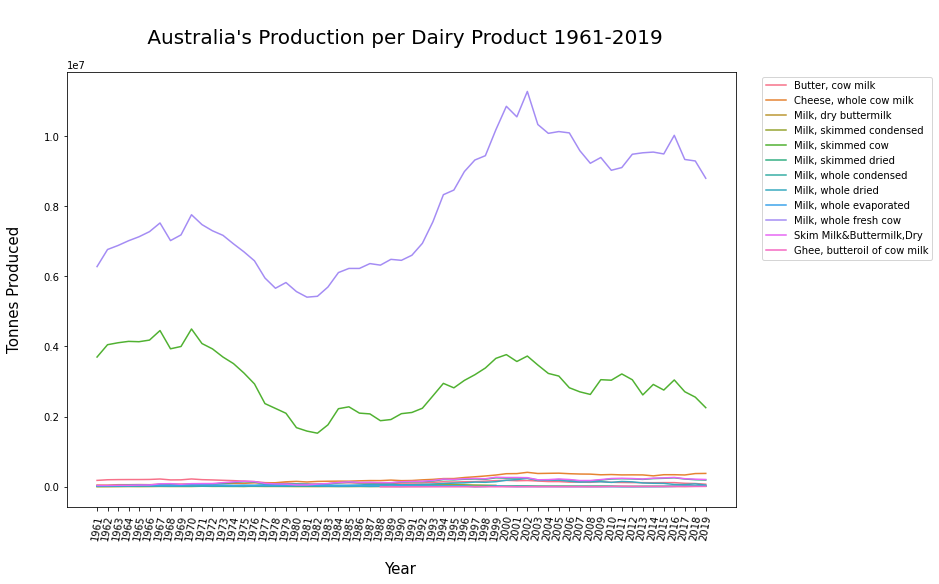

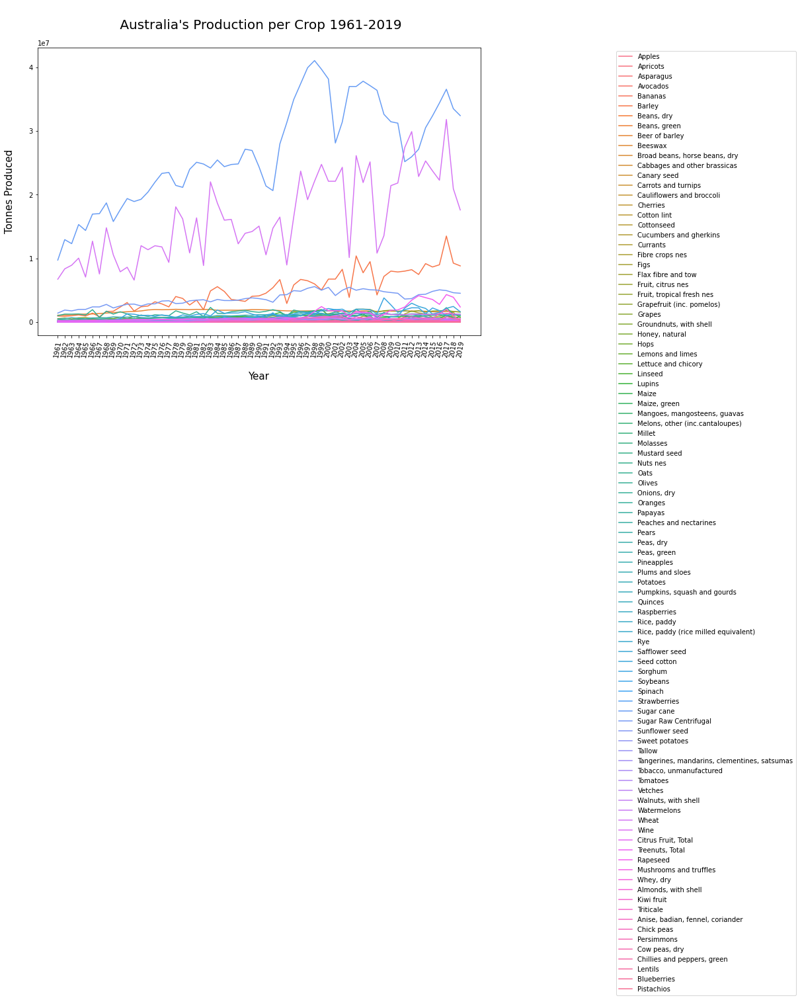

In [185]:
plotprodvisuals(oz_meat_prod, 'Meat Type', 'Australia')
plotprodvisuals(oz_dairy_prod, 'Dairy Product', 'Australia')
plotprodvisuals(oz_crop_prod, 'Crop', 'Australia')

<Figure size 864x576 with 0 Axes>

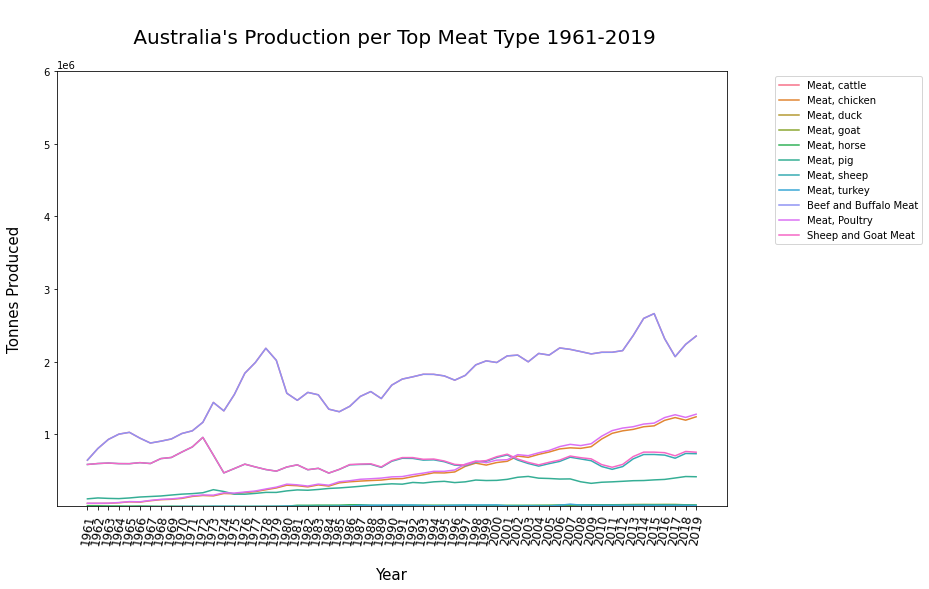

<Figure size 864x576 with 0 Axes>

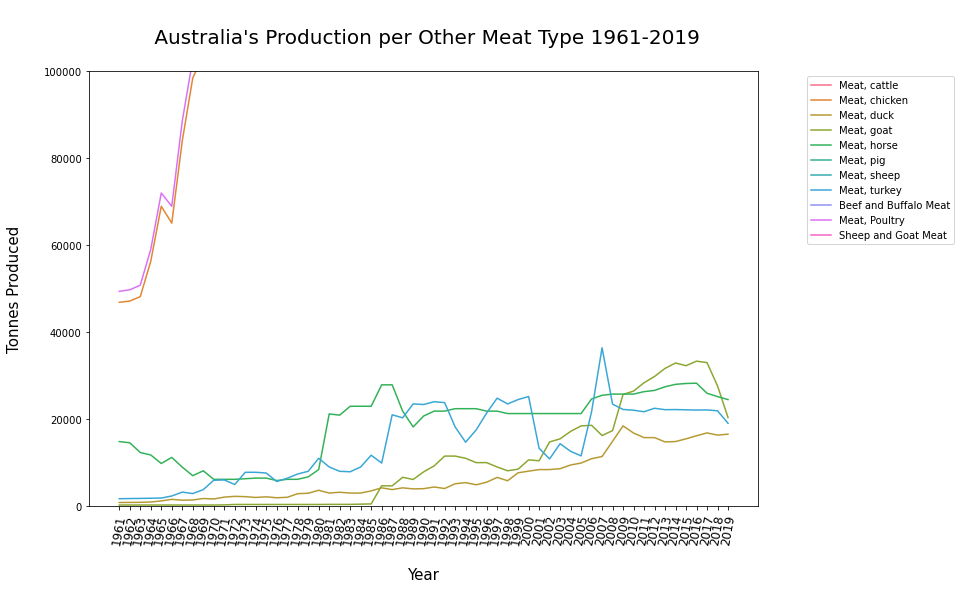

In [186]:
plotprodvisualsii(oz_meat_prod, "Meat Type", 10000, 6000000, 'Australia', 'Top ');
plotprodvisualsii(oz_meat_prod, "Meat Type",  0, 100000, 'Australia', 'Other ');

<Figure size 864x576 with 0 Axes>

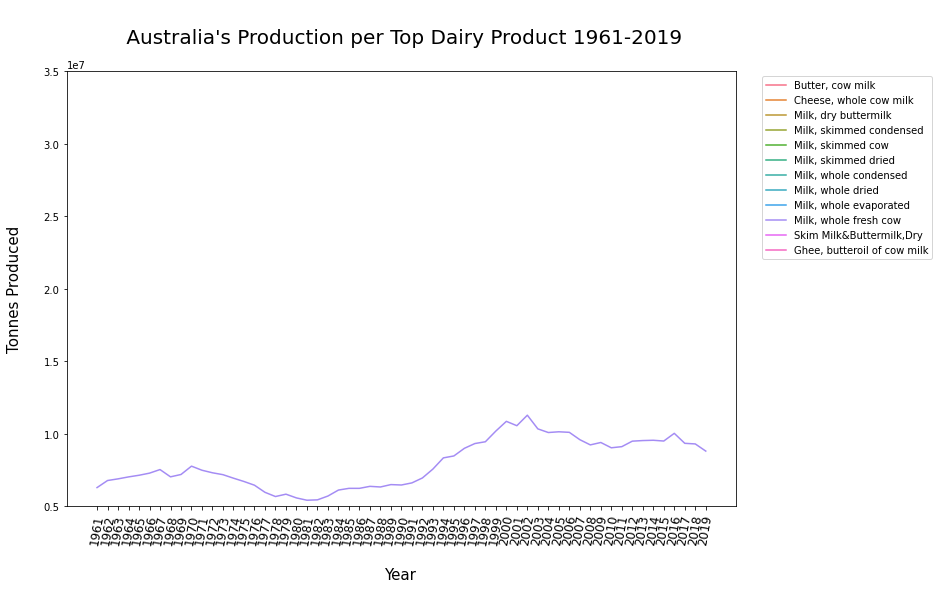

<Figure size 864x576 with 0 Axes>

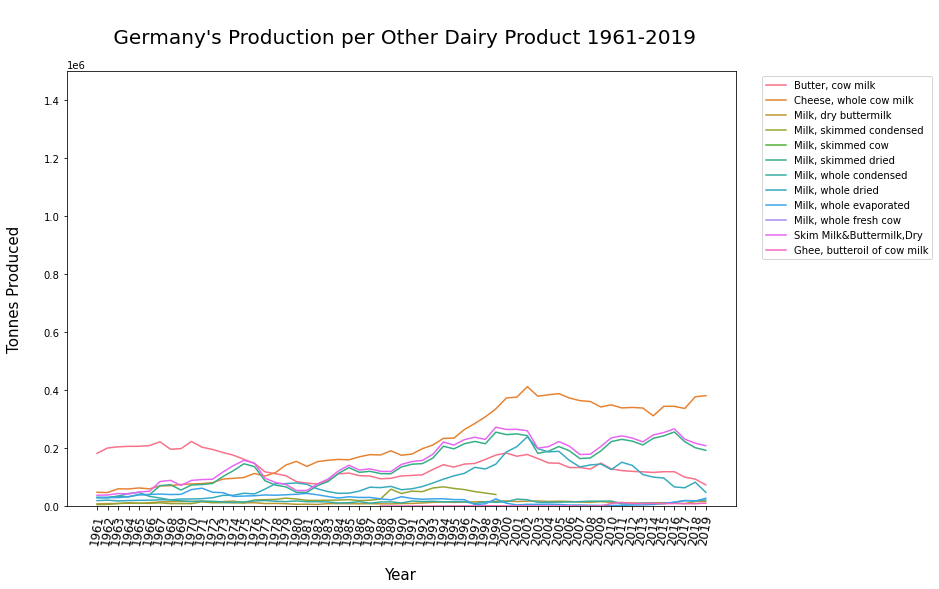

In [187]:
plotprodvisualsii(oz_dairy_prod, "Dairy Product", 5000000, 35000000, 'Australia', 'Top ');
plotprodvisualsii(oz_dairy_prod, "Dairy Product",  0, 1500000, 'Germany', 'Other ');

<Figure size 864x576 with 0 Axes>

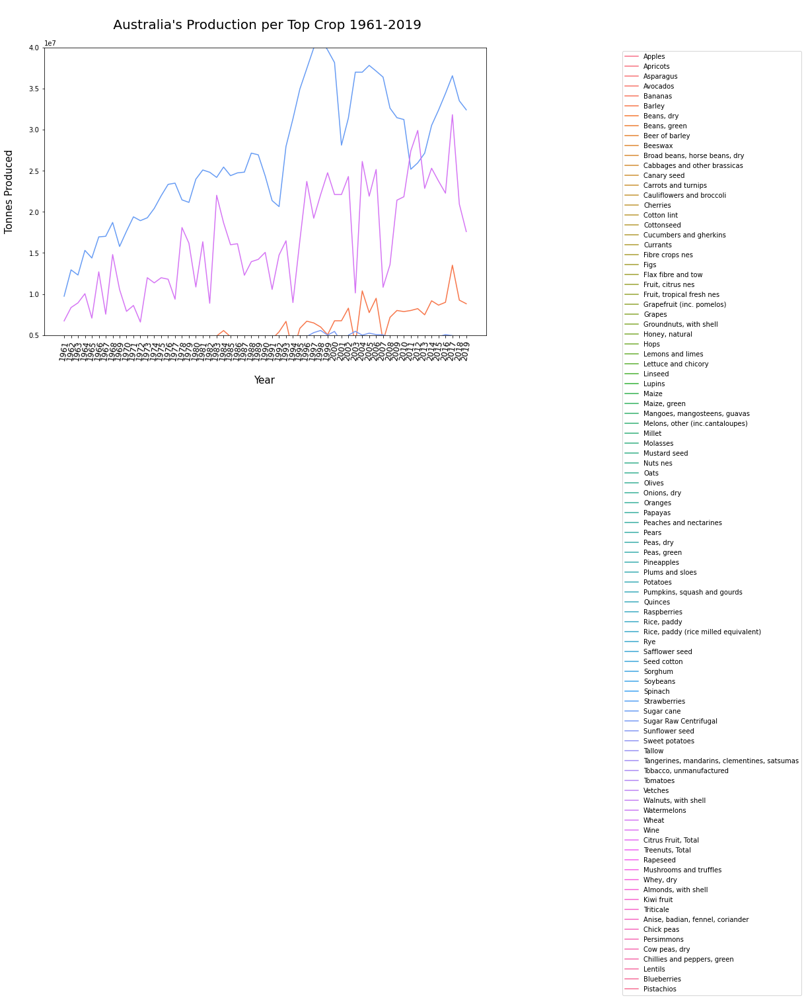

<Figure size 864x576 with 0 Axes>

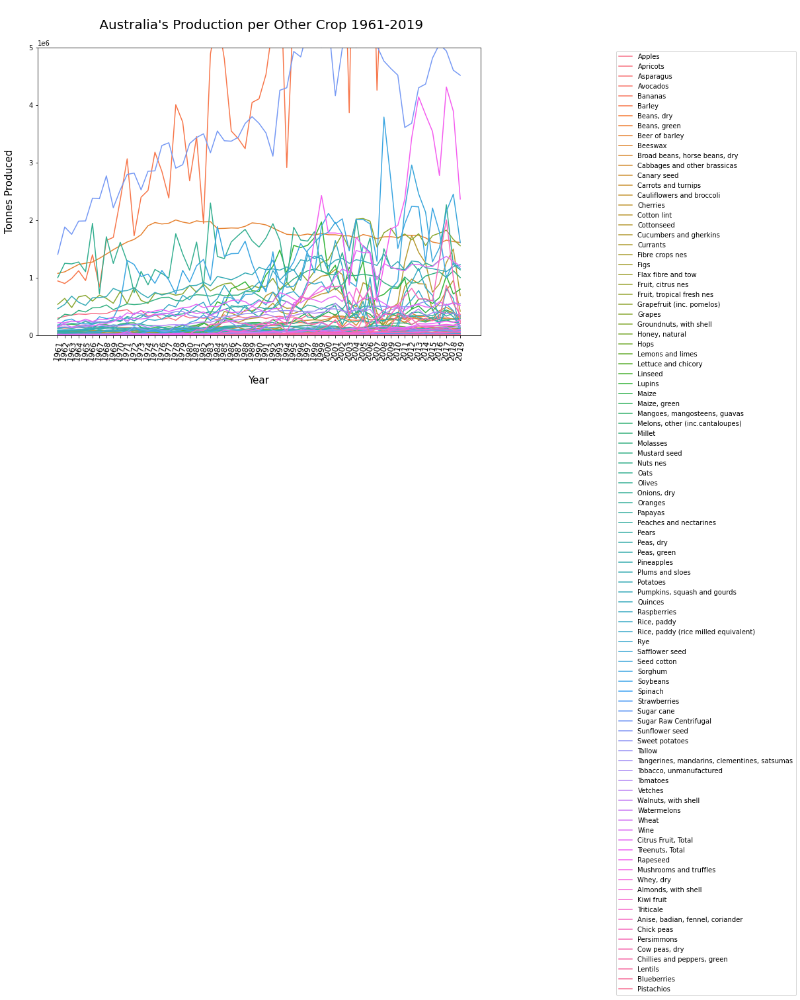

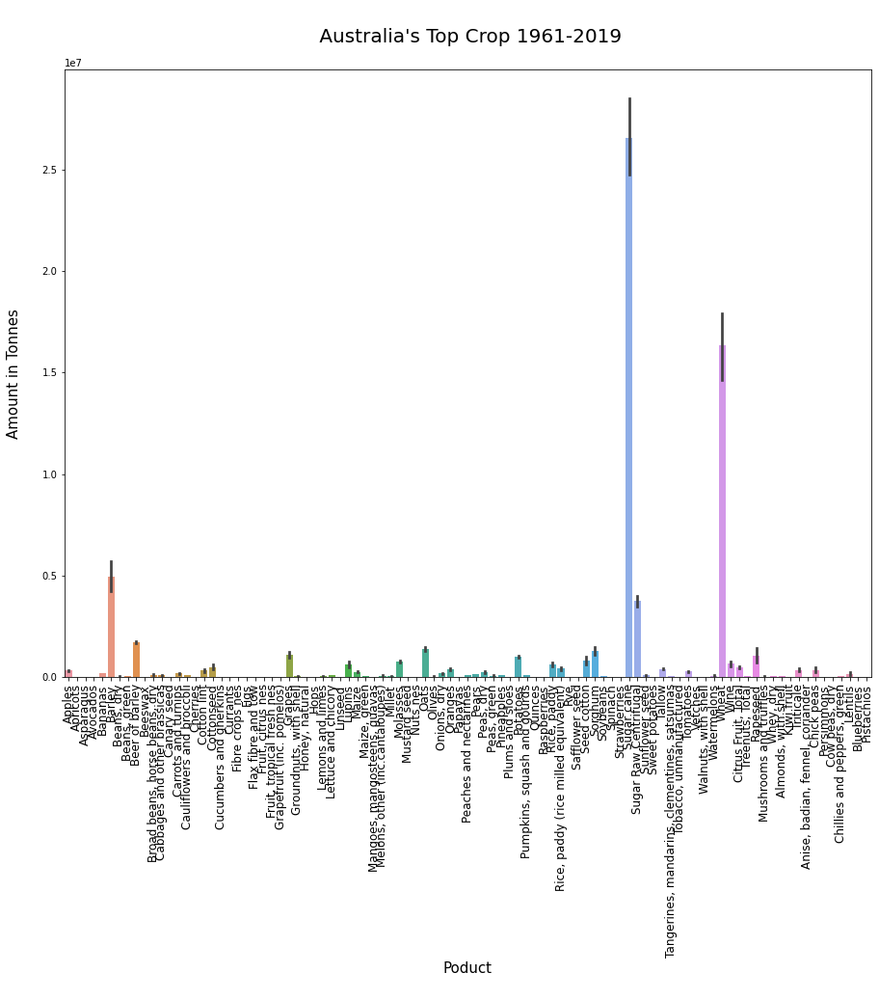

In [188]:
plotprodvisualsii(oz_crop_prod, "Crop", 5000000, 40000000, 'Australia', 'Top ');
plotprodvisualsii(oz_crop_prod, "Crop",  0, 5000000, 'Australia', 'Other ');
plotprodbar(oz_crop_prod, "Crop",'Australia');

## Australia Trade Datasets

In [189]:
# create australian dataset
oz_trade = oceania_trade_df.loc[oceania_trade_df['Country']=='Australia']

# australian import/ export datasets - all products (crop, meat, livestock)
oz_imports = oz_trade.loc[oz_trade['Element']=='Import Quantity']
oz_exports = oz_trade.loc[oz_trade['Element']=='Export Quantity']

# rename Value Columns 
oz_imports.rename(columns={'Value': 'Import Quantity'}, inplace=True)
oz_exports.rename(columns={'Value': 'Export Quantity'}, inplace=True)
oz_exports.rename(columns={'Unit': 'Export Unit'}, inplace=True)
oz_imports.rename(columns={'Unit': 'Import Unit'}, inplace=True)

#reset index
oz_imports.reset_index(drop=True, inplace=True)
oz_exports.reset_index(drop=True, inplace=True)


In [190]:
# merge population data. Outer merge so no data is lost 
oz_imports = pd.merge(oz_imports, aus_pop, how="outer", on = ["Year"])
oz_exports = pd.merge(oz_exports, aus_pop, how="outer", on = ["Year"])

oz_imports.head()
oz_exports.head()

,Country,Crop_Livestock,Element,Import Unit,Year,Import Quantity,Population_Australia
0,Australia,"Beans, dry",Import Quantity,tonnes,1961,4035,10483000
1,Australia,Beer of barley,Import Quantity,tonnes,1961,300,10483000
2,Australia,"Beverages, distilled alcoholic",Import Quantity,tonnes,1961,15790,10483000
3,Australia,"Beverages, non alcoholic",Import Quantity,tonnes,1961,100,10483000
4,Australia,Bread,Import Quantity,tonnes,1961,1000,10483000


,Country,Crop_Livestock,Element,Export Unit,Year,Export Quantity,Population_Australia
0,Australia,Apples,Export Quantity,tonnes,1961,109140,10483000
1,Australia,Bacon and ham,Export Quantity,tonnes,1961,180,10483000
2,Australia,Barley,Export Quantity,tonnes,1961,768800,10483000
3,Australia,Beer of barley,Export Quantity,tonnes,1961,7000,10483000
4,Australia,Beeswax,Export Quantity,tonnes,1961,90,10483000


In [191]:
oz_imports.shape
oz_exports.shape

(14571, 7)

(14970, 7)

## Merge Australia Trade & Production

In [192]:
# merge population data. 
oz_add_exports = pd.merge(oz_prod_pop, oz_exports, how="left", on = ["Crop_Livestock", "Year"])

In [193]:
oz_add_exports.head()
oz_add_exports.shape

,Prod Country,Crop_Livestock,Element_x,Production Unit,Year,Production Value,Population_Australia_x,Country,Element_y,Export Unit,Export Quantity,Population_Australia_y
0,Australia,Apples,Production,tonnes,1961,295034,10483000,Australia,Export Quantity,tonnes,109140.0,10483000.0
1,Australia,Apricots,Production,tonnes,1961,40691,10483000,NaN,NaN,NaN,NaN,NaN
2,Australia,Asparagus,Production,tonnes,1961,5262,10483000,NaN,NaN,NaN,NaN,NaN
3,Australia,Avocados,Production,tonnes,1961,400,10483000,NaN,NaN,NaN,NaN,NaN
4,Australia,Bananas,Production,tonnes,1961,123863,10483000,NaN,NaN,NaN,NaN,NaN


(8708, 12)

In [194]:
# drop duplicate / unnecessary columns
oz_to_drop = ['Element_x', 'Country', 'Element_y', 'Population_Australia_y']
oz_add_exports = oz_add_exports.drop(oz_to_drop, axis = 1)

# merge data. 
oz_df = pd.merge(oz_add_exports, oz_imports, how="outer", on = ["Crop_Livestock", "Year"])

# merge population data. Outer merge so no data is lost 
oz_df = pd.merge(oz_df, aus_pop, how="outer", on = ["Year"])
oz_df.head()

,Prod Country,Crop_Livestock,Production Unit,Year,Production Value,Population_Australia_x,Export Unit,Export Quantity,Country,Element,Import Unit,Import Quantity,Population_Australia_x,Population_Australia_y
0,Australia,Apples,tonnes,1961,295034.0,10483000.0,tonnes,109140.0,NaN,NaN,NaN,NaN,NaN,10483000
1,Australia,Apricots,tonnes,1961,40691.0,10483000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10483000
2,Australia,Asparagus,tonnes,1961,5262.0,10483000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10483000
3,Australia,Avocados,tonnes,1961,400.0,10483000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10483000
4,Australia,Bananas,tonnes,1961,123863.0,10483000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10483000


In [195]:
oz_df.columns

Index(['Prod Country', 'Crop_Livestock', 'Production Unit', 'Year',
       'Production Value', 'Population_Australia_x', 'Export Unit',
       'Export Quantity', 'Country', 'Element', 'Import Unit',
       'Import Quantity', 'Population_Australia_x', 'Population_Australia_y'],
      dtype='object')

In [196]:
# drop duplicate / unnecessary columns
oz_to_drop = ['Element', 'Country', 'Population_Australia_x']
oz_df = oz_df.drop(oz_to_drop, axis = 1)

# rename columns to include unit
oz_df.rename(columns={'Population_Australia_y' : 'Population_Australia'}, inplace=True)

#reorder columns 
oz_columns = ['Prod Country', 'Crop_Livestock', 'Year', 'Production Unit',  'Production Value', 'Import Unit', 'Import Quantity', 'Export Unit', 'Export Quantity',  'Population_Australia']
oz_df = oz_df.reindex(columns=oz_columns)

# check dataset
oz_df.head(100)

,Prod Country,Crop_Livestock,Year,Production Unit,Production Value,Import Unit,Import Quantity,Export Unit,Export Quantity,Population_Australia
0,Australia,Apples,1961,tonnes,295034.0,NaN,NaN,tonnes,109140.0,10483000
1,Australia,Apricots,1961,tonnes,40691.0,NaN,NaN,NaN,NaN,10483000
2,Australia,Asparagus,1961,tonnes,5262.0,NaN,NaN,NaN,NaN,10483000
3,Australia,Avocados,1961,tonnes,400.0,NaN,NaN,NaN,NaN,10483000
4,Australia,Bananas,1961,tonnes,123863.0,NaN,NaN,NaN,NaN,10483000
...,...,...,...,...,...,...,...,...,...,...
95,Australia,"Skins, sheep, fresh",1961,tonnes,146719.0,NaN,NaN,NaN,NaN,10483000
96,Australia,Sorghum,1961,tonnes,163187.0,NaN,NaN,tonnes,58.0,10483000
97,Australia,Soybeans,1961,tonnes,200.0,NaN,NaN,NaN,NaN,10483000
98,Australia,Spinach,1961,tonnes,1669.0,NaN,NaN,NaN,NaN,10483000


In [197]:
# number of missing values 
oz_df.isnull().sum()

Prod Country            10395
Crop_Livestock              0
Year                        0
Production Unit         10395
Production Value        10395
Import Unit              4503
Import Quantity          4503
Export Unit             14105
Export Quantity         14105
Population_Australia        0
dtype: int64

In [198]:
#check the amount of 0's in each column
oz_df_sparse = (oz_df == 0).sum()
oz_df_sparse

Prod Country            0
Crop_Livestock          0
Year                    0
Production Unit         0
Production Value        0
Import Unit             0
Import Quantity         0
Export Unit             0
Export Quantity         0
Population_Australia    0
dtype: int64

In [199]:
# drop all rows with NaN and 0 values

# first will replace 0 values with NaNs  
oz_df['Prod Country'].replace(to_replace = np.nan, value = 'Australia', inplace=True)

# first will replace 0 values with NaNs  
oz_df.replace(to_replace = np.nan, value = 0, inplace=True)

# check if we have any NaN values in our dataset
oz_df.isnull().sum()

Prod Country            0
Crop_Livestock          0
Year                    0
Production Unit         0
Production Value        0
Import Unit             0
Import Quantity         0
Export Unit             0
Export Quantity         0
Population_Australia    0
dtype: int64

In [200]:
oz_df_sparse

Prod Country            0
Crop_Livestock          0
Year                    0
Production Unit         0
Production Value        0
Import Unit             0
Import Quantity         0
Export Unit             0
Export Quantity         0
Population_Australia    0
dtype: int64

In [201]:
# cast value as int 
oz_df['Production Value'] = oz_df['Production Value'].astype('int')
oz_df['Import Quantity'] = oz_df['Import Quantity'].astype('int')
oz_df['Export Quantity'] = oz_df['Export Quantity'].astype('int')
oz_df['Population_Australia'] = oz_df['Population_Australia'].astype('int')

In [202]:
oz_df['Crop_Livestock'].unique()

array(['Apples', 'Apricots', 'Asparagus', 'Avocados', 'Bananas', 'Barley',
       'Beans, dry', 'Beans, green', 'Beer of barley', 'Beeswax',
       'Berries nes', 'Broad beans, horse beans, dry', 'Butter, cow milk',
       'Cabbages and other brassicas', 'Canary seed',
       'Carrots and turnips', 'Cauliflowers and broccoli',
       'Cheese, whole cow milk', 'Cherries', 'Cotton lint', 'Cottonseed',
       'Cucumbers and gherkins', 'Currants', 'Eggs, hen, in shell',
       'Fibre crops nes', 'Figs', 'Flax fibre and tow',
       'Fruit, citrus nes', 'Fruit, tropical fresh nes',
       'Grapefruit (inc. pomelos)', 'Grapes', 'Groundnuts, with shell',
       'Hides, cattle, fresh', 'Honey, natural', 'Hops', 'Lard',
       'Lemons and limes', 'Lettuce and chicory', 'Linseed', 'Lupins',
       'Maize', 'Maize, green', 'Mangoes, mangosteens, guavas',
       'Margarine, short', 'Meat, cattle', 'Meat, chicken', 'Meat, duck',
       'Meat, goat', 'Meat, horse', 'Meat, pig', 'Meat, sheep',
      

In [203]:
# replace items with differeng names across datasets 
oz_df.replace(to_replace = 'Meat, beef, preparations', value = 'Meat, beef' , inplace=True)
oz_df.replace(to_replace = 'Beef and Buffalo Meat', value = 'Meat, beef' , inplace=True)
oz_df.replace(to_replace = 'Meat, cattle, boneless (beef & veal)', value = 'Meat, beef' , inplace=True)
oz_df.replace(to_replace = 'Meat, cattle', value = 'Meat, beef' , inplace=True)
oz_df.replace(to_replace = 'Pigmeat', value = 'Meat, pig' , inplace=True)
oz_df.replace(to_replace = 'Meat, pig, preparations', value = 'Meat, pig' , inplace=True)
oz_df.replace(to_replace = 'Bovine Meat', value = 'Meat, beef' , inplace=True)
oz_df.replace(to_replace = 'Meat, goose and guinea fowl', value = 'Meat, goose' , inplace=True)
oz_df.replace(to_replace = 'Almonds, with shell', value = 'Almonds' , inplace=True)
oz_df.replace(to_replace = 'Almonds shelled', value = 'Almonds' , inplace=True)
oz_df.replace(to_replace = 'Hazelnuts, with shell', value = 'Hazelnuts' , inplace=True)
oz_df.replace(to_replace = 'Hazelnuts, shelled', value = 'Hazelnuts' , inplace=True)
oz_df.replace(to_replace = 'Cashew nuts, with shell', value = 'Cashew nuts' , inplace=True)
oz_df.replace(to_replace = 'Cashew nuts, shelled', value = 'Cashew nuts' , inplace=True)
oz_df.replace(to_replace = 'Oats rolled', value = 'Oats' , inplace=True)

## Feature Engineering - Australia Consumption

In [204]:
oz_df['consumption'] = (oz_df['Production Value'] + oz_df['Import Quantity']) - oz_df['Export Quantity']

In [205]:
# rename columns
oz_df.rename(columns={'Prod Country': 'prod_country', 'Crop_Livestock':'crop_livestock', 'Year': 'year', 
                           'Production Unit': 'production_unit', 'Production Value': 'production_value', 
                           'Import Unit': 'import_unit', 'Import Quantity': 'import_quantity',
                           'Export Unit': 'export_unit', 'Export Quantity': 'export_quantity'}, inplace=True)

In [206]:
oz_df.head()

,prod_country,crop_livestock,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Australia,consumption
0,Australia,Apples,1961,tonnes,295034,0,0,tonnes,109140,10483000,185894
1,Australia,Apricots,1961,tonnes,40691,0,0,0,0,10483000,40691
2,Australia,Asparagus,1961,tonnes,5262,0,0,0,0,10483000,5262
3,Australia,Avocados,1961,tonnes,400,0,0,0,0,10483000,400
4,Australia,Bananas,1961,tonnes,123863,0,0,0,0,10483000,123863


## Australia Meat/ Dairy/ Crop Datasets

In [207]:
# Aus production meat products
oz_meat = oz_df.loc[oz_df['crop_livestock'].str.contains('meat', case=False)]
oz_meat = oz_meat.loc[oz_meat['crop_livestock'].str.contains('nes|total|poultry|other|canned', case=False) == False]
oz_meat.rename(columns={'crop_livestock': 'Meat_Type'}, inplace=True)
oz_meat.reset_index(drop=True)

# Aus production dairy products
oz_dairy = oz_df.loc[oz_df['crop_livestock'].str.contains('milk|cream', case=False)]
oz_dairy.rename(columns={'crop_livestock': 'Dairy_Product'}, inplace=True)
oz_dairy.reset_index(drop=True)

# Aus production crops
oz_crop = oz_df.loc[oz_df['crop_livestock'].str.contains('total|chickpea|soy|almond|oat|hazelnut|cashew|tofu|avocado|mushroom|hemp|flax|chia|seaweed|yeast|quinoa|primary', case=False)]
oz_crop = oz_crop.loc[oz_crop['crop_livestock'].str.contains('meat|milk|offal|fat|hide|wool|sheep|cream|egg|lard|butter|cheese|oil|skin|goat|rice|juice|other|paste|sauce|canned|cake|frozen|nes|confectionery|oil|broken|waste|equivalent|tow', case=False) == False]
oz_crop.rename(columns={'crop_livestock': 'Crop'}, inplace=True)
oz_crop.reset_index(drop=True)


,prod_country,Meat_Type,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Australia,consumption
0,Australia,"Meat, beef",1961,tonnes,642924,0,0,tonnes,550,10483000,642374
1,Australia,"Meat, chicken",1961,tonnes,46858,0,0,tonnes,191,10483000,46667
2,Australia,"Meat, duck",1961,tonnes,830,0,0,0,0,10483000,830
3,Australia,"Meat, goat",1961,tonnes,250,0,0,0,0,10483000,250
4,Australia,"Meat, horse",1961,tonnes,14840,0,0,0,0,10483000,14840
...,...,...,...,...,...,...,...,...,...,...,...
971,Australia,"Meat, pig sausages",2019,0,0,tonnes,2610,0,0,25365745,2610
972,Australia,"Meat, pig",2019,0,0,tonnes,6393,0,0,25365745,6393
973,Australia,"Meat, pork",2019,0,0,tonnes,198707,0,0,25365745,198707
974,Australia,"Meat, beef",2019,0,0,tonnes,11463,0,0,25365745,11463


,prod_country,Dairy_Product,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Australia,consumption
0,Australia,"Butter, cow milk",1961,tonnes,182100,0,0,tonnes,62118,10483000,119982
1,Australia,"Cheese, whole cow milk",1961,tonnes,47700,tonnes,1567,tonnes,18326,10483000,30941
2,Australia,"Milk, dry buttermilk",1961,tonnes,7954,0,0,0,0,10483000,7954
3,Australia,"Milk, skimmed condensed",1961,tonnes,5085,0,0,0,0,10483000,5085
4,Australia,"Milk, skimmed cow",1961,tonnes,3698900,0,0,0,0,10483000,3698900
...,...,...,...,...,...,...,...,...,...,...,...
900,Australia,"Milk, Total",2019,tonnes,8795038,0,0,0,0,25365745,8795038
901,Australia,"Skim Milk&Buttermilk,Dry",2019,tonnes,208299,0,0,0,0,25365745,208299
902,Australia,"Buttermilk, curdled, acidified milk",2019,0,0,tonnes,2632,0,0,25365745,2632
903,Australia,Ice cream and edible ice,2019,0,0,tonnes,23049,0,0,25365745,23049


,prod_country,Crop,year,production_unit,production_value,import_unit,import_quantity,export_unit,export_quantity,Population_Australia,consumption
0,Australia,Avocados,1961,tonnes,400,0,0,0,0,10483000,400
1,Australia,Oats,1961,tonnes,1000270,0,0,tonnes,344800,10483000,655470
2,Australia,Soybeans,1961,tonnes,200,0,0,0,0,10483000,200
3,Australia,"Cereals, Total",1961,tonnes,9149882,0,0,0,0,10483000,9149882
4,Australia,"Citrus Fruit, Total",1961,tonnes,215121,0,0,0,0,10483000,215121
...,...,...,...,...,...,...,...,...,...,...,...
1014,Australia,Cashew nuts,2019,0,0,tonnes,16,0,0,25365745,16
1015,Australia,Hazelnuts,2019,0,0,tonnes,3347,0,0,25365745,3347
1016,Australia,Hazelnuts,2019,0,0,tonnes,11,0,0,25365745,11
1017,Australia,Oats,2019,0,0,tonnes,2029,0,0,25365745,2029


In [208]:
oz_crop['Crop'].unique()


array(['Avocados', 'Oats', 'Soybeans', 'Cereals, Total',
       'Citrus Fruit, Total', 'Fruit Primary', 'Pulses, Total',
       'Roots and Tubers, Total', 'Sugar Crops Primary',
       'Treenuts, Total', 'Vegetables Primary', 'Almonds', 'Cashew nuts',
       'Hazelnuts', 'Mushrooms and truffles', 'Flax fibre raw', 'Quinoa'],
      dtype=object)

In [209]:
# check Meat Type values are what we want for analysis
oz_meat['Meat_Type'].unique()

array(['Meat, beef', 'Meat, chicken', 'Meat, duck', 'Meat, goat',
       'Meat, horse', 'Meat, pig', 'Meat, sheep', 'Meat, turkey',
       'Sheep and Goat Meat', 'Meal, meat', 'Meat, pig sausages',
       'Meat, pork', 'Meat, game'], dtype=object)

In [210]:

oz_meat = oz_meat.loc[oz_meat['Meat_Type'].str.contains('Sheep and Goat Meat', case=False) == False]

In [211]:
oz_dairy['Dairy_Product'].unique()

array(['Butter, cow milk', 'Cheese, whole cow milk',
       'Milk, dry buttermilk', 'Milk, skimmed condensed',
       'Milk, skimmed cow', 'Milk, skimmed dried',
       'Milk, whole condensed', 'Milk, whole dried',
       'Milk, whole evaporated', 'Milk, whole fresh cow',
       'Evaporat&Condensed Milk', 'Milk, Total',
       'Skim Milk&Buttermilk,Dry', 'Cream fresh',
       'Ghee, butteroil of cow milk',
       'Buttermilk, curdled, acidified milk', 'Ice cream and edible ice',
       'Milk, products of natural constituents nes'], dtype=object)

In [212]:
oz_dairy = oz_dairy.loc[oz_dairy['Dairy_Product'] != 'Evaporat&Condensed Milk']
oz_dairy = oz_dairy.loc[oz_dairy['Dairy_Product'] != 'Buttermilk, curdled, acidified milk']
oz_dairy = oz_dairy.loc[oz_dairy['Dairy_Product'] != 'Ice cream and edible ice']
oz_dairy = oz_dairy.loc[oz_dairy['Dairy_Product'] != 'Skim Milk&Buttermilk,Dry']
oz_dairy = oz_dairy.loc[oz_dairy['Dairy_Product'] != 'Ghee, butteroil of cow milk']
oz_dairy = oz_dairy.loc[oz_dairy['Dairy_Product'].str.contains('total|nes', case=False) == False]

### Descriptive statistics per product type for all years

In [213]:
# for all meat products 1961-2019
oz_meat.describe()

# for all dairy products 1961-2019
oz_dairy.describe()

# for all crops 1961-2019
oz_crop.describe()

,production_value,import_quantity,export_quantity,Population_Australia,consumption
count,9.170000e+02,917.000000,917.000000,9.170000e+02,9.170000e+02
mean,3.120870e+05,6521.224646,19813.436205,1.761836e+07,2.987948e+05
std,6.020426e+05,27737.034072,61756.277775,4.102115e+06,5.868531e+05
min,0.000000e+00,0.000000,0.000000,1.048300e+07,-7.255000e+03
25%,0.000000e+00,0.000000,0.000000,1.435800e+07,1.300000e+03
50%,5.500000e+03,51.000000,0.000000,1.749500e+07,7.081000e+03
75%,3.453000e+05,1642.000000,5360.000000,2.069790e+07,3.054230e+05
max,2.661640e+06,251131.000000,494810.000000,2.536574e+07,2.661640e+06


,production_value,import_quantity,export_quantity,Population_Australia,consumption
count,6.020000e+02,602.000000,602.000000,6.020000e+02,6.020000e+02
mean,1.135208e+06,4743.626246,39806.676080,1.723021e+07,1.100145e+06
std,2.467076e+06,12979.804067,56056.813957,4.089990e+06,2.465390e+06
min,0.000000e+00,0.000000,0.000000,1.048300e+07,-2.282500e+04
25%,1.700000e+04,0.000000,1249.500000,1.403300e+07,9.951500e+03
50%,7.316200e+04,134.000000,13874.500000,1.706510e+07,3.431050e+04
75%,2.337825e+05,2661.250000,56651.500000,2.012740e+07,1.395985e+05
max,1.127100e+07,102232.000000,245229.000000,2.536574e+07,1.121339e+07


,production_value,import_quantity,export_quantity,Population_Australia,consumption
count,1.019000e+03,1019.000000,1019.000000,1.019000e+03,1.019000e+03
mean,3.479491e+06,1862.613346,12535.298332,1.772703e+07,3.468818e+06
std,8.709127e+06,7694.318175,56568.391632,4.013573e+06,8.711745e+06
min,0.000000e+00,0.000000,0.000000,1.048300e+07,1.000000e+00
25%,0.000000e+00,0.000000,0.000000,1.451400e+07,2.253000e+03
50%,6.260000e+04,0.000000,0.000000,1.766700e+07,7.476700e+04
75%,1.450915e+06,644.000000,0.000000,2.069790e+07,1.385080e+06
max,5.004934e+07,104580.000000,555918.000000,2.536574e+07,5.004934e+07


### Australia Visualisations

The below visualisations highlight the following observations:



In [214]:
oz_meat_list = oz_meat['Meat_Type'].unique()
oz_dairy_list = oz_dairy['Dairy_Product'].unique()
oz_crop_list = oz_crop['Crop'].unique()

#### Meat

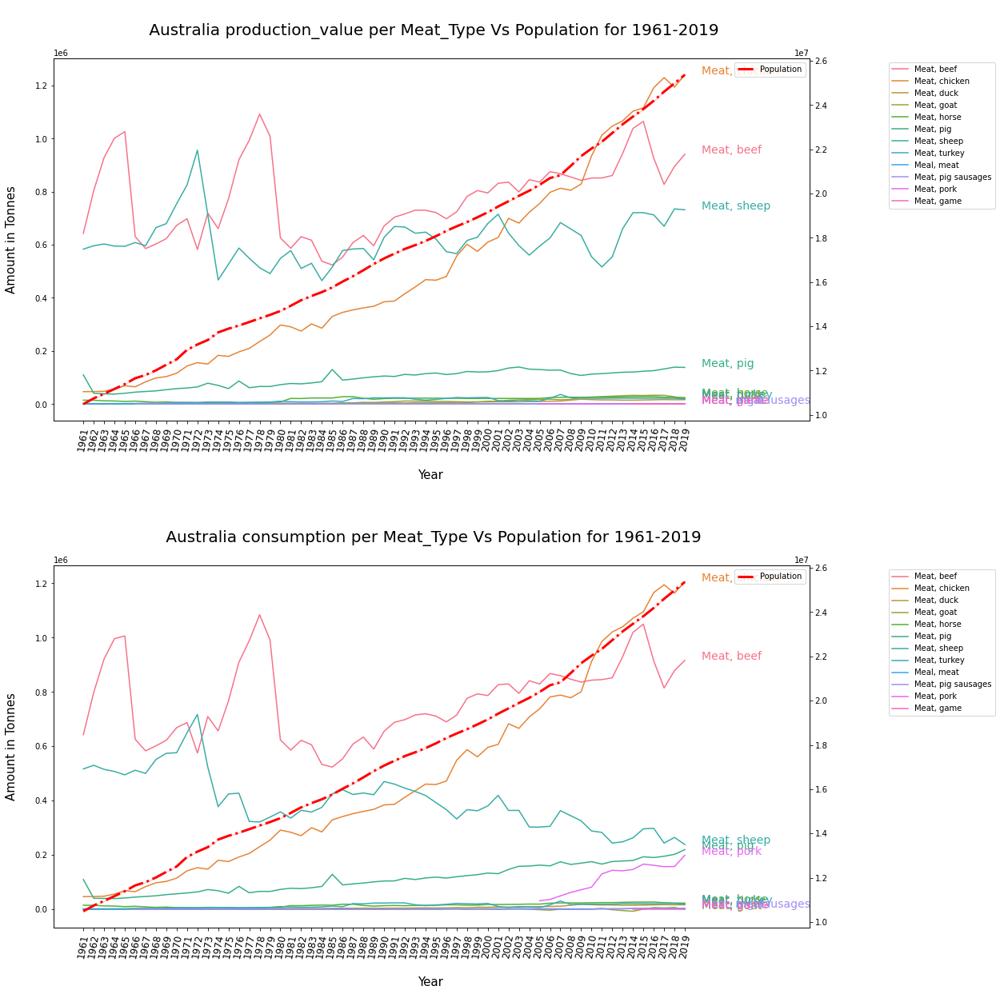

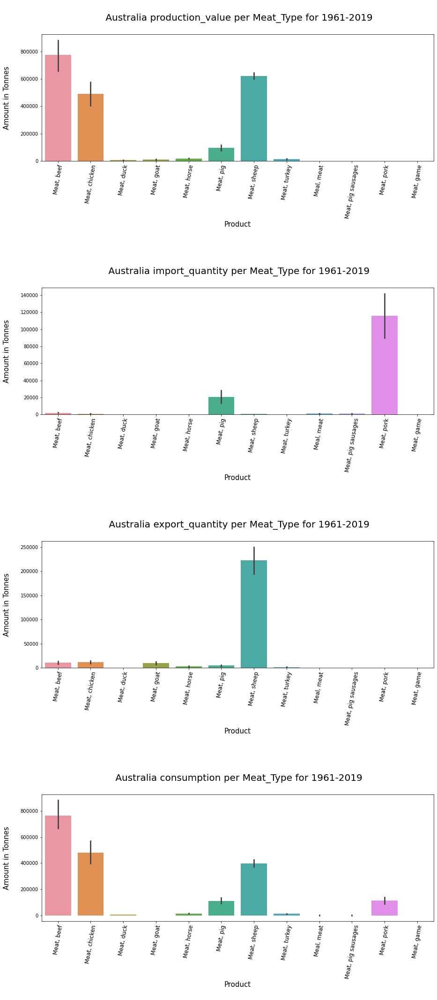

In [215]:
# oz meat visuals
plotlinegraphs(oz_meat, 'Meat_Type', 'Australia ', 'Population_Australia', oz_meat_list)
plotfigures(oz_meat, 'Meat_Type', 'Australia ');

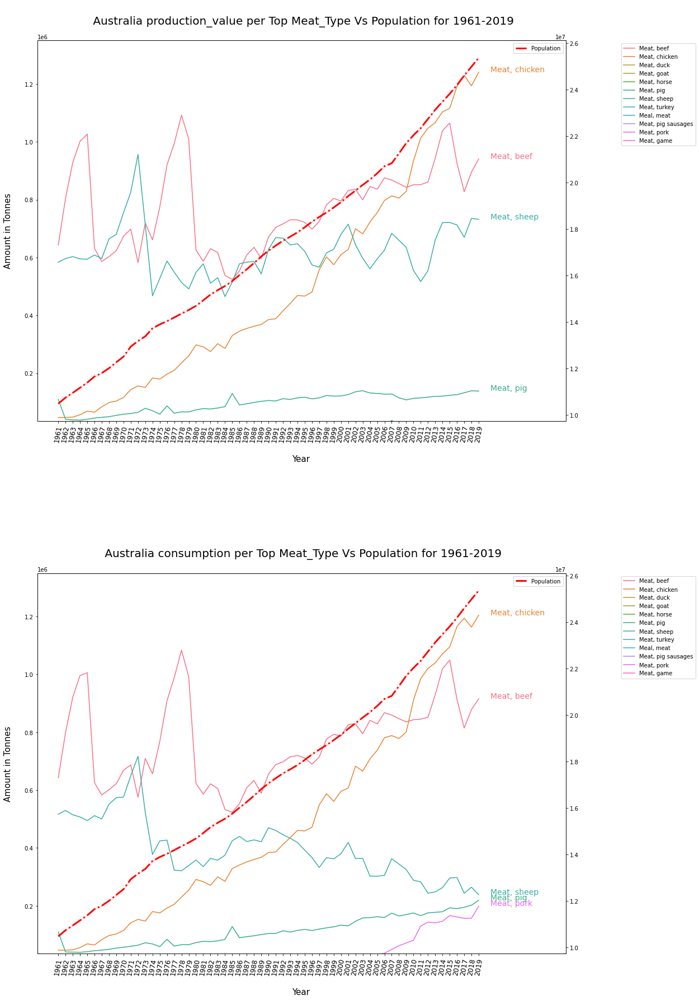

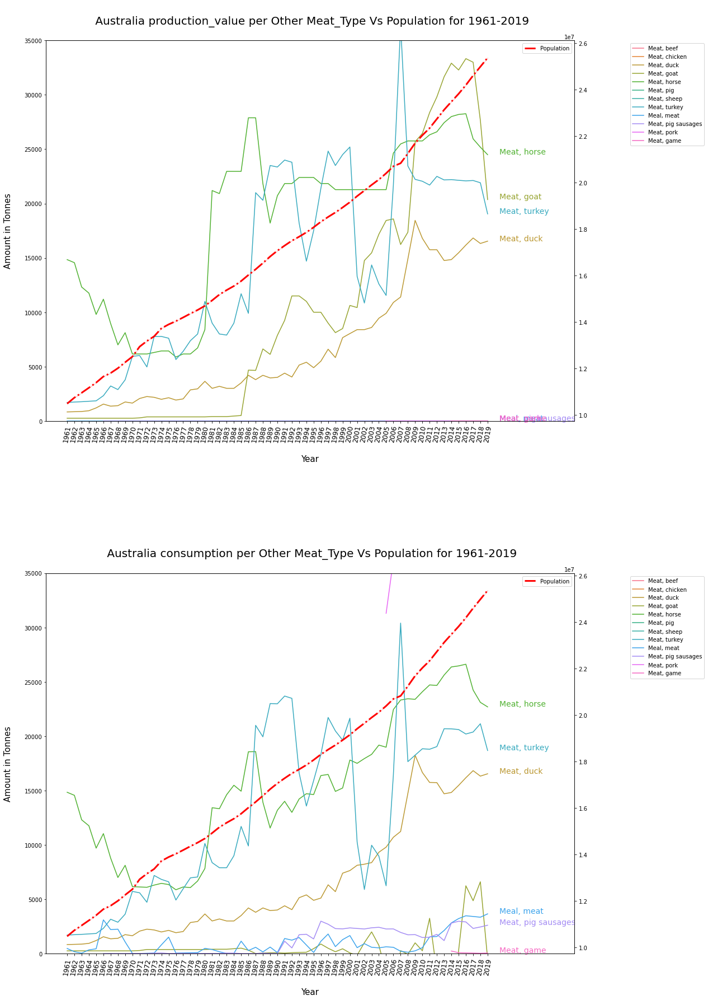

In [216]:
# oz meat visuals more detail 
plotlinegraphsii(oz_meat, 'Meat_Type', 35000, 1350000, 'Australia ', 'Population_Australia', oz_meat_list, 'Top ')
plotlinegraphsii(oz_meat, 'Meat_Type', 0, 35000, 'Australia ', 'Population_Australia', oz_meat_list,  'Other ')

#### Dairy

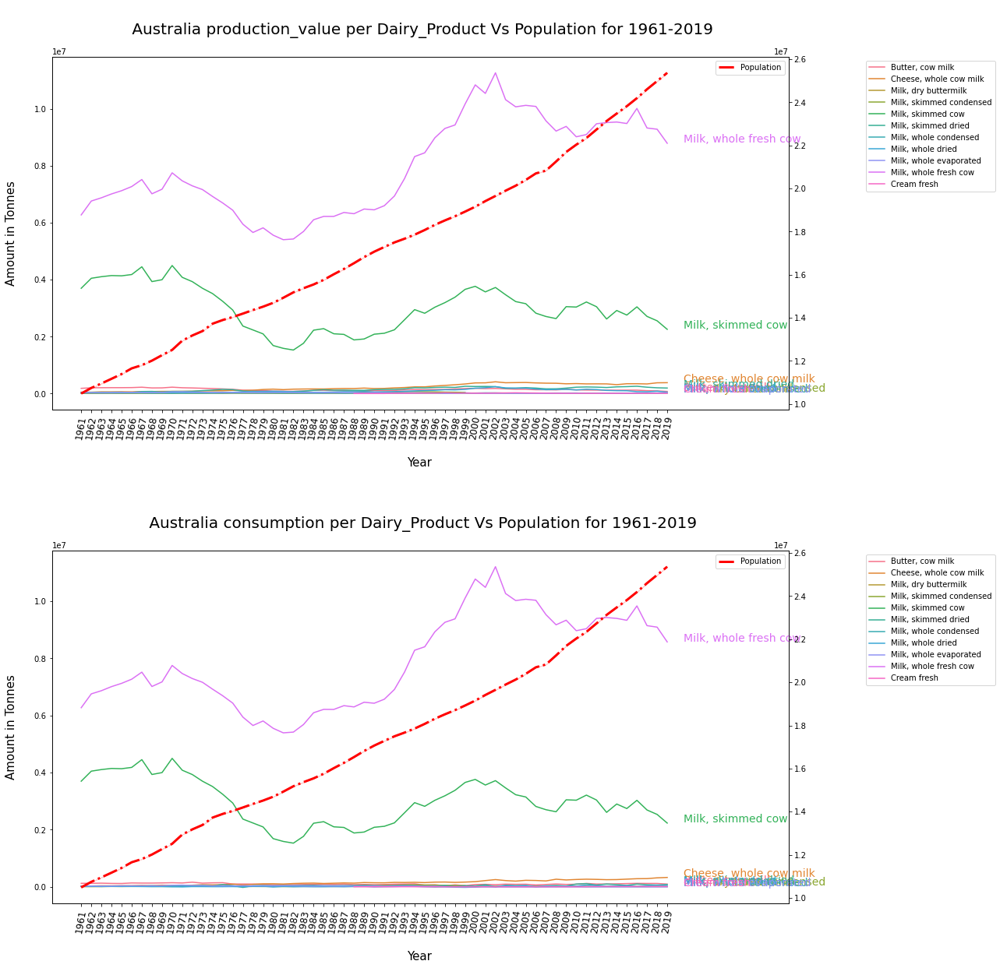

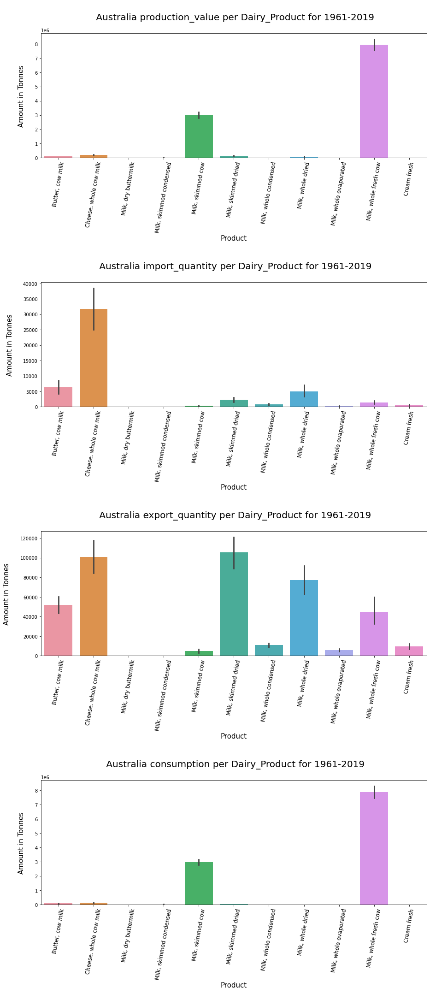

In [217]:
# oz dairy visuals
plotlinegraphs(oz_dairy, 'Dairy_Product', 'Australia ', 'Population_Australia', oz_dairy_list)
plotfigures(oz_dairy, 'Dairy_Product', 'Australia ');

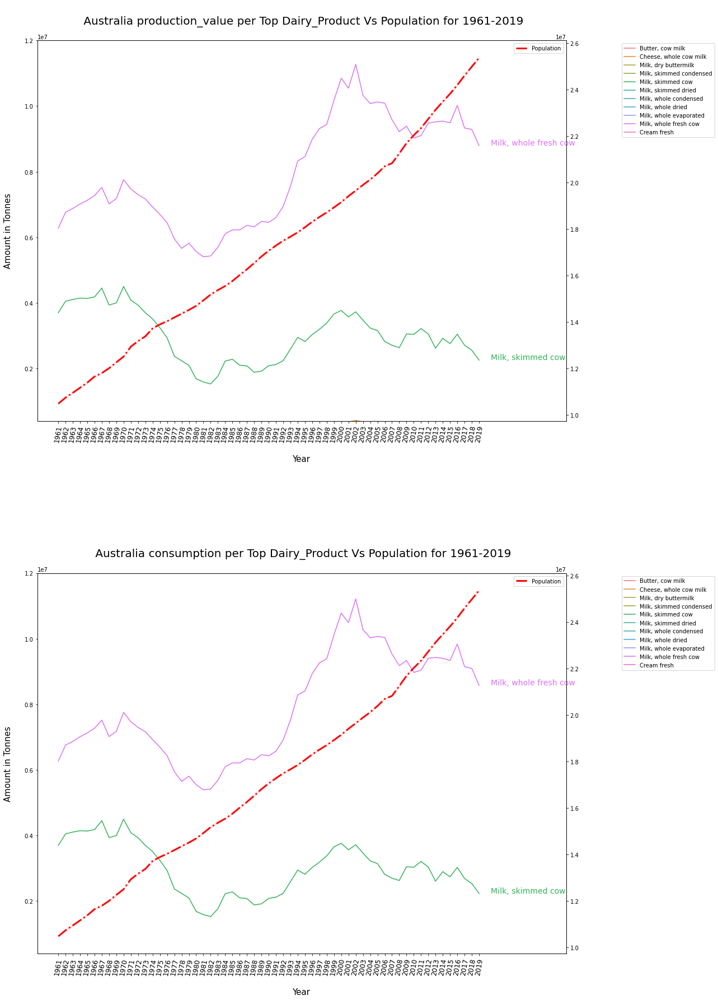

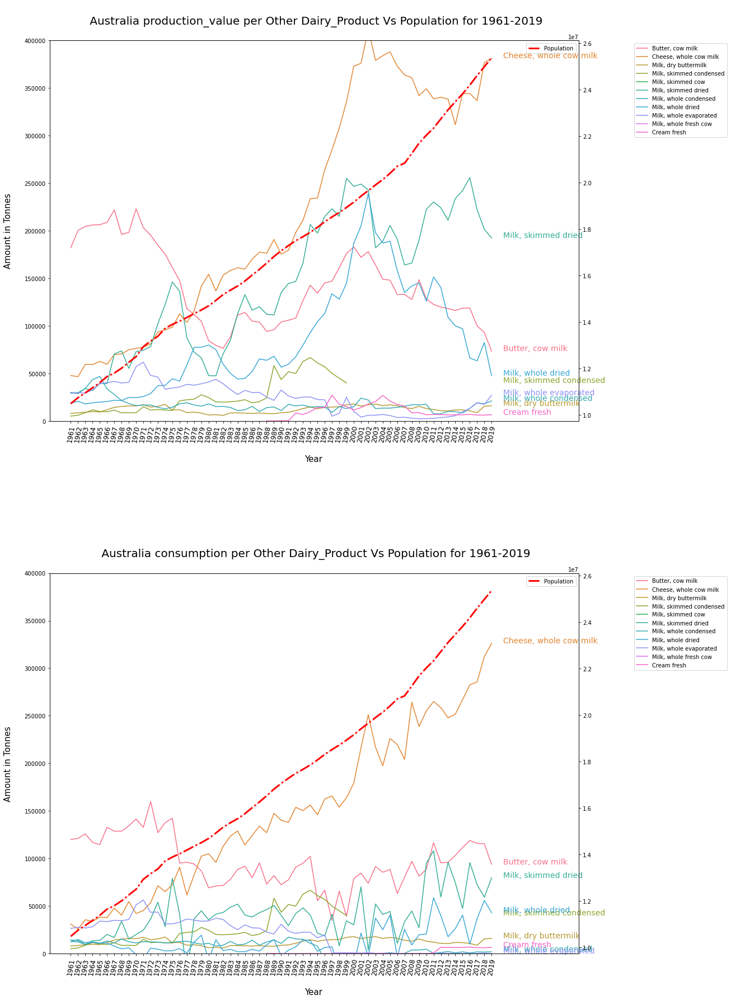

In [218]:
# oz dairy visuals more detail 
plotlinegraphsii(oz_dairy, 'Dairy_Product', 400000, 12000000, 'Australia ', 'Population_Australia', oz_dairy_list, 'Top ')
plotlinegraphsii(oz_dairy, 'Dairy_Product', 0, 400000, 'Australia ', 'Population_Australia', oz_dairy_list,  'Other ')

#### Crops

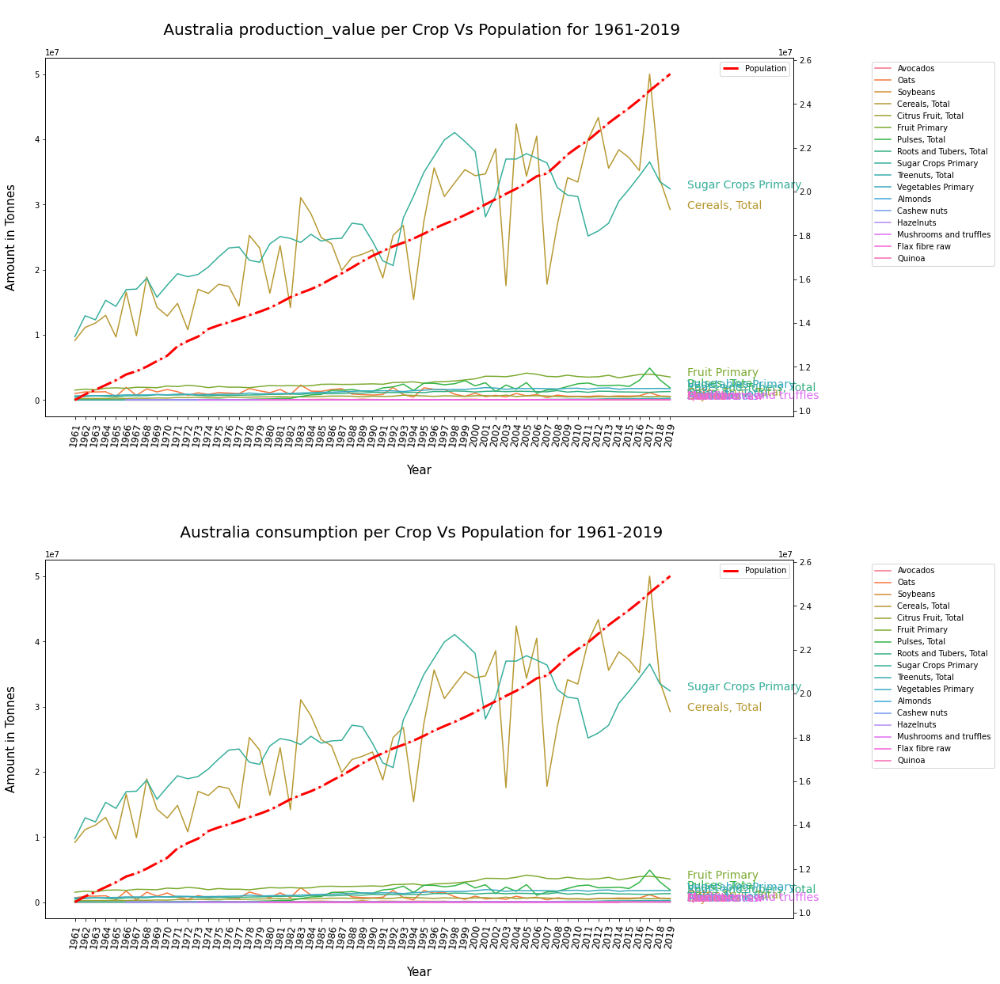

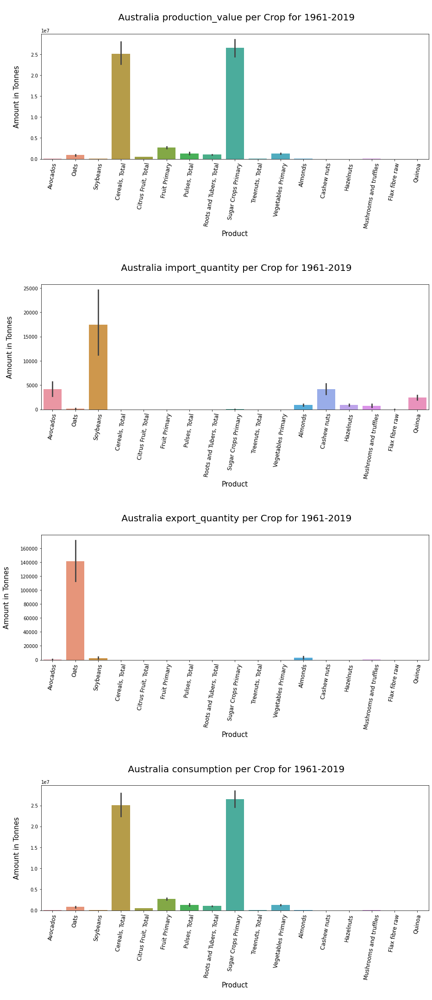

In [219]:
# oz crops visual
plotlinegraphs(oz_crop, 'Crop', 'Australia ', 'Population_Australia', oz_crop_list)
plotfigures(oz_crop, 'Crop', 'Australia ');

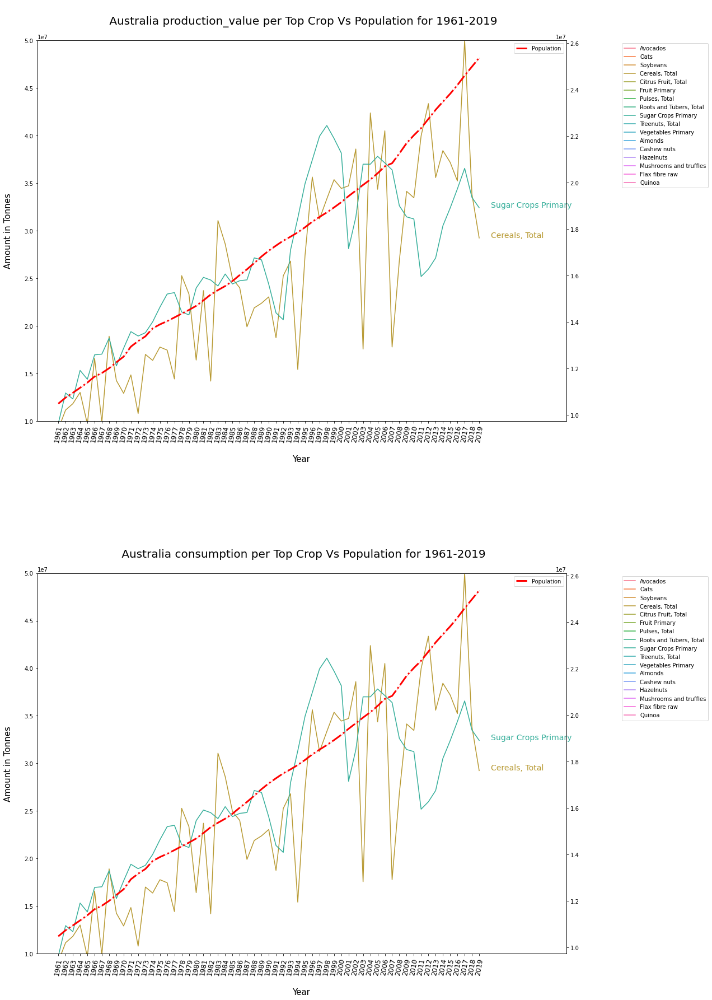

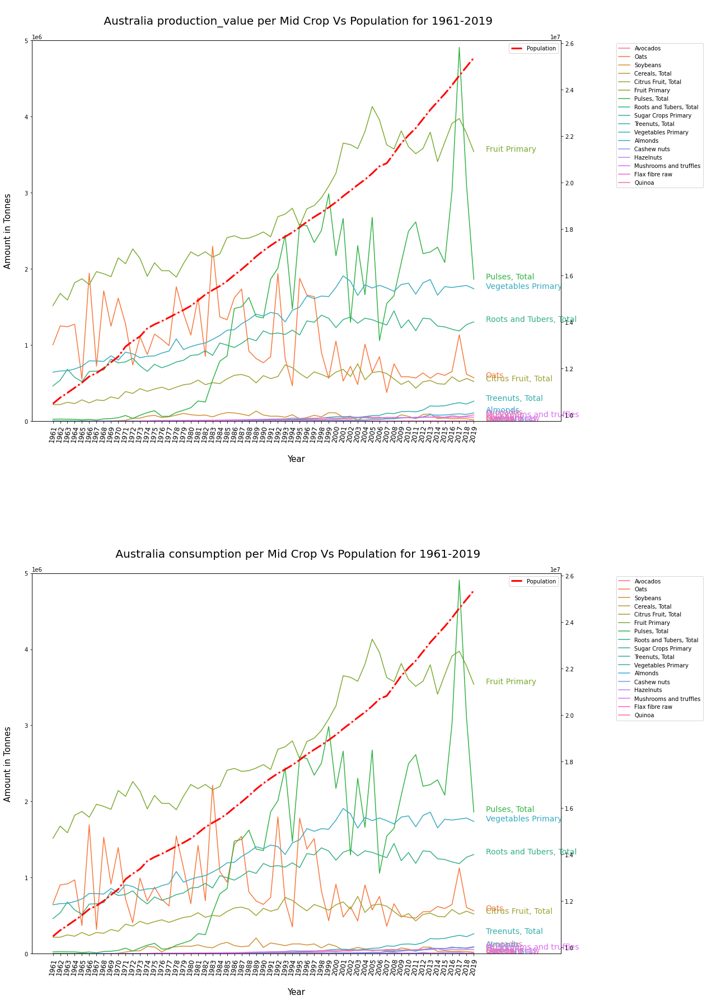

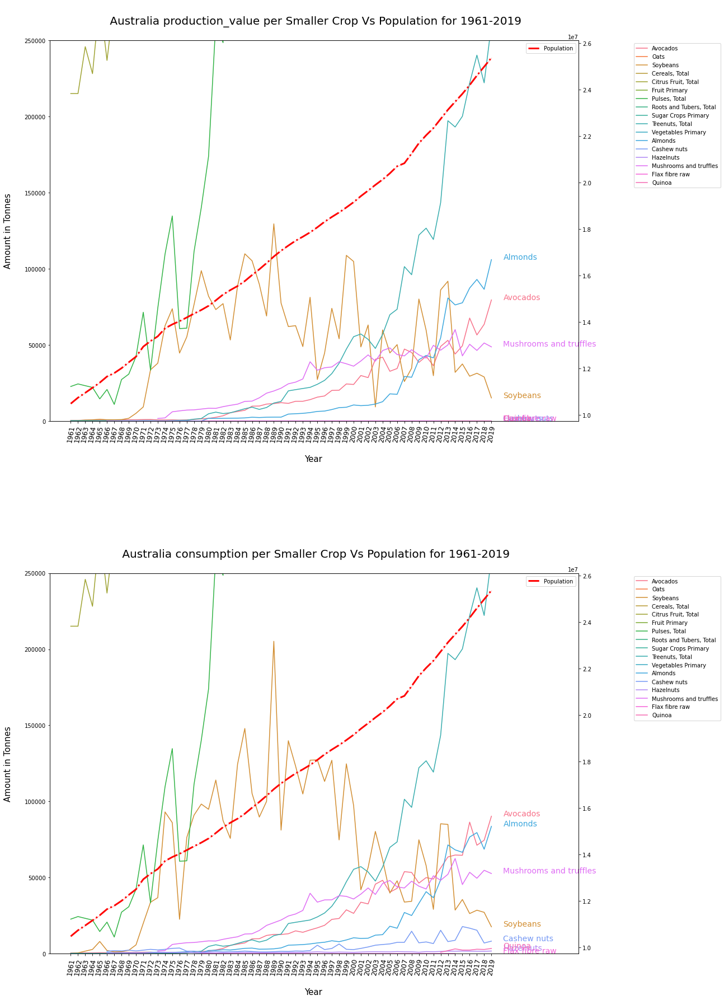

In [220]:
# oz crops visuals more detail 
plotlinegraphsii(oz_crop, 'Crop', 10000000, 50000000, 'Australia ', 'Population_Australia', oz_crop_list, 'Top ')
plotlinegraphsii(oz_crop, 'Crop', 0, 5000000, 'Australia ', 'Population_Australia', oz_crop_list, 'Mid ')
plotlinegraphsii(oz_crop, 'Crop', 0, 250000, 'Australia ', 'Population_Australia', oz_crop_list, 'Smaller ')


### Australia Production Pivot Table

In [221]:
#germany as a pivot table to see poduct values per year

oz_meat_table = pd.pivot_table(oz_meat, values='production_value', index=['prod_country', 'year'],
                    columns=['Meat_Type'], aggfunc=np.sum, fill_value=0)


oz_dairy_table = pd.pivot_table(oz_dairy, values='production_value', index=['prod_country', 'year'],
                    columns=['Dairy_Product'], aggfunc=np.sum, fill_value=0)


oz_crop_table = pd.pivot_table(oz_crop, values= 'production_value', index=['prod_country', 'year'],
                    columns=['Crop'], aggfunc=np.sum, fill_value=0)

In [222]:
oz_meat_table
oz_dairy_table
oz_crop_table

Meat_Type          Meal, meat  Meat, beef  Meat, chicken  Meat, duck  \
prod_country year                                                      
Australia    1961           0     1285848          46858         830   
             1962           0     1607900          47150         850   
             1963           0     1857212          48170         870   
             1964           0     2002630          56308         940   
             1965           0     2052574          68947        1200   
             1966           0     1892666          65073        1550   
             1967           0     1757366          83946        1360   
             1968           0     1808570          98439        1406   
             1969           0     1869532         103657        1746   
             1970           0     2019908         116267        1642   
             1971           0     2094400         143429        2067   
             1972           0     2328786         156058        2246   
             1973           0     2875888         150835        2174   
             1974           0     2643634         183673        1990   
             1975           0     3093930         179695        2136   
             1976           0     3680830         196611        1921   
             1977           0     3975600         209780        2029   
             1978           0     4367600         235490        2858   
             1979           0     4036000         260150        2955   
             1980           0     3128800         297898        3645   
             1981           0     2934400         291000        3000   
             1982           0     3152390         274815        3185   
             1983           0     3085780         302000        3000   
             1984           0     2690552         285929        3000   
             1985           0     2620040         330000        3500   
             1986           0     2769846         345300        4200   
             1987           0     3041446         354740        3800   
             1988           0     3175448         362289        4200   
             1989           0     2982956         368351        3958   
             1990           0     3353452         385215        4009   
             1991           0     3519138         388242        4397   
             1992           0     3581740         415569        4043   
             1993           0     3651626         441000        5140   
             1994           0     3649610         468722        5400   
             1995           0     3606834         466551        4900   
             1996           0     3489392         480544        5500   
             1997           0     3620600         557400        6600   
             1998           0     3910506         602100        5831   
             1999           0     4021060         575000        7664   
             2000           0     3975804         610000        8038   
             2001           0     4157800         627340        8400   
             2002           0     4179484         699528        8400   
             2003           0     3995126         681487        8600   
             2004           0     4225784         722471        9450   
             2005           0     4180544         755197        9900   
             2006           0     4376636         797416       10900   
             2007           0     4337892         812885       11400   
             2008           0     4276656         805373       14900   
             2009           0     4212770         828594       18450   
             2010           0     4257196         934352       16800   
             2011           0     4258042        1012542       15750   
             2012           0     4304062        1046748       15750   
             2013           0     4718128        1066506       14758   
             2014           0     519029

Dairy_Product      Butter, cow milk  Cheese, whole cow milk  Cream fresh  \
prod_country year                                                          
Australia    1961            182100                   47700            0   
             1962            200400                   46600            0   
             1963            204500                   59500            0   
             1964            206100                   59200            0   
             1965            206300                   62600            0   
             1966            208800                   59600            0   
             1967            221900                   69800            0   
             1968            196100                   70500            0   
             1969            198200                   74800            0   
             1970            223000                   76300            0   
             1971            203200                   77600            0   
             1972            195400                   80900            0   
             1973            184900                   93400            0   
             1974            175500                   95800            0   
             1975            161300                   98600            0   
             1976            147600                  112600            0   
             1977            118200                  103500            0   
             1978            111700                  115600            0   
             1979            104800                  141800            0   
             1980             84300                  154200            0   
             1981             79400                  136700            0   
             1982             76400                  153300            0   
             1983             88300                  158200            0   
             1984            111300                  161100            0   
             1985            114000                  159600            0   
             1986            105000                  170100            0   
             1987            103900                  177500            0   
             1988             94200                  176300           19   
             1989             95853                  190784            0   
             1990            104158                  175333          160   
             1991            105869                  179433          148   
             1992            108048                  198032         8343   
             1993            126456                  210917         6642   
             1994            142761                  233625         9887   
             1995            134400                  234400        14119   
             1996            145000                  264000        14121   
             1997            147000                  285000        27096   
             1998            161000                  307931        17672   
             1999            176000                  335447        14995   
             2000            183000                  373000        11435   
             2001            172000                  376000        13995   
             2002            178000                  412000        17782   
             2003            164000                  379000        20421   
             2004            149000                  384000        26796   
             2005            148000                  388000        20893   
             2006            133000                  373000        17410   
             2007            133100                  363817        15650   
             2008            127618                  360854         8570   
             2009            148495                  342016         8800   
             2010            128379                  349271         6513   
             2011            122486             

Crop               Almonds  Avocados  Cashew nuts  Cereals, Total  \
prod_country year                                                   
Australia    1961        0       400            0         9149882   
             1962        0       400            0        11143648   
             1963        0       500            0        11812267   
             1964        0       500            0        13001568   
             1965        0       600            0         9684056   
             1966        0       600            0        16585035   
             1967        0       700            0         9873734   
             1968        0       700            0        18905065   
             1969        0       800            0        14250318   
             1970        0       800            0        12904533   
             1971        0       900            0        14840092   
             1972        0       941            0        10781927   
             1973        0       688            0        16997800   
             1974        0       664            0        16367969   
             1975        0       710            0        17767379   
             1976        0       570            0        17448064   
             1977        0       662            0        14417267   
             1978        0       980            0        25274482   
             1979        0      1400            0        23343860   
             1980     3500      1700            0        16402312   
             1981     3250      2400            0        23703676   
             1982     3450      3400            0        14186565   
             1983     3600      5400            0        31068963   
             1984     3700      6200            0        28602111   
             1985     4000      7000            0        24942194   
             1986     4900      9700            0        24001774   
             1987     4500      9798            0        19899619   
             1988     4900     11082            0        21891006   
             1989     5000     11414            0        22375364   
             1990     5000     12005            0        23045332   
             1991     9000     11542            0        18747862   
             1992     9500     12925            0        25261706   
             1993    10000     12925            0        26805757   
             1994    11000     14000            0        15410973   
             1995    12500     15640            0        27389413   
             1996    13000     16416            0        35645886   
             1997    15000     20072            0        31238927   
             1998    17500     20174            0        33339400   
             1999    18000     24311            0        35368800   
             2000    21000     23976            0        34446938   
             2001    20100     29834            0        34718062   
             2002    20600     28485            0        38590113   
             2003    22200     40531            0        17553202   
             2004    25300     41897            0        42384122   
             2005    35600     32634            0        34357112   
             2006    35000     34452            0        40504980   
             2007    58500     47238            0        17771911   
             2008    57400     45000            0        26866214   
             2009    80400     38478            0        34140449   
             2010    86100     42486            0        33464873   
             2011    82900     36325            0        39973082   
             2012   109200     48951            0        43362426   
             2013   161600     52982            0        35589235   
             2014   152470     43969            0        38420402   
             2015   155300     49397            0        37195915   
             2016   174660     67600            0        35229824  

### Descriptive Statistics per product for all years

In [223]:
oz_meat_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
oz_dairy_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
oz_crop_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))

Meat_Type,"Meal, meat","Meat, beef","Meat, chicken","Meat, duck","Meat, game","Meat, goat","Meat, horse","Meat, pig","Meat, pig sausages","Meat, pork","Meat, sheep","Meat, turkey"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,0.00,3409392.34,490114.58,6600.47,0.00,9961.42,18469.78,281666.00,0.00,0.00,620041.49,14325.88
std,0.00,988023.24,360499.50,5474.78,0.00,10993.21,7721.28,95966.85,0.00,0.00,87307.17,8565.30
min,0.00,1285848.00,46858.00,830.00,0.00,250.00,5880.00,110000.00,0.00,0.00,464866.00,1700.00
25%,0.00,2730199.00,190142.00,2155.00,0.00,375.00,10500.00,196332.50,0.00,0.00,563715.50,7496.00
50%,0.00,3606834.00,385215.00,4200.00,0.00,7875.00,21280.00,312116.00,0.00,0.00,602984.00,13300.00
75%,0.00,4196657.00,738834.00,9675.00,0.00,16705.50,24568.00,362196.00,0.00,0.00,667887.00,22129.00
max,0.00,5323280.00,1240214.00,18450.00,0.00,33330.00,28262.00,418875.00,0.00,0.00,956328.00,36400.00


Dairy_Product,"Butter, cow milk","Cheese, whole cow milk",Cream fresh,"Milk, dry buttermilk","Milk, skimmed condensed","Milk, skimmed cow","Milk, skimmed dried","Milk, whole condensed","Milk, whole dried","Milk, whole evaporated","Milk, whole fresh cow"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,142337.93,217308.36,5762.46,12166.15,17279.64,2995764.83,143798.49,17343.85,84533.37,24561.86,7922110.56
std,41473.05,120921.96,7496.14,3480.39,19537.54,792449.75,71939.21,7705.25,56394.10,15513.22,1649577.11
min,73300.00,46600.00,0.00,5845.00,0.00,1527970.00,29591.00,7500.00,17860.00,2300.00,5406000.00
25%,109674.00,101050.00,0.00,8755.00,0.00,2267699.00,74006.00,13500.00,43004.00,7400.00,6470000.00
50%,133100.00,179433.00,148.00,11756.00,11328.00,3032732.00,144500.00,15315.00,67446.00,26252.00,7474000.00
75%,177000.00,341178.00,8685.00,15411.00,22643.50,3679935.50,208745.50,17955.50,127000.00,36634.50,9413500.00
max,223000.00,412000.00,27096.00,17900.00,66616.00,4498840.00,255792.00,46800.00,239000.00,61797.00,11271000.00


Crop,Almonds,Avocados,Cashew nuts,"Cereals, Total","Citrus Fruit, Total",Flax fibre raw,Fruit Primary,Hazelnuts,Mushrooms and truffles,Oats,"Pulses, Total",Quinoa,"Roots and Tubers, Total",Soybeans,Sugar Crops Primary,"Treenuts, Total",Vegetables Primary
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,34417.12,19413.12,0.00,25111722.25,493946.93,0.00,2723352.47,0.00,23707.17,1366544.54,1319821.63,0.00,1029696.86,50592.88,26558341.08,50861.59,1312513.88
std,57177.00,20992.76,0.00,10269320.79,136278.34,0.00,771961.84,0.00,19386.79,369771.82,1154957.04,0.00,276846.40,34292.40,7930949.44,72691.60,415053.35
min,0.00,400.00,0.00,9149882.00,215121.00,0.00,1516208.00,0.00,0.00,719012.00,10890.00,0.00,459513.00,200.00,9730296.00,126.00,641089.00
25%,0.00,850.00,0.00,16493673.50,422139.50,0.00,2074215.50,0.00,6311.50,1119567.50,91862.00,0.00,775348.00,28075.00,20896036.00,328.50,898495.00
50%,5000.00,11542.00,0.00,24001774.00,517514.00,0.00,2438355.00,0.00,21534.00,1270860.00,1471010.00,0.00,1130431.00,50149.00,25181814.00,12838.00,1378226.00
75%,30150.00,35388.50,0.00,34248780.50,583981.00,0.00,3576343.50,0.00,42758.00,1643702.00,2251661.00,0.00,1275362.50,76794.50,32518232.50,63462.50,1741916.00
max,212000.00,79533.00,0.00,50049336.00,751167.00,0.00,4131927.00,0.00,60023.00,2295787.00,4910252.00,0.00,1447602.00,129511.00,41064000.00,260227.00,1907018.00


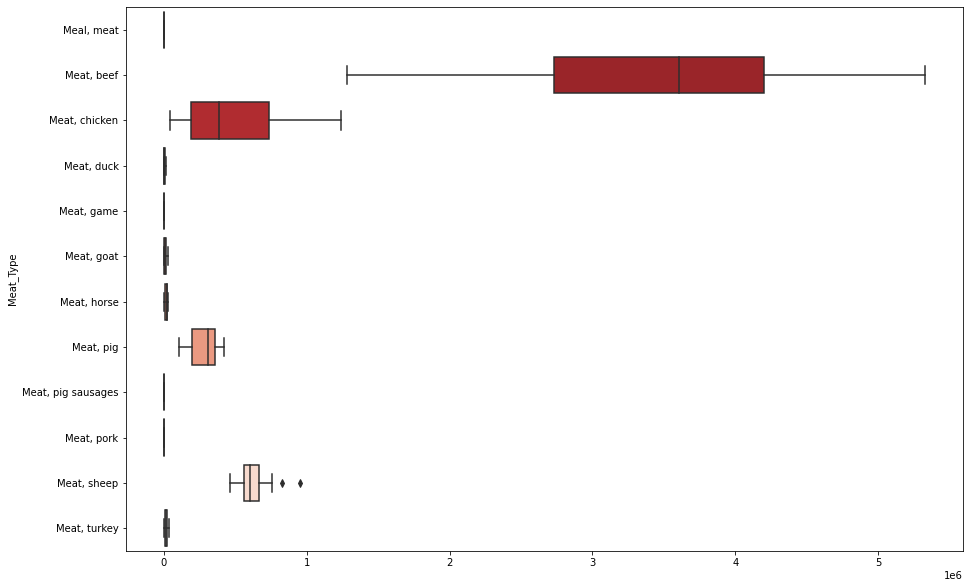

In [224]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=oz_meat_table, orient='h', palette='Reds_r');

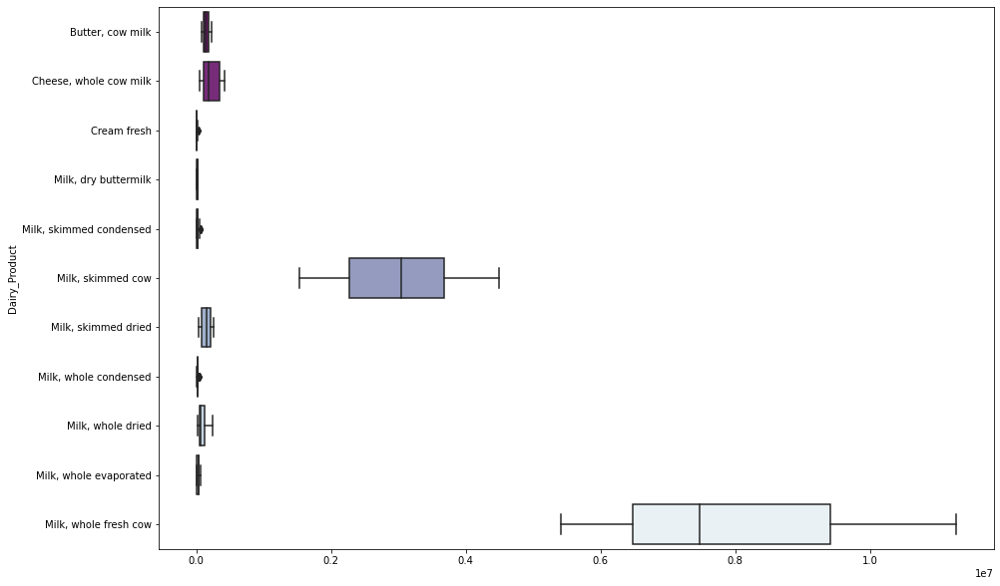

In [225]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=oz_dairy_table, orient='h', palette='BuPu_r');

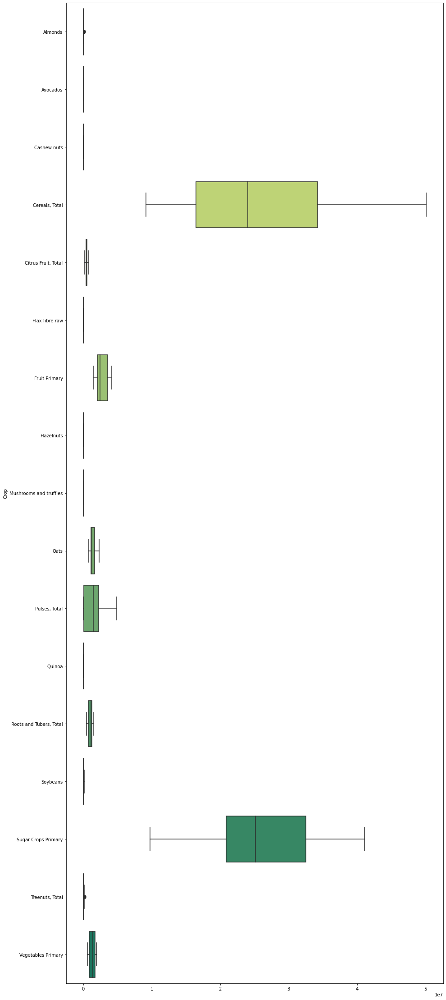

In [226]:
plt.figure(figsize=[15, 40])
sns.boxplot(data=oz_crop_table, orient='h', palette='summer_r');

## Inferential Statistics

https://statisticsbyjim.com/basics/descriptive-inferential-statistics/#:~:text=The%20most%20common%20methodologies%20in,the%20mean%20and%20standard%20deviation.

In order to perform appropriate Inferential analysis between countries, a number of tests will need to be performed on the data to determine what kind of statistical techniques can be used. 

First, the mean/ max/ min/ standard deviation for each variable will be determined using the .describe() function. Some products appear to have negative values included in their consumption figure.  As consumption is calculated as '(production + imports) - exports' , a negative consumption figure should not be possible and can only reflect that items produced in one year and exported in another year. 

Using pivot tables, items with a negative consumption value can be identified. The majority of products with a negative consumption number tend to be products that could potentially have longer shelf life such as dried milks, hard cheese, butters, truffles etc. Therefore it is acceptable to assume that any negative consumption vales relate to items that have a longer shelf life that could have been produced/ imported and exported in seperate years. 

Shapiro test and probability plots will be used to determine if data is normal and if parametric/ non parametric tests should be used.


In [227]:
# population data for all food items 
ireland_df.describe().apply(lambda s: s.apply('{0:.2f}'.format))

,production_value,import_quantity,export_quantity,Population_Ireland,consumption
count,19745.00,19745.00,19745.00,19745.00,19745.00
mean,73981.13,26002.39,3464.40,3786235.60,96519.12
std,455053.04,123703.74,22351.39,605067.27,471370.25
min,0.00,0.00,0.00,2824400.00,-122497.00
25%,0.00,71.00,0.00,3412800.00,230.00
50%,0.00,892.00,0.00,3590386.00,2300.00
75%,0.00,7059.00,0.00,4398942.00,18729.00
max,8244870.00,4050189.00,509654.00,4934340.00,8854427.00


In [228]:
# representative sample data 

# for all meat products 1961-2019
ireland_meat.describe().apply(lambda s: s.apply('{0:.2f}'.format))

# for all dairy products 1961-2019
ireland_dairy.describe().apply(lambda s: s.apply('{0:.2f}'.format))

# for all crops 1961-2019
ireland_crop.describe().apply(lambda s: s.apply('{0:.2f}'.format))

,production_value,import_quantity,export_quantity,Population_Ireland,consumption
count,1017.00,1017.00,1017.00,1017.00,1017.00
mean,68762.62,7057.86,10616.99,3766505.63,65203.49
std,149414.74,15836.25,28308.02,618515.81,136758.55
min,0.00,0.00,0.00,2824400.00,0.00
25%,0.00,9.00,0.00,3373750.00,709.00
50%,640.00,806.00,0.00,3590386.00,5773.00
75%,45000.00,6540.00,2965.00,4398942.00,34351.00
max,643800.00,129000.00,268506.00,4934340.00,643800.00


,production_value,import_quantity,export_quantity,Population_Ireland,consumption
count,599.00,599.00,599.00,599.00,599.00
mean,792017.65,18753.13,36653.70,3712561.42,774117.08
std,1646511.65,74072.62,52800.89,609356.92,1690154.11
min,0.00,0.00,0.00,2824400.00,-122497.00
25%,2250.00,75.50,0.00,3282200.00,763.00
50%,39000.00,909.00,7902.00,3558430.00,7844.00
75%,148100.00,5458.50,55274.50,4159914.00,48335.50
max,8244870.00,757811.00,291637.00,4934340.00,8854427.00


,production_value,import_quantity,export_quantity,Population_Ireland,consumption
count,923.00,923.00,923.00,923.00,923.00
mean,268983.26,1855.26,2059.08,3763747.80,268779.44
std,566857.95,6577.99,8386.04,613724.72,566930.60
min,0.00,0.00,0.00,2824400.00,-14633.00
25%,0.00,0.00,0.00,3373750.00,180.50
50%,1000.00,38.00,0.00,3576261.00,5850.00
75%,172500.00,415.50,0.00,4398942.00,170671.00
max,2635749.00,83671.00,81417.00,4934340.00,2635749.00


In [229]:
#ireland as a pivot table to see minimum comsumption poduct values per year

ireland_dairy_table = pd.pivot_table(ireland_dairy, values='consumption', index=['prod_country', 'year'],
                    columns=['Dairy_Product'], aggfunc=np.sum, fill_value=0)


ireland_crop_table = pd.pivot_table(ireland_crop, values='consumption', index=['prod_country', 'year'],
                    columns=['Crop'], aggfunc=np.sum, fill_value=0)

ireland_dairy_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
ireland_crop_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))

Dairy_Product,"Butter, cow milk","Cheese, sheep milk","Cheese, skimmed cow milk","Cheese, whole cow milk",Cream fresh,"Milk, skimmed cow","Milk, skimmed dried","Milk, whole condensed","Milk, whole dried","Milk, whole evaporated","Milk, whole fresh cow"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,27242.93,53.15,2177.15,26521.47,16835.88,2830921.10,22128.42,1016.34,2430.20,2584.93,4927344.88
std,25114.59,95.66,1508.31,25190.60,10808.27,825109.55,37415.54,1480.15,5375.38,5013.99,1451237.62
min,-44518.00,0.00,0.00,-5359.00,476.00,1402876.00,-122497.00,0.00,-8785.00,27.00,2355719.00
25%,8091.00,0.00,300.00,6963.00,3759.00,2176975.50,5838.00,47.00,156.00,101.50,3721496.00
50%,28122.00,0.00,2250.00,17254.00,20341.00,3025313.00,17878.00,469.00,954.00,506.00,5321891.00
75%,44096.50,70.00,3750.00,38889.50,24936.00,3183212.00,34164.00,956.00,3679.50,2037.00,5502212.00
max,85151.00,376.00,4435.00,120403.00,36293.00,4728020.00,114370.00,5635.00,18789.00,25600.00,8854427.00


Crop,Almonds,Avocados,Cashew nuts,"Cereals, Total",Flax fibre raw,Fruit Primary,Hazelnuts,Mushrooms and truffles,Oats,"Pulses, Total",Quinoa,"Roots and Tubers, Total",Soybeans,Sugar Crops Primary,Vegetables Primary
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,629.69,1054.68,114.78,1889416.07,17.03,27520.20,172.27,15465.63,167454.20,13223.20,49.78,830163.42,16132.05,1024685.02,218705.81
std,742.55,1693.38,170.65,405657.04,93.06,6108.71,113.40,15393.24,82892.08,17734.10,189.93,508387.54,17836.60,589799.73,42216.43
min,0.00,0.00,0.00,1107600.00,0.00,18100.00,0.00,-14633.00,89132.00,100.00,0.00,232000.00,0.00,45071.00,135400.00
25%,280.50,53.00,8.00,1515600.00,0.00,23200.00,112.00,3772.00,114673.00,1387.50,0.00,437200.00,405.50,731747.50,199041.50
50%,343.00,432.00,27.00,1966955.00,0.00,26200.00,161.00,10676.00,136680.00,7700.00,0.00,638000.00,11481.00,1273975.00,221192.00
75%,485.00,928.50,213.50,2139046.00,2.50,31597.00,195.50,23936.50,176790.00,20166.00,0.00,1090450.00,26506.00,1461999.50,244077.50
max,3152.00,7310.00,673.00,2635749.00,708.00,45000.00,774.00,60895.00,422767.00,90046.00,1066.00,2145000.00,83671.00,1861845.00,298500.00


In [230]:
# representative sample data 

# for all meat products 1961-2019
germany_meat.describe().apply(lambda s: s.apply('{0:.2f}'.format))

# for all dairy products 1961-2019
germany_dairy.describe().apply(lambda s: s.apply('{0:.2f}'.format))

# for all crops 1961-2019
germany_crop.describe().apply(lambda s: s.apply('{0:.2f}'.format))

,production_value,import_quantity,export_quantity,Population_Germany,consumption
count,1170.00,1170.00,1170.00,1170.00,1170.00
mean,408366.41,116735.10,30355.84,79692231.68,494745.66
std,1012250.18,210305.41,110304.28,2417491.32,1026543.18
min,0.00,0.00,0.00,73377632.00,100.00
25%,0.00,8477.50,0.00,78128282.00,22597.50
50%,4033.50,26314.50,3.00,79433029.00,57095.00
75%,59750.00,135558.00,1983.75,82047195.00,407019.75
max,5616074.00,1255519.00,1037659.00,83092962.00,5587814.00


,production_value,import_quantity,export_quantity,Population_Germany,consumption
count,803.00,803.00,803.00,803.00,803.00
mean,3530963.99,95591.33,190526.35,79733465.54,3436028.97
std,8346038.50,276798.51,377872.67,2386109.37,8212920.99
min,0.00,0.00,0.00,73377632.00,-242517.00
25%,32550.00,0.00,0.00,78128282.00,30000.00
50%,350300.00,15086.00,24275.00,79433029.00,235289.00
75%,706339.50,63075.50,215779.00,82047195.00,656742.50
max,34538496.00,2777928.00,2233207.00,83092962.00,33998106.00


,production_value,import_quantity,export_quantity,Population_Germany,consumption
count,1069.00,1069.00,1069.00,1069.00,1069.00
mean,4899506.40,195453.62,4692.31,79763625.67,5090267.72
std,10612335.84,722021.80,17816.51,2421233.06,10553911.40
min,0.00,0.00,0.00,73377632.00,1.00
25%,0.00,0.00,0.00,78128282.00,5200.00
50%,6100.00,1390.00,0.00,80013896.00,66758.00
75%,3041476.00,33085.00,0.00,82047195.00,3412142.00
max,52010400.00,4574084.00,285654.00,83092962.00,52010400.00


In [231]:
#germany as a pivot table to see minimum comsumption poduct values per year

germany_dairy_table = pd.pivot_table(germany_dairy, values='consumption', index=['prod_country', 'year'],
                    columns=['Dairy_Product'], aggfunc=np.sum, fill_value=0)

germany_dairy_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))


Dairy_Product,"Butter, cow milk","Cheese, goat milk","Cheese, sheep milk","Cheese, skimmed cow milk","Cheese, whole cow milk",Cream fresh,"Milk, skimmed cow","Milk, skimmed dried","Milk, skimmed evaporated","Milk, whole condensed","Milk, whole dried","Milk, whole evaporated","Milk, whole fresh cow","Milk, whole fresh goat","Milk, whole fresh sheep"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,597474.51,6475.32,4402.03,584187.20,687893.37,397748.34,14623433.10,228168.56,40105.66,8674.15,76738.78,322051.81,29112496.22,74864.68,222.88
std,115936.54,8450.15,4424.72,206167.51,247301.00,172680.76,2973695.12,209779.98,29482.10,12795.83,25016.80,149506.24,2425163.40,98502.53,1200.16
min,424613.00,1500.00,0.00,175300.00,322713.00,125000.00,10392355.00,-242517.00,6500.00,-23525.00,33348.00,76025.00,24847122.00,15890.00,0.00
25%,504924.50,2040.00,0.00,408643.50,469711.50,243985.00,11580203.00,89341.00,17650.00,33.00,56178.50,175034.50,27272478.50,27295.00,0.00
50%,581967.00,3150.00,3808.00,639558.00,689664.00,387466.00,14321799.00,139727.00,29100.00,651.00,74144.00,323724.00,28360206.00,36000.00,0.00
75%,690648.00,6280.50,7433.00,770000.00,872748.00,554620.50,17132312.50,358486.50,55257.50,18245.00,98916.50,468164.50,31167517.00,57870.00,0.00
max,838930.00,39600.00,25673.00,847800.00,1178279.00,641043.00,20308540.00,816951.00,106600.00,44696.00,132857.00,542055.00,33998106.00,457000.00,6650.00


In [232]:
# representative sample data 

# for all meat products 1961-2019
oz_meat.describe().apply(lambda s: s.apply('{0:.2f}'.format))

# for all dairy products 1961-2019
oz_dairy.describe().apply(lambda s: s.apply('{0:.2f}'.format))

# for all crops 1961-2019
oz_crop.describe().apply(lambda s: s.apply('{0:.2f}'.format))

,production_value,import_quantity,export_quantity,Population_Australia,consumption
count,917.00,917.00,917.00,917.00,917.00
mean,312086.96,6521.22,19813.44,17618361.74,298794.75
std,602042.58,27737.03,61756.28,4102115.19,586853.10
min,0.00,0.00,0.00,10483000.00,-7255.00
25%,0.00,0.00,0.00,14358000.00,1300.00
50%,5500.00,51.00,0.00,17495000.00,7081.00
75%,345300.00,1642.00,5360.00,20697900.00,305423.00
max,2661640.00,251131.00,494810.00,25365745.00,2661640.00


,production_value,import_quantity,export_quantity,Population_Australia,consumption
count,602.00,602.00,602.00,602.00,602.00
mean,1135207.78,4743.63,39806.68,17230209.62,1100144.73
std,2467075.76,12979.80,56056.81,4089989.78,2465390.16
min,0.00,0.00,0.00,10483000.00,-22825.00
25%,17000.00,0.00,1249.50,14033000.00,9951.50
50%,73162.00,134.00,13874.50,17065100.00,34310.50
75%,233782.50,2661.25,56651.50,20127400.00,139598.50
max,11271000.00,102232.00,245229.00,25365745.00,11213387.00


,production_value,import_quantity,export_quantity,Population_Australia,consumption
count,1019.00,1019.00,1019.00,1019.00,1019.00
mean,3479490.64,1862.61,12535.30,17727033.53,3468817.95
std,8709127.03,7694.32,56568.39,4013573.24,8711745.47
min,0.00,0.00,0.00,10483000.00,1.00
25%,0.00,0.00,0.00,14514000.00,2253.00
50%,62600.00,0.00,0.00,17667000.00,74767.00
75%,1450915.00,644.00,0.00,20697900.00,1385080.00
max,50049336.00,104580.00,555918.00,25365745.00,50049336.00


In [233]:
#oz as a pivot table to see minimum comsumption poduct values per year

oz_meat_table = pd.pivot_table(oz_meat, values='consumption', index=['prod_country', 'year'],
                    columns=['Meat_Type'], aggfunc=np.sum, fill_value=0)

oz_dairy_table = pd.pivot_table(oz_dairy, values='consumption', index=['prod_country', 'year'],
                    columns=['Dairy_Product'], aggfunc=np.sum, fill_value=0)

oz_meat_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))
oz_dairy_table.describe().apply(lambda s: s.apply('{0:.2f}'.format))


Meat_Type,"Meal, meat","Meat, beef","Meat, chicken","Meat, duck","Meat, game","Meat, goat","Meat, horse","Meat, pig","Meat, pig sausages","Meat, pork","Meat, sheep","Meat, turkey"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,971.66,3371160.59,479574.29,6543.51,8.59,317.25,15259.80,328750.37,1032.75,29399.76,398206.71,12754.17
std,1057.85,970937.93,350338.90,5443.95,34.01,1923.15,6446.86,155086.04,1124.48,57394.44,103731.97,7687.75
min,0.00,1285298.00,46667.00,830.00,0.00,-7255.00,5872.00,109554.00,0.00,0.00,238155.00,1700.00
25%,138.50,2716710.00,186320.50,2155.00,0.00,95.50,10370.00,194289.50,10.00,0.00,324429.50,6098.50
50%,578.00,3555173.00,384135.00,4200.00,0.00,272.00,14709.00,312534.00,58.00,0.00,375011.00,10272.00
75%,1496.50,4163166.00,722864.00,9557.50,0.00,400.00,19082.50,478545.50,2268.00,15653.50,453200.50,20072.00
max,3653.00,5247431.00,1204711.00,18246.00,235.00,6606.00,26620.00,658177.00,2984.00,198707.00,716866.00,30407.00


Dairy_Product,"Butter, cow milk","Cheese, whole cow milk",Cream fresh,"Milk, dry buttermilk","Milk, skimmed condensed","Milk, skimmed cow","Milk, skimmed dried","Milk, whole condensed","Milk, whole dried","Milk, whole evaporated","Milk, whole fresh cow"
count,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00,59.00
mean,96893.46,148179.32,889.86,12166.15,17279.64,2991255.85,40748.80,7385.27,12098.00,19173.95,7879135.24
std,26126.18,84383.43,2230.64,3480.39,19537.54,792830.48,24990.06,5777.67,16024.43,16580.29,1618293.87
min,34916.00,25770.00,-155.00,5845.00,0.00,1527970.00,-22825.00,-6612.00,-21258.00,20.00,5392325.00
25%,79283.00,71866.50,0.00,8755.00,0.00,2259431.00,23012.50,1046.50,2928.50,331.00,6449527.00
50%,94231.00,140141.00,0.00,11756.00,11328.00,3028094.00,40631.00,9570.00,9022.00,22585.00,7470694.00
75%,116773.00,218388.00,0.00,15411.00,22643.50,3677124.50,49715.50,12262.50,18491.00,33357.00,9337285.00
max,159871.00,326131.00,6903.00,17900.00,66616.00,4498840.00,108174.00,17328.00,58680.00,56389.00,11213387.00


### Probability Plot

Use probability plot and shapiro test to determine normality. The type of tests used will depend on the data being tested. If the data is not normal, Nonparametric statistical methods will need to be used as these tests do not assume a normal distribution.

As shown by the probability plots, most data seems to follow a right skewed or positively skewed distribution and is not normal. Meaning, the distribution of values of this data are clustered around the left tail of the distribution while the right tail of the distribution is longer.

In [234]:
# Is data normal?

list = ['production_value','import_quantity','export_quantity','consumption']


def probplot(dataset, country):
    plt.figure(figsize = (15,3))
    for i in enumerate(list):
        plt.subplot(1,4,i[0]+1)
        stats.probplot(dataset[i[1]], plot = plt)
        plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.6, hspace=None)
        plt.title('\n ' + country + i[1] + ' Normality \n', fontsize=10)
plt.show();

In [235]:
def histplot(dataset, country):
    plt.figure(figsize = (15,3))
    for i in enumerate(list):
        plt.subplot(1,4,i[0]+1)
        sns.histplot(dataset[i[1]], kde=True)
        plt.subplots_adjust(left=0.1, bottom=None, right=None, top=None, wspace=0.6, hspace=None)
        plt.title('\n ' + country + i[1] + ' \n', fontsize=10)    
plt.show();

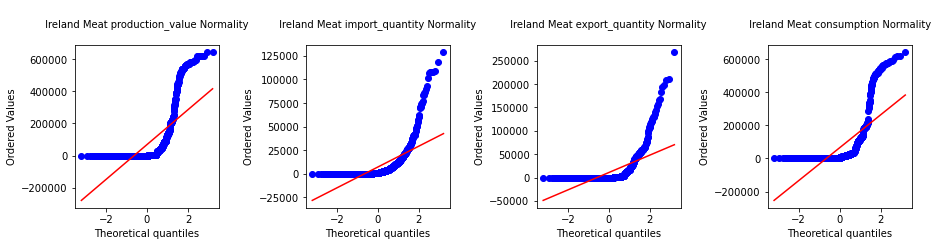

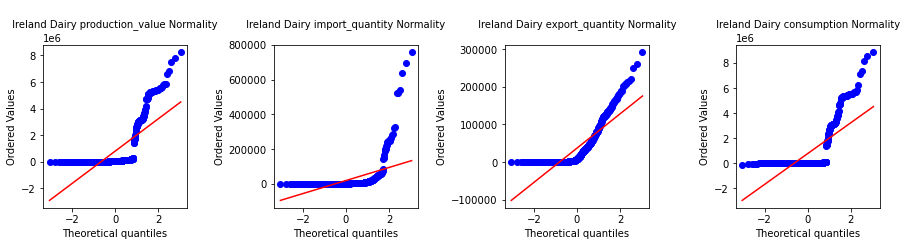

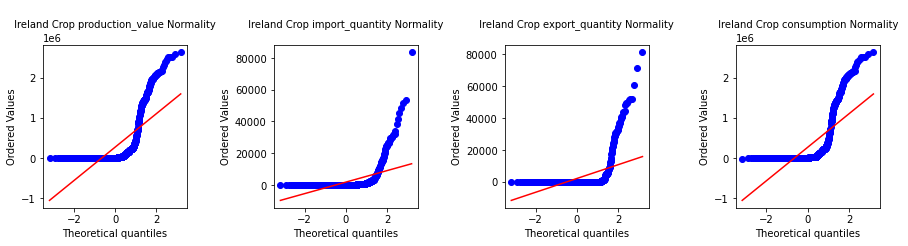

In [236]:
probplot(ireland_meat, 'Ireland Meat ')
probplot(ireland_dairy, 'Ireland Dairy ')
probplot(ireland_crop, 'Ireland Crop ')

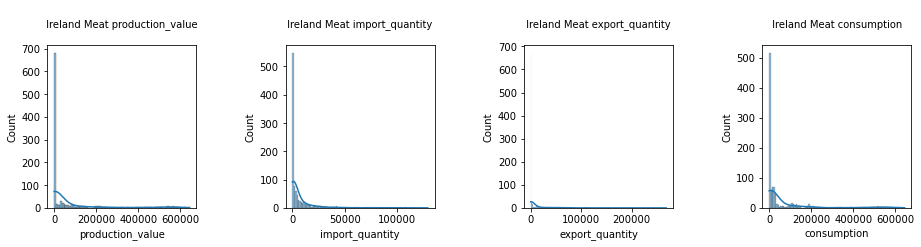

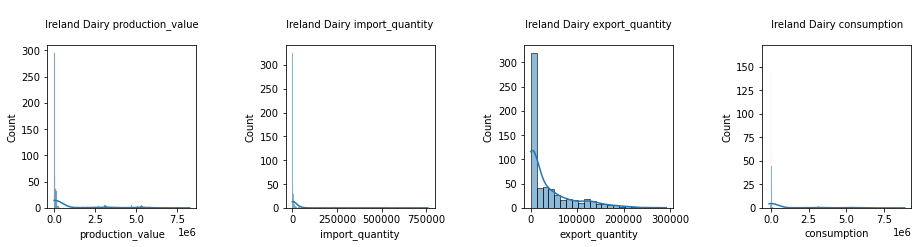

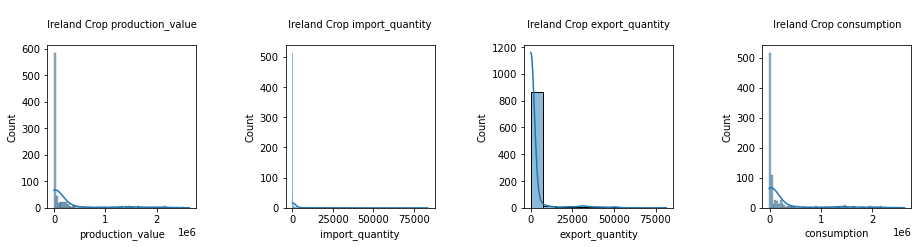

In [237]:
histplot(ireland_meat, 'Ireland Meat ')
histplot(ireland_dairy, 'Ireland Dairy ')
histplot(ireland_crop, 'Ireland Crop ')

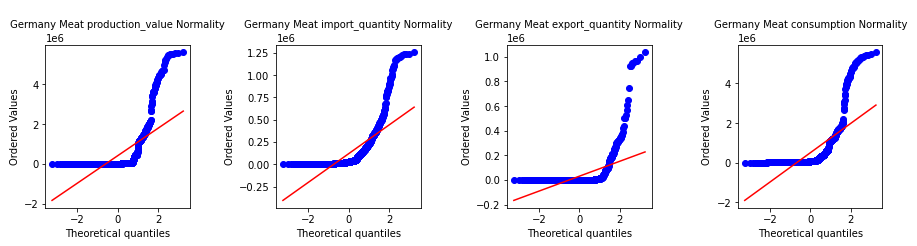

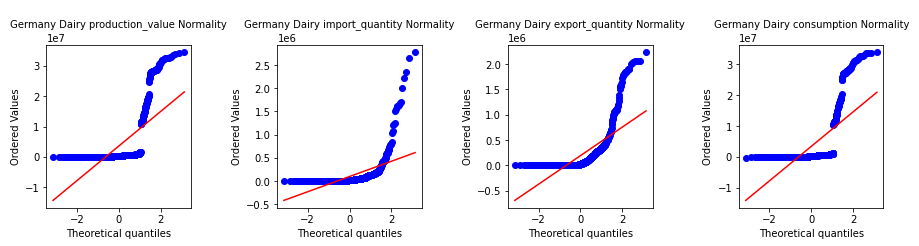

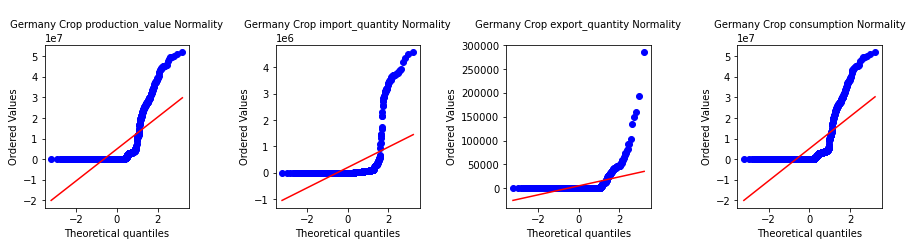

In [238]:
probplot(germany_meat, 'Germany Meat ')
probplot(germany_dairy, 'Germany Dairy ')
probplot(germany_crop, 'Germany Crop ')

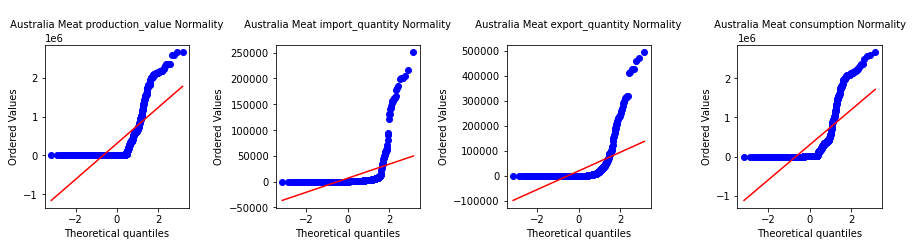

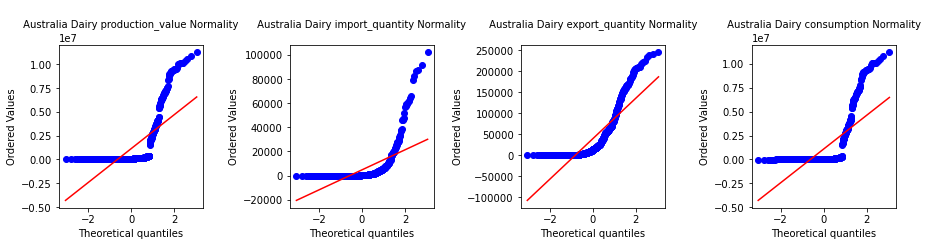

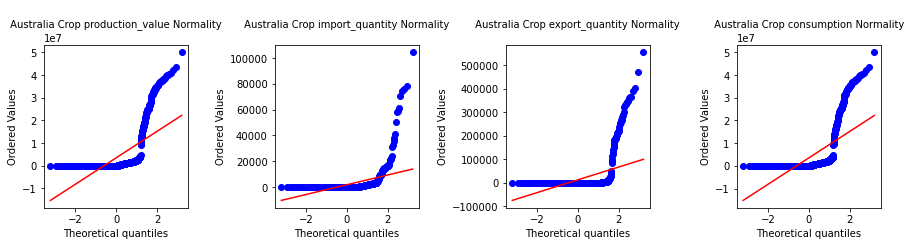

In [239]:
probplot(oz_meat, 'Australia Meat ')
probplot(oz_dairy, 'Australia Dairy ')
probplot(oz_crop, 'Australia Crop ')

### Shapiro Test to test for normal data

There is already a high level of confidence that the data is not normal following the probabiity plot, but to be absolutely certain, a Shapiro-Wilk Test can be used. Shapiro Test is a hypothsis test that defines:

    H0 = data comes from normal distribution
    H1 = data does not come from a normal distribution

If p value is less than alpha (0.05), the null hypothsis is  rejected, meaning data is not normal and non parametric statistical tests will need to be used going forward. As proven by the anasysis, the data is not normal and the null hypotheses is rejected.

Note: when testing for Normality, the more data points uses to calculate the normality, the lower the p-value can be; once more than a certain number of rows are used, the p-value is below the threshold of being distinguished from 0.0. 



In [240]:
#Shapiro wilk test to test for normality 

alpha = 0.05

def shapiro_test(df):
    for i in list:
        print ([i])
        a,b= stats.shapiro(df[[i]])
        print ("Statistics", a, "p-value", b)
        if b < alpha:  
            print("The null hypothesis can be rejected")
        else:
            print("The null hypothesis cannot be rejected")

In [241]:
shapiro_test(ireland_meat)

['production_value']
Statistics 0.5236051678657532 p-value 0.0
The null hypothesis can be rejected
['import_quantity']
Statistics 0.4878818392753601 p-value 0.0
The null hypothesis can be rejected
['export_quantity']
Statistics 0.432583212852478 p-value 0.0
The null hypothesis can be rejected
['consumption']
Statistics 0.5277739763259888 p-value 1.401298464324817e-45
The null hypothesis can be rejected


In [242]:
shapiro_test(ireland_dairy)

['production_value']
Statistics 0.541037917137146 p-value 9.653953627261985e-37
The null hypothesis can be rejected
['import_quantity']
Statistics 0.25900697708129883 p-value 1.9898438193412402e-43
The null hypothesis can be rejected
['export_quantity']
Statistics 0.7363213300704956 p-value 9.877940459903305e-30
The null hypothesis can be rejected
['consumption']
Statistics 0.5238749980926514 p-value 3.110887971787197e-37
The null hypothesis can be rejected


In [243]:
shapiro_test(ireland_crop)

['production_value']
Statistics 0.5403685569763184 p-value 1.0509738482436128e-43
The null hypothesis can be rejected
['import_quantity']
Statistics 0.3067675828933716 p-value 0.0
The null hypothesis can be rejected
['export_quantity']
Statistics 0.26812416315078735 p-value 0.0
The null hypothesis can be rejected
['consumption']
Statistics 0.5393635034561157 p-value 9.80908925027372e-44
The null hypothesis can be rejected


In [244]:
shapiro_test(germany_meat)

['production_value']
Statistics 0.46593374013900757 p-value 0.0
The null hypothesis can be rejected
['import_quantity']
Statistics 0.5847085118293762 p-value 0.0
The null hypothesis can be rejected
['export_quantity']
Statistics 0.3030851483345032 p-value 0.0
The null hypothesis can be rejected
['consumption']
Statistics 0.5235345363616943 p-value 0.0
The null hypothesis can be rejected


In [245]:
shapiro_test(germany_dairy)

['production_value']
Statistics 0.4645322561264038 p-value 1.317220556465328e-43
The null hypothesis can be rejected
['import_quantity']
Statistics 0.35335665941238403 p-value 0.0
The null hypothesis can be rejected
['export_quantity']
Statistics 0.5534484386444092 p-value 5.760737986839323e-41
The null hypothesis can be rejected
['consumption']
Statistics 0.46215271949768066 p-value 1.1350517561031018e-43
The null hypothesis can be rejected


In [246]:
shapiro_test(germany_crop)

['production_value']
Statistics 0.5308150053024292 p-value 0.0
The null hypothesis can be rejected
['import_quantity']
Statistics 0.28864818811416626 p-value 0.0
The null hypothesis can be rejected
['export_quantity']
Statistics 0.28493595123291016 p-value 0.0
The null hypothesis can be rejected
['consumption']
Statistics 0.5481847524642944 p-value 0.0
The null hypothesis can be rejected


In [247]:
shapiro_test(oz_meat)

['production_value']
Statistics 0.5877072811126709 p-value 5.39920298304352e-42
The null hypothesis can be rejected
['import_quantity']
Statistics 0.24084705114364624 p-value 0.0
The null hypothesis can be rejected
['export_quantity']
Statistics 0.36246544122695923 p-value 0.0
The null hypothesis can be rejected
['consumption']
Statistics 0.5736097097396851 p-value 1.7418139911557476e-42
The null hypothesis can be rejected


In [248]:
shapiro_test(oz_dairy)

['production_value']
Statistics 0.5175081491470337 p-value 1.728187652784776e-37
The null hypothesis can be rejected
['import_quantity']
Statistics 0.40857380628585815 p-value 2.741556367543645e-40
The null hypothesis can be rejected
['export_quantity']
Statistics 0.731468677520752 p-value 5.1270553446142946e-30
The null hypothesis can be rejected
['consumption']
Statistics 0.5086976289749146 p-value 9.840023194133383e-38
The null hypothesis can be rejected


In [249]:
shapiro_test(oz_crop)

['production_value']
Statistics 0.4486508369445801 p-value 0.0
The null hypothesis can be rejected
['import_quantity']
Statistics 0.24418187141418457 p-value 0.0
The null hypothesis can be rejected
['export_quantity']
Statistics 0.23388618230819702 p-value 0.0
The null hypothesis can be rejected
['consumption']
Statistics 0.4473024010658264 p-value 0.0
The null hypothesis can be rejected


##  Inferential Statistics between Countries

In order to compare like for like between countries, per capita datasets must be prepared. This will be done by dividing each of the relevant columns by the country population to get per capita amounts for production/ imports/ expports and consumption for analysis. 

Non Parametric tests are reqiored as the data in not normal. In order to compare Ireland aganst other countries a test that determines whether the values of 2 samples are equal or not is required.

https://leehw.com/crib-sheets/statistical-test-cheat-sheet/
https://machinelearningmastery.com/statistical-hypothesis-tests-in-python-cheat-sheet/

The Mann Whitney test is a rank-based test that can be used to compare values for two groups.  If we get a significant result it suggests that the values for the two groups are different.

Assumptions:
1. Observations in each sample are independent and identically distributed (iid).
2. Observations in each sample can be ranked.

Hypothesis:
1. Null hypothesis (H0): The two groups are sampled from populations with identical distributions. 
2. Alternative hypothesis (Ha): The two groups are sampled from populations with different distributions. 

Focusing on the impact of the Common agricultural policy, and possible diet trends the following null hypothesis's will be analysed using inferential statistics.

On average:

    Ireland-Germany / Ireland-Australia produce the same amount of meat products per capita 
    Ireland-Germany / Ireland-Australia import the same amount of meat products per capita 
    Ireland-Germany / Ireland-Australia export the same amount of meat products per capita 
    Ireland-Germany / Ireland-Australia consume the same amount of meat products per capita 

    Ireland-Germany / Ireland-Australia produce the same amount of dairy products per capita 
    Ireland-Germany / Ireland-Australia import the same amount of dairy products per capita 
    Ireland-Germany / Ireland-Australia export the same amount of dairy products per capita 
    Ireland-Germany / Ireland-Australia consume the same amount of dairy products per capita 

    Ireland-Germany / Ireland-Australia produce the same amount of dairy products per capita 
    Ireland-Germany / Ireland-Australia import the same amount of dairy products per capita 
    Ireland-Germany / Ireland-Australia export the same amount of dairy products per capita 
    Ireland-Germany / Ireland-Australia consume the same amount of dairy products per capita 


### Create datasets for inferential statistics

In [250]:
ireland_meat_pc = ireland_meat.copy()
ireland_dairy_pc = ireland_dairy.copy()
ireland_crop_pc = ireland_crop.copy()
germany_meat_pc = germany_meat.copy()
germany_dairy_pc = germany_dairy.copy()
germany_crop_pc = germany_crop.copy()
oz_meat_pc = oz_meat.copy()
oz_dairy_pc = oz_dairy.copy()
oz_crop_pc = oz_crop.copy()

dropvalue = ['prod_country', 'production_unit','production_value', 
             'import_unit', 'import_quantity', 'export_unit','export_quantity', 'consumption']

In [251]:
def percapita(dataset, popvalue):
    dataset['prod_percap'] = (dataset['production_value'] / dataset[popvalue])
    dataset['import_percap'] = (dataset['import_quantity'] / dataset[popvalue])
    dataset['export_percap'] = (dataset['export_quantity'] / dataset[popvalue])
    dataset['consumption_percap'] = (dataset['consumption'] / dataset[popvalue])
    dataset.drop(dropvalue, axis = 1, inplace=True)
    dataset.reset_index(drop=True, inplace=True)

In [252]:
percapita(ireland_meat_pc, 'Population_Ireland')
percapita(ireland_dairy_pc, 'Population_Ireland')
percapita(ireland_crop_pc, 'Population_Ireland')

percapita(germany_meat_pc, 'Population_Germany')
percapita(germany_dairy_pc, 'Population_Germany')
percapita(germany_crop_pc, 'Population_Germany')

percapita(oz_meat_pc, 'Population_Australia')
percapita(oz_dairy_pc, 'Population_Australia')
percapita(oz_crop_pc, 'Population_Australia')

In [253]:
ireland_meat_pc.describe()
germany_meat_pc.describe()
oz_meat_pc.describe()

,Population_Ireland,prod_percap,import_percap,export_percap,consumption_percap
count,1.017000e+03,1017.000000,1017.000000,1017.000000,1017.000000
mean,3.766506e+06,0.018206,0.001662,0.002856,0.017012
std,6.185158e+05,0.038465,0.003511,0.007958,0.034767
min,2.824400e+06,0.000000,0.000000,0.000000,0.000000
25%,3.373750e+06,0.000000,0.000002,0.000000,0.000202
50%,3.590386e+06,0.000182,0.000214,0.000000,0.001642
75%,4.398942e+06,0.012743,0.001643,0.000852,0.010757
max,4.934340e+06,0.171461,0.026503,0.078676,0.171461


,Population_Germany,prod_percap,import_percap,export_percap,consumption_percap
count,1.170000e+03,1170.000000,1170.000000,1.170000e+03,1170.000000
mean,7.969223e+07,0.005120,0.001450,3.746615e-04,0.006195
std,2.417491e+06,0.012663,0.002588,1.357346e-03,0.012846
min,7.337763e+07,0.000000,0.000000,0.000000e+00,0.000001
25%,7.812828e+07,0.000000,0.000111,0.000000e+00,0.000286
50%,7.943303e+07,0.000050,0.000329,3.647349e-08,0.000703
75%,8.204720e+07,0.000731,0.001689,2.484487e-05,0.005009
max,8.309296e+07,0.069960,0.015640,1.260080e-02,0.069608


,Population_Australia,prod_percap,import_percap,export_percap,consumption_percap
count,9.170000e+02,917.000000,917.000000,917.000000,917.000000
mean,1.761836e+07,0.017907,0.000295,0.001080,0.017122
std,4.102115e+06,0.033536,0.001190,0.003185,0.032716
min,1.048300e+07,0.000000,0.000000,0.000000,-0.000309
25%,1.435800e+07,0.000000,0.000000,0.000000,0.000077
50%,1.749500e+07,0.000312,0.000003,0.000000,0.000445
75%,2.069790e+07,0.018489,0.000089,0.000320,0.016203
max,2.536574e+07,0.152096,0.009900,0.019524,0.152096


### Mann Whitney Test to compare values for 2 populations

In [254]:
pc_list = ['prod_percap', 'import_percap', 'export_percap', 'consumption_percap']

# Ireland/ Australia on average produce the same amount of meat products per capita 
def mannwhittest(df1, df2):
    for i in pc_list:
        print ([i])
        stat, p = mannwhitneyu(df1[[i]], df2[[i]],)
        print('stat=%.3f, p=%.3f' % (stat, p))
        if p > 0.05:
            print('P value greater than 0.05, accept the null hypothesis')
        else:
            print('P value less than 0.05, reject the null hypothesis')

In [255]:
# H0 - Ireland/ Germany on average produce/import/export/consume the same amount of meat products per capita 
# Ha - Ireland/ Germany on average do not produce/import/export/consume the same amount of meat products per capita 
mannwhittest(ireland_meat_pc, germany_meat_pc)

['prod_percap']
stat=629371.000, p=0.015
P value less than 0.05, reject the null hypothesis
['import_percap']
stat=520743.000, p=0.000
P value less than 0.05, reject the null hypothesis
['export_percap']
stat=625667.000, p=0.024
P value less than 0.05, reject the null hypothesis
['consumption_percap']
stat=645114.000, p=0.001
P value less than 0.05, reject the null hypothesis


In [256]:
# H0 - Ireland/ Austraia on average produce/import/export/consume the same amount of meat products per capita 
# Ha - Ireland/ Austraia on average do not produce/import/export/consume the same amount of meat products per capita 
mannwhittest(ireland_meat_pc, oz_meat_pc)

['prod_percap']
stat=444236.000, p=0.059
P value greater than 0.05, accept the null hypothesis
['import_percap']
stat=659551.000, p=0.000
P value less than 0.05, reject the null hypothesis
['export_percap']
stat=489531.500, p=0.035
P value less than 0.05, reject the null hypothesis
['consumption_percap']
stat=518638.000, p=0.000
P value less than 0.05, reject the null hypothesis


In [257]:
# H0 - Ireland/ Germany on average produce/import/export/consume the same amount of dairy products per capita 
# Ha - Ireland/ Germany on average do not produce/import/export/consume the same amount of dairy products per capita 
mannwhittest(ireland_dairy_pc, germany_dairy_pc)

['prod_percap']
stat=290203.000, p=0.000
P value less than 0.05, reject the null hypothesis
['import_percap']
stat=273165.000, p=0.000
P value less than 0.05, reject the null hypothesis
['export_percap']
stat=312432.000, p=0.000
P value less than 0.05, reject the null hypothesis
['consumption_percap']
stat=244999.000, p=0.548
P value greater than 0.05, accept the null hypothesis


In [258]:
# H0 - Ireland/ Australia on average produce/import/export/consume the same amount of dairy products per capita 
# H0 - Ireland/ Australia on average do not produce/import/export/consume the same amount of dairy products per capita  
mannwhittest(ireland_dairy_pc, oz_dairy_pc)

['prod_percap']
stat=197573.000, p=0.004
P value less than 0.05, reject the null hypothesis
['import_percap']
stat=259830.000, p=0.000
P value less than 0.05, reject the null hypothesis
['export_percap']
stat=219475.000, p=0.000
P value less than 0.05, reject the null hypothesis
['consumption_percap']
stat=184143.000, p=0.522
P value greater than 0.05, accept the null hypothesis


In [259]:
# H0 - Ireland/ Germany on average produce/import/export/consume the same amount of crop products per capita 
# Ha - Ireland/ Germany on average do not produce/import/export/consume the same amount of crop products per capita 
mannwhittest(ireland_crop_pc, germany_crop_pc)

['prod_percap']
stat=506188.500, p=0.288
P value greater than 0.05, accept the null hypothesis
['import_percap']
stat=456506.000, p=0.003
P value less than 0.05, reject the null hypothesis
['export_percap']
stat=486850.000, p=0.444
P value greater than 0.05, accept the null hypothesis
['consumption_percap']
stat=491140.000, p=0.863
P value greater than 0.05, accept the null hypothesis


In [260]:
# H0 - Ireland/ Australia on average produce/import/export/consume the same amount of crop products per capita 
# Ha - Ireland/ Australia on average do not produce/import/export/consume the same amount of crop products per capita 
mannwhittest(ireland_crop_pc, oz_crop_pc)

['prod_percap']
stat=383986.500, p=0.000
P value less than 0.05, reject the null hypothesis
['import_percap']
stat=578875.000, p=0.000
P value less than 0.05, reject the null hypothesis
['export_percap']
stat=449620.000, p=0.014
P value less than 0.05, reject the null hypothesis
['consumption_percap']
stat=405120.000, p=0.000
P value less than 0.05, reject the null hypothesis


### Mann-Whitney Results

    Ireland & Germany on average do not produce/ import/ export/ consume the same amount of meat products per Capita
    Ireland & Australia on average produce the same amount of meat products per Capita, but do not import/ export/ consume the same amount
This is an interesting finding that Ireland and Germany show no similarities in meat production/ import/ export/ consumption. However, Germany's meat habbits were very different when analysed so it is not unfitting to assume that this is due to cultural differences between the countries.

Looking at Ireland/ Australia, despite production values being similar. From the data it is evident that on average Ireland imports and exports a lot more meat products that Australia, leading to the assumption that Austrlia relies less heavily on trade and is more self sufficent, which is known to be the case. 


    Ireland & Germany on average consume the same amount of dairy products per Capita, but do not produce/ import/ export the same amount
    Ireland & Australia on average consume the same amount of dairy products per Capita, but do not produce/ import/ export the same amount
These results make sense as there is a general decine in the consumption of dairy in countries with a growing vegan population as all 3 countries have. It is also evident form the data that Ireland produces/ imports/ exports the highest amount of dairy between these 3 countries so it it not suprising that their averages vary. Ireland actually produces almost than 3 times the amount of dairy per capita as the other 2 countries


    Ireland & Germany on average produce / export/ consume the same amount of crop products per Capita, but do not import the same amount
    Ireland & Australia on average do not produce/ import/ export/ consume the same amount of crop products per Capita
This is also unsuprising as Ireland and germany appear to produce, export and consume simialr amounts of crops per capita. These similarities could be due to diet trends such as veganism or do benifits reviewd from the CAP & being members of the EU. 

Australia both produce and consume almost 3 times more crops than Ireland or Germany. This highlights the difference in diet cultures ad shows how much more veg is consumed as a result of Australias high vegan and vegatarian poulations. 


# Old Code

In [261]:
xxxx

NameError: name 'xxxx' is not defined

In [ ]:
#ireland dairy / milk alternative analysis
ireland_df2 = ireland_df.loc[ireland_df['Crop_Livestock'].str.contains('butter|cheese|milk|soy|almond|oat|hazelnut|cashew|treenut|quinoa', case=False)]
ireland_df2 = ireland_df2.loc[ireland_df2['Crop_Livestock'].str.contains('dried|condensed|evaporated|ghee|kind|total|sheep|dry|cake|cocoa|oil|goat|nes|sauce|peanut|processed|curdled', case=False) == False]
ireland_df2.rename(columns={'Crop_Livestock': 'Crop'}, inplace=True)
ireland_df2.reset_index(drop=True, inplace=True)

#germany dairy / milk alternative analysis
germany_df2 = germany_df.loc[germany_df['Crop_Livestock'].str.contains('butter|cheese|milk|soy|almond|oat|hazelnut|cashew|treenut|quinoa', case=False)]
germany_df2 = germany_df2.loc[germany_df2['Crop_Livestock'].str.contains('dried|condensed|evaporated|ghee|kind|total|sheep|dry|cake|cocoa|oil|goat|nes|sauce|peanut|processed|curdled', case=False) == False]
germany_df2.rename(columns={'Crop_Livestock': 'Crop'}, inplace=True)
germany_df2.reset_index(drop=True, inplace=True)

#aus dairy / milk alternative analysis
oz_df2 = oz_df.loc[oz_df['Crop_Livestock'].str.contains('butter|cheese|milk|soy|almond|oat|hazelnut|cashew|treenut|quinoa', case=False)]
oz_df2 = oz_df2.loc[oz_df2['Crop_Livestock'].str.contains('dried|condensed|evaporated|ghee|kind|total|sheep|dry|cake|cocoa|oil|goat|nes|sauce|peanut|processed|curdled', case=False) == False]
oz_df2.rename(columns={'Crop_Livestock': 'Crop'}, inplace=True)
oz_df2.reset_index(drop=True, inplace=True)


In [ ]:
ireland_df_dairy = ireland_df2.loc[ireland_df2['Crop'].str.contains('milk', case=False)]
ireland_df_alt = ireland_df2.loc[ireland_df2['Crop'].str.contains('soy|almond|oat|hazelnut|cashew|treenut|quinoa', case=False)]
ireland_df_dairy.reset_index(drop=True, inplace=True)
ireland_df_alt.reset_index(drop=True, inplace=True)

germany_df_dairy = germany_df2.loc[germany_df2['Crop'].str.contains('milk', case=False)]
germany_df_alt = germany_df2.loc[germany_df2['Crop'].str.contains('soy|almond|oat|hazelnut|cashew|treenut|quinoa', case=False)]
germany_df_dairy.reset_index(drop=True, inplace=True)
germany_df_alt.reset_index(drop=True, inplace=True)

oz_df_dairy = oz_df2.loc[oz_df2['Crop'].str.contains('milk', case=False)]
oz_df_alt = oz_df2.loc[oz_df2['Crop'].str.contains('soy|almond|oat|hazelnut|cashew|treenut|quinoa', case=False)]
oz_df_dairy.reset_index(drop=True, inplace=True)
oz_df_alt.reset_index(drop=True, inplace=True)

In [ ]:
plt.figure(figsize = (15,8))
sns.barplot(data=ireland_meat, x="Meat Type", y="Production Value")  
plt.xlabel('\nProduct', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('\nTop Ireland Production 1961-2019\n', fontsize=20)
plt.xticks(rotation = 85, fontsize=12);

plt.figure(figsize = (15,8))
sns.barplot(data=ireland_meat, x="Meat Type", y="Import Quantity")  
plt.xlabel('\nProduct', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('\nTop Ireland Meat Imports 1961-2019\n', fontsize=20)
plt.xticks(rotation = 85, fontsize=12);

plt.figure(figsize = (15,8))
sns.barplot(data=ireland_meat, x="Meat Type", y="Export Quantity")  
plt.xlabel('\nProduct', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('\nTop Ireland Meat Exports 1961-2019\n', fontsize=20)
plt.xticks(rotation = 85, fontsize=12);

plt.figure(figsize = (15,8))
sns.barplot(data=ireland_meat, x="Meat Type", y="Consumption")  
plt.xlabel('\nProduct', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('\nTop Ireland Meat Consumption 1961-2019\n', fontsize=20)
plt.xticks(rotation = 85, fontsize=12);

In [ ]:
features = ['Production Value', 'Import Quantity', 'Export Quantity', 'Consumption']

plt.figure(figsize = (15,30))
for i in enumerate(features):
    plt.subplot(4,1,i[0]+1)
    sns.barplot(data = ireland_meat, x = "Meat Type", y = i[1])
    plt.xticks(rotation = 40, fontsize=12)
    plt.xlabel('Product', fontsize=15) 
    plt.ylabel('Amount in Tonnes\n', fontsize=15)
    # https://stackoverflow.com/questions/35638525/how-to-add-title-to-subplots-with-loop
    # set the spacing between subplots 
    plt.subplots_adjust(left=None, bottom=None, right=None, top=0.9, wspace=None, hspace=0.8)
    # add title to include i value
    plt.title('\n Ireland ' + i[1] + ' for 1961-2019\n', fontsize=20)
plt.show();

In [ ]:
plt.figure(figsize = (12,8))
sns.lineplot(data=ireland_meat, x="Year", y="Production Value", hue="Meat_Type")  
plt.xlabel('\nYear', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('\nIreland Meat Production 1961-2019\n', fontsize=20)
plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
plt.xticks(rotation = 80);

plt.figure(figsize = (12,8))
sns.lineplot(data=ireland_meat, x="Year", y="Consumption", hue="Meat_Type")  
plt.xlabel('\nYear', fontsize=15) 
plt.ylabel('Tonnes Produced\n', fontsize=15)
plt.title ('\nIreland Meat Consumption 1961-2019\n', fontsize=20)
plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
plt.xticks(rotation = 80);

In [ ]:
line_values = ['Production Value', 'Consumption']

def plotlinegraphs(dataset, value, country, popvalue):
    plt.figure(figsize = (15,20))
    for i in enumerate(line_values):
        plt.subplot(2,1,i[0]+1)
        sns.lineplot(data= dataset, x="Year", y= i[1], hue= value )
        plt.xticks(rotation = 80, fontsize=12)
        plt.xlabel('\nYear', fontsize=15) 
        plt.ylabel('Amount in Tonnes\n', fontsize=15)
        plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
    # https://stackoverflow.com/questions/35638525/how-to-add-title-to-subplots-with-loop
    # set the spacing between subplots 
        plt.subplots_adjust(left=None, bottom=None, right=None, top=0.8, wspace=None, hspace=0.9)
    # add title to include i value
        plt.title('\n ' + country + i[1] + ' per ' + value + ' Vs Population for 1961-2019\n', fontsize=20)
        ax2 = plt.twinx()
        plt.ylabel('\nPopulation', fontsize=15)
        sns.lineplot(data=dataset, x="Year", y= popvalue, color ="r", 
                     label= 'Population', linestyle='dashdot', linewidth=3, ax=ax2)        
plt.show(); 

In [ ]:
plt.figure(figsize = (15,8))
sns.lineplot(data= ireland_dairy, x="Year", y= 'Consumption', hue= 'Dairy_Product') 
plt.xticks(rotation = 80, fontsize=12)
plt.xlabel('\nYear', fontsize=15) 
plt.ylabel('Amount in Tonnes\n', fontsize=15)
plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))   
plt.subplots_adjust(left=None, bottom=None, right=None, top=0.8, wspace=None, hspace=0.9)   
plt.title('\n Title\n', fontsize=20)

ax2 = plt.twinx()
plt.ylabel('\nPopulation', fontsize=15)
sns.lineplot(data=ireland_dairy, x="Year", y= 'Population_Ireland', color ="r", 
                     label= 'Population', linestyle='dashdot', linewidth=2, ax=ax2)     
plt.show(); 

In [ ]:
dataframe['LogValue'] = np.log10(dataframe['Value'])


In [ ]:
#man whitney 

def manw(df):
    '''This function takes a dataframe as input, loops through all the countries
    in the dfcolumns and does a mann whitney versus Irelands data'''
    for country in df.iloc[:,:]:
        if country != "Ireland":
            result = mannwhitneyu(df.Ireland, df[country])
            if result.pvalue <= 0.05:
                print(f"The p-value for Ireland vs {country} is {result.pvalue}, the null hypothesis is rejected")
                print(f"round{result}\n")
            else:
                print(f"The p-value for Ireland vs {country} is {result.pvalue}, the null hypothesis is accepted")
                print(f"{result}\n")


In [ ]:
oz_crop = oz_df.loc[oz_df['Crop_Livestock'].str.contains('meat', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('milk', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('offals', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('fat', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('hides', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('wool', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('sheep', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('cream', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('egg', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('lard', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('butter', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('cheese', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('oil', case=False) == False]
oz_crop = oz_crop.loc[oz_crop['Crop_Livestock'].str.contains('skin', case=False) == False]

In [ ]:
# function 1 - Line graphs for production / consumption Vs Population throughout years

# set the spacing between subplots /  # add title to include i value
# https://stackoverflow.com/questions/35638525/how-to-add-title-to-subplots-with-loop

## add annotation for lines in line graph
# https://stackoverflow.com/questions/49237522/how-to-annotate-end-of-lines-using-python-and-matplotlib
#https://matplotlib.org/3.5.0/api/_as_gen/matplotlib.axes.Axes.annotate.html



line_values = ['Production Value', 'Consumption']

def plotlinegraphs(dataset, value, country, popvalue):
    plt.figure(figsize = (15,20))
    for i in enumerate(line_values):
        plt.subplot(2,1,i[0]+1)
        sns.lineplot(data= dataset, x="Year", y= i[1], hue= value, ci=None )
        plt.xticks(rotation = 80, fontsize=12)
        plt.xlabel('\nYear', fontsize=15) 
        plt.ylabel('Amount in Tonnes\n', fontsize=15)
        plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
        plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=0.4)
        plt.title('\n ' + country + i[1] + ' per ' + value + ' Vs Population for 1961-2019\n', fontsize=20)
        ax2 = plt.twinx()
        plt.ylabel('\nPopulation', fontsize=15)
        sns.lineplot(data=dataset, x="Year", y= popvalue, color ="r", 
                     label= 'Population', linestyle='dashdot', linewidth=3, ax=ax2)        
plt.show(); 

In [ ]:
# # function 2 - Line graphs for production / consumption thrughout yearswhere max/ min values are required 

line_values = ['Production Value', 'Consumption']

def plotlinegraphsii(dataset, value, minx, maxx, country, popvalue, title):
    plt.figure(figsize = (15,20))
    for i in enumerate(line_values):
        plt.subplot(2,1,i[0]+1)
        sns.lineplot(data= dataset, x="Year", y= i[1], hue= value, ci=None )
        plt.ylim([minx, maxx])
        plt.xticks(rotation = 80, fontsize=12)
        plt.xlabel('\nYear', fontsize=15) 
        plt.ylabel('Amount in Tonnes\n', fontsize=15)
        plt.legend(prop = {'size': 10}, loc='best', bbox_to_anchor=(1.3, 1))
    # https://stackoverflow.com/questions/35638525/how-to-add-title-to-subplots-with-loop
    # set the spacing between subplots 
        plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=0.4)
    # add title to include i value
        plt.title('\n ' + country + i[1] + ' per ' + title + value + ' Vs Population for 1961-2019\n', fontsize=20)
        ax2 = plt.twinx()
        plt.ylabel('\nPopulation', fontsize=15)
        sns.lineplot(data=dataset, x="Year", y= popvalue, color ="r", 
                     label= 'Population', linestyle='dashdot', linewidth=3, ax=ax2)        
plt.show(); 

In [ ]:
#create a sample from the population using the groupby function
irl_meat_sample = ireland_meat.groupby(['Meat_Type', 'Year'], group_keys=False).apply(lambda x: x.sample(1))
irl_meat_sample

In [ ]:
#qq plot for normality
fig = sm.qqplot(ireland_meat.production_value, line='45')
plt.show();

In [ ]:
#create a sample from the population using the groupby function
irl_meat_sample = ireland_meat_pc.groupby(['Meat_Type', 'year'], group_keys=False).apply(lambda x: x.sample(1))
ger_meat_sample = germany_meat_pc.groupby(['Meat_Type', 'year'], group_keys=False).apply(lambda x: x.sample(1))

irl_meat_sample.shape
ger_meat_sample.shape

In [ ]:
# Ireland/ Germany on average produce the same amount of meat products per capita 

stat, p = mannwhitneyu(ireland_meat_pc.prod_percap, germany_meat_pc.prod_percap)
print('stat=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('P value greater than 0.05, accept the null hypothesis')
else:
    print('P value less than 0.05, reject the null hypothesis')